In [1]:
# reload packages
%load_ext autoreload
%autoreload 2`

### Choose GPU

In [2]:
%env CUDA_DEVICE_ORDER=PCI_BUS_ID
%env CUDA_VISIBLE_DEVICES=2

env: CUDA_DEVICE_ORDER=PCI_BUS_ID
env: CUDA_VISIBLE_DEVICES=2


In [3]:
import tensorflow as tf
gpu_devices = tf.config.experimental.list_physical_devices('GPU')
if len(gpu_devices)>0:
    tf.config.experimental.set_memory_growth(gpu_devices[0], True)
print(gpu_devices)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [4]:
tf.keras.backend.clear_session()

### dataset information

In [5]:
from datetime import datetime

dataset = "mnist"
dims = (28, 28, 1)
umap_prop = 1.0
num_classes = 10
PROJECTION_DIMS = 1024
labels_per_class = 4  # 'full'
datestring = datetime.now().strftime("%Y_%m_%d_%H_%M_%S_%f")
datestring = (
    str(dataset)
    + "_"
    + str(umap_prop)
    + "_"
    + str(PROJECTION_DIMS)
    + "_"
    + str(labels_per_class)
    + "____"
    + datestring
    + '__linear-umap-euclidean'
)
print(datestring)

mnist_1.0_1024_4____2020_08_07_23_09_37_575624__linear-umap-euclidean


### Load packages

In [6]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm
from IPython import display
import pandas as pd
import umap
import copy
import os, tempfile

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


### Load dataset

In [7]:
from tfumap.load_datasets import load_MNIST, mask_labels

In [8]:
X_train, X_test, X_valid, Y_train, Y_test, Y_valid = load_MNIST(flatten=False)
X_train.shape

(50000, 28, 28, 1)

In [9]:
if labels_per_class == "full":
    X_labeled = X_train
    Y_masked = Y_labeled = Y_train
else:
    X_labeled, Y_labeled, Y_masked = mask_labels(
        X_train, Y_train, labels_per_class=labels_per_class
    )

### Build umap graph

In [10]:
from tfumap.semisupervised import build_fuzzy_simplicial_set

In [11]:
n_neighbors = 15  # default = 15
umap_graph = build_fuzzy_simplicial_set(
    X_train.reshape((len(X_train), np.product(np.shape(X_train)[1:]))),
    y=Y_masked,
    n_neighbors=n_neighbors,
)

### Build data iterators

In [12]:
from tfumap.umap import compute_cross_entropy, get_graph_elements
from tfumap.semisupervised import create_edge_iterator, create_validation_iterator, create_classification_iterator

In [13]:
n_epochs = 200
graph, epochs_per_sample, head, tail, weight, n_vertices = get_graph_elements(
            umap_graph, n_epochs
)
batch_size = np.min([n_vertices, 1000])
batch_size

1000

In [14]:
# make sure batch size is no bigger than the number of labels per class
labeled_batch_size = batch_size if batch_size < len(Y_labeled) else len(Y_labeled)
labeled_iter = create_classification_iterator(X_labeled, Y_labeled, batch_size=batch_size)
print(labeled_batch_size)

40


In [15]:
max_sample_repeats_per_epoch = 25
edge_iter, n_edges_per_epoch = create_edge_iterator(
    head,
    tail,
    weight,
    batch_size=batch_size,
    max_sample_repeats_per_epoch=max_sample_repeats_per_epoch,
)

In [16]:
data_valid, n_valid_samp = create_validation_iterator(X_valid, Y_valid, batch_size, repeat=True)

### Build network

In [17]:
encoder = tf.keras.Sequential()
encoder.add(tf.keras.layers.InputLayer(input_shape=dims))
encoder.add(tf.keras.layers.Conv2D(
    filters=32, kernel_size=3, strides=1, padding="same", activation="relu"
))
encoder.add(tf.keras.layers.Conv2D(
    filters=64, kernel_size=3, strides=1, padding="same", activation="relu"
))
encoder.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
encoder.add(tf.keras.layers.Dropout(0.25))
encoder.add(tf.keras.layers.Flatten())
encoder.add(tf.keras.layers.Dense(units=128, activation="relu"))
encoder.add(tf.keras.layers.Dropout(0.25))

In [18]:
classifier = tf.keras.Sequential()
classifier.add(tf.keras.layers.InputLayer(input_shape=128))
classifier.add(tf.keras.layers.Dense(units=128, activation="relu"))
classifier.add(tf.keras.layers.Dense(units=128, activation="relu"))
classifier.add(tf.keras.layers.Dense(num_classes, activation='softmax', name="predictions"))

In [19]:
encoder.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 28, 28, 32)        320       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 28, 28, 64)        18496     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 14, 14, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 14, 14, 64)        0         
_________________________________________________________________
flatten (Flatten)            (None, 12544)             0         
_________________________________________________________________
dense (Dense)                (None, 128)               1605760   
_________________________________________________________________
dropout_1 (Dropout)          (None, 128)               0

### Create UMAP object

In [20]:
from tfumap.semisupervised_model import PUMAP, compute_classifier_loss

In [21]:
def compute_umap_loss(
    batch_to,
    batch_from,
    encoder,
    _a,
    _b,
    negative_sample_rate=5,
    repulsion_strength=1,
):
    """
        compute the cross entropy loss for learning embeddings

        Parameters
        ----------
        batch_to : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (to)
        batch_from : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (from)

        Returns
        -------
        ce_loss : tf.float
            cross entropy loss for UMAP
        embedding_to : tf.float
            embeddings for verticies (to)
        embedding_from : tf.float
            embeddings for verticies (from)
        """

    # encode
    embedding_to = encoder(batch_to)
    embedding_from = encoder(batch_from)

    # get negative samples
    embedding_neg_to = tf.repeat(embedding_to, negative_sample_rate, axis=0)
    repeat_neg = tf.repeat(embedding_from, negative_sample_rate, axis=0)
    embedding_neg_from = tf.gather(
        repeat_neg, tf.random.shuffle(tf.range(tf.shape(repeat_neg)[0]))
    )

    #  distances between samples
    distance_embedding = tf.concat(
        [
            tf.norm(embedding_to - embedding_from, axis=1),
            tf.norm(embedding_neg_to - embedding_neg_from, axis=1),
        ],
        axis=0,
    )

    # convert probabilities to distances
    probabilities_distance = convert_distance_to_probability(distance_embedding, _a, _b)

    # treat positive samples as p=1, and negative samples as p=0
    probabilities_graph = tf.concat(
        [tf.ones(embedding_to.shape[0]), tf.zeros(embedding_neg_to.shape[0])], axis=0,
    )

    # cross entropy loss
    (attraction_loss, repellant_loss, ce_loss) = compute_cross_entropy(
        probabilities_graph,
        probabilities_distance,
        repulsion_strength=repulsion_strength,
    )

    return (
        attraction_loss,
        repellant_loss,
        ce_loss,
    )


In [22]:
import tensorflow as tf
from tfumap.umap import compute_cross_entropy, convert_distance_to_probability
from tfumap.semisupervised import (
    find_a_b,
    #compute_umap_loss,
    # compute_classifier_loss,
    batch_data,
)
import numpy as np
import os, tempfile
from tqdm.autonotebook import tqdm
from datetime import datetime


@tf.function
def compute_classifier_loss(X, y, encoder, classifier, sparse_ce, acc_func):
    """ compute the cross entropy loss for classification
        """
    d = classifier(encoder(X))
    loss = sparse_ce(y, d)
    acc = acc_func(y, d)
    #acc = tf.keras.metrics.sparse_categorical_accuracy(y, d)
    return loss, acc


class PUMAP(tf.keras.Model):
    def __init__(
        self,
        encoder,
        classifier,
        tensorboard_logdir=None,  # directory for tensorboard log
        min_dist=0.1,
        negative_sample_rate=5.0,
        optimizer=tf.keras.optimizers.SGD(0.1),
        repulsion_strength=1.0,
        # ** kwargs,
    ):
        super(PUMAP, self).__init__()
        # self.__dict__.update(kwargs)

        # subnetworks
        self.encoder = encoder
        self.classifier = classifier


        # optimizer for cross entropy minimization
        self.optimizer = optimizer
        self.repulsion_strength = repulsion_strength
        self.negative_sample_rate = negative_sample_rate

        # get a,b for current min_dist
        self._a, self._b = find_a_b(min_dist)

        # create summary writer to log loss information during training
        if tensorboard_logdir is None:
            self.tensorboard_logdir = os.path.join(
                tempfile.gettempdir(),
                "tensorboard",
                datetime.now().strftime("%Y%m%d-%H%M%S"),
            )
        else:
            self.tensorboard_logdir = tensorboard_logdir
        self.summary_writer_train = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/train"
        )
        self.summary_writer_valid = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/valid"
        )

        # sparse categorical cross entropy
        self.sparse_ce = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
        self.class_acc = tf.keras.metrics.SparseCategoricalAccuracy()
        self.class_acc_val = tf.keras.metrics.SparseCategoricalAccuracy()

        # self.create_summary_metrics()

    @tf.function
    def train(self, batch_to, batch_from, X, y, umap_prop = 1.0, save_loss=False):
        """ One training step 
        Input are points and weights for positive and negative 
        samples for training. 
            
        """
        if umap_prop > 0:
            with tf.GradientTape() as tape:

                (attraction_loss, repellant_loss, umap_loss) = compute_umap_loss(
                    batch_to,
                    batch_from,
                    self.encoder,
                    self._a,
                    self._b,
                    self.negative_sample_rate,
                    self.repulsion_strength,
                )
            
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = (
                    tf.reduce_mean(classifier_loss)
                    + tf.reduce_mean(umap_loss) * umap_prop
                )

            train_vars = (
                self.encoder.trainable_variables
                + self.classifier.trainable_variables
            )
        else:  # ignore running costly UMAP computations if not training on UMAP loss
            with tf.GradientTape() as tape:
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = classifier_loss
            train_vars = (
                self.encoder.trainable_variables + self.classifier.trainable_variables
            )
            attraction_loss = repellant_loss = umap_loss = 0

        # compute gradient for umap
        grad = tape.gradient(loss, train_vars)

        # gradients are cliped in UMAP implementation. Any effect here?
        grad = [tf.clip_by_value(grad, -4.0, 4.0) for grad in grad]

        self.optimizer.apply_gradients(zip(grad, train_vars))

        return (
            attraction_loss,
            repellant_loss,
            tf.reduce_mean(umap_loss),
            classifier_loss,
            classifier_acc,
        )

    @tf.function
    def write_losses(
        self,
        step,
        classifier_acc,
        classifier_loss,
        umap_loss,
        classifier_loss_val,
        classifier_acc_val,
    ):
        # write train loss
        with self.summary_writer_train.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss, step=step,
            )
            tf.summary.scalar(
                "umap_loss", umap_loss, step=step,
            )
            self.summary_writer_train.flush()
        # write valid loss
        with self.summary_writer_valid.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc_val, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss_val, step=step,
            )
            self.summary_writer_valid.flush()



In [23]:
### Initialize model
model = PUMAP(
    min_dist = 0.0,
    negative_sample_rate = 5, # how many negative samples per positive
    optimizer=tf.keras.optimizers.Adam(1e-3), # cross-entropy optimizer
    encoder=encoder,
    classifier=classifier,    
)

### plotting results

In [24]:
def model_data(X, batch_size, model):
    """ embed a set of points in X to Z
    """
    n_batch = int(np.ceil(len(X) / batch_size))
    return np.vstack(
        [
                model(np.array(X[(i) * batch_size : (i + 1) * batch_size, :]))
            for i in tqdm(range(n_batch), leave=False)
        ]
    )

In [25]:
from tfumap.umap import retrieve_tensors
from sklearn.decomposition import PCA
import seaborn as sns
from umap import UMAP 

def plot_umap_classif_results(
    model,
    X_valid,
    Y_valid,
    X_train,
    X_labeled,
    Y_labeled,
    batch_size,
    dralg = PCA, #umap
    cmap="coolwarm",
    cmap2="bwr",
):
    # get loss dataframe from tensorboard
    try:
        loss_df = retrieve_tensors(model.tensorboard_logdir)
        losses_exist = True
    except ValueError as e:
        print(e)
        losses_exist = False

    pred_model = tf.keras.models.Model(model.classifier.input,[model.classifier.get_layer(name="dense_1").get_output_at(0)])

    # embed data
    enc_valid = model_data(X_valid, batch_size, model.encoder)
    class_valid = model_data(enc_valid, batch_size, pred_model)
    pred_valid = model_data(enc_valid, batch_size, model.classifier)

    enc_lab = model_data(X_labeled, batch_size, model.encoder)
    class_lab = model_data(enc_lab, batch_size, pred_model)
    pred_lab = model_data(enc_lab, batch_size, model.classifier)

    # get classifications and correctness
    classifications_valid = np.argmax(pred_valid, axis=1)
    correctness_valid = classifications_valid == Y_valid

    classifications_lab = np.argmax(pred_lab, axis=1)
    correctness_lab = classifications_lab == np.array(Y_labeled)

    confidence_lab  = np.max(pred_lab, axis=1)
    confidence_valid = np.max(pred_valid, axis=1)

    thresh = 0.0 #0.8
    mask_valid = confidence_valid > thresh
    mask_lab = confidence_lab > thresh

    # embed into 2D 
    dr = dralg()
    enc_valid_2 = dr.fit_transform(enc_valid[mask_valid])
    enc_lab_2 = dr.transform(enc_lab[mask_lab])



    dr = dralg()
    class_valid_2 = dr.fit_transform(class_valid[mask_valid])
    class_lab_2 = dr.transform(class_lab[mask_lab])
    
    fig, axs = plt.subplots(ncols=4, nrows=2, figsize=(14, 6), gridspec_kw = {'wspace':0, 'hspace':0})
    for row, (z_val, z_lab, z_title) in enumerate([
        [enc_valid_2, enc_lab_2, 'encoder'], 
        [class_valid_2, class_lab_2, 'last_layer_classifier'], 

    ]):
        for col, (y_valid, y_labeled, label_name) in enumerate([
            [Y_valid, Y_labeled, 'ground_truth'],
            [classifications_valid, classifications_lab, 'predictions'],
            [correctness_valid, correctness_lab, 'correctness'],
            [confidence_valid, confidence_lab, 'confidence'],
        ]):
            ax = axs[row, col]
            #ax.axis('off')
            if col == 0:
                ax.set_ylabel(z_title)
            if row == 0:
                ax.set_title(label_name)
            #ax.set_title(z_title + '_' + label_name)
            ax.scatter(
                z_val[:, 0],
                z_val[:, 1],
                c=y_valid[mask_valid],
                cmap=cmap if label_name not in ["correctness", "confidence"]  else 'viridis',  # "tab10"
                s=2,
                alpha=0.25,
                rasterized=True,
            )
            if False:
                ax.scatter(
                    z_lab[:, 0],
                    z_lab[:, 1],
                    c=y_labeled[mask_lab],
                    cmap=cmap if label_name not in ["correctness", "confidence"] else 'viridis',  # "tab10"
                    s=20,
                    alpha=0.25,
                    rasterized=True,
                )
            ax.set_xticks([])
            ax.set_yticks([])
        
    plt.show()
    
    fig, axs = plt.subplots(ncols=3, figsize=(14,2))
    if losses_exist:
        ax = axs[0]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "umap_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.legend(loc="upper right")
        ax.set_xscale("log")
        ax.set_title("UMAP loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[1]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="upper right")
        # ax.set_yscale("log")
        ax.set_title("Classif loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[2]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_acc"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="lower right")
        ax.set_title("Classif acc", fontsize=24)
        ax.set_ylabel("Acc")
    plt.show()

No objects to concatenate


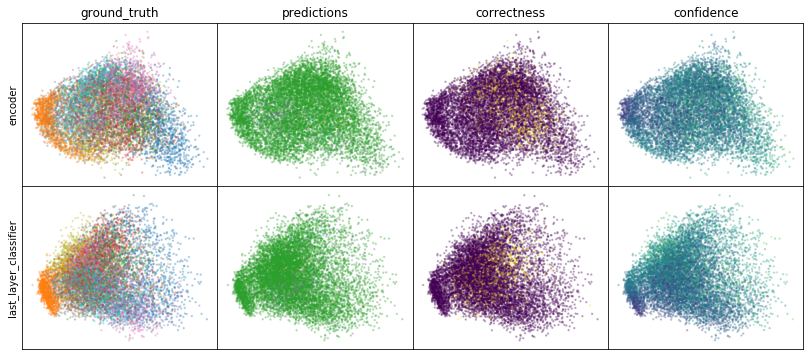

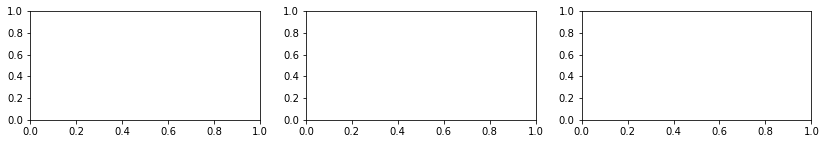

In [26]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=PCA, cmap='tab10', cmap2='tab10')

### Train model

In [27]:
N_EPOCHS = 50
n_neighbors=15
batch_size = 256 # 500
max_sample_repeats_per_epoch = 25
max_save_delta = 0.005

In [28]:
from tfumap.semisupervised import build_fuzzy_simplicial_set

In [29]:
from tfumap.paths import MODEL_DIR

In [30]:
# where to save checkpoints
cpt_path = MODEL_DIR / 'semisupervised' / dataset / datestring

In [31]:
BATCHES_PER_EPOCH = int(n_edges_per_epoch / batch_size)

In [32]:
patience = 10000 # wait this many batches without improvement before early stopping
min_delta = 0.0001 # threshold for what counts as an improvement
best_acc = 0 # the best current accuracy score
best_saved_acc = 0 # best accuracy on valid data that has been checkpointed
best_saved_batch = 0 # batch number for last good batch
max_reinitialize_delta = .01 # minimum loss in accuracy resulting in reinitialized weights
plot_frequency = 1000 # how frequently to plot
max_reloads = 10 # how often can we reload weights?
batch = 0; epoch = 0
batches_since_last_reload = 0

In [33]:
epochs_without_improvement = 0
max_epochs_without_improvement = 5 # allow the network 
reload_tolerance = 100 # allow the network at least reload_tolerance batches before reloading last weights

In [34]:
n_reloads = 0

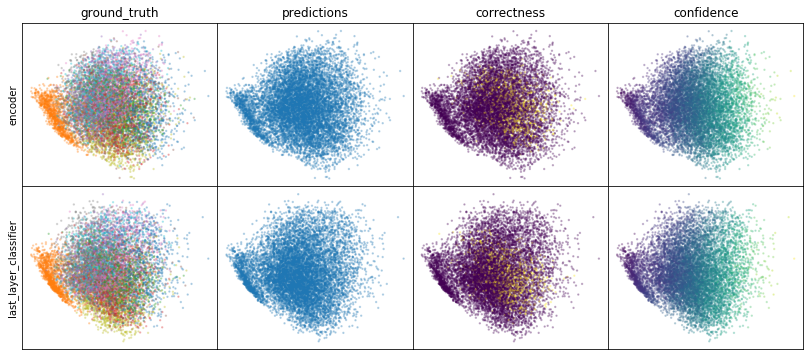

W0807 23:10:44.394021 140402527516416 legend.py:1282] No handles with labels found to put in legend.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:118: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:132: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
W0807 23:10:44.449979 140402527516416 legend.py:1282] No handles with labels found to put in legend.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:148: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
W0807 23:10:44.502825 140402527516416 legend.py:1282] No handles with labels found to put in legend.


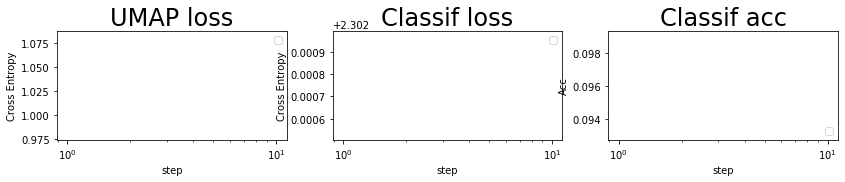

batch: 0 | train acc: 0.099 | val acc: 0.093
saving weights | batch = 100 | acc = 61.707
saving weights | batch = 104 | acc = 62.275
saving weights | batch = 108 | acc = 62.883
saving weights | batch = 112 | acc = 63.412
saving weights | batch = 117 | acc = 63.998
saving weights | batch = 121 | acc = 64.505
saving weights | batch = 127 | acc = 65.113
saving weights | batch = 132 | acc = 65.65
saving weights | batch = 138 | acc = 66.217
saving weights | batch = 145 | acc = 66.801
saving weights | batch = 152 | acc = 67.366
saving weights | batch = 159 | acc = 67.916
saving weights | batch = 168 | acc = 68.476
saving weights | batch = 177 | acc = 68.996
saving weights | batch = 186 | acc = 69.497
saving weights | batch = 196 | acc = 70.02
saving weights | batch = 207 | acc = 70.543
saving weights | batch = 218 | acc = 71.048
saving weights | batch = 231 | acc = 71.562
saving weights | batch = 245 | acc = 72.063
saving weights | batch = 260 | acc = 72.564
saving weights | batch = 278 | ac

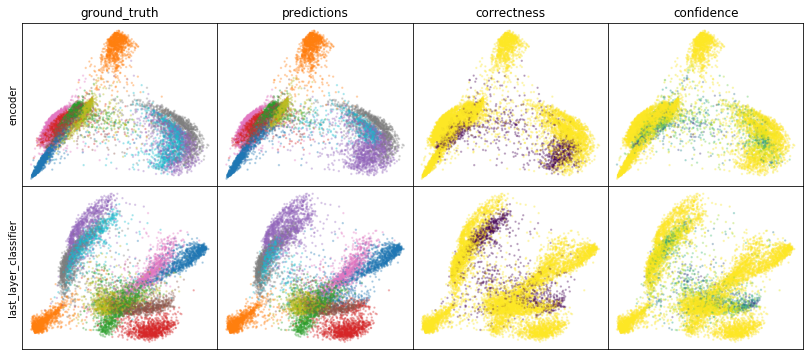

W0807 23:12:11.977433 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:12:12.036905 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:12:12.097624 140402527516416 legend.py:1282] No handles with labels found to put in legend.


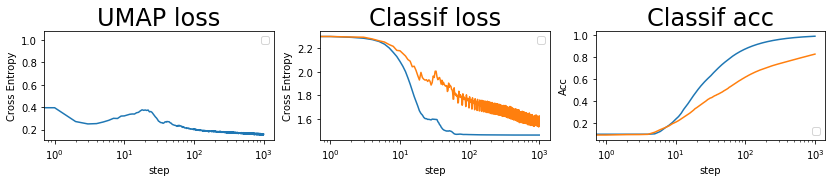

batch: 1000 | train acc: 0.9871 | val acc: 0.8254
saving weights | batch = 1039 | acc = 82.787
saving weights | batch = 1126 | acc = 83.288
saving weights | batch = 1221 | acc = 83.789
saving weights | batch = 1324 | acc = 84.29
saving weights | batch = 1428 | acc = 84.791
saving weights | batch = 1531 | acc = 85.294
saving weights | batch = 1639 | acc = 85.798
saving weights | batch = 1749 | acc = 86.3
saving weights | batch = 1861 | acc = 86.801
saving weights | batch = 1975 | acc = 87.302


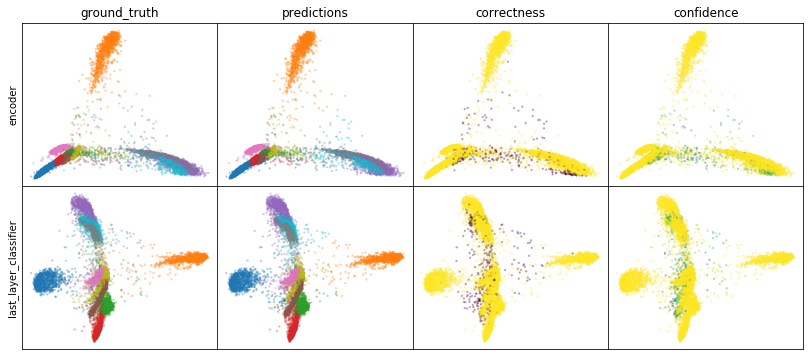

W0807 23:13:37.307895 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:13:37.368145 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:13:37.427576 140402527516416 legend.py:1282] No handles with labels found to put in legend.


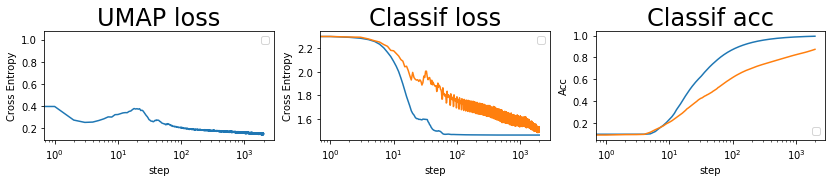

batch: 2000 | train acc: 0.9936 | val acc: 0.874
saving weights | batch = 2102 | acc = 87.804
saving weights | batch = 2243 | acc = 88.306
saving weights | batch = 2396 | acc = 88.808
saving weights | batch = 2577 | acc = 89.311
saving weights | batch = 2777 | acc = 89.812


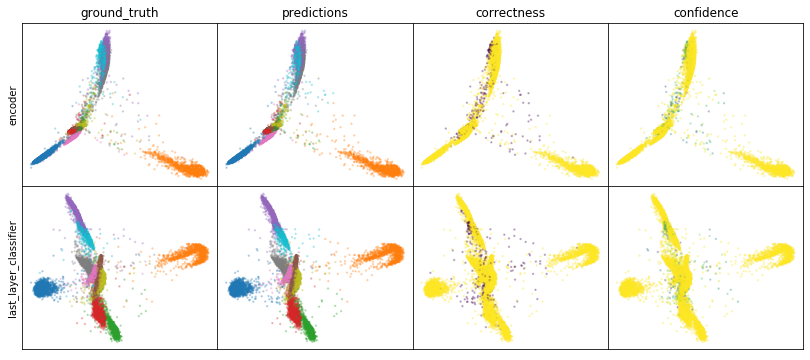

W0807 23:15:02.001778 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:15:02.067734 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:15:02.136720 140402527516416 legend.py:1282] No handles with labels found to put in legend.


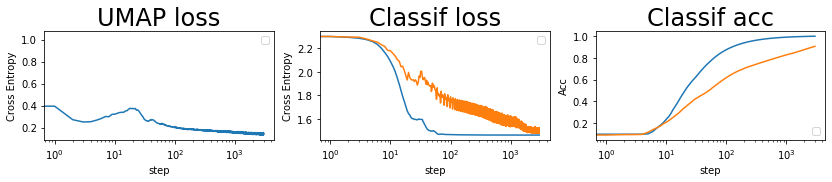

batch: 3000 | train acc: 0.9957 | val acc: 0.903
saving weights | batch = 3006 | acc = 90.313
saving weights | batch = 3265 | acc = 90.814
saving weights | batch = 3569 | acc = 91.315
saving weights | batch = 3921 | acc = 91.816


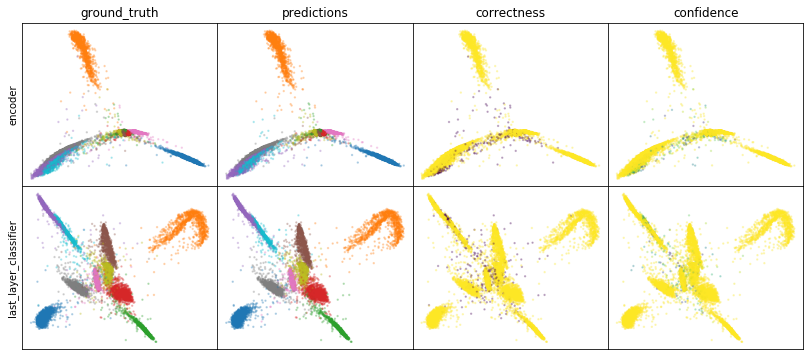

W0807 23:16:28.363803 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:16:28.434914 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:16:28.500829 140402527516416 legend.py:1282] No handles with labels found to put in legend.


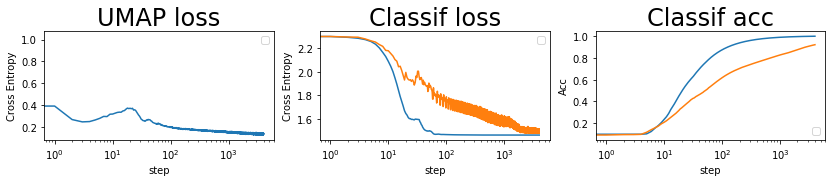

batch: 4000 | train acc: 0.9968 | val acc: 0.9192
saving weights | batch = 4347 | acc = 92.317
saving weights | batch = 4853 | acc = 92.817


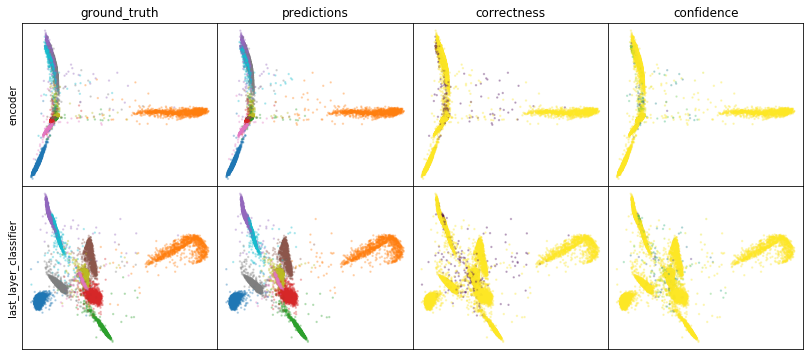

W0807 23:17:54.121317 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:17:54.197148 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:17:54.269200 140402527516416 legend.py:1282] No handles with labels found to put in legend.


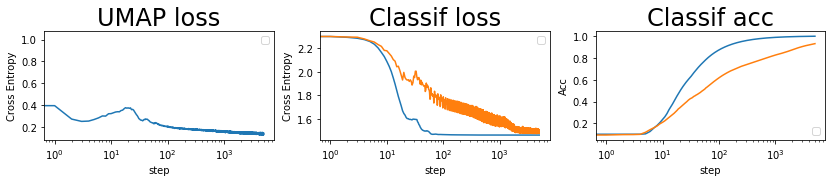

batch: 5000 | train acc: 0.9974 | val acc: 0.9294
saving weights | batch = 5481 | acc = 93.317


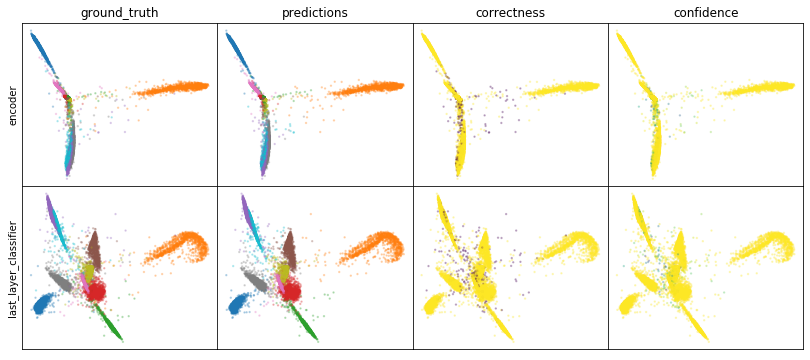

W0807 23:19:19.702184 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:19:19.775240 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:19:19.846624 140402527516416 legend.py:1282] No handles with labels found to put in legend.


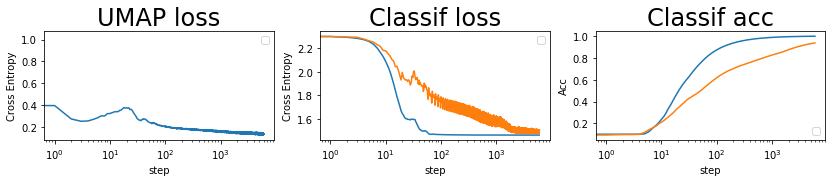

batch: 6000 | train acc: 0.9979 | val acc: 0.9366
saving weights | batch = 6261 | acc = 93.817


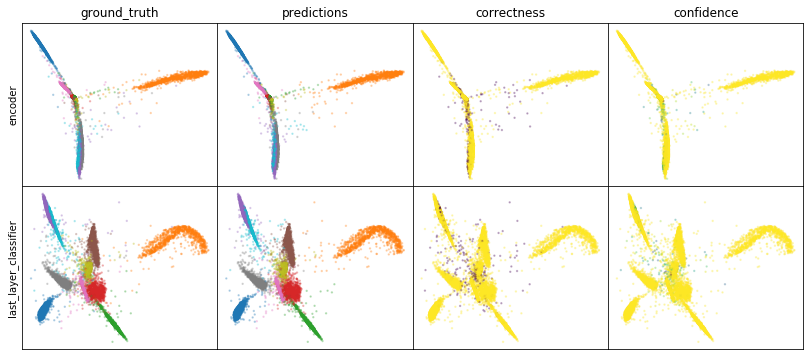

W0807 23:20:45.549497 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:20:45.635795 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:20:45.715027 140402527516416 legend.py:1282] No handles with labels found to put in legend.


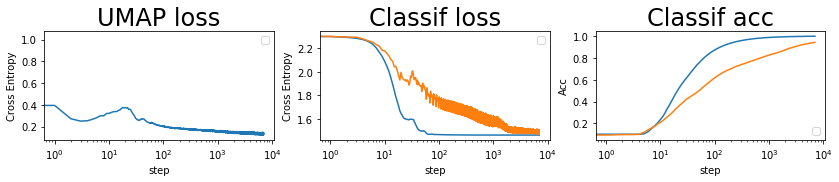

batch: 7000 | train acc: 0.9982 | val acc: 0.9418
saving weights | batch = 7327 | acc = 94.318


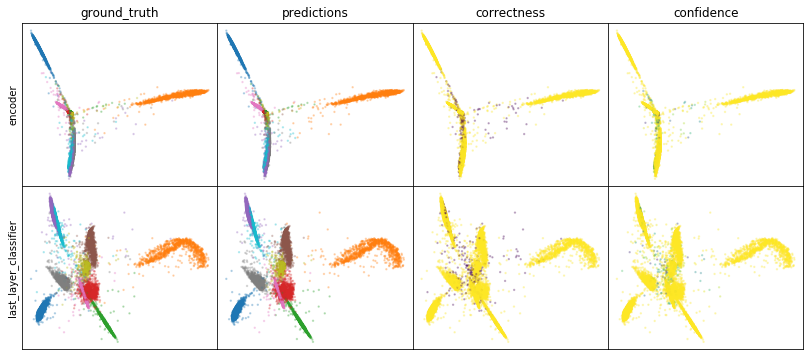

W0807 23:22:12.070358 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:22:12.148426 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:22:12.224620 140402527516416 legend.py:1282] No handles with labels found to put in legend.


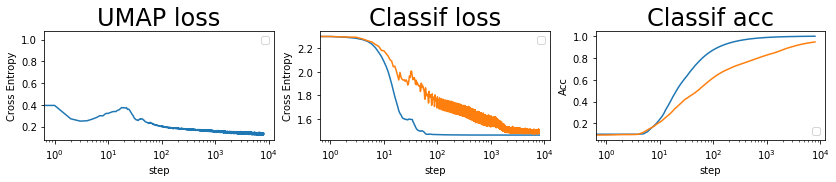

batch: 8000 | train acc: 0.9984 | val acc: 0.9456
saving weights | batch = 8832 | acc = 94.818


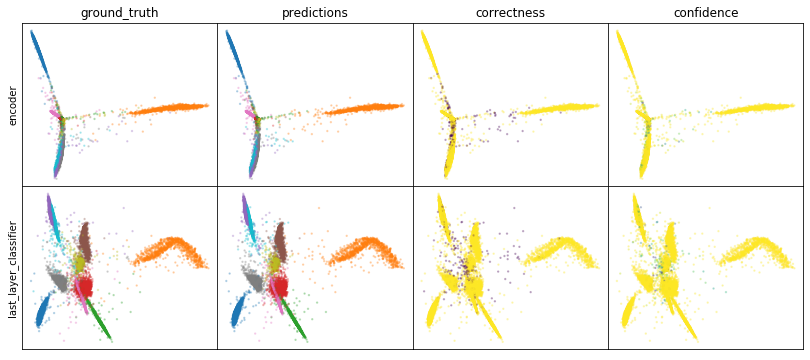

W0807 23:23:39.348124 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:23:39.425530 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:23:39.505814 140402527516416 legend.py:1282] No handles with labels found to put in legend.


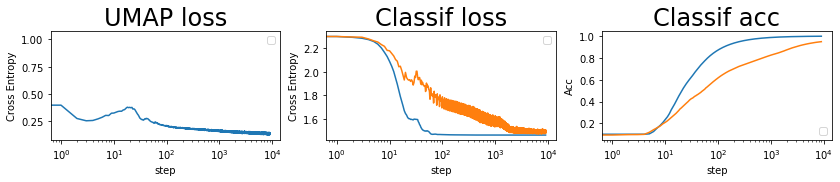

batch: 9000 | train acc: 0.9986 | val acc: 0.9486


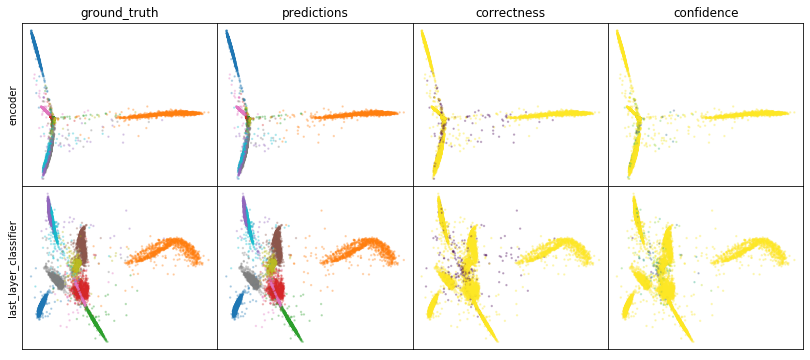

W0807 23:25:07.296268 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:25:07.380854 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:25:07.463826 140402527516416 legend.py:1282] No handles with labels found to put in legend.


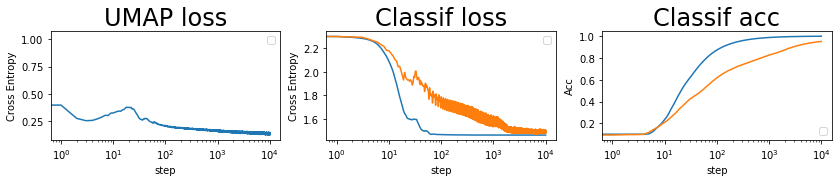

batch: 10000 | train acc: 0.9987 | val acc: 0.951


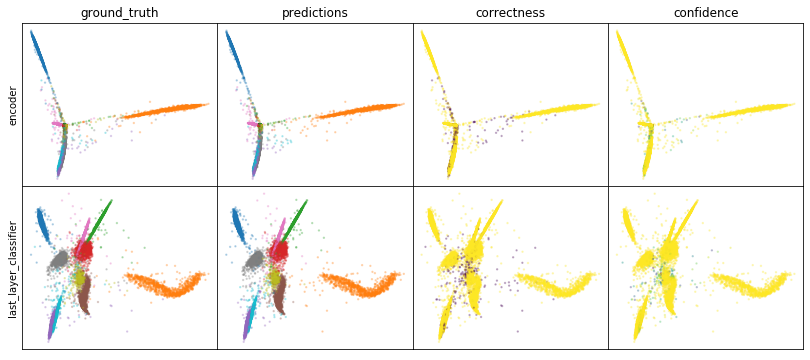

W0807 23:26:34.911620 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:26:34.995334 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:26:35.077998 140402527516416 legend.py:1282] No handles with labels found to put in legend.


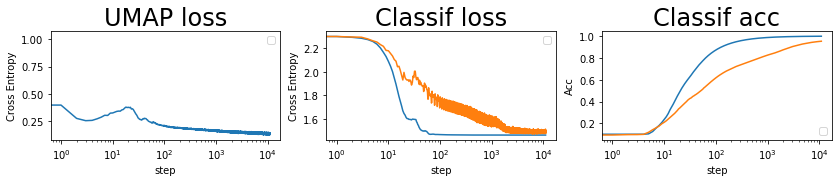

batch: 11000 | train acc: 0.9988 | val acc: 0.9529
saving weights | batch = 11140 | acc = 95.318


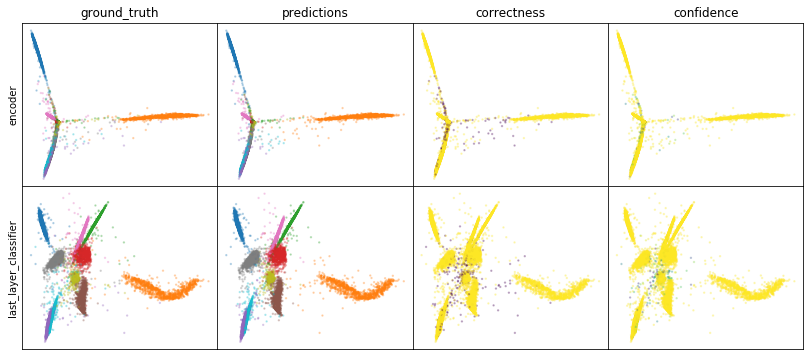

W0807 23:28:04.115516 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:28:04.203288 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:28:04.292278 140402527516416 legend.py:1282] No handles with labels found to put in legend.


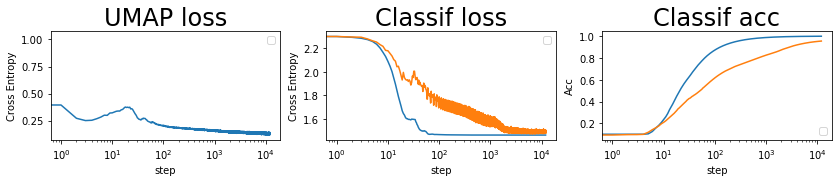

batch: 12000 | train acc: 0.9989 | val acc: 0.9546


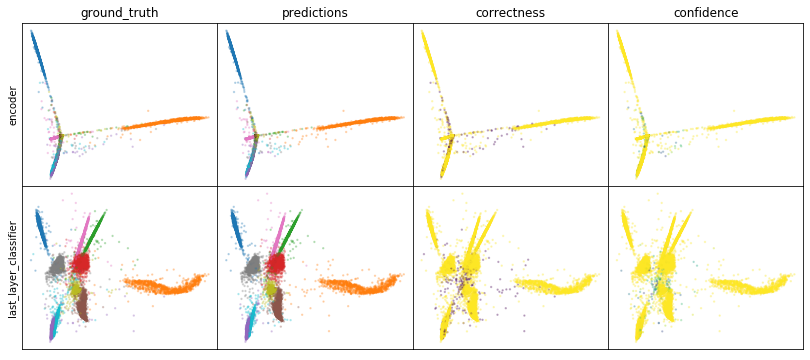

W0807 23:29:33.459534 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:29:33.554241 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:29:33.647956 140402527516416 legend.py:1282] No handles with labels found to put in legend.


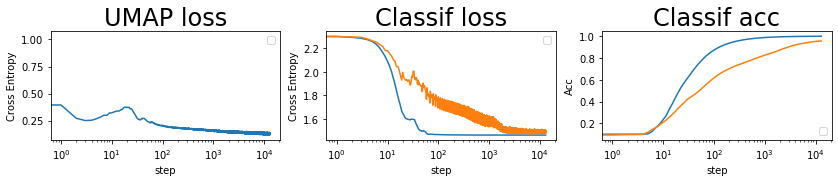

batch: 13000 | train acc: 0.999 | val acc: 0.956


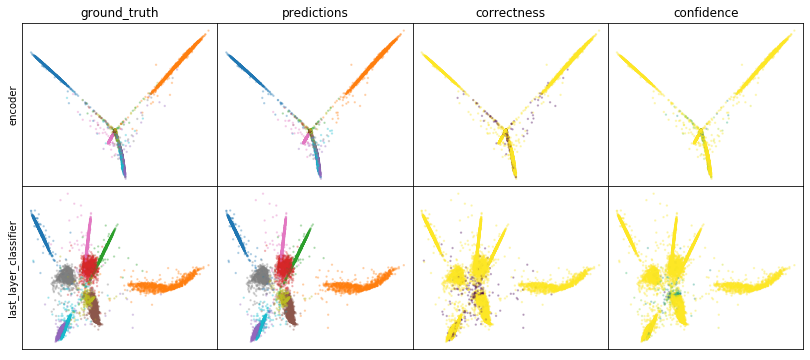

W0807 23:31:02.632765 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:31:02.728208 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:31:02.823504 140402527516416 legend.py:1282] No handles with labels found to put in legend.


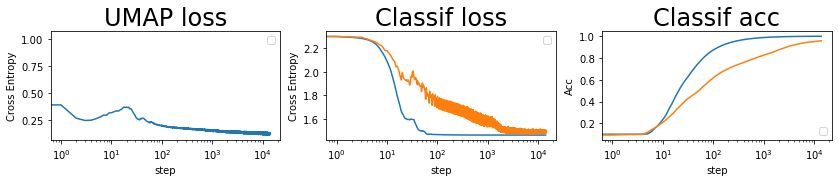

batch: 14000 | train acc: 0.9991 | val acc: 0.9572
saving weights | batch = 14905 | acc = 95.818


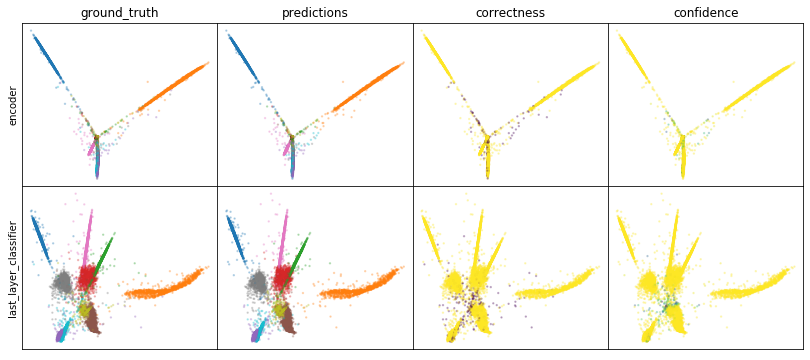

W0807 23:32:33.651473 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:32:33.755501 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:32:33.858774 140402527516416 legend.py:1282] No handles with labels found to put in legend.


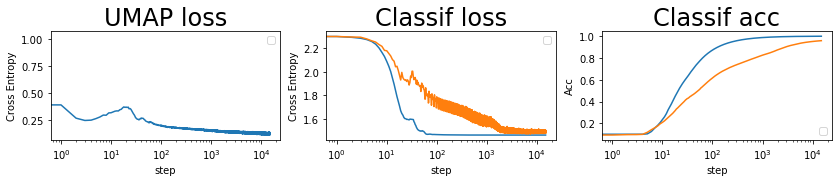

batch: 15000 | train acc: 0.9991 | val acc: 0.9583


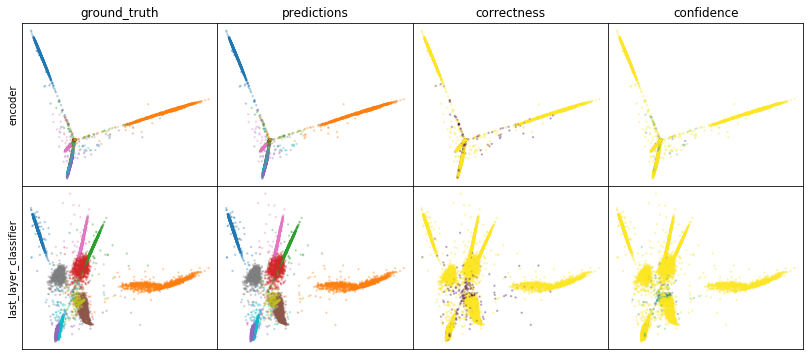

W0807 23:34:03.765115 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:34:03.868461 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:34:03.968686 140402527516416 legend.py:1282] No handles with labels found to put in legend.


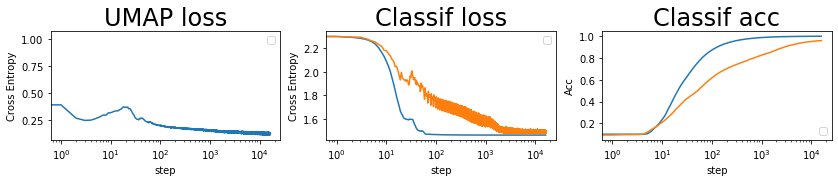

batch: 16000 | train acc: 0.9992 | val acc: 0.9591


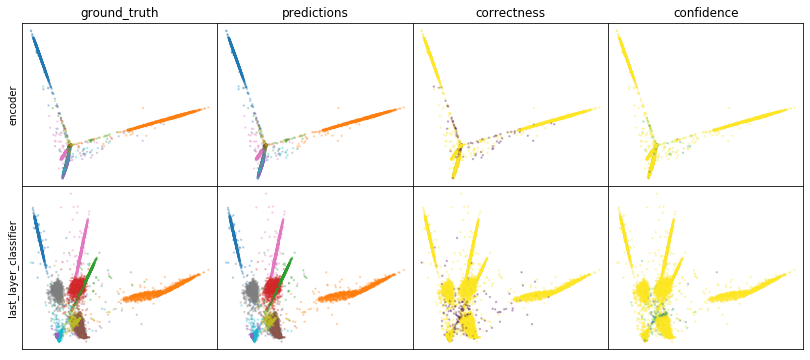

W0807 23:35:34.252845 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:35:34.358435 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:35:34.466889 140402527516416 legend.py:1282] No handles with labels found to put in legend.


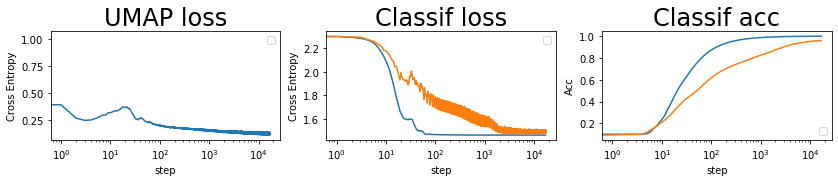

batch: 17000 | train acc: 0.9992 | val acc: 0.9599


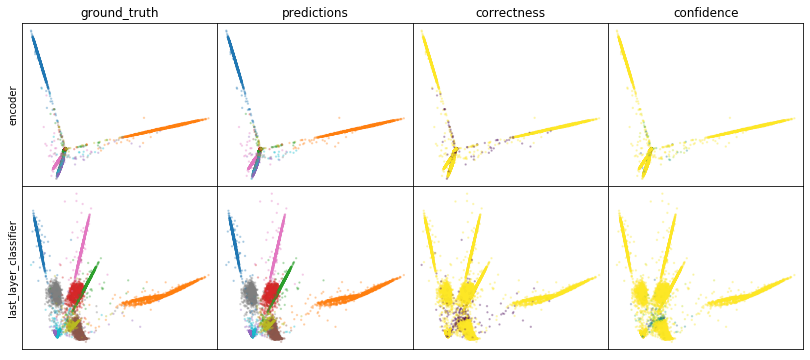

W0807 23:37:05.724341 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:37:05.828430 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:37:05.928171 140402527516416 legend.py:1282] No handles with labels found to put in legend.


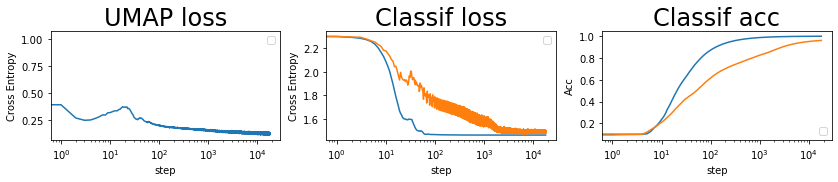

batch: 18000 | train acc: 0.9993 | val acc: 0.9606


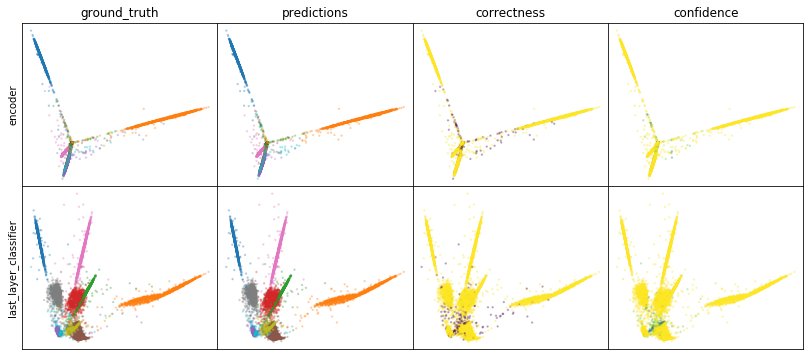

W0807 23:38:37.600109 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:38:37.709146 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:38:37.815896 140402527516416 legend.py:1282] No handles with labels found to put in legend.


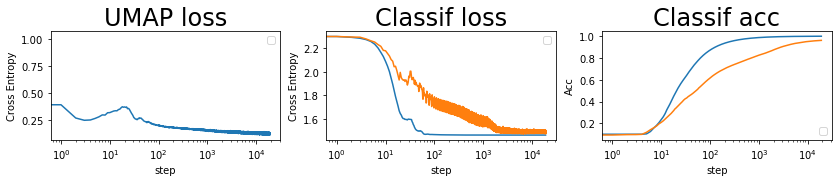

batch: 19000 | train acc: 0.9993 | val acc: 0.9612


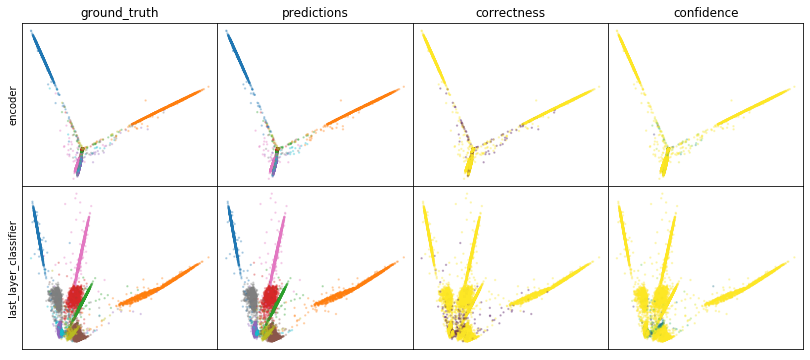

W0807 23:40:09.460708 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:40:09.567648 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:40:09.676080 140402527516416 legend.py:1282] No handles with labels found to put in legend.


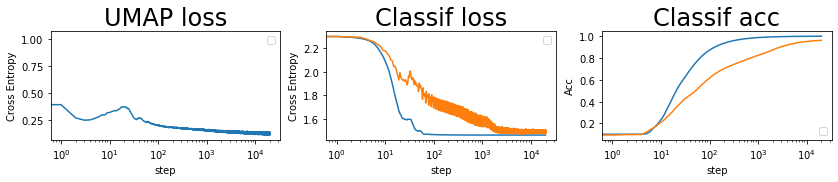

batch: 20000 | train acc: 0.9994 | val acc: 0.9618


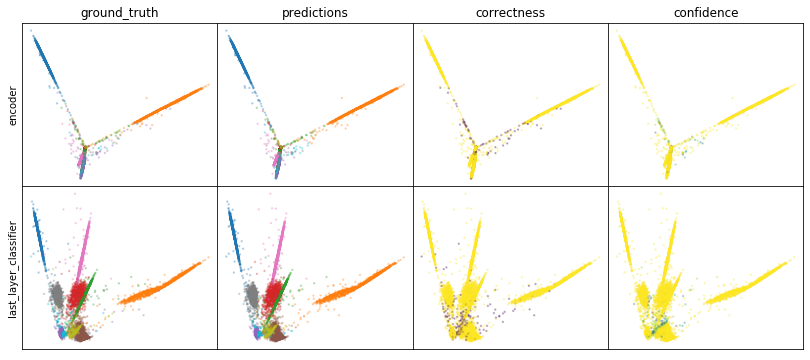

W0807 23:41:41.551107 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:41:41.668945 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:41:41.785855 140402527516416 legend.py:1282] No handles with labels found to put in legend.


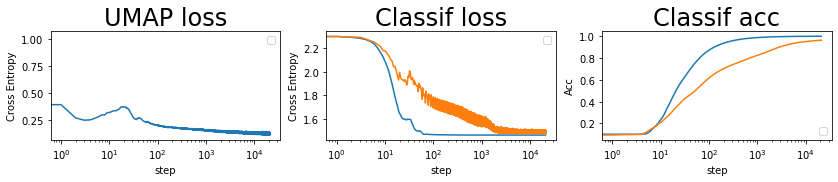

batch: 21000 | train acc: 0.9994 | val acc: 0.9623


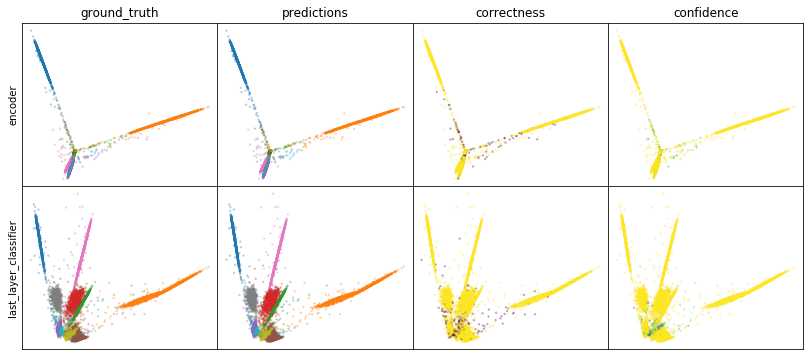

W0807 23:43:15.086575 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:43:15.222720 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:43:15.336514 140402527516416 legend.py:1282] No handles with labels found to put in legend.


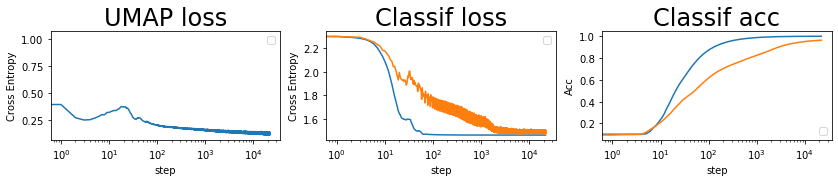

batch: 22000 | train acc: 0.9994 | val acc: 0.9628


saving weights | batch = 22882 | acc = 96.318


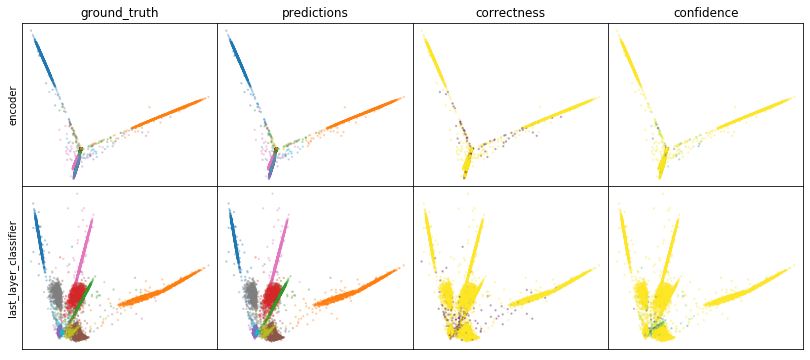

W0807 23:44:49.327875 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:44:49.447982 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:44:49.565641 140402527516416 legend.py:1282] No handles with labels found to put in legend.


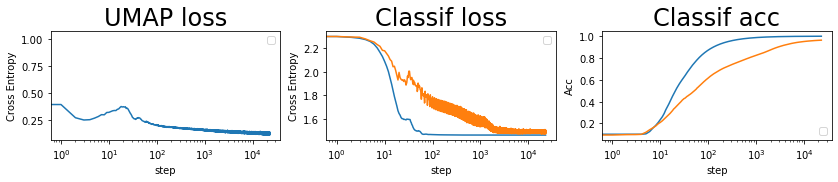

batch: 23000 | train acc: 0.9994 | val acc: 0.9632


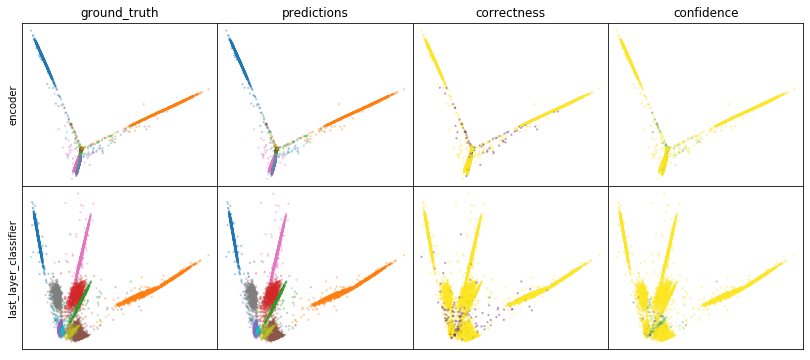

W0807 23:46:23.109781 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:46:23.254068 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:46:23.380418 140402527516416 legend.py:1282] No handles with labels found to put in legend.


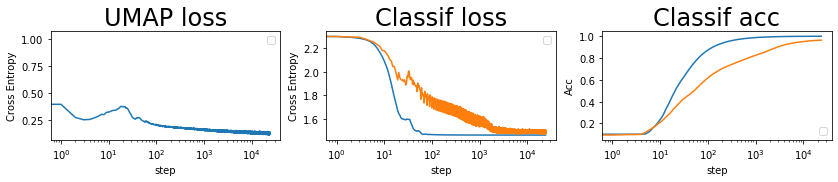

batch: 24000 | train acc: 0.9995 | val acc: 0.9637


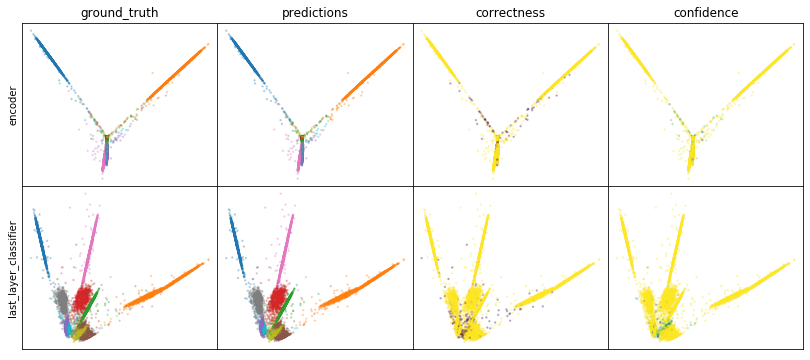

W0807 23:47:57.195647 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:47:57.319413 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:47:57.448807 140402527516416 legend.py:1282] No handles with labels found to put in legend.


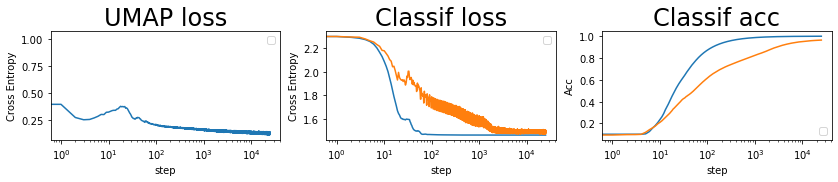

batch: 25000 | train acc: 0.9995 | val acc: 0.9641


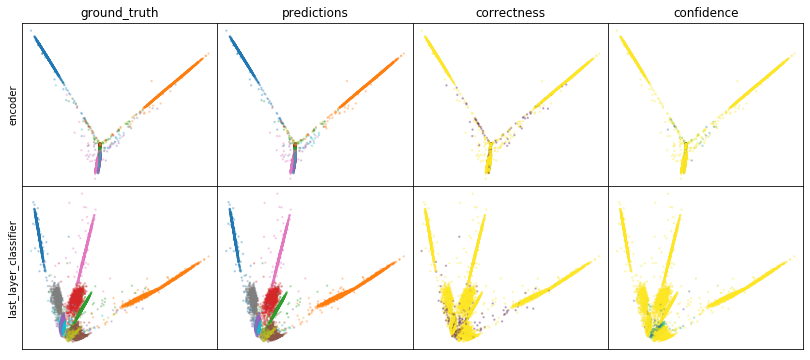

W0807 23:49:35.177107 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:49:35.307168 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:49:35.436868 140402527516416 legend.py:1282] No handles with labels found to put in legend.


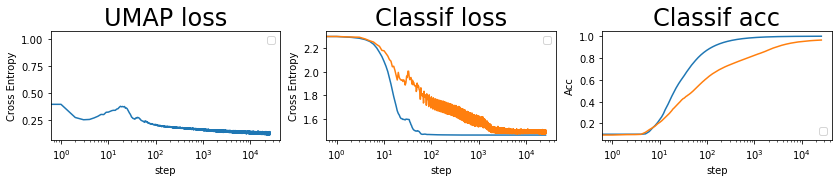

batch: 26000 | train acc: 0.9995 | val acc: 0.9645


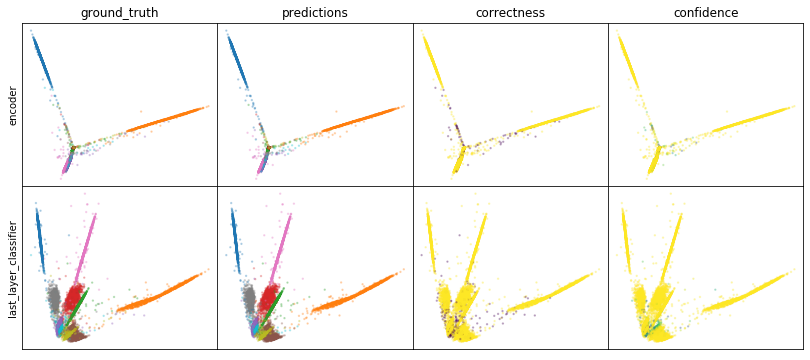

W0807 23:51:10.611394 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:51:10.745136 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:51:10.875850 140402527516416 legend.py:1282] No handles with labels found to put in legend.


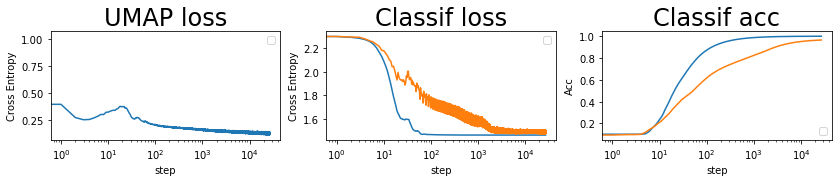

batch: 27000 | train acc: 0.9995 | val acc: 0.9648


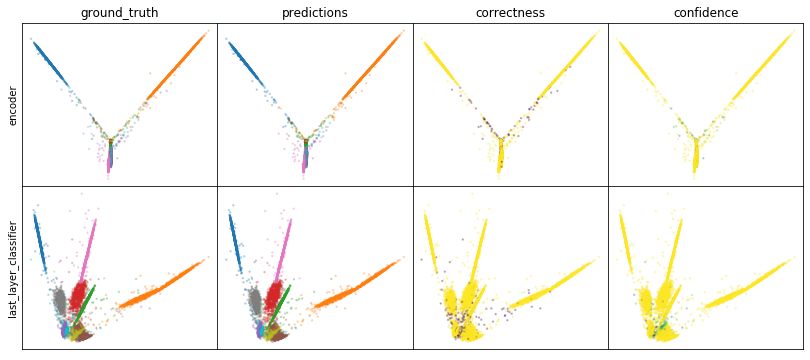

W0807 23:52:46.276494 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:52:46.414318 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:52:46.549639 140402527516416 legend.py:1282] No handles with labels found to put in legend.


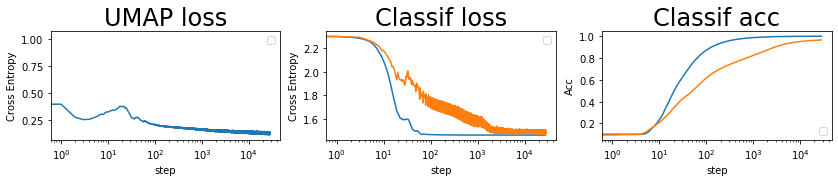

batch: 28000 | train acc: 0.9995 | val acc: 0.9651


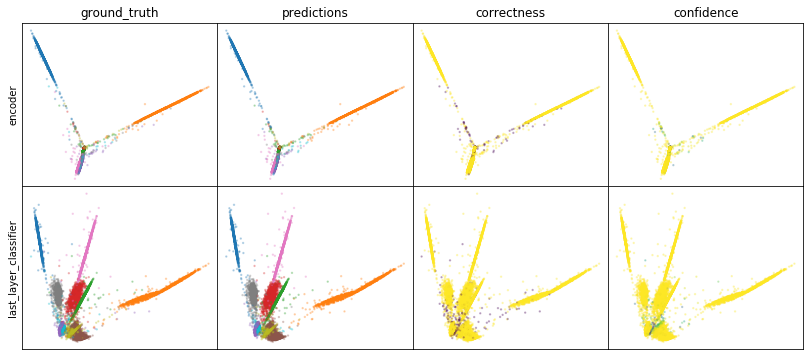

W0807 23:54:37.157135 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:54:37.297663 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:54:37.434599 140402527516416 legend.py:1282] No handles with labels found to put in legend.


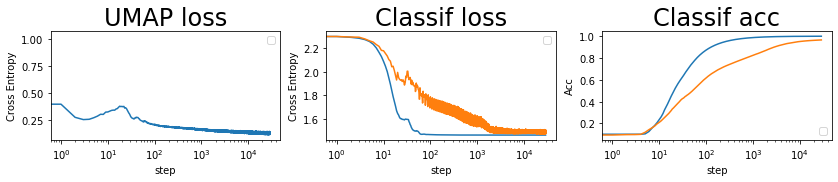

batch: 29000 | train acc: 0.9996 | val acc: 0.9655


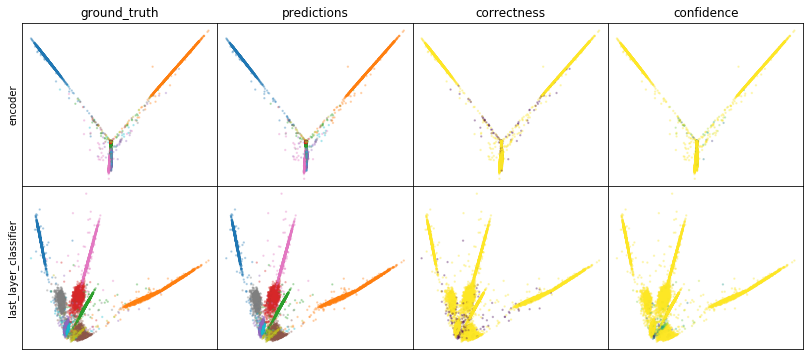

W0807 23:56:12.086257 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:56:12.224871 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:56:12.363128 140402527516416 legend.py:1282] No handles with labels found to put in legend.


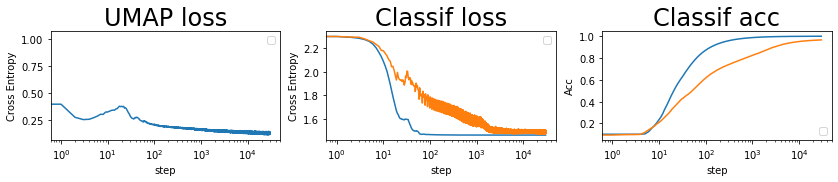

batch: 30000 | train acc: 0.9996 | val acc: 0.9657


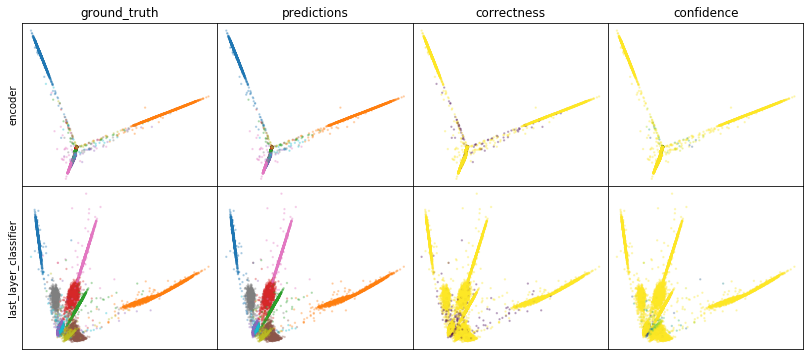

W0807 23:57:48.322574 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:57:48.464726 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:57:48.608745 140402527516416 legend.py:1282] No handles with labels found to put in legend.


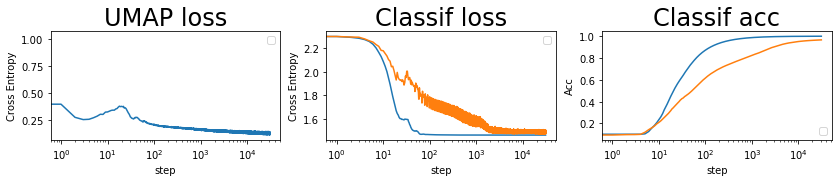

batch: 31000 | train acc: 0.9996 | val acc: 0.966


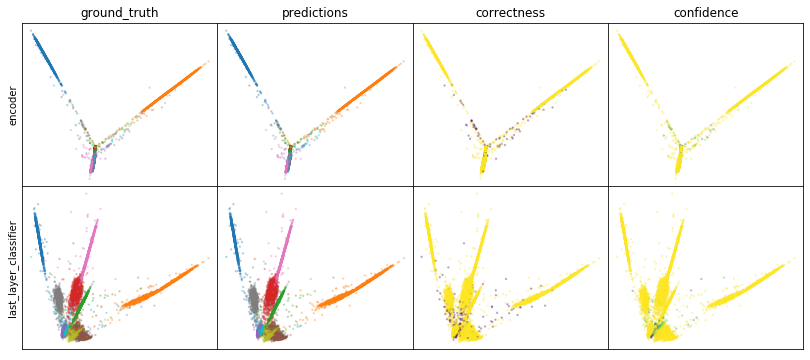

W0807 23:59:26.342422 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:59:26.484623 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0807 23:59:26.623476 140402527516416 legend.py:1282] No handles with labels found to put in legend.


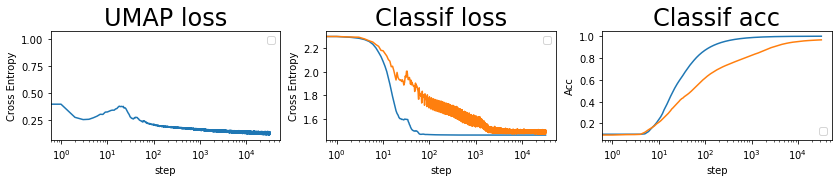

batch: 32000 | train acc: 0.9996 | val acc: 0.9663


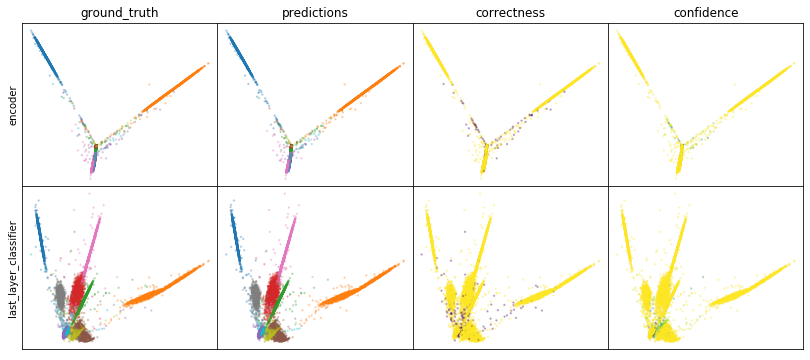

W0808 00:01:04.926982 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:01:05.099650 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:01:05.283580 140402527516416 legend.py:1282] No handles with labels found to put in legend.


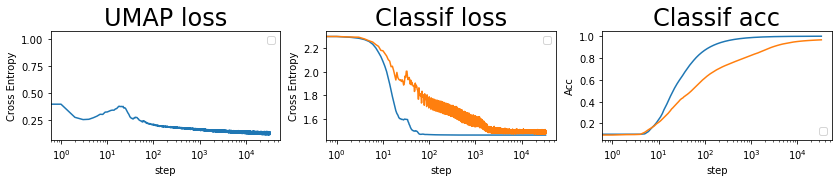

batch: 33000 | train acc: 0.9996 | val acc: 0.9665


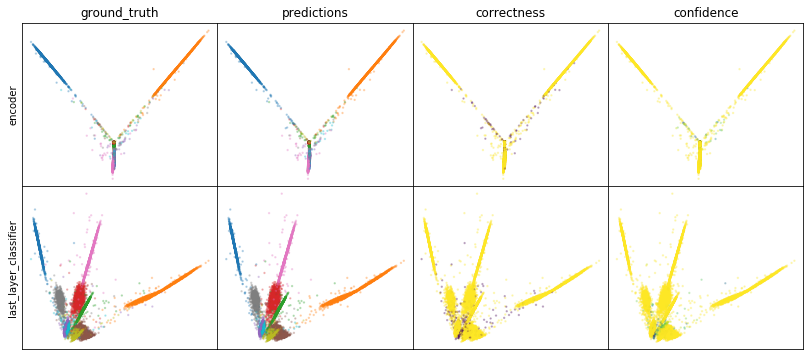

W0808 00:02:43.280250 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:02:43.445473 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:02:43.615509 140402527516416 legend.py:1282] No handles with labels found to put in legend.


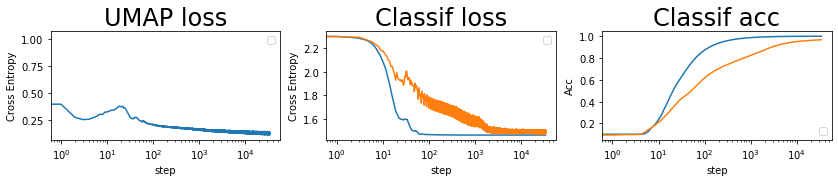

batch: 34000 | train acc: 0.9996 | val acc: 0.9668


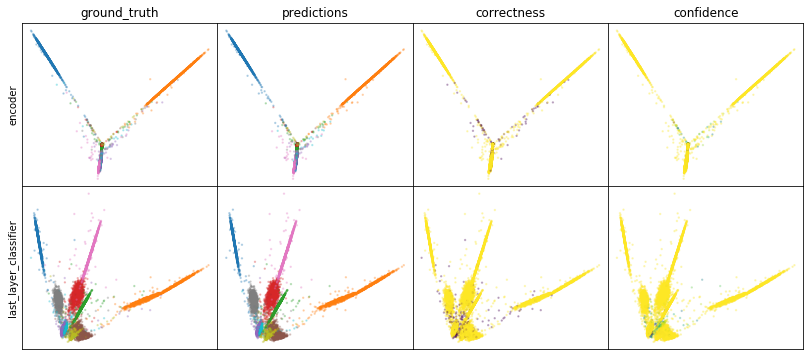

W0808 00:04:23.206801 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:04:23.375182 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:04:23.525307 140402527516416 legend.py:1282] No handles with labels found to put in legend.


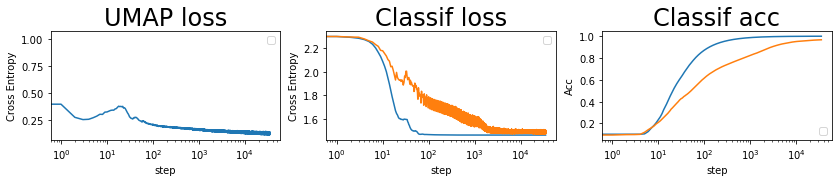

batch: 35000 | train acc: 0.9996 | val acc: 0.967


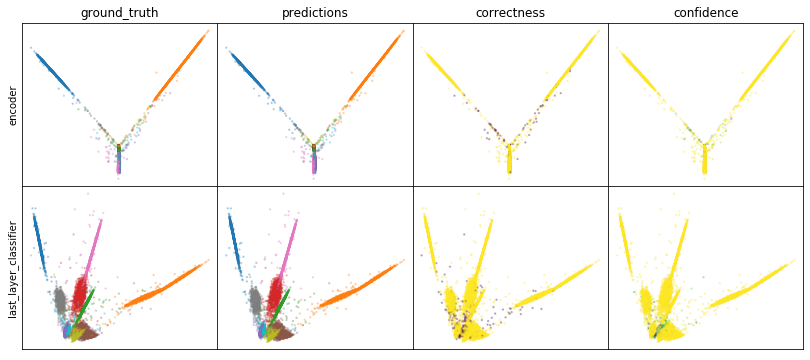

W0808 00:06:03.429909 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:06:03.586792 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:06:03.741353 140402527516416 legend.py:1282] No handles with labels found to put in legend.


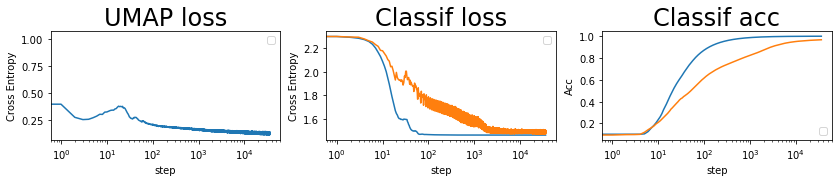

batch: 36000 | train acc: 0.9996 | val acc: 0.9672


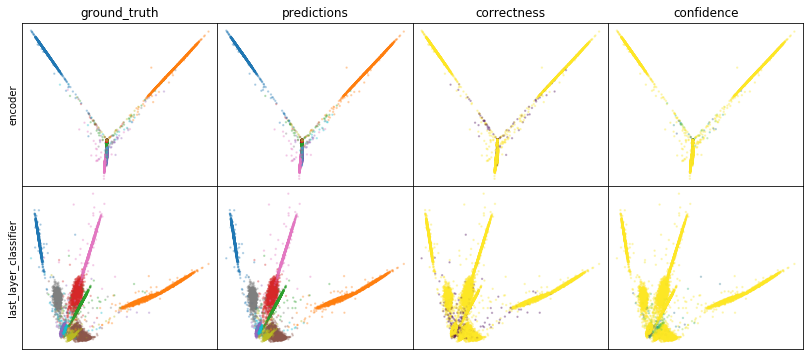

W0808 00:07:43.479277 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:07:43.636446 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:07:43.787909 140402527516416 legend.py:1282] No handles with labels found to put in legend.


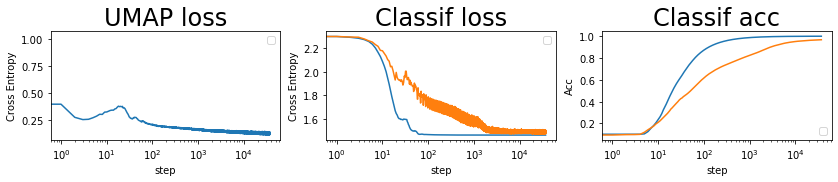

batch: 37000 | train acc: 0.9997 | val acc: 0.9674


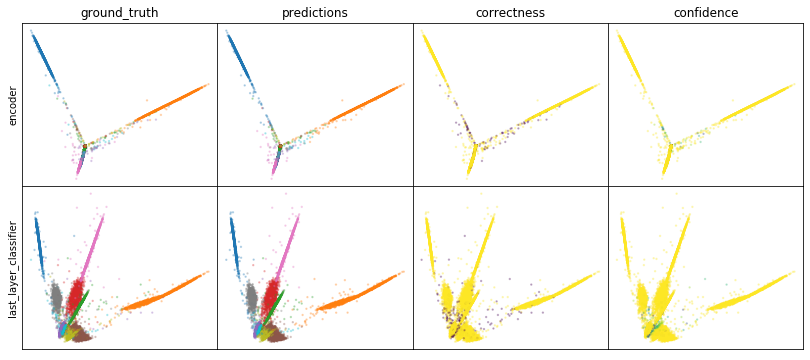

W0808 00:09:23.733772 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:09:23.893957 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:09:24.050519 140402527516416 legend.py:1282] No handles with labels found to put in legend.


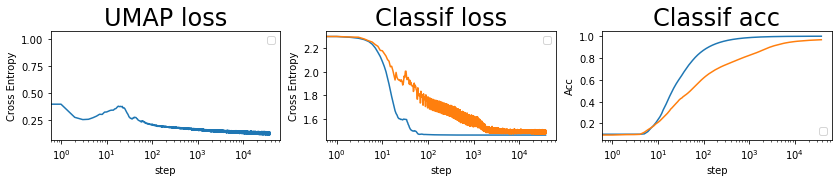

batch: 38000 | train acc: 0.9997 | val acc: 0.9676


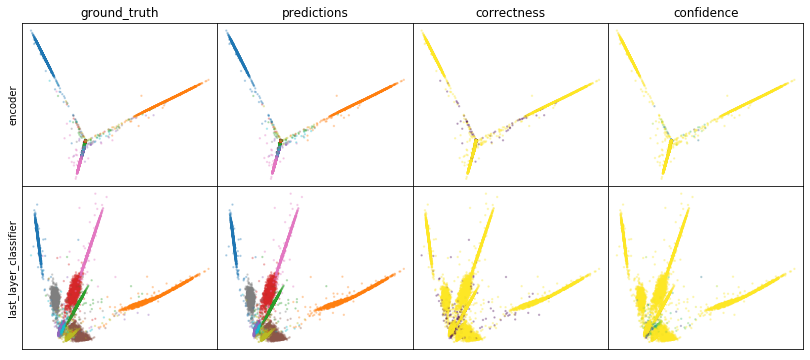

W0808 00:11:04.483955 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:11:04.651478 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:11:04.813015 140402527516416 legend.py:1282] No handles with labels found to put in legend.


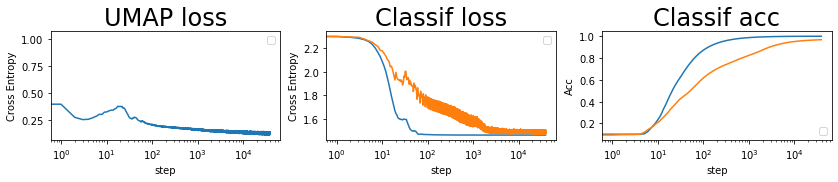

batch: 39000 | train acc: 0.9997 | val acc: 0.9677


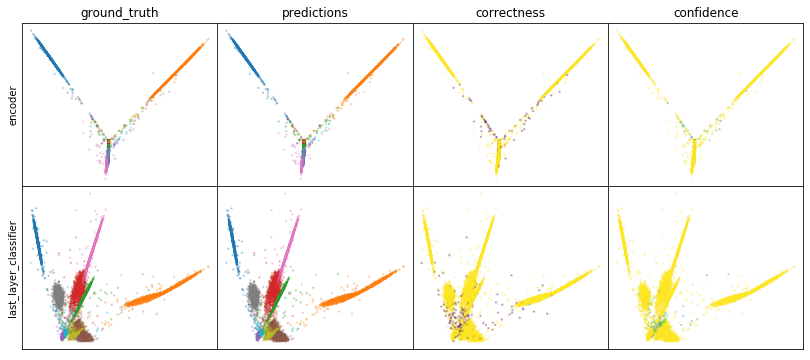

W0808 00:12:46.730697 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:12:46.909373 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:12:47.076756 140402527516416 legend.py:1282] No handles with labels found to put in legend.


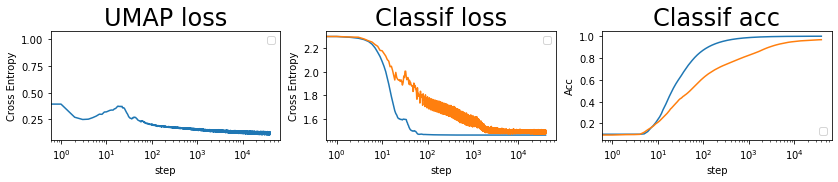

batch: 40000 | train acc: 0.9997 | val acc: 0.9679


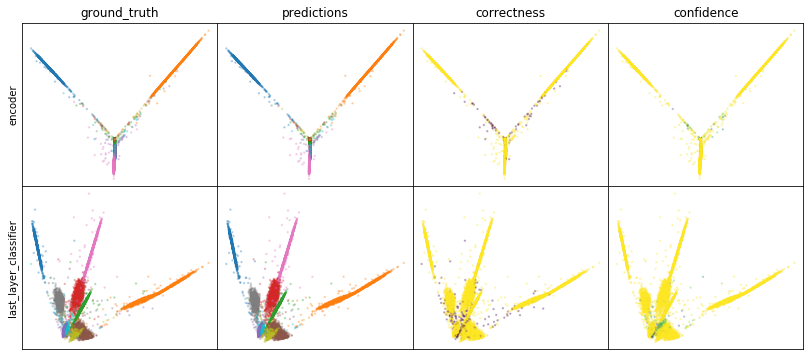

W0808 00:14:28.731060 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:14:28.900295 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:14:29.081144 140402527516416 legend.py:1282] No handles with labels found to put in legend.


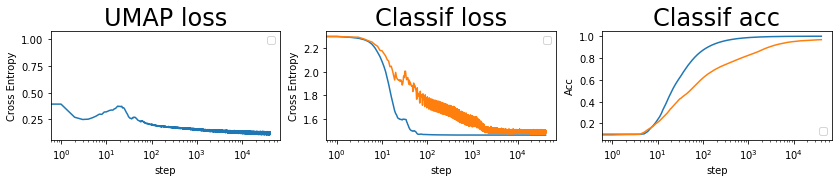

batch: 41000 | train acc: 0.9997 | val acc: 0.9681
saving weights | batch = 41889 | acc = 96.818


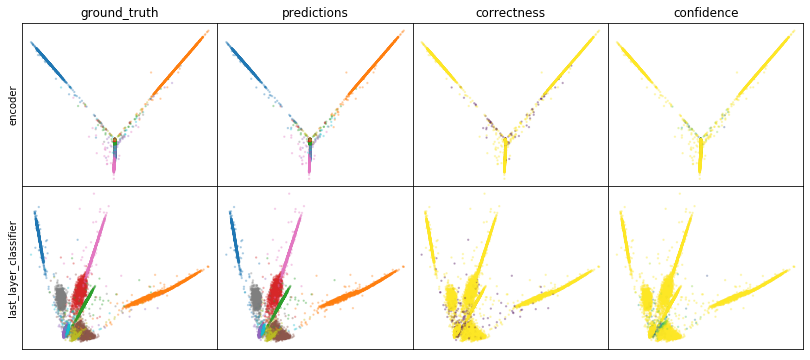

W0808 00:16:10.817250 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:16:10.991430 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:16:11.158261 140402527516416 legend.py:1282] No handles with labels found to put in legend.


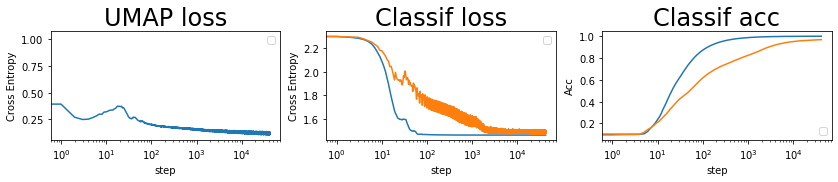

batch: 42000 | train acc: 0.9997 | val acc: 0.9682


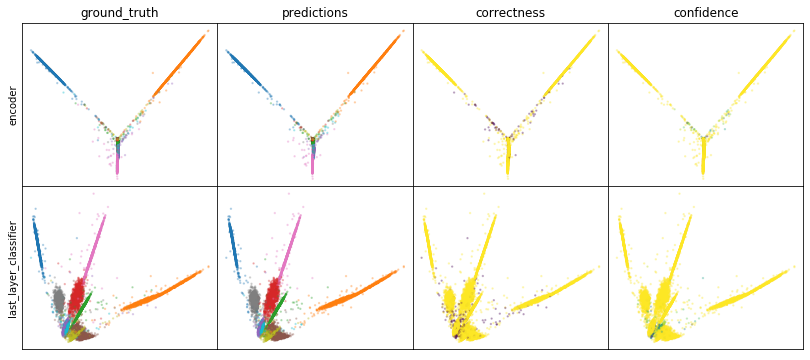

W0808 00:17:53.785653 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:17:53.964504 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:17:54.143739 140402527516416 legend.py:1282] No handles with labels found to put in legend.


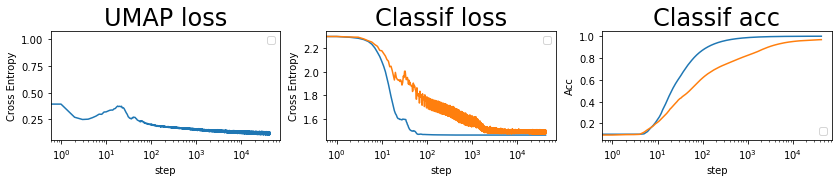

batch: 43000 | train acc: 0.9997 | val acc: 0.9683


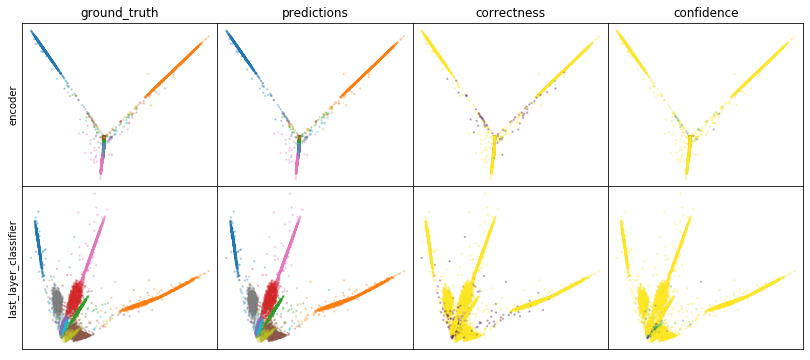

W0808 00:19:36.216024 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:19:36.392613 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:19:36.565171 140402527516416 legend.py:1282] No handles with labels found to put in legend.


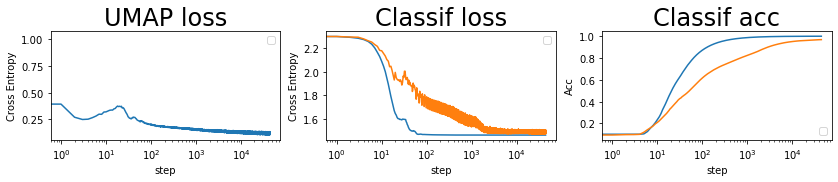

batch: 44000 | train acc: 0.9997 | val acc: 0.9685


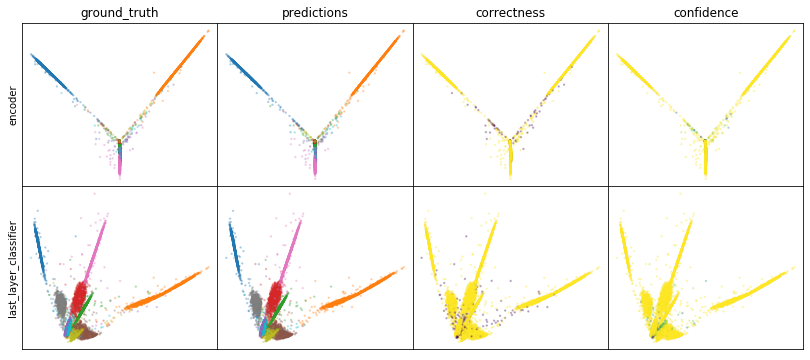

W0808 00:21:19.271034 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:21:19.449205 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:21:19.632503 140402527516416 legend.py:1282] No handles with labels found to put in legend.


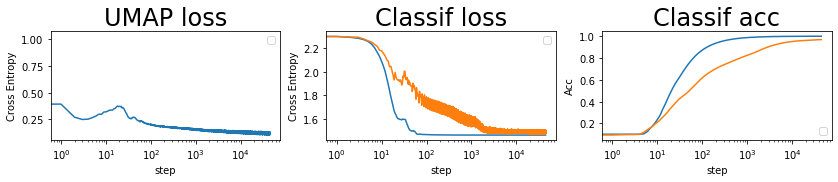

batch: 45000 | train acc: 0.9997 | val acc: 0.9686


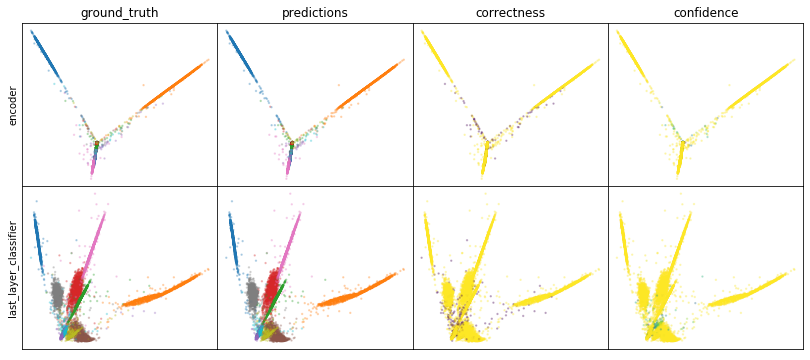

W0808 00:23:04.021185 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:23:04.206358 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:23:04.383126 140402527516416 legend.py:1282] No handles with labels found to put in legend.


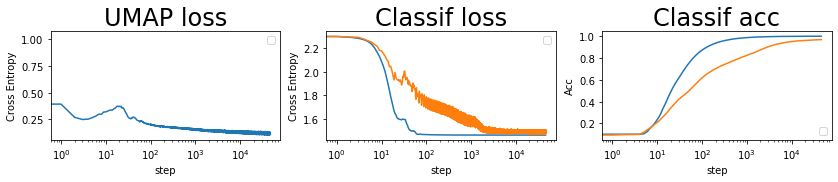

batch: 46000 | train acc: 0.9997 | val acc: 0.9687


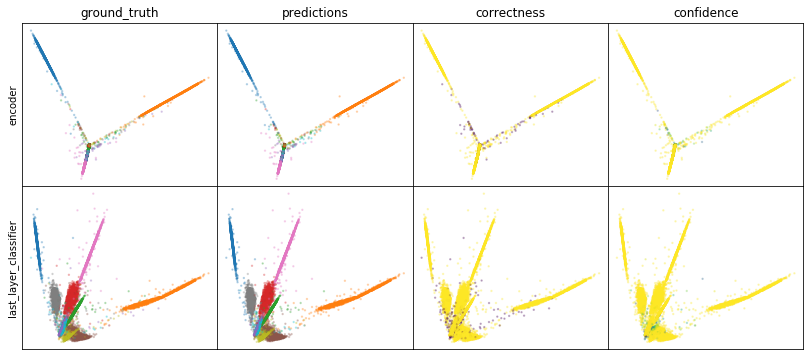

W0808 00:24:48.542273 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:24:48.725037 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:24:48.907978 140402527516416 legend.py:1282] No handles with labels found to put in legend.


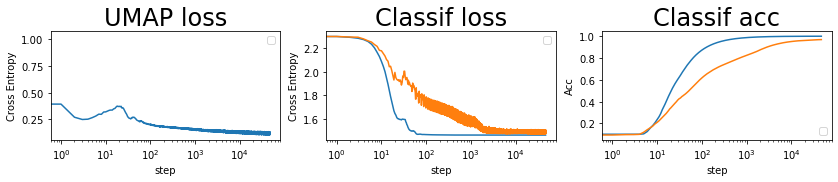

batch: 47000 | train acc: 0.9997 | val acc: 0.9688


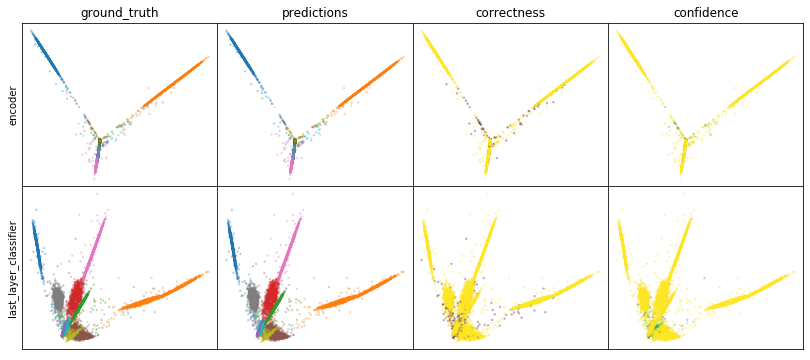

W0808 00:26:34.462838 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:26:34.652426 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:26:34.836259 140402527516416 legend.py:1282] No handles with labels found to put in legend.


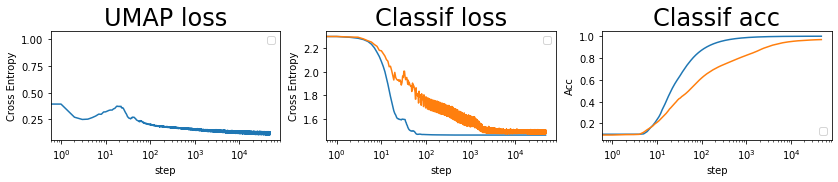

batch: 48000 | train acc: 0.9997 | val acc: 0.9689


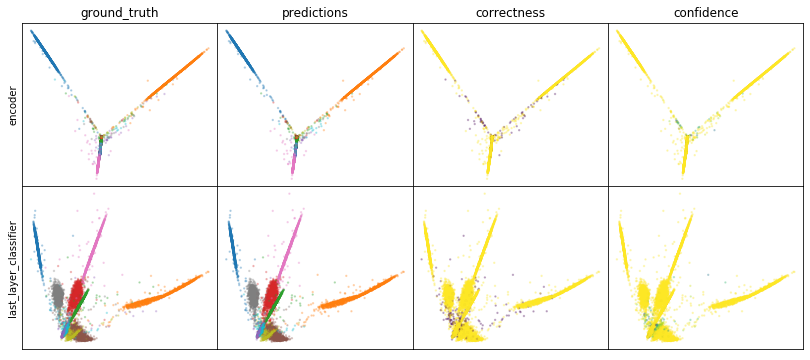

W0808 00:28:19.088125 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:28:19.277507 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:28:19.461700 140402527516416 legend.py:1282] No handles with labels found to put in legend.


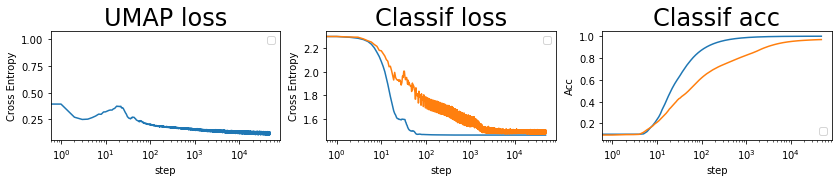

batch: 49000 | train acc: 0.9997 | val acc: 0.969


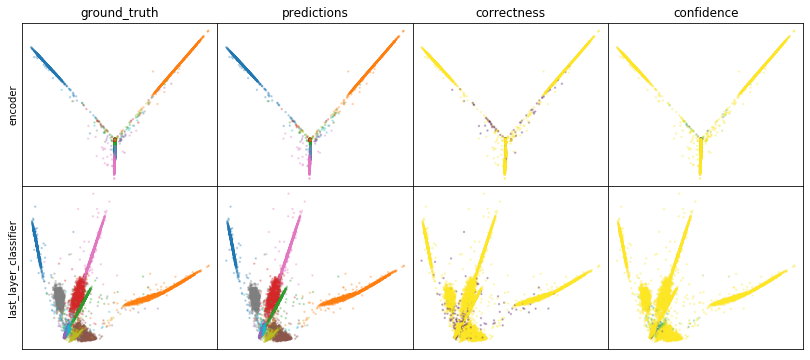

W0808 00:30:04.617846 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:30:04.812642 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:30:05.008404 140402527516416 legend.py:1282] No handles with labels found to put in legend.


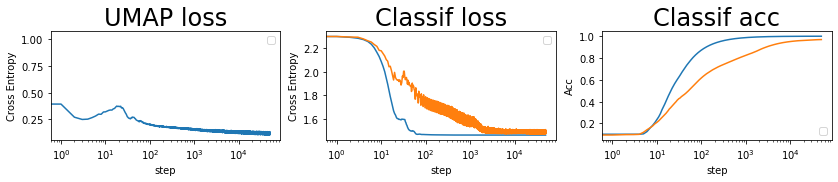

batch: 50000 | train acc: 0.9997 | val acc: 0.9691


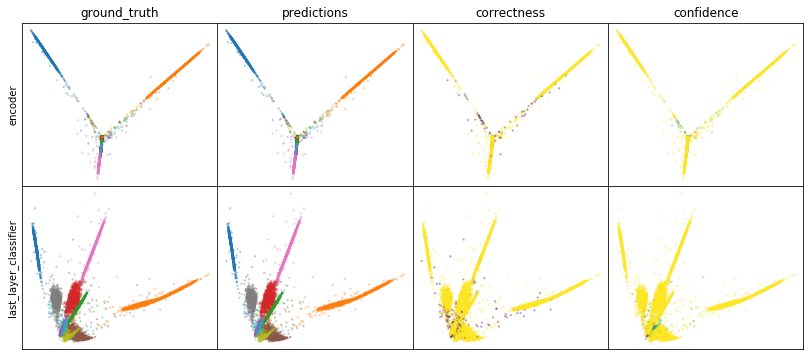

W0808 00:31:53.783098 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:31:53.982857 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:31:54.181945 140402527516416 legend.py:1282] No handles with labels found to put in legend.


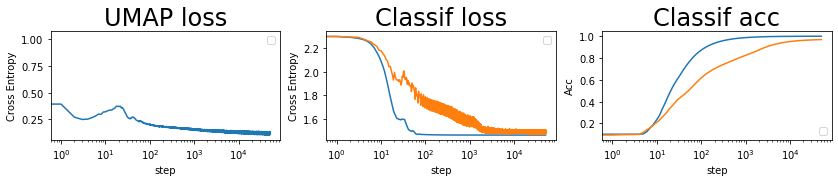

batch: 51000 | train acc: 0.9997 | val acc: 0.9692


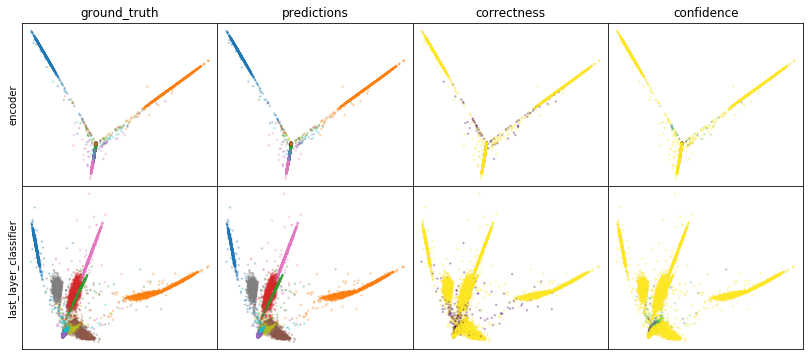

W0808 00:33:40.957550 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:33:41.156707 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:33:41.356796 140402527516416 legend.py:1282] No handles with labels found to put in legend.


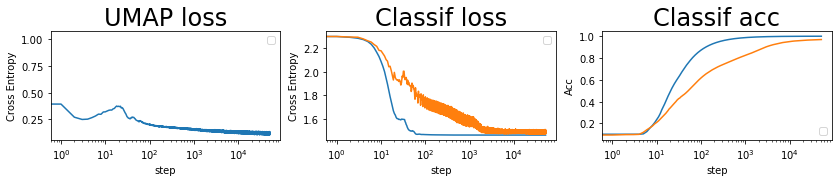

batch: 52000 | train acc: 0.9998 | val acc: 0.9693


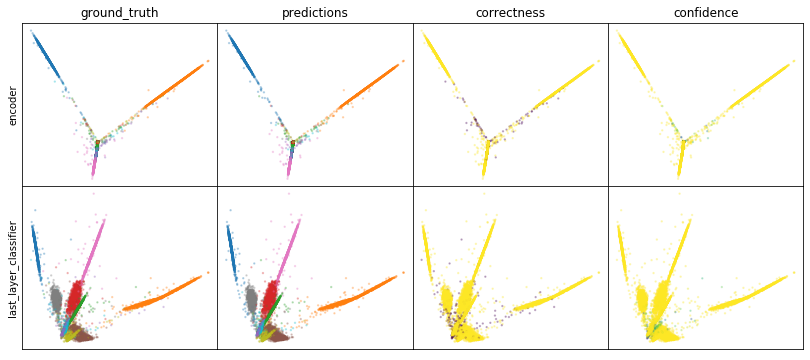

W0808 00:35:28.489446 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:35:28.699303 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:35:28.925811 140402527516416 legend.py:1282] No handles with labels found to put in legend.


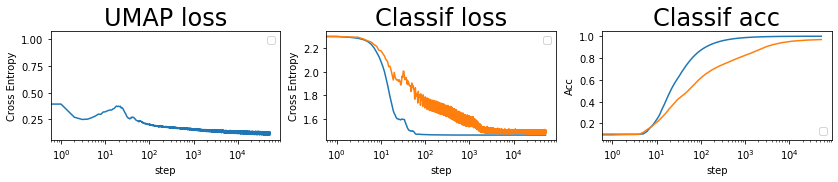

batch: 53000 | train acc: 0.9998 | val acc: 0.9694


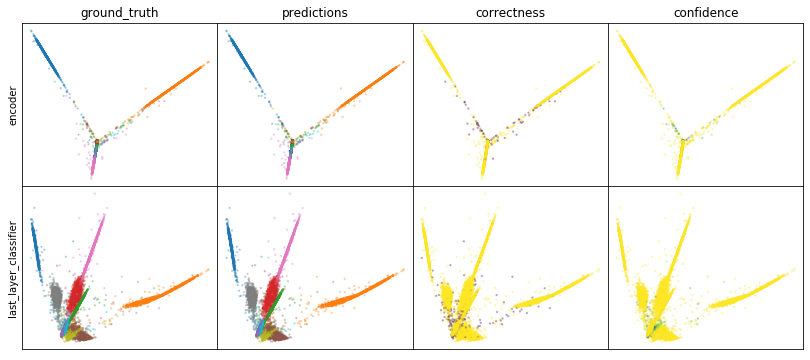

W0808 00:37:15.841609 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:37:16.047073 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:37:16.246063 140402527516416 legend.py:1282] No handles with labels found to put in legend.


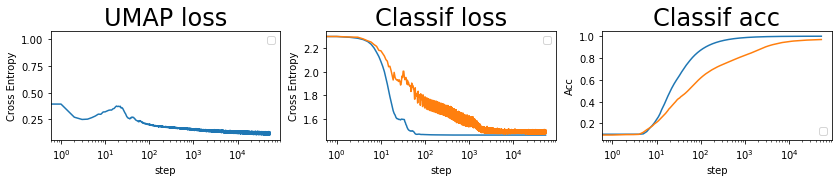

batch: 54000 | train acc: 0.9998 | val acc: 0.9694


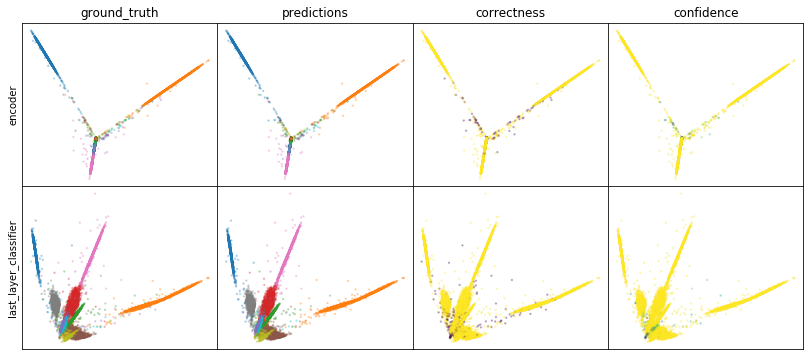

W0808 00:39:04.789123 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:39:05.023319 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:39:05.249098 140402527516416 legend.py:1282] No handles with labels found to put in legend.


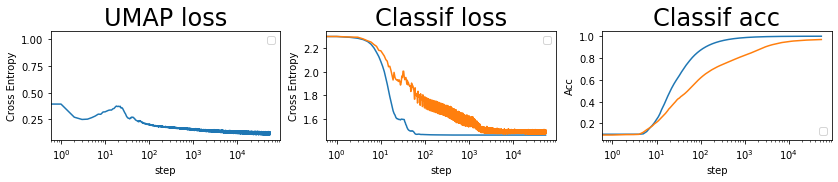

batch: 55000 | train acc: 0.9998 | val acc: 0.9695


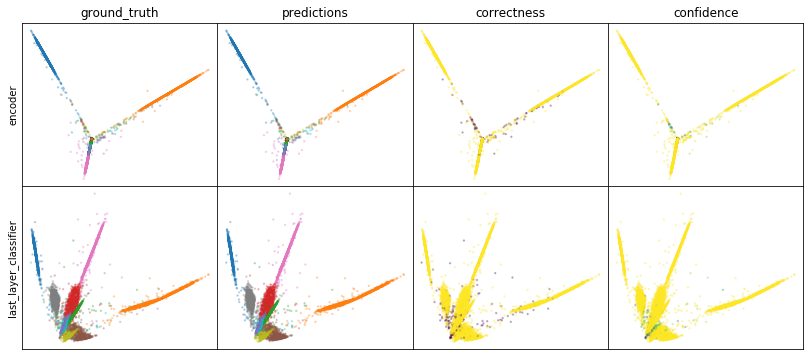

W0808 00:40:54.278046 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:40:54.487562 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:40:54.698250 140402527516416 legend.py:1282] No handles with labels found to put in legend.


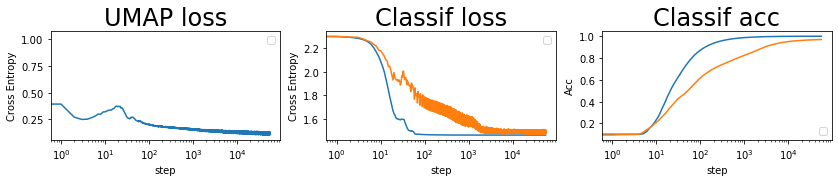

batch: 56000 | train acc: 0.9998 | val acc: 0.9696


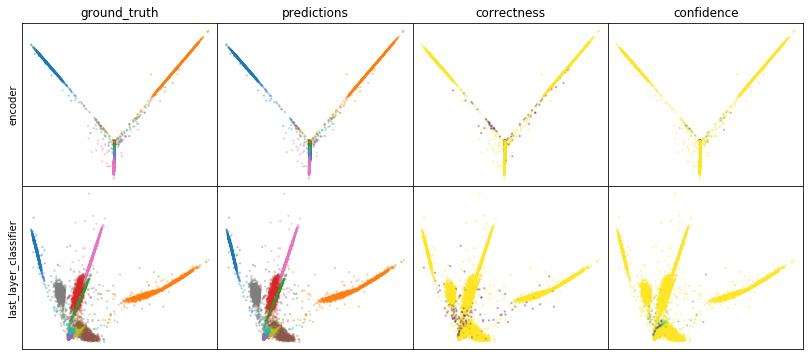

W0808 00:42:43.956785 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:42:44.172812 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:42:44.387829 140402527516416 legend.py:1282] No handles with labels found to put in legend.


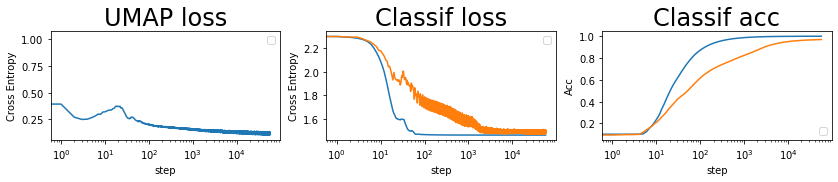

batch: 57000 | train acc: 0.9998 | val acc: 0.9697


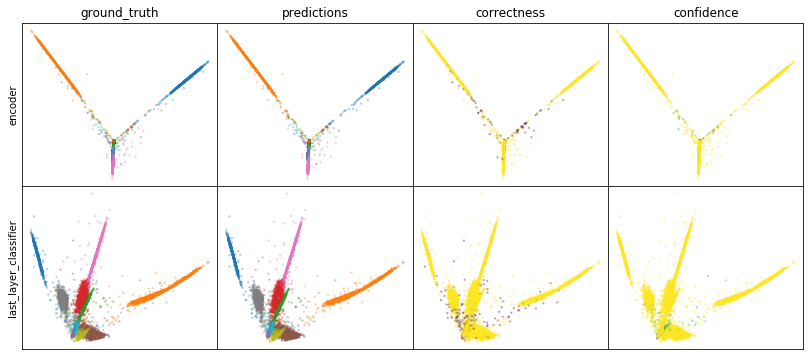

W0808 00:44:33.343303 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:44:33.568810 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:44:33.800051 140402527516416 legend.py:1282] No handles with labels found to put in legend.


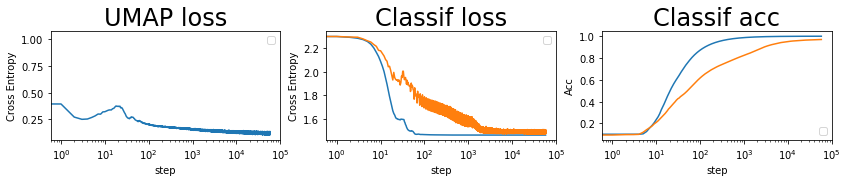

batch: 58000 | train acc: 0.9998 | val acc: 0.9697


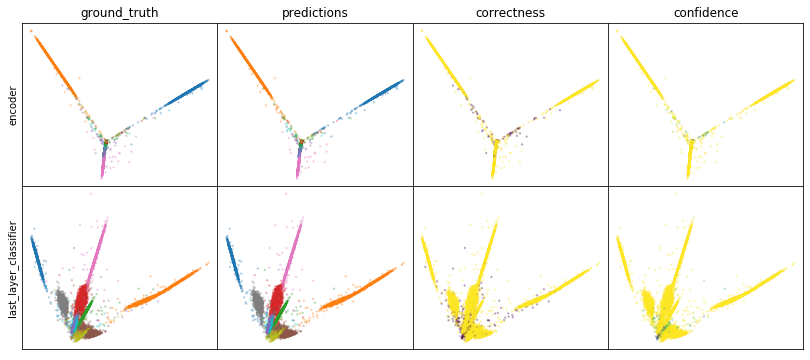

W0808 00:46:23.792468 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:46:24.012973 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:46:24.232729 140402527516416 legend.py:1282] No handles with labels found to put in legend.


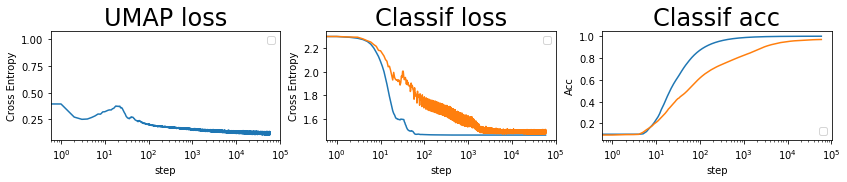

batch: 59000 | train acc: 0.9998 | val acc: 0.9698


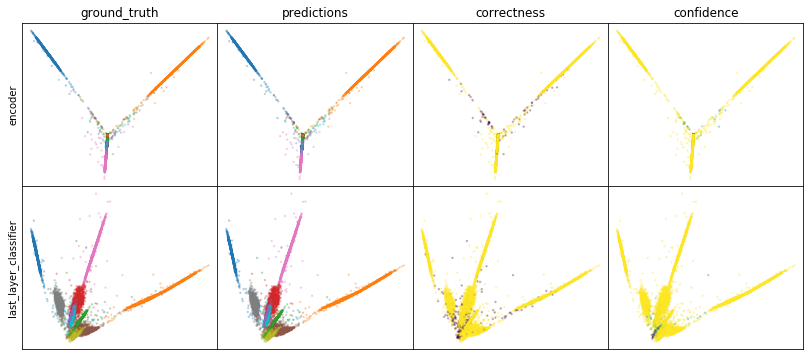

W0808 00:48:14.395867 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:48:14.625945 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:48:14.852595 140402527516416 legend.py:1282] No handles with labels found to put in legend.


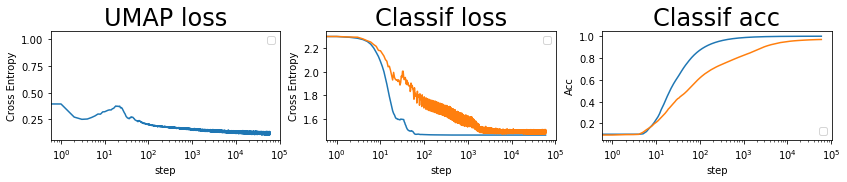

batch: 60000 | train acc: 0.9998 | val acc: 0.9698


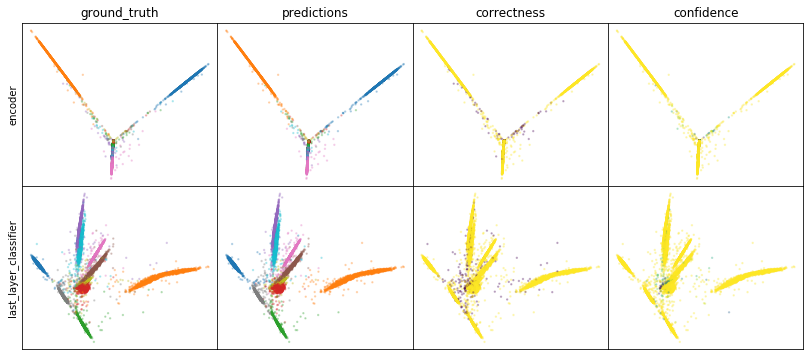

W0808 00:50:05.167696 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:50:05.393543 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:50:05.618341 140402527516416 legend.py:1282] No handles with labels found to put in legend.


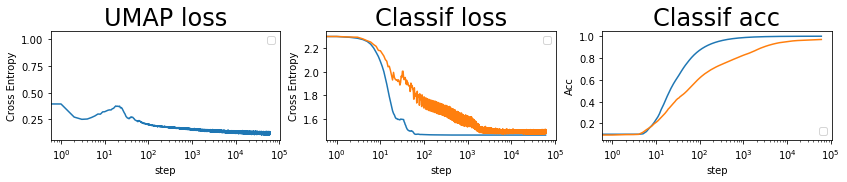

batch: 61000 | train acc: 0.9998 | val acc: 0.9699


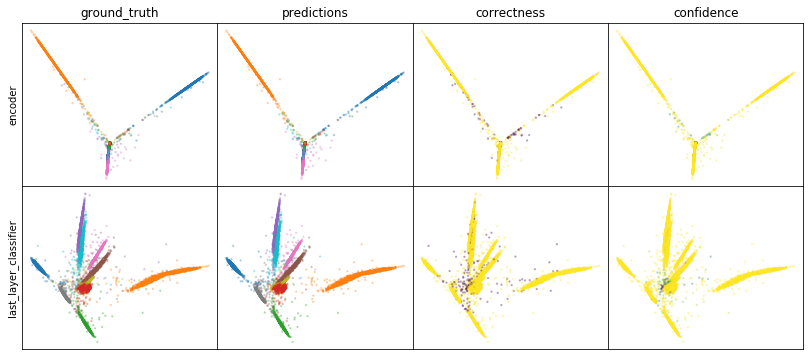

W0808 00:51:56.958387 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:51:57.193233 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:51:57.428052 140402527516416 legend.py:1282] No handles with labels found to put in legend.


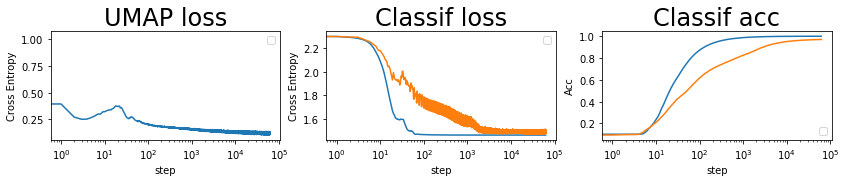

batch: 62000 | train acc: 0.9998 | val acc: 0.9699


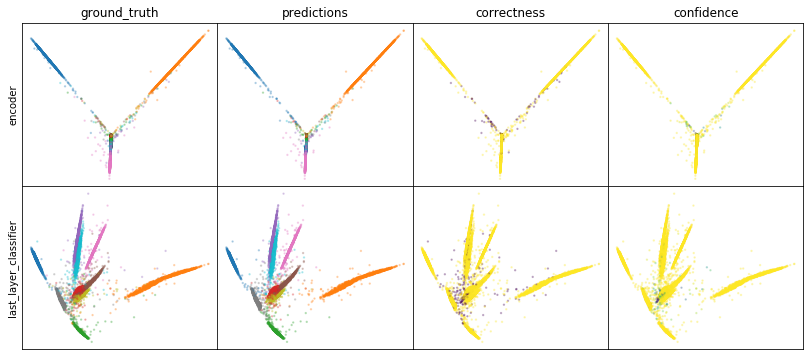

W0808 00:53:49.267848 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:53:49.501924 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:53:49.734338 140402527516416 legend.py:1282] No handles with labels found to put in legend.


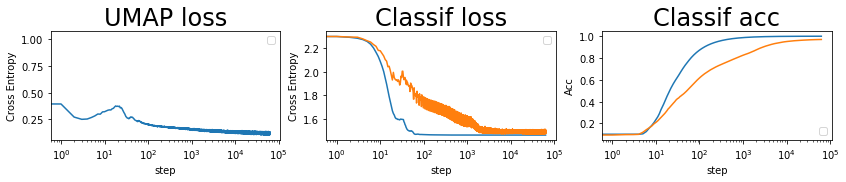

batch: 63000 | train acc: 0.9998 | val acc: 0.97


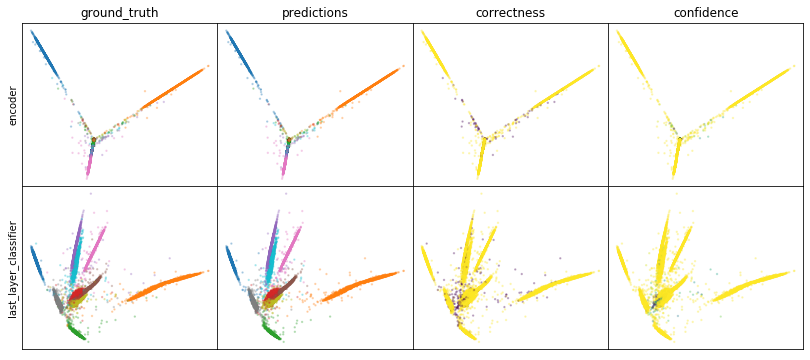

W0808 00:55:41.484956 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:55:41.714162 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:55:41.953792 140402527516416 legend.py:1282] No handles with labels found to put in legend.


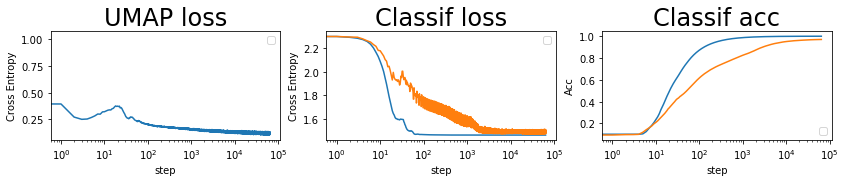

batch: 64000 | train acc: 0.9998 | val acc: 0.9701


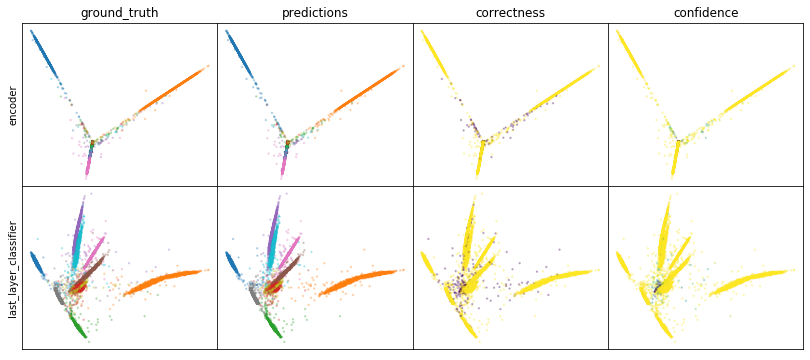

W0808 00:57:33.392487 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:57:33.628323 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:57:33.870668 140402527516416 legend.py:1282] No handles with labels found to put in legend.


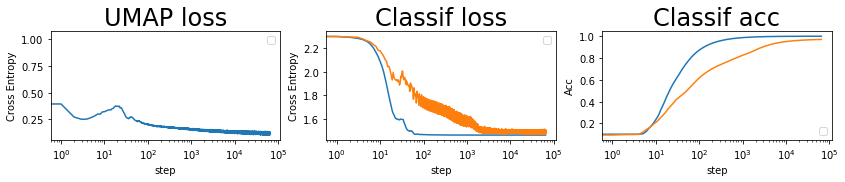

batch: 65000 | train acc: 0.9998 | val acc: 0.9701


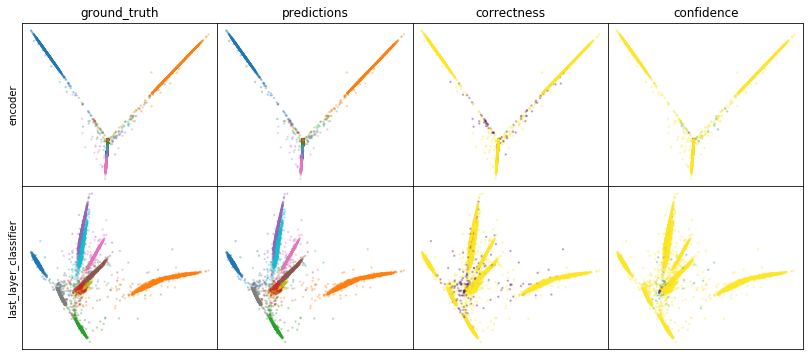

W0808 00:59:26.044407 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:59:26.299213 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 00:59:26.541413 140402527516416 legend.py:1282] No handles with labels found to put in legend.


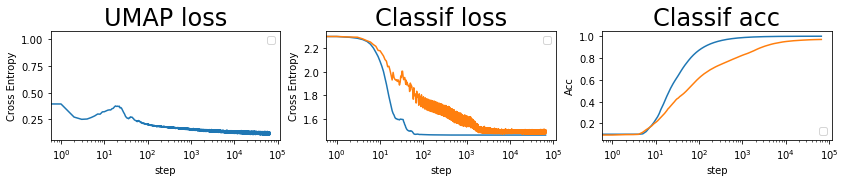

batch: 66000 | train acc: 0.9998 | val acc: 0.9701


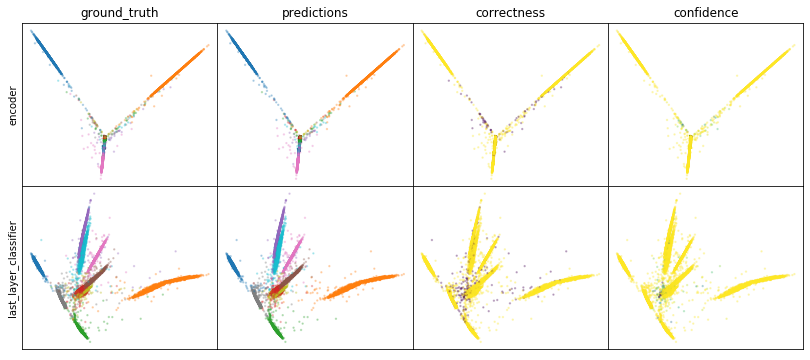

W0808 01:01:20.232349 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:01:20.475362 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:01:20.720322 140402527516416 legend.py:1282] No handles with labels found to put in legend.


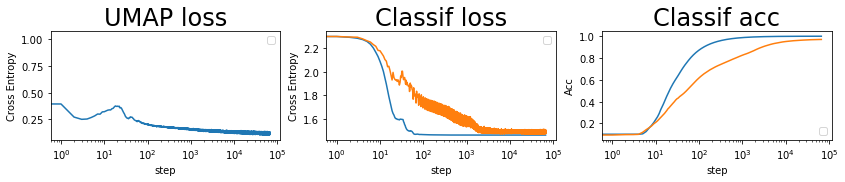

batch: 67000 | train acc: 0.9998 | val acc: 0.9702


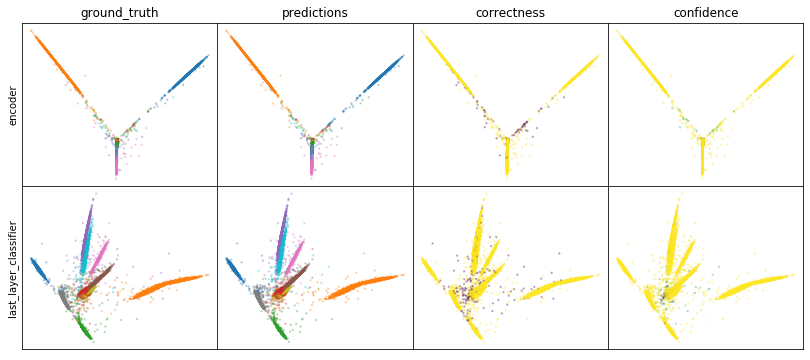

W0808 01:03:13.949218 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:03:14.198048 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:03:14.443918 140402527516416 legend.py:1282] No handles with labels found to put in legend.


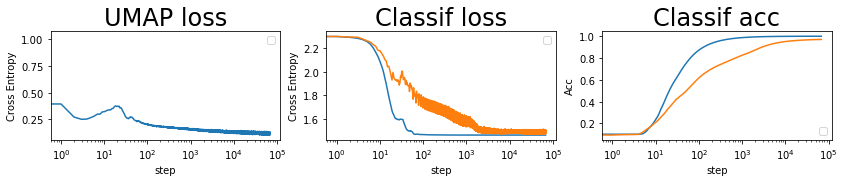

batch: 68000 | train acc: 0.9998 | val acc: 0.9702


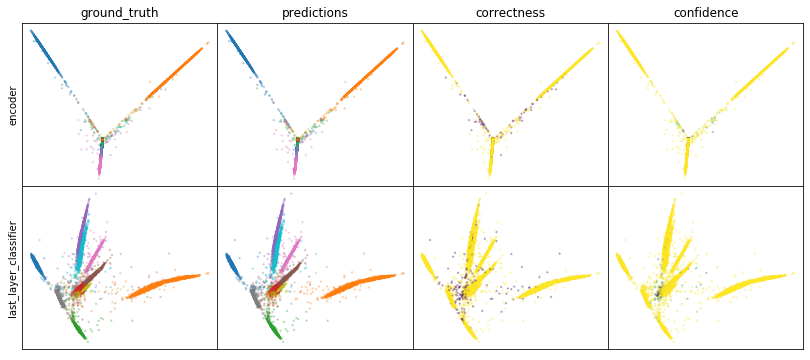

W0808 01:05:08.776493 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:05:09.053194 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:05:09.307858 140402527516416 legend.py:1282] No handles with labels found to put in legend.


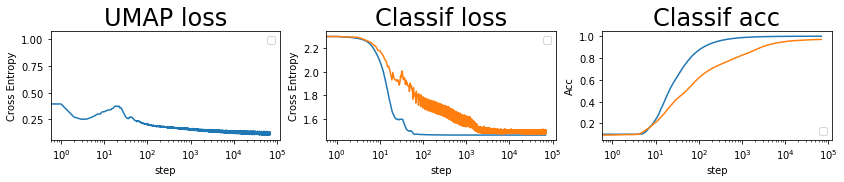

batch: 69000 | train acc: 0.9998 | val acc: 0.9703


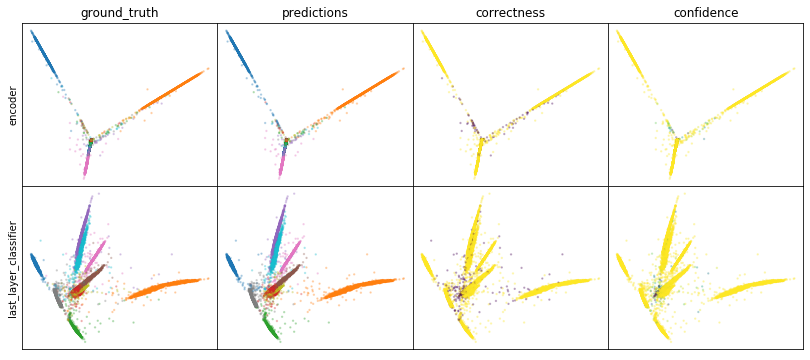

W0808 01:07:04.845336 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:07:05.106132 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:07:05.352230 140402527516416 legend.py:1282] No handles with labels found to put in legend.


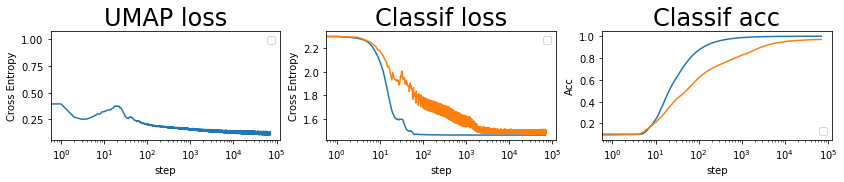

batch: 70000 | train acc: 0.9998 | val acc: 0.9703


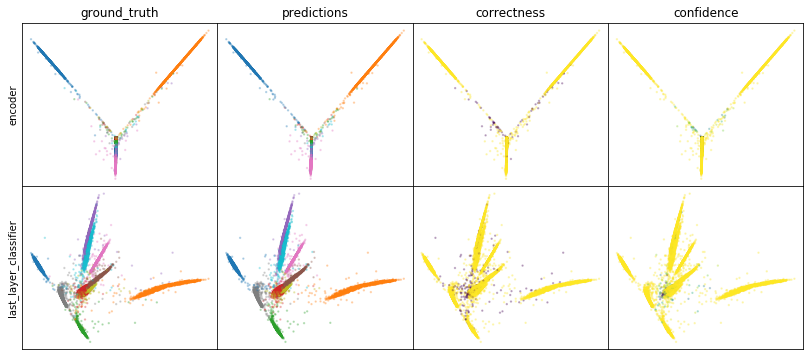

W0808 01:09:01.666478 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:09:01.920572 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:09:02.169494 140402527516416 legend.py:1282] No handles with labels found to put in legend.


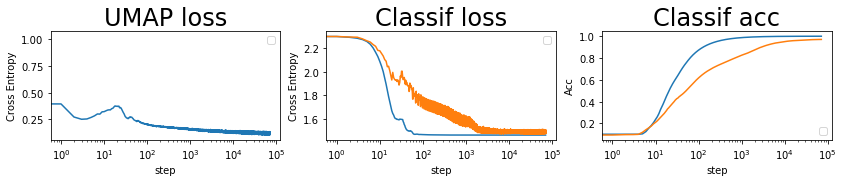

batch: 71000 | train acc: 0.9998 | val acc: 0.9704


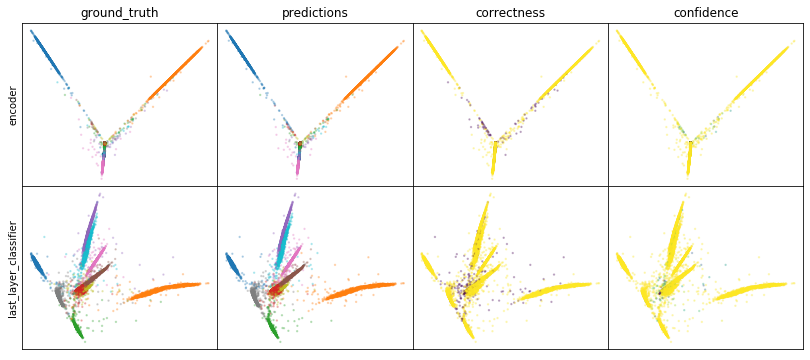

W0808 01:10:57.728135 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:10:57.985027 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:10:58.238055 140402527516416 legend.py:1282] No handles with labels found to put in legend.


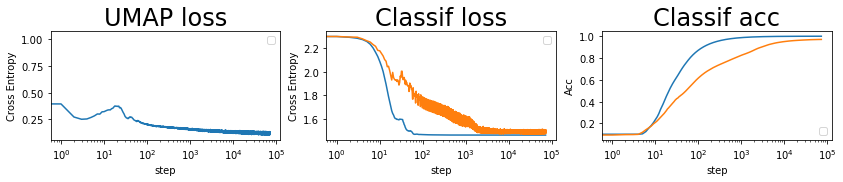

batch: 72000 | train acc: 0.9998 | val acc: 0.9704


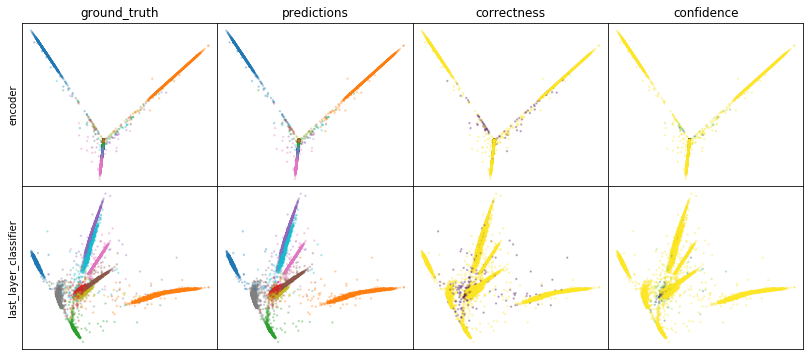

W0808 01:12:54.126507 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:12:54.393321 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:12:54.663750 140402527516416 legend.py:1282] No handles with labels found to put in legend.


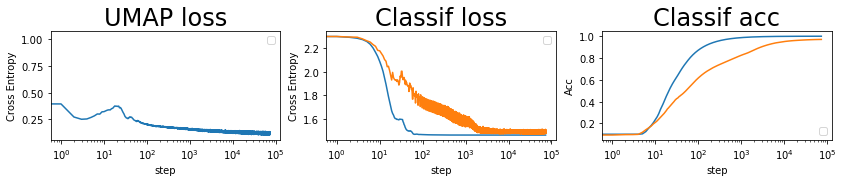

batch: 73000 | train acc: 0.9998 | val acc: 0.9704


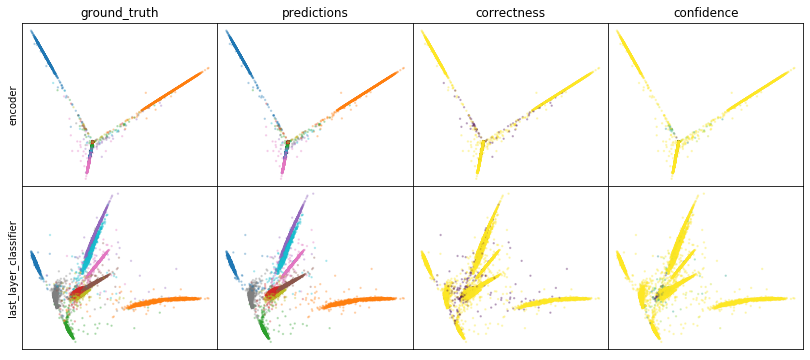

W0808 01:14:51.294251 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:14:51.567231 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:14:51.830948 140402527516416 legend.py:1282] No handles with labels found to put in legend.


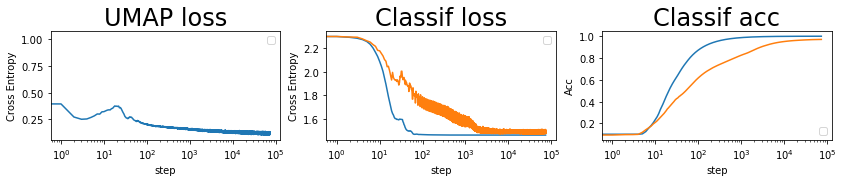

batch: 74000 | train acc: 0.9998 | val acc: 0.9705


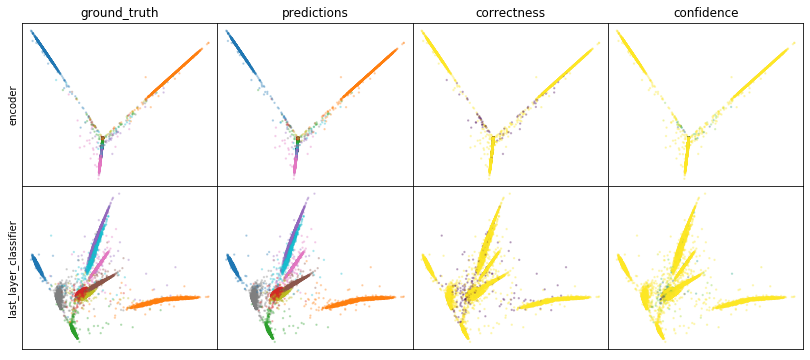

W0808 01:16:49.171120 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:16:49.438326 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:16:49.695914 140402527516416 legend.py:1282] No handles with labels found to put in legend.


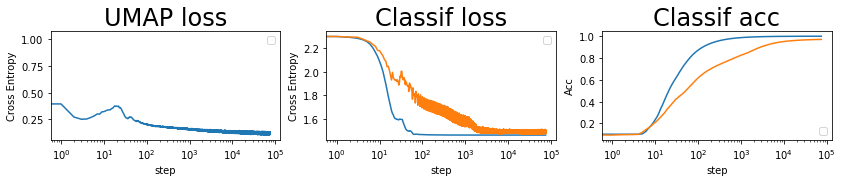

batch: 75000 | train acc: 0.9998 | val acc: 0.9705


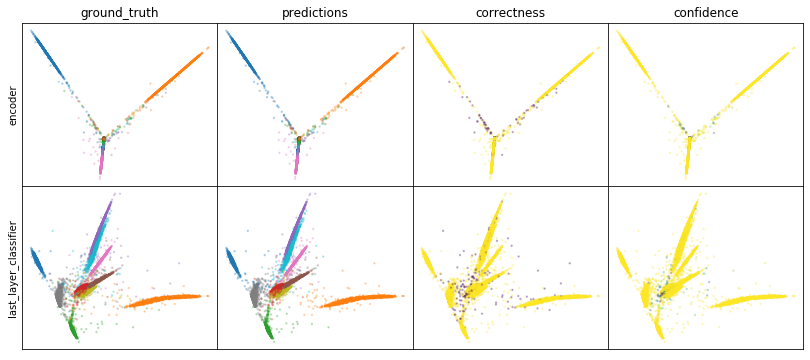

W0808 01:18:46.511022 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:18:46.779412 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:18:47.042798 140402527516416 legend.py:1282] No handles with labels found to put in legend.


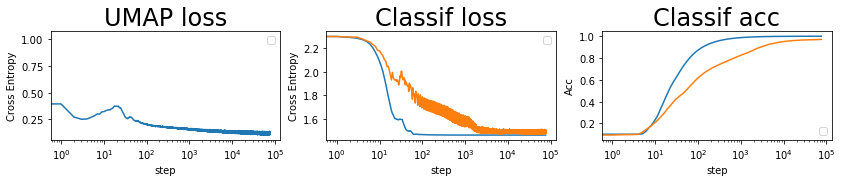

batch: 76000 | train acc: 0.9998 | val acc: 0.9706


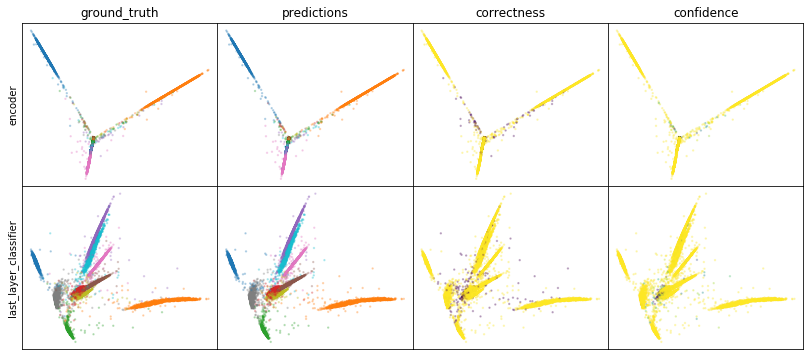

W0808 01:20:45.214956 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:20:45.492821 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:20:45.769496 140402527516416 legend.py:1282] No handles with labels found to put in legend.


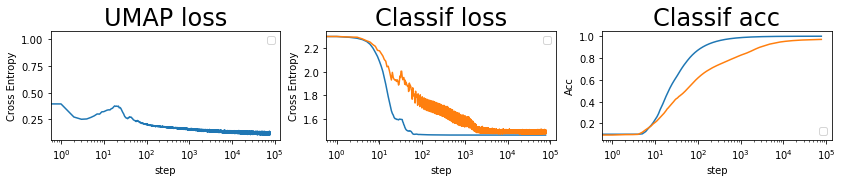

batch: 77000 | train acc: 0.9998 | val acc: 0.9706


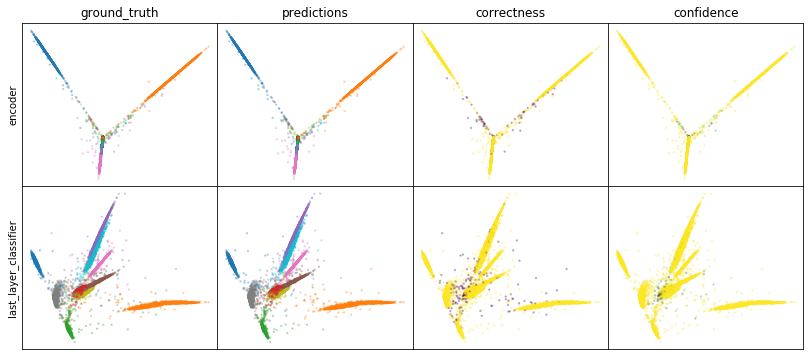

W0808 01:22:44.596714 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:22:44.871386 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:22:45.151350 140402527516416 legend.py:1282] No handles with labels found to put in legend.


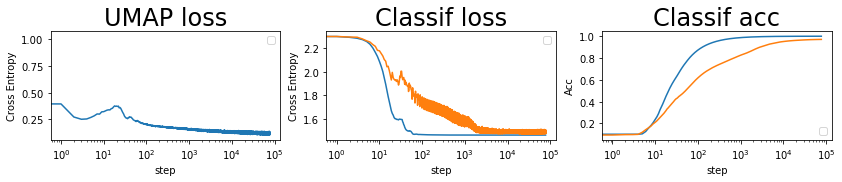

batch: 78000 | train acc: 0.9998 | val acc: 0.9706


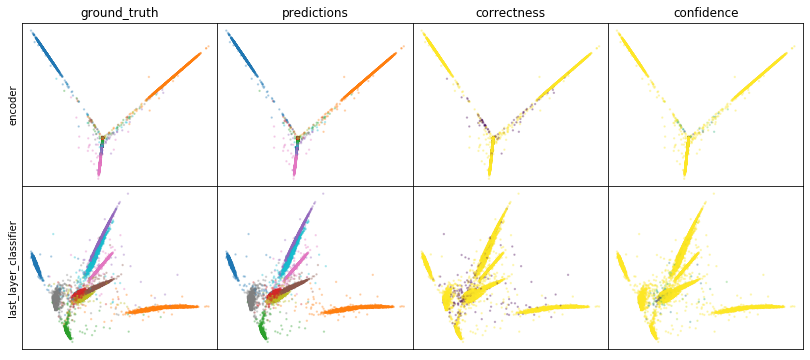

W0808 01:24:43.390052 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:24:43.677472 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:24:43.952291 140402527516416 legend.py:1282] No handles with labels found to put in legend.


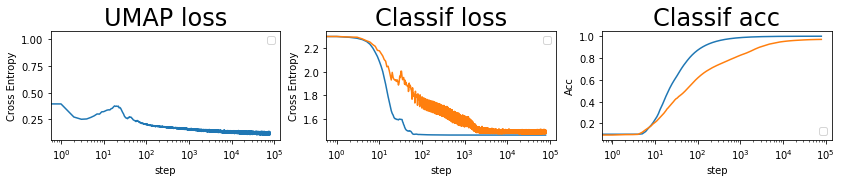

batch: 79000 | train acc: 0.9998 | val acc: 0.9707


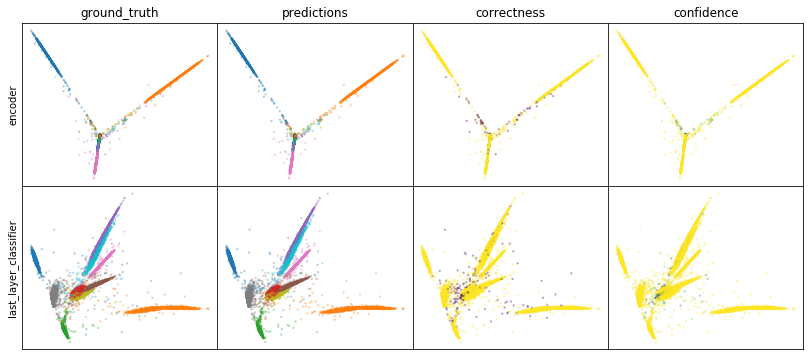

W0808 01:26:43.439934 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:26:43.727051 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:26:44.008233 140402527516416 legend.py:1282] No handles with labels found to put in legend.


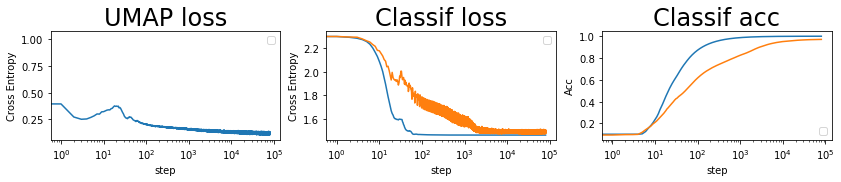

batch: 80000 | train acc: 0.9998 | val acc: 0.9707


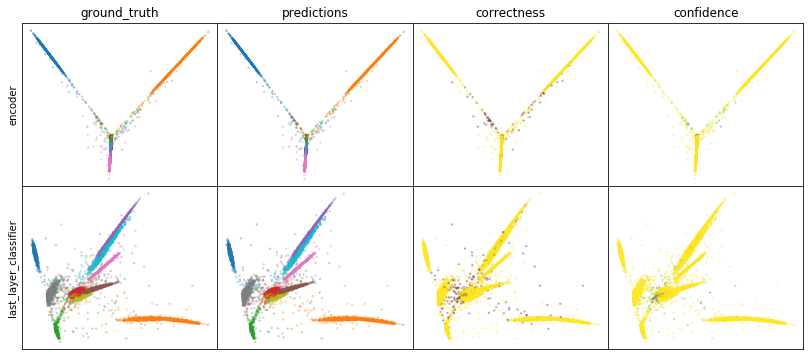

W0808 01:28:42.200024 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:28:42.493695 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:28:42.775366 140402527516416 legend.py:1282] No handles with labels found to put in legend.


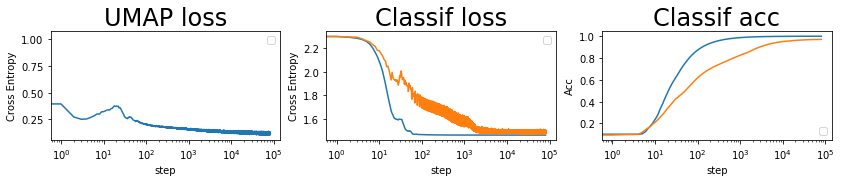

batch: 81000 | train acc: 0.9998 | val acc: 0.9707


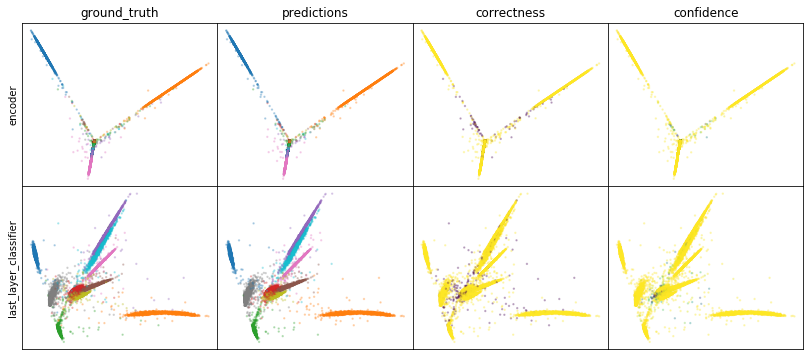

W0808 01:30:43.603096 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:30:43.899829 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:30:44.175788 140402527516416 legend.py:1282] No handles with labels found to put in legend.


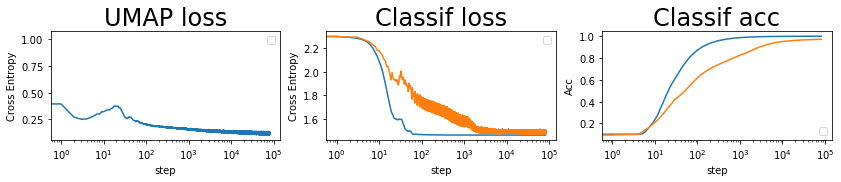

batch: 82000 | train acc: 0.9998 | val acc: 0.9707


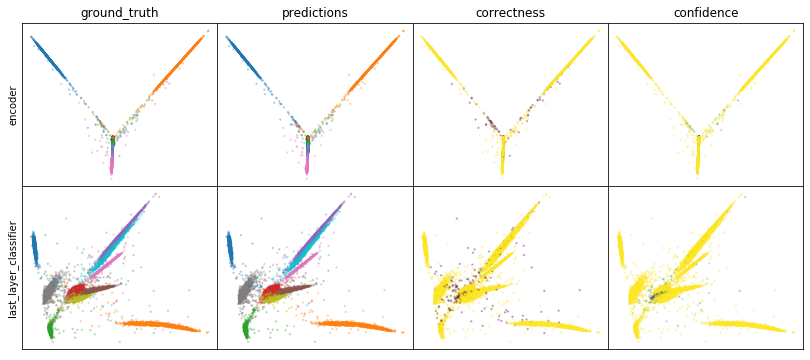

W0808 01:32:45.749683 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:32:46.046157 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:32:46.334121 140402527516416 legend.py:1282] No handles with labels found to put in legend.


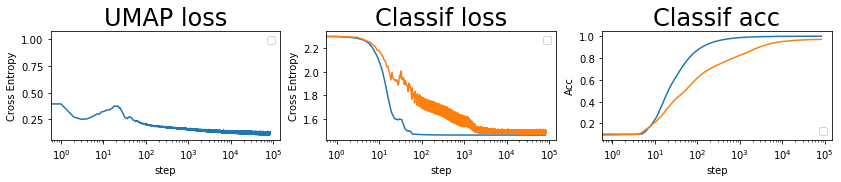

batch: 83000 | train acc: 0.9998 | val acc: 0.9708


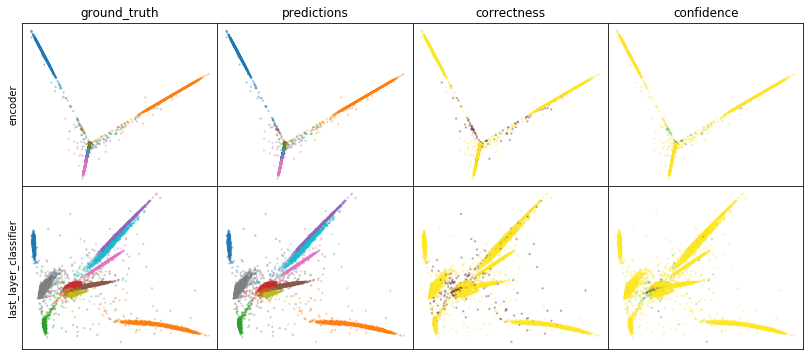

W0808 01:34:48.640320 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:34:48.929364 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:34:49.215941 140402527516416 legend.py:1282] No handles with labels found to put in legend.


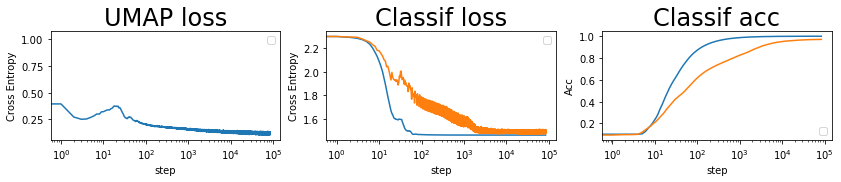

batch: 84000 | train acc: 0.9998 | val acc: 0.9708


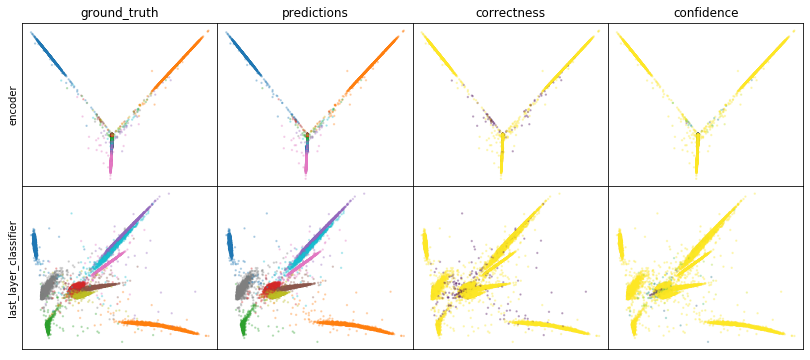

W0808 01:36:50.197626 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:36:50.490483 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:36:50.784665 140402527516416 legend.py:1282] No handles with labels found to put in legend.


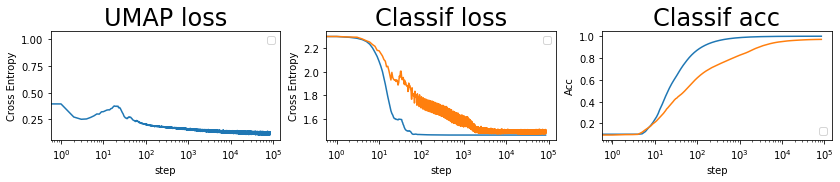

batch: 85000 | train acc: 0.9998 | val acc: 0.9708


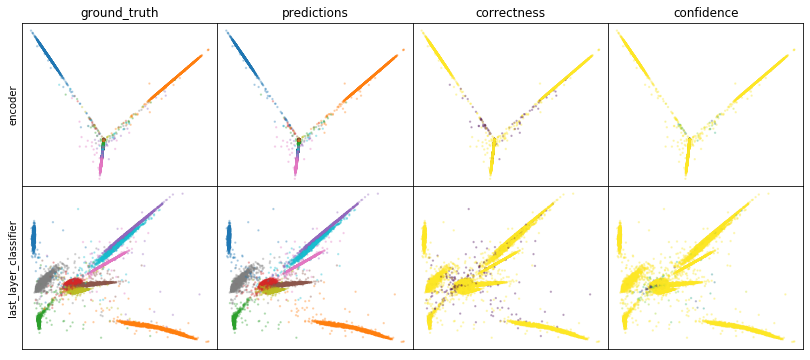

W0808 01:38:52.311016 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:38:52.603665 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:38:52.890366 140402527516416 legend.py:1282] No handles with labels found to put in legend.


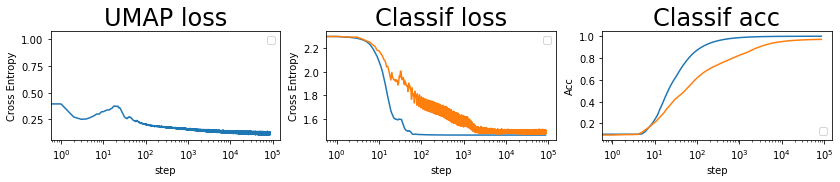

batch: 86000 | train acc: 0.9998 | val acc: 0.9708


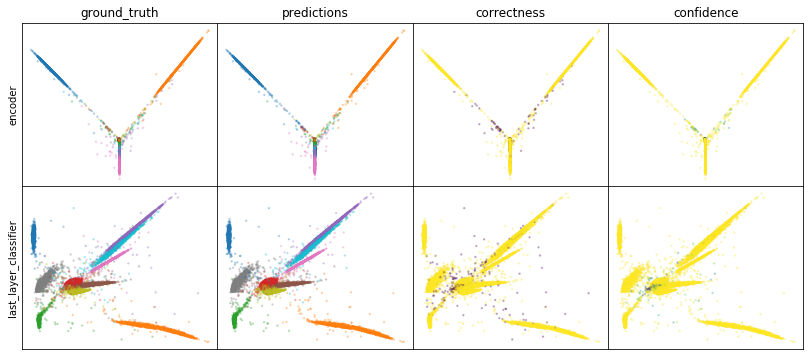

W0808 01:40:55.147253 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:40:55.470604 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:40:55.766360 140402527516416 legend.py:1282] No handles with labels found to put in legend.


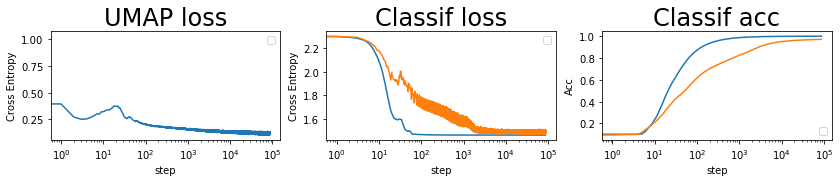

batch: 87000 | train acc: 0.9999 | val acc: 0.9709


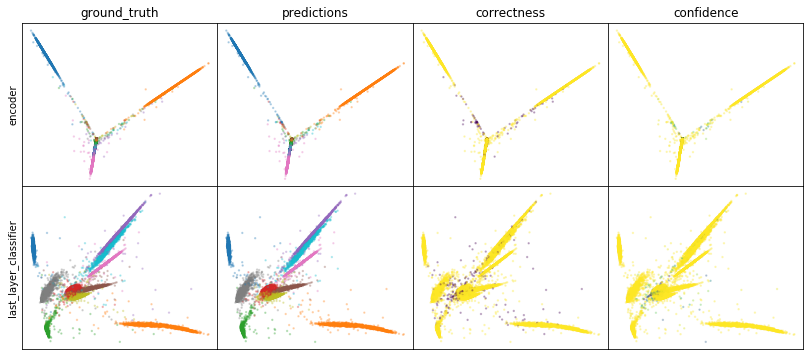

W0808 01:42:58.887857 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:42:59.192313 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:42:59.489764 140402527516416 legend.py:1282] No handles with labels found to put in legend.


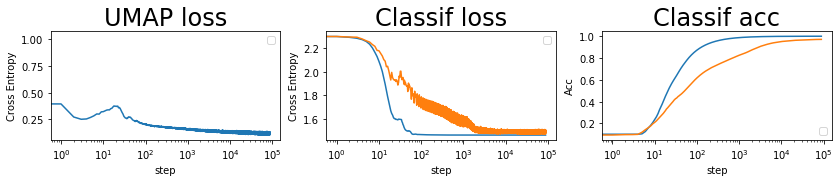

batch: 88000 | train acc: 0.9999 | val acc: 0.9709


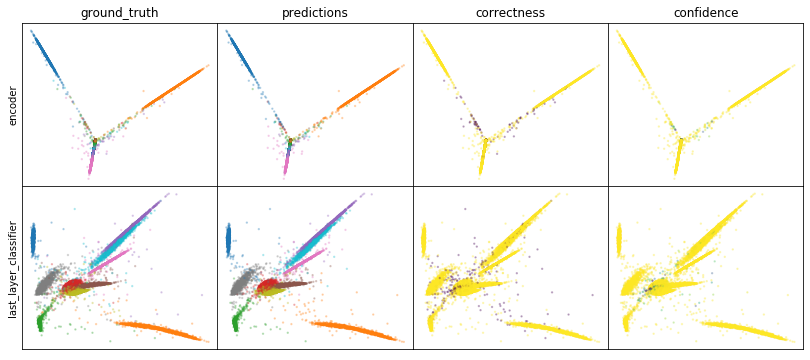

W0808 01:45:01.635856 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:45:01.939256 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:45:02.227225 140402527516416 legend.py:1282] No handles with labels found to put in legend.


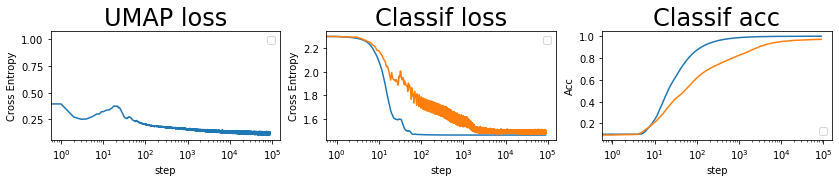

batch: 89000 | train acc: 0.9999 | val acc: 0.9709


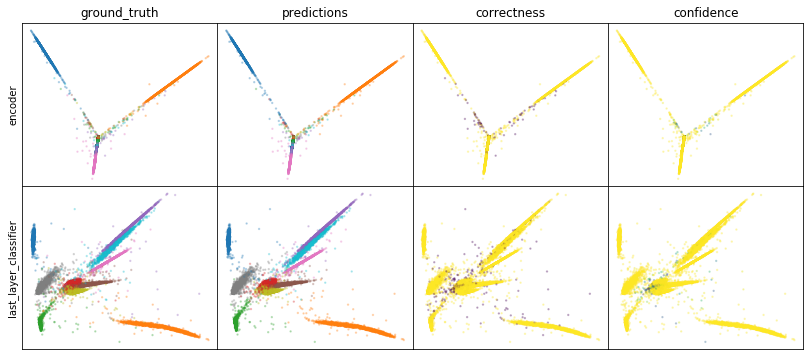

W0808 01:47:05.905022 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:47:06.213625 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:47:06.520270 140402527516416 legend.py:1282] No handles with labels found to put in legend.


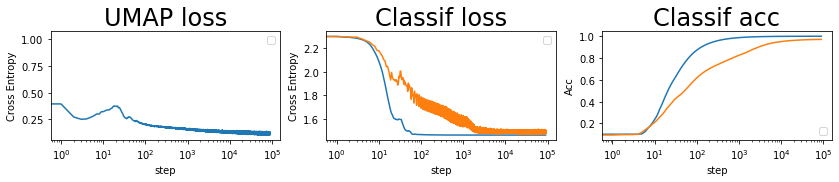

batch: 90000 | train acc: 0.9999 | val acc: 0.9709


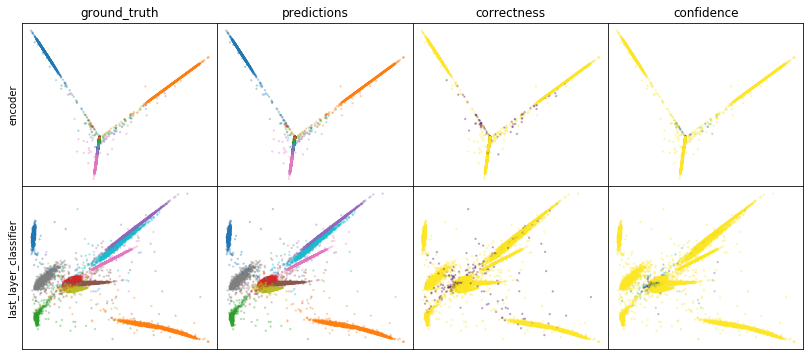

W0808 01:49:11.462181 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:49:11.775717 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:49:12.080321 140402527516416 legend.py:1282] No handles with labels found to put in legend.


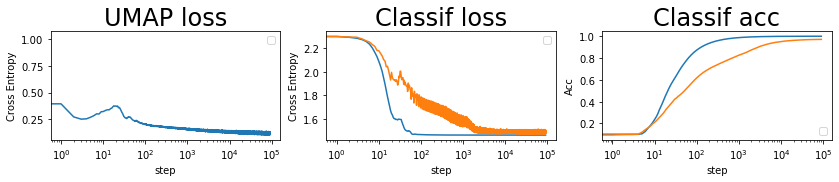

batch: 91000 | train acc: 0.9999 | val acc: 0.9709


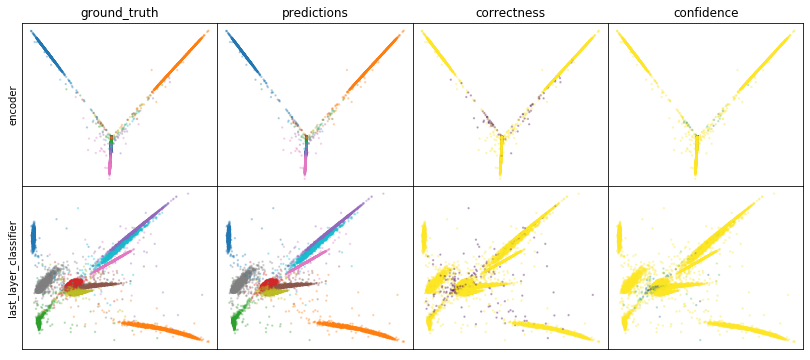

W0808 01:51:16.017339 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:51:16.330142 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:51:16.628189 140402527516416 legend.py:1282] No handles with labels found to put in legend.


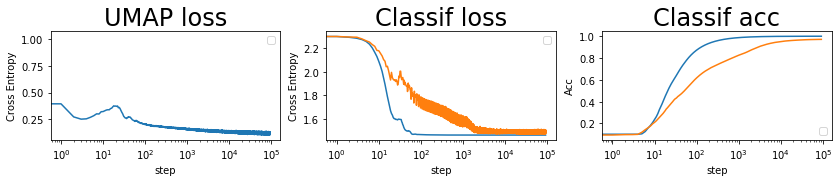

batch: 92000 | train acc: 0.9999 | val acc: 0.971


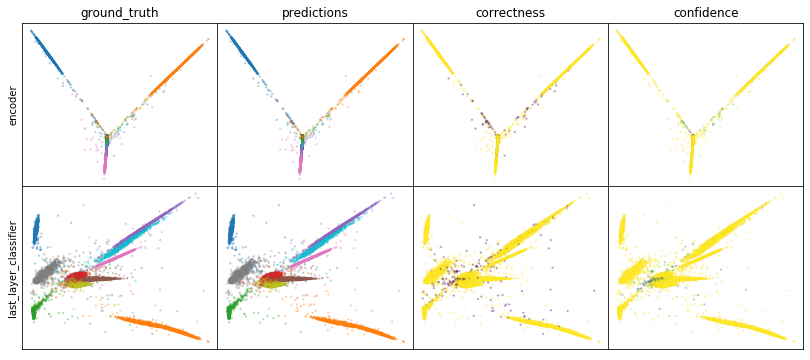

W0808 01:53:22.729328 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:53:23.063930 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:53:23.406078 140402527516416 legend.py:1282] No handles with labels found to put in legend.


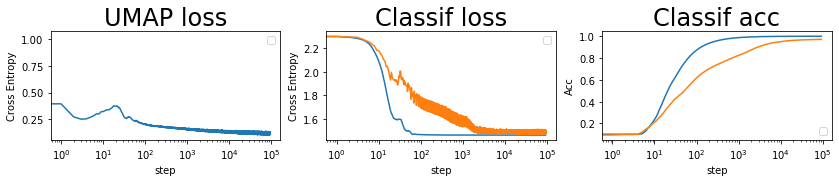

batch: 93000 | train acc: 0.9999 | val acc: 0.971


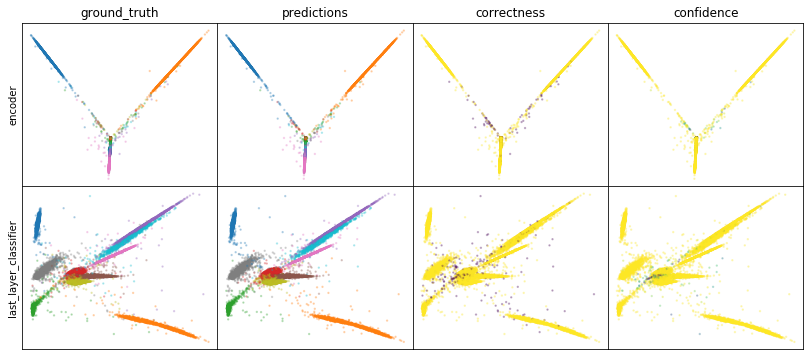

W0808 01:55:29.300492 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:55:29.619688 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:55:29.930241 140402527516416 legend.py:1282] No handles with labels found to put in legend.


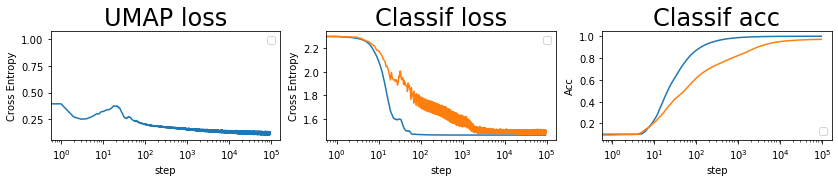

batch: 94000 | train acc: 0.9999 | val acc: 0.971


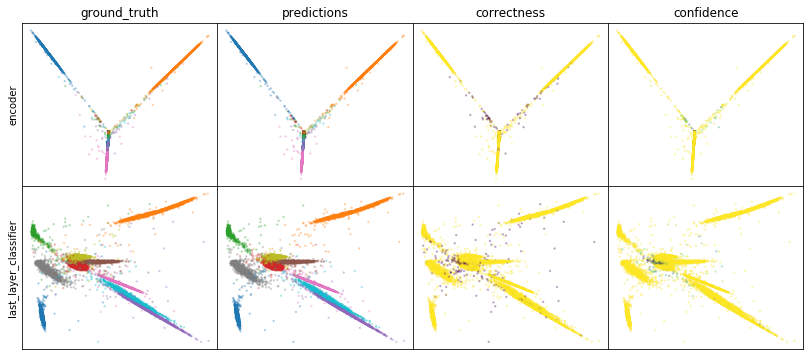

W0808 01:57:36.250689 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:57:36.574736 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:57:36.883133 140402527516416 legend.py:1282] No handles with labels found to put in legend.


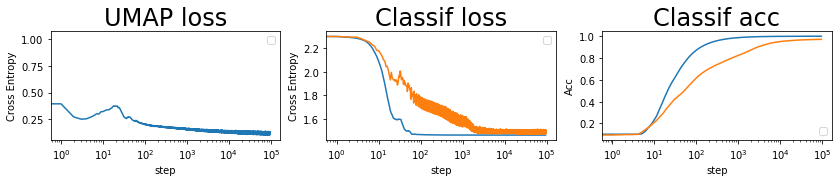

batch: 95000 | train acc: 0.9999 | val acc: 0.971


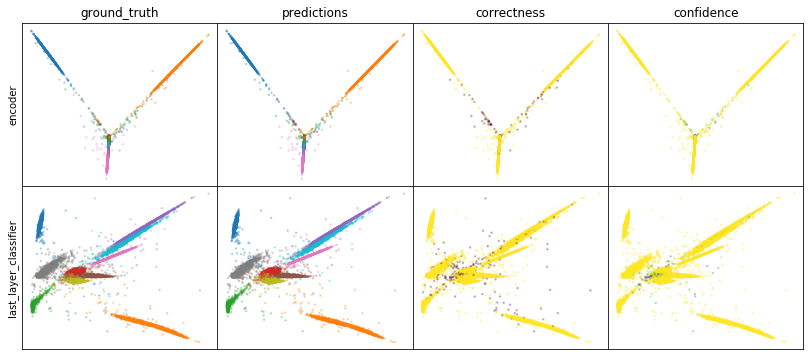

W0808 01:59:43.746789 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:59:44.069187 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 01:59:44.376249 140402527516416 legend.py:1282] No handles with labels found to put in legend.


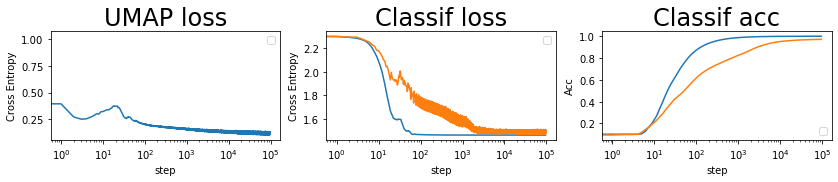

batch: 96000 | train acc: 0.9999 | val acc: 0.971


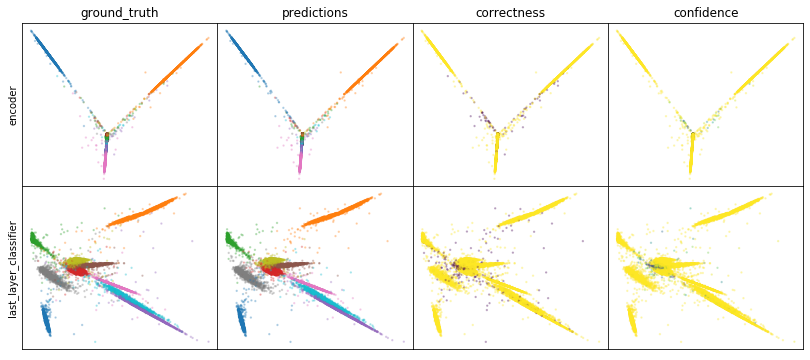

W0808 02:01:52.550400 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:01:52.875090 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:01:53.192303 140402527516416 legend.py:1282] No handles with labels found to put in legend.


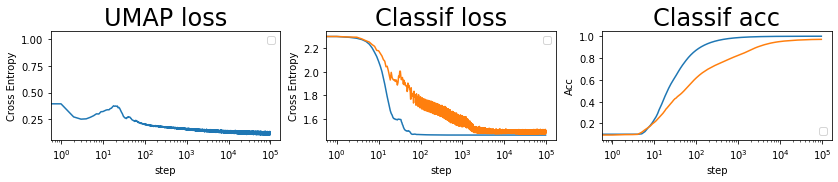

batch: 97000 | train acc: 0.9999 | val acc: 0.971


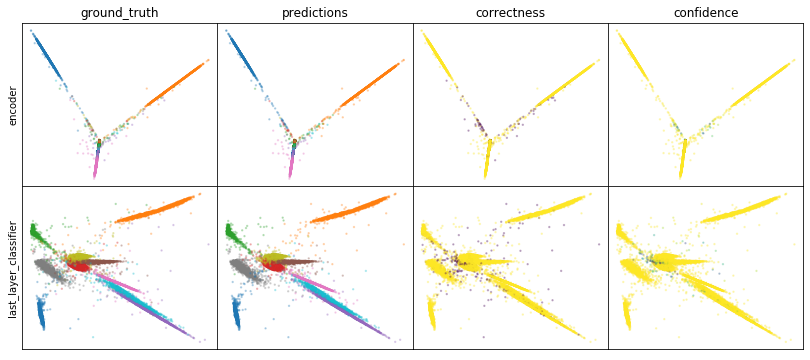

W0808 02:04:01.346589 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:04:01.675659 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:04:01.990558 140402527516416 legend.py:1282] No handles with labels found to put in legend.


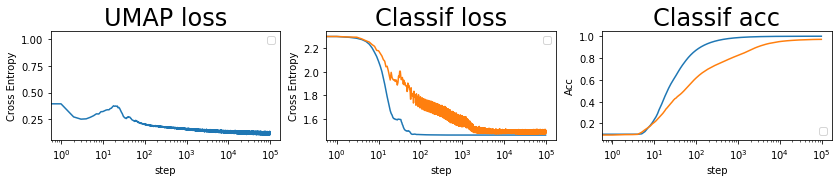

batch: 98000 | train acc: 0.9999 | val acc: 0.9711


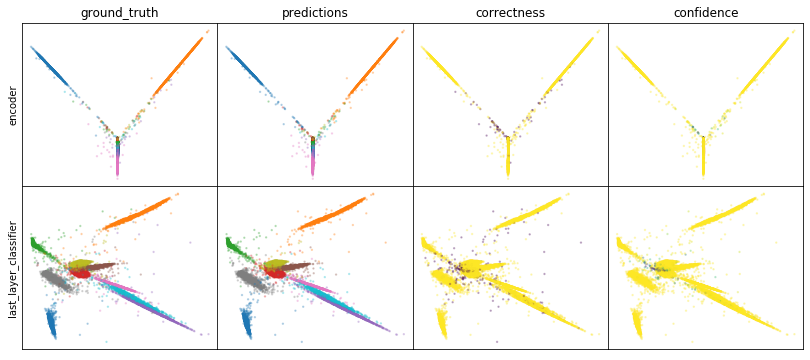

W0808 02:06:12.629801 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:06:12.961569 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:06:13.345380 140402527516416 legend.py:1282] No handles with labels found to put in legend.


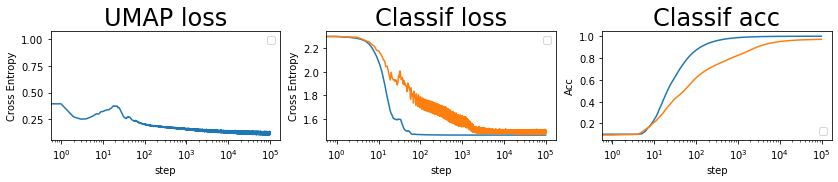

batch: 99000 | train acc: 0.9999 | val acc: 0.9711


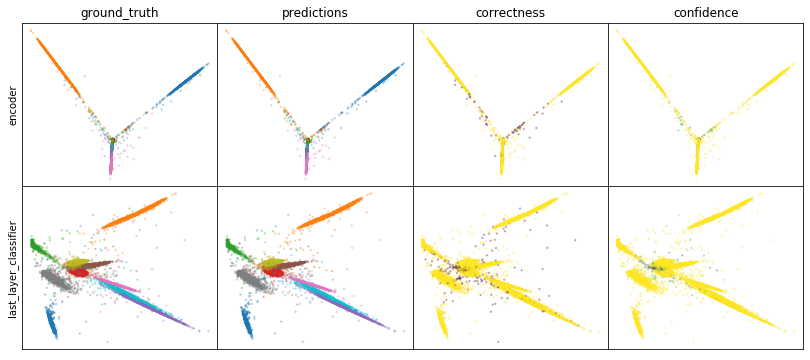

W0808 02:08:22.252609 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:08:22.585296 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:08:22.944511 140402527516416 legend.py:1282] No handles with labels found to put in legend.


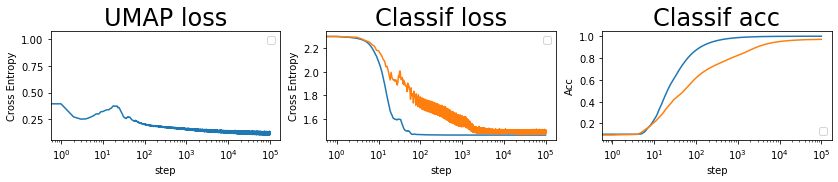

batch: 100000 | train acc: 0.9999 | val acc: 0.9711


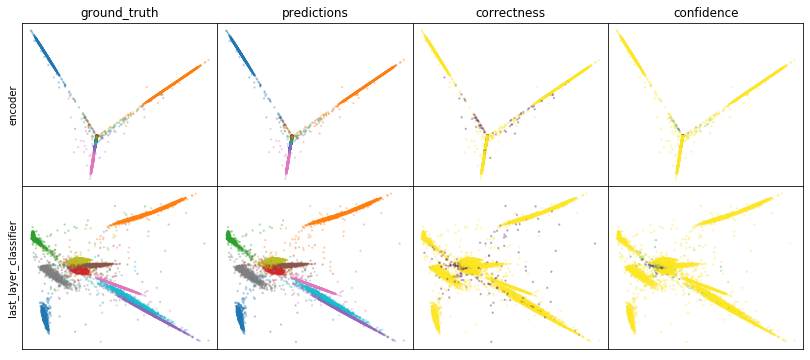

W0808 02:10:33.522267 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:10:33.886425 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:10:34.234123 140402527516416 legend.py:1282] No handles with labels found to put in legend.


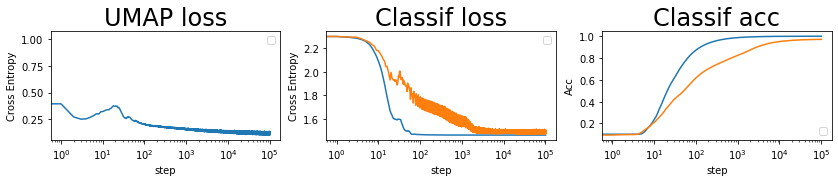

batch: 101000 | train acc: 0.9999 | val acc: 0.9711


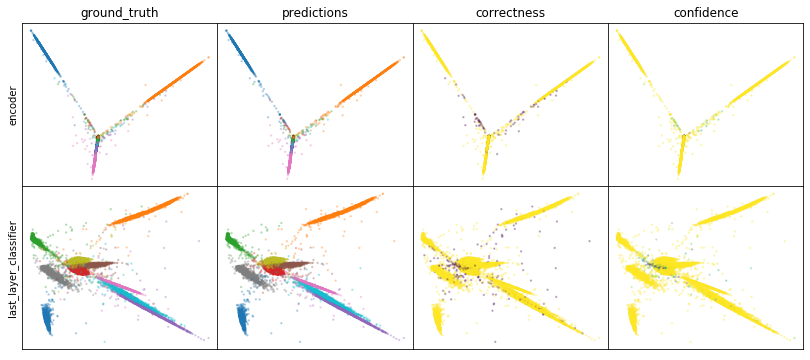

W0808 02:12:43.320608 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:12:43.675843 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:12:44.020421 140402527516416 legend.py:1282] No handles with labels found to put in legend.


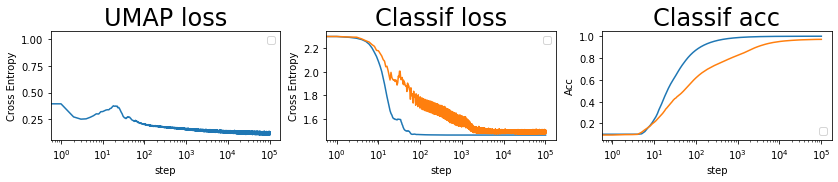

batch: 102000 | train acc: 0.9999 | val acc: 0.9711


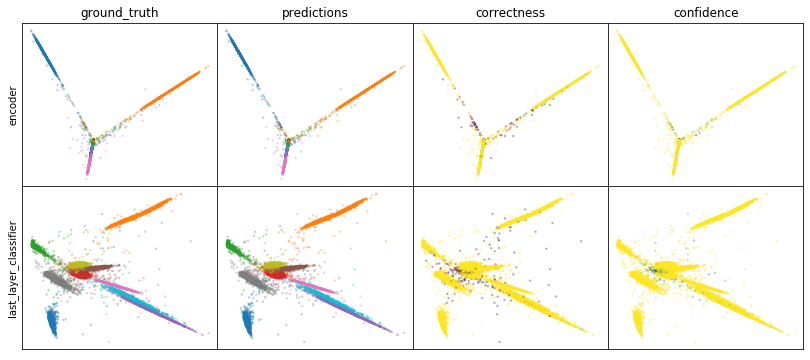

W0808 02:14:55.560616 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:14:55.913974 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:14:56.251904 140402527516416 legend.py:1282] No handles with labels found to put in legend.


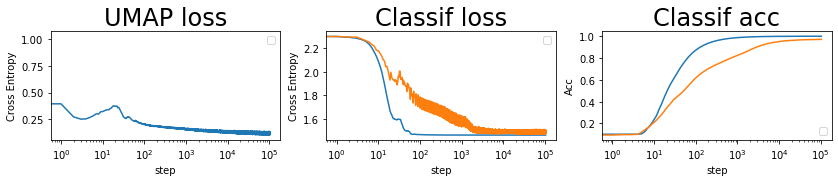

batch: 103000 | train acc: 0.9999 | val acc: 0.9711


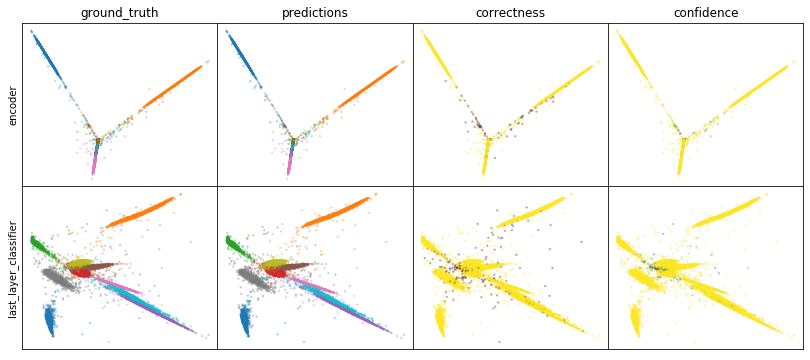

W0808 02:17:06.312033 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:17:06.661341 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:17:07.000433 140402527516416 legend.py:1282] No handles with labels found to put in legend.


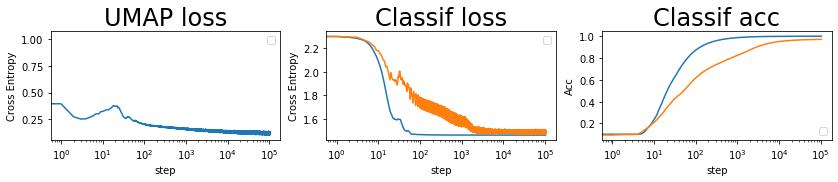

batch: 104000 | train acc: 0.9999 | val acc: 0.9711


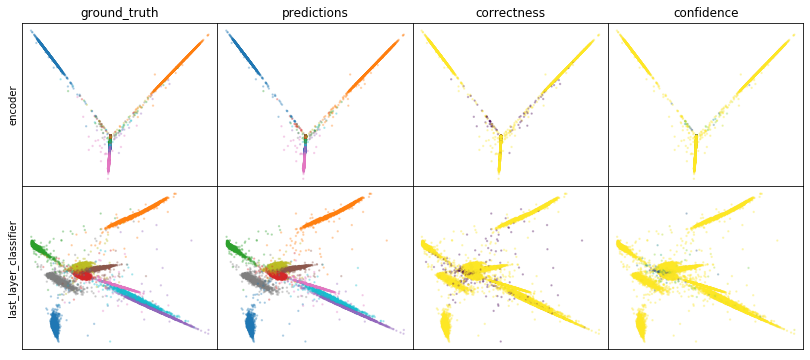

W0808 02:19:17.508659 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:19:17.872683 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:19:18.215960 140402527516416 legend.py:1282] No handles with labels found to put in legend.


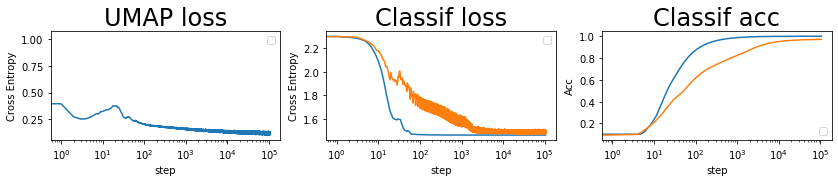

batch: 105000 | train acc: 0.9999 | val acc: 0.9711


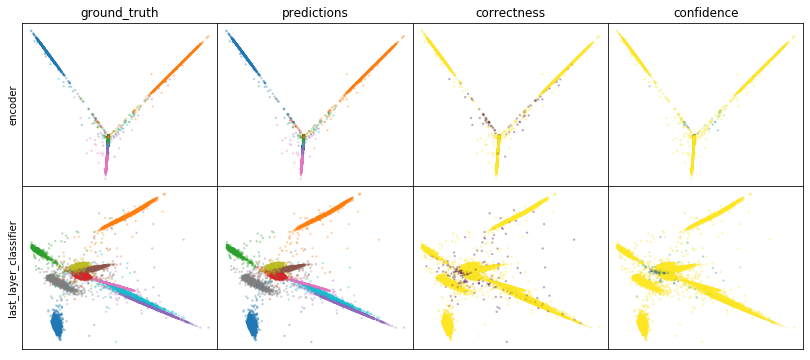

W0808 02:21:29.920524 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:21:30.275662 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:21:30.624527 140402527516416 legend.py:1282] No handles with labels found to put in legend.


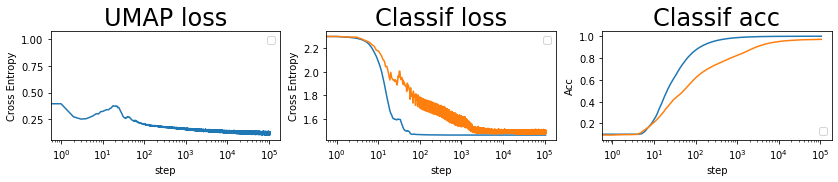

batch: 106000 | train acc: 0.9999 | val acc: 0.9711


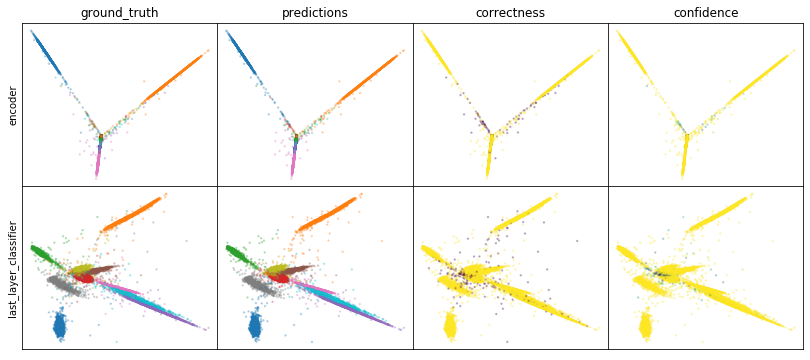

W0808 02:23:42.062218 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:23:42.423979 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:23:42.773705 140402527516416 legend.py:1282] No handles with labels found to put in legend.


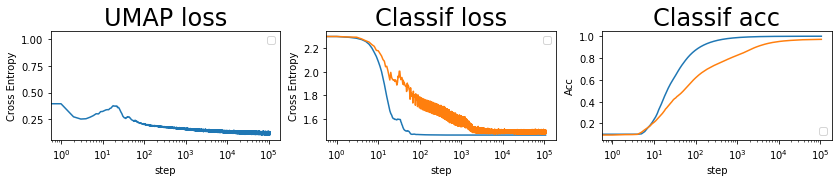

batch: 107000 | train acc: 0.9999 | val acc: 0.9711


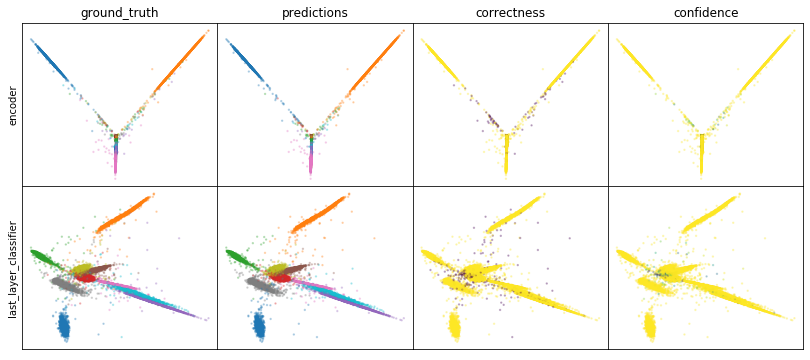

W0808 02:25:54.969470 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:25:55.336954 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:25:55.689469 140402527516416 legend.py:1282] No handles with labels found to put in legend.


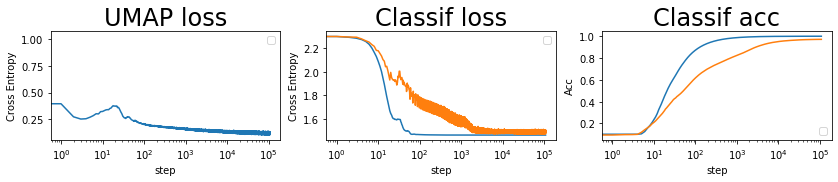

batch: 108000 | train acc: 0.9999 | val acc: 0.9712


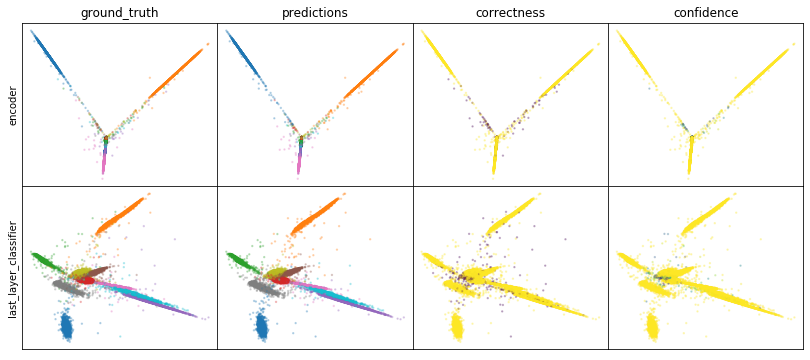

W0808 02:28:07.733955 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:28:08.100392 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:28:08.460601 140402527516416 legend.py:1282] No handles with labels found to put in legend.


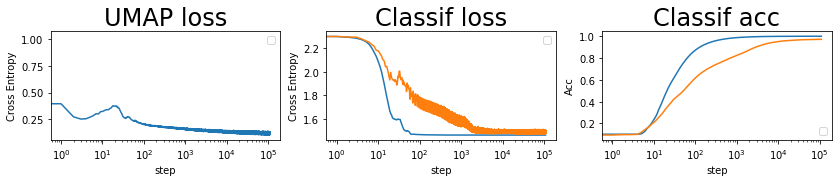

batch: 109000 | train acc: 0.9999 | val acc: 0.9712


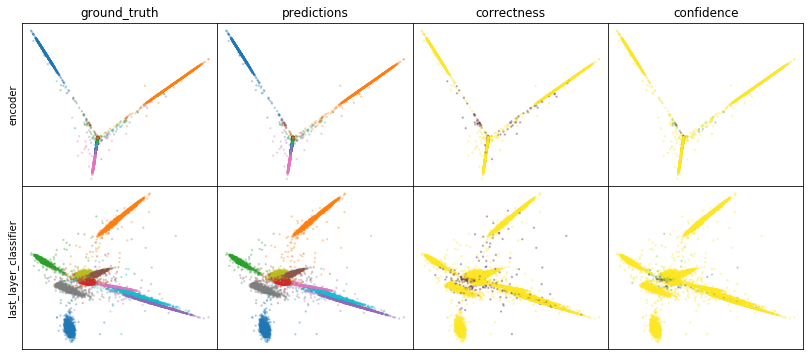

W0808 02:30:22.377005 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:30:22.765470 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:30:23.130488 140402527516416 legend.py:1282] No handles with labels found to put in legend.


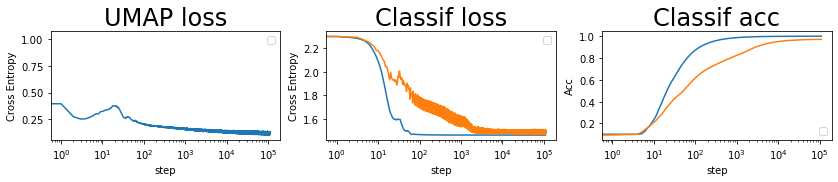

batch: 110000 | train acc: 0.9999 | val acc: 0.9712


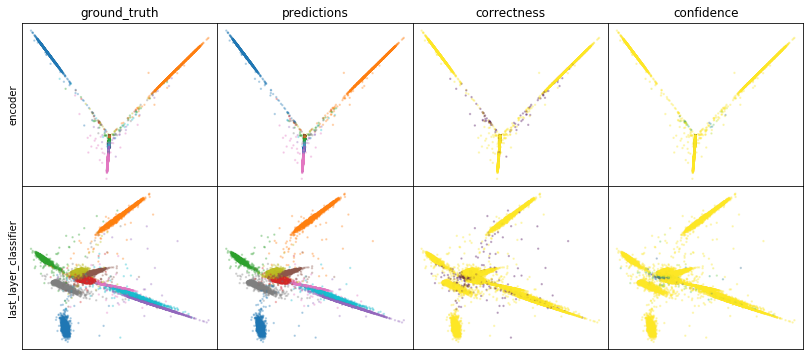

W0808 02:32:37.569499 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:32:37.960069 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:32:38.325016 140402527516416 legend.py:1282] No handles with labels found to put in legend.


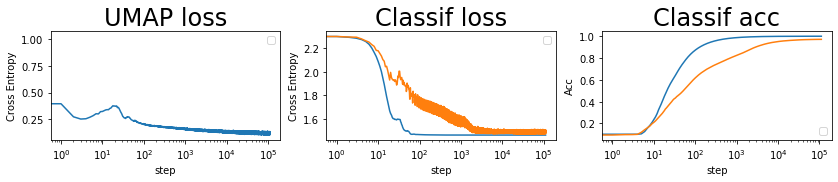

batch: 111000 | train acc: 0.9999 | val acc: 0.9712


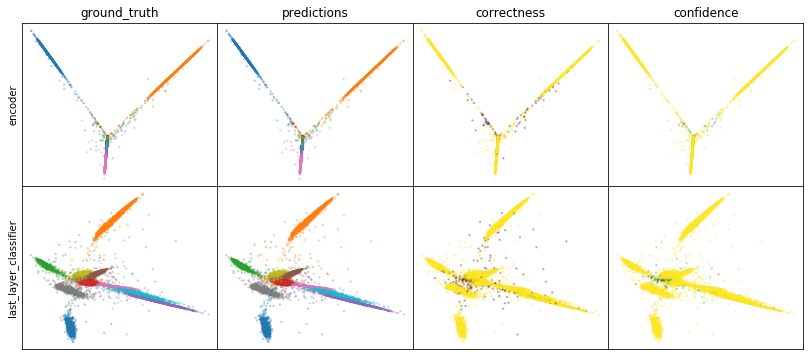

W0808 02:34:52.631035 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:34:53.009087 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:34:53.373423 140402527516416 legend.py:1282] No handles with labels found to put in legend.


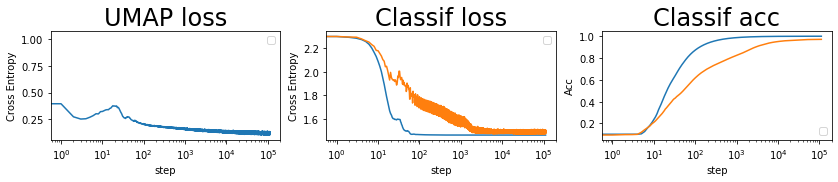

batch: 112000 | train acc: 0.9999 | val acc: 0.9712


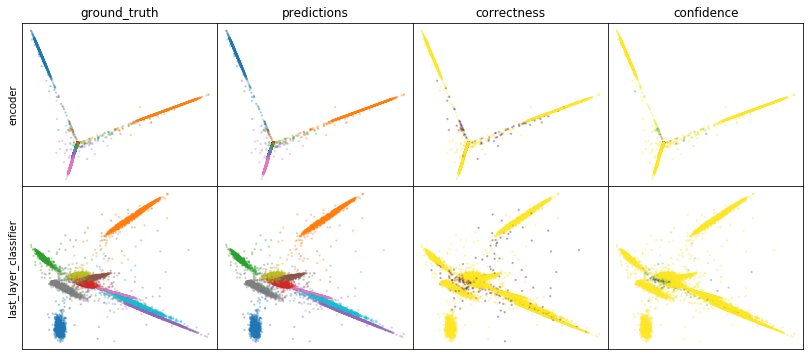

W0808 02:37:08.359194 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:37:08.748037 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:37:09.114446 140402527516416 legend.py:1282] No handles with labels found to put in legend.


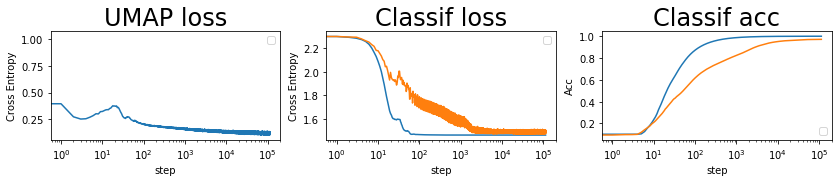

batch: 113000 | train acc: 0.9999 | val acc: 0.9712


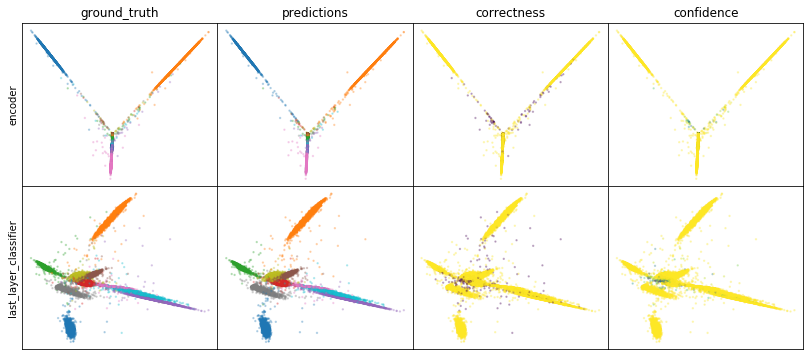

W0808 02:39:24.892620 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:39:25.310743 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:39:25.698549 140402527516416 legend.py:1282] No handles with labels found to put in legend.


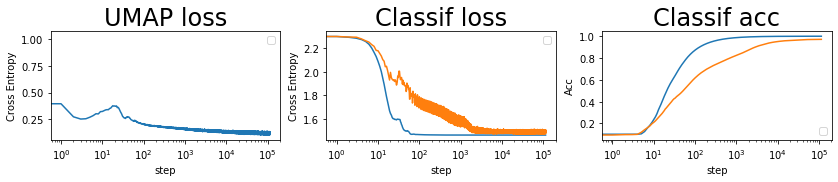

batch: 114000 | train acc: 0.9999 | val acc: 0.9712


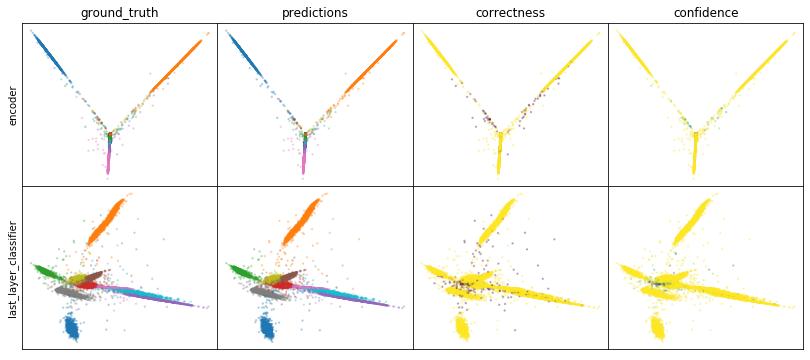

W0808 02:41:42.590269 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:41:42.982152 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:41:43.383861 140402527516416 legend.py:1282] No handles with labels found to put in legend.


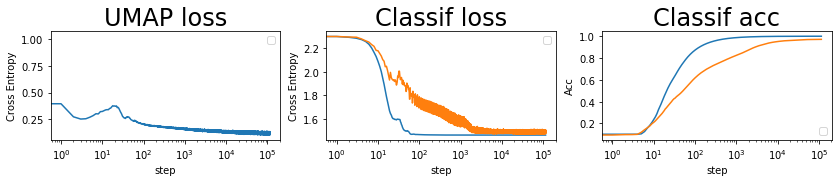

batch: 115000 | train acc: 0.9999 | val acc: 0.9712


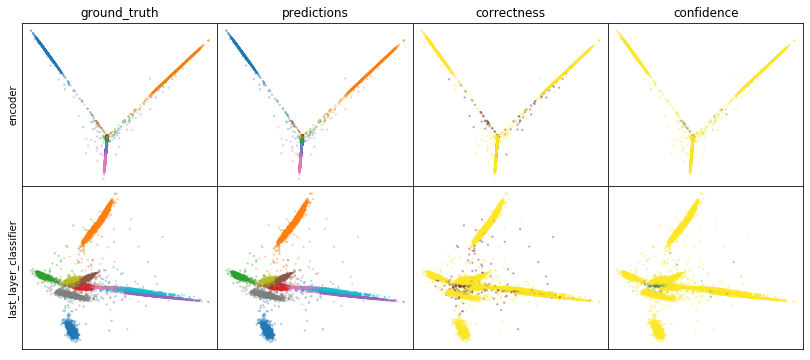

W0808 02:43:59.023016 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:43:59.419993 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:43:59.798163 140402527516416 legend.py:1282] No handles with labels found to put in legend.


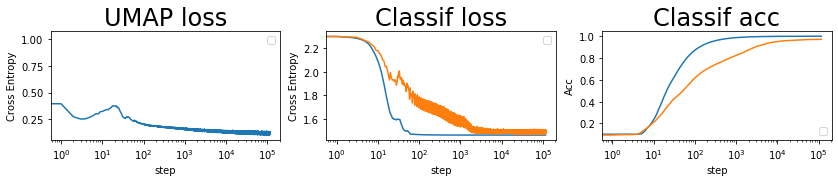

batch: 116000 | train acc: 0.9999 | val acc: 0.9712
leaving epoch because no improvement in 10000 batches


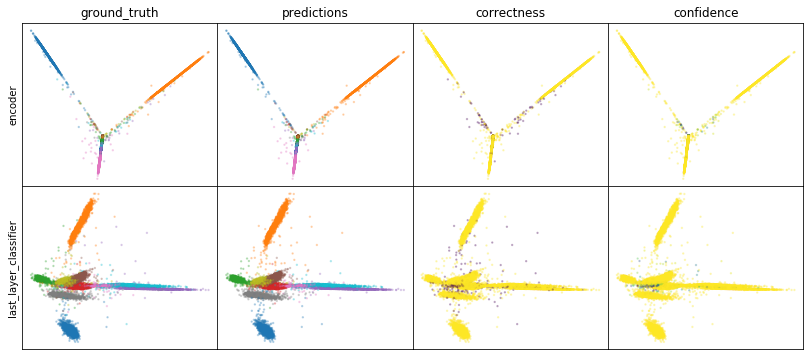

W0808 02:46:17.122517 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:46:17.504599 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:46:17.877025 140402527516416 legend.py:1282] No handles with labels found to put in legend.


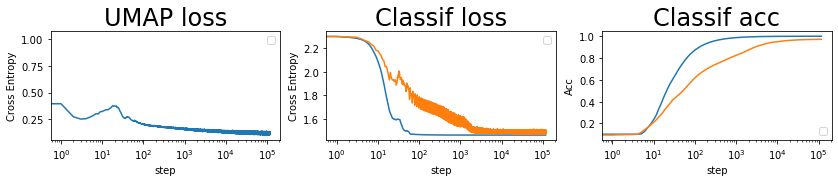

batch: 117000 | train acc: 0.9999 | val acc: 0.9712


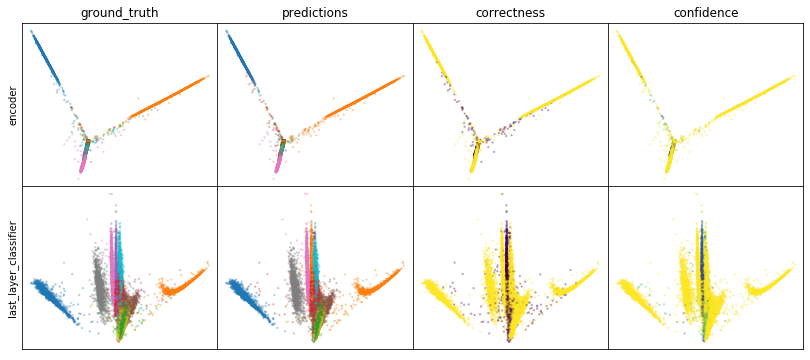

W0808 02:48:33.408757 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:48:33.815020 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:48:34.223490 140402527516416 legend.py:1282] No handles with labels found to put in legend.


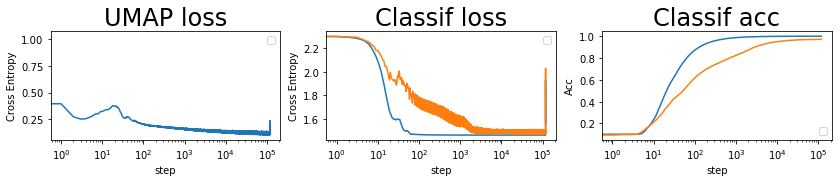

batch: 118000 | train acc: 0.9996 | val acc: 0.9709


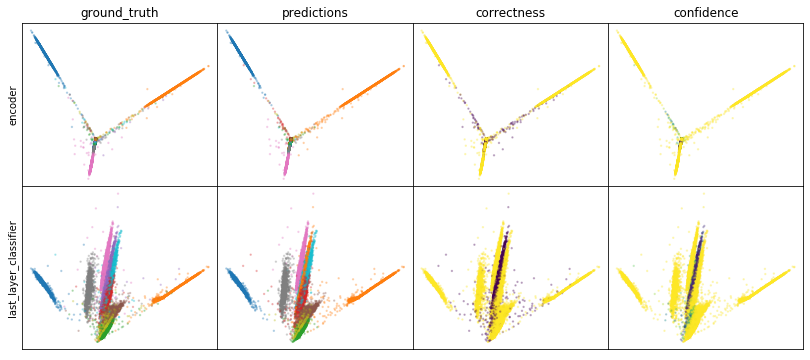

W0808 02:50:50.758508 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:50:51.152645 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:50:51.532530 140402527516416 legend.py:1282] No handles with labels found to put in legend.


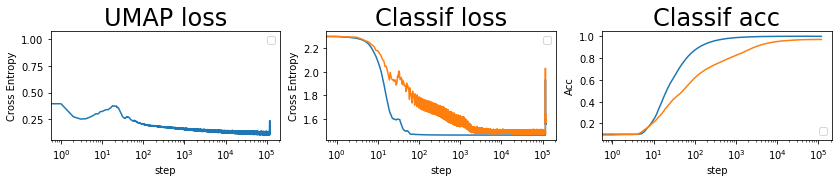

batch: 119000 | train acc: 0.9988 | val acc: 0.97


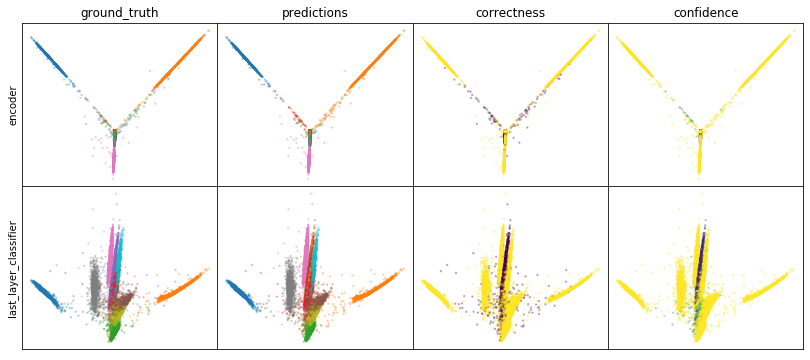

W0808 02:53:07.396431 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:53:07.795685 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:53:08.179441 140402527516416 legend.py:1282] No handles with labels found to put in legend.


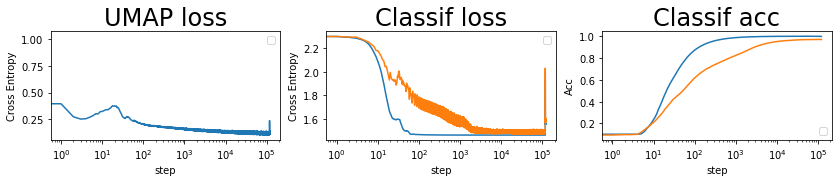

batch: 120000 | train acc: 0.998 | val acc: 0.9692


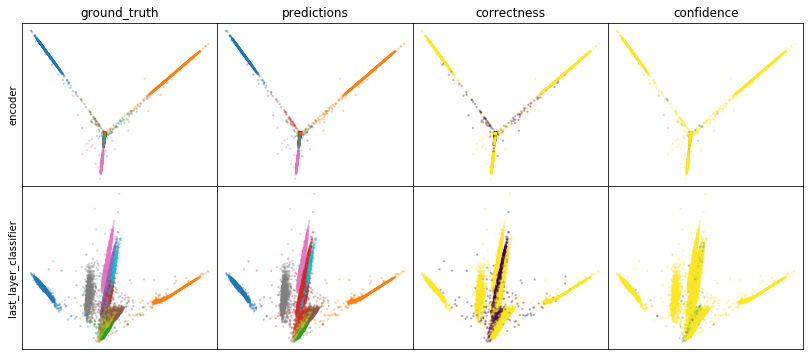

W0808 02:55:26.034195 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:55:26.426638 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:55:26.812538 140402527516416 legend.py:1282] No handles with labels found to put in legend.


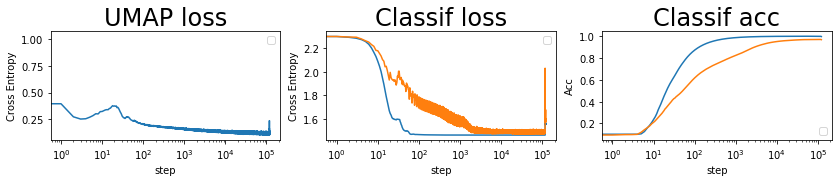

batch: 121000 | train acc: 0.9972 | val acc: 0.9684


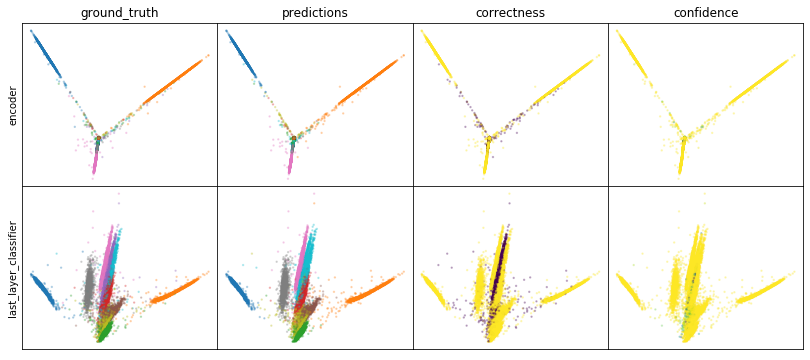

W0808 02:57:46.217691 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:57:46.630981 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 02:57:47.035454 140402527516416 legend.py:1282] No handles with labels found to put in legend.


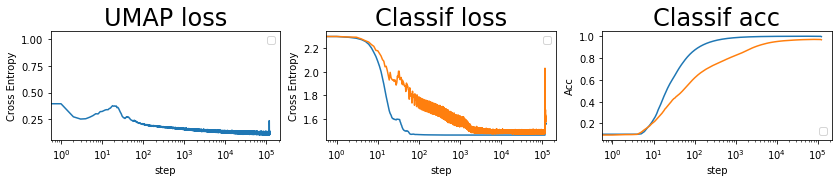

batch: 122000 | train acc: 0.9964 | val acc: 0.9676


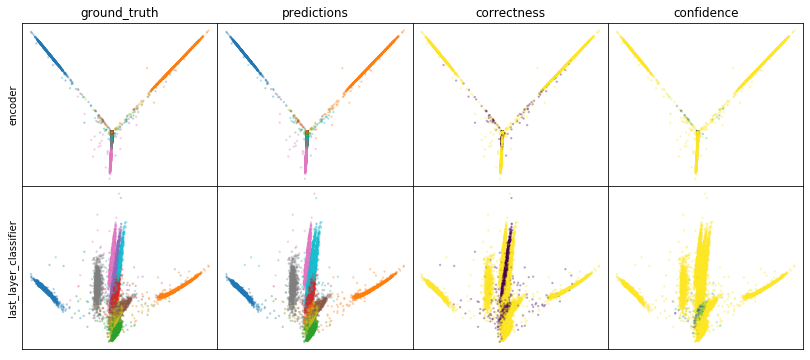

W0808 03:00:06.065486 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:00:06.483491 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:00:06.895440 140402527516416 legend.py:1282] No handles with labels found to put in legend.


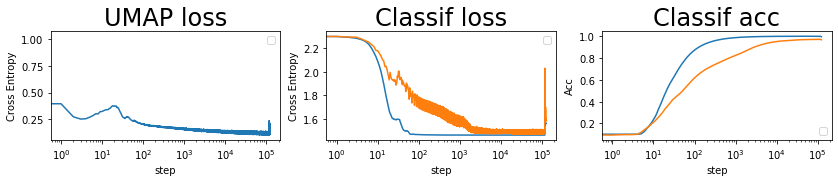

batch: 123000 | train acc: 0.9956 | val acc: 0.9667


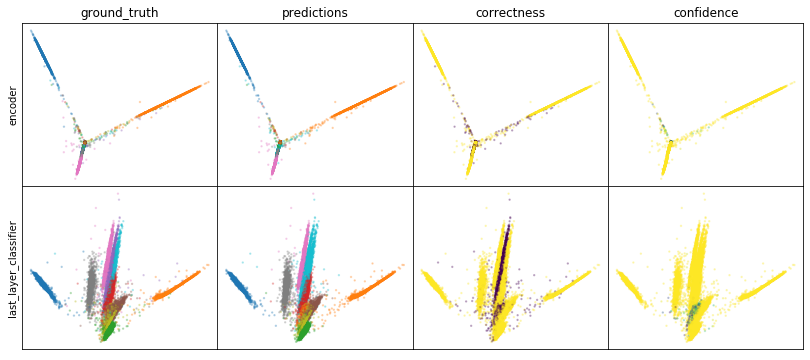

W0808 03:02:25.366918 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:02:25.777542 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:02:26.167213 140402527516416 legend.py:1282] No handles with labels found to put in legend.


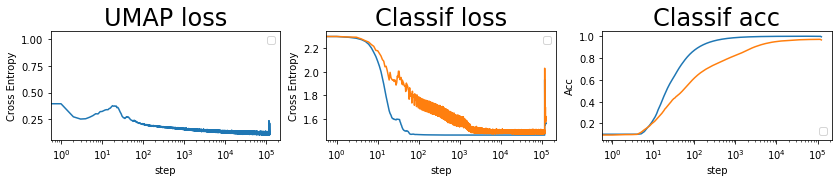

batch: 124000 | train acc: 0.9948 | val acc: 0.9659


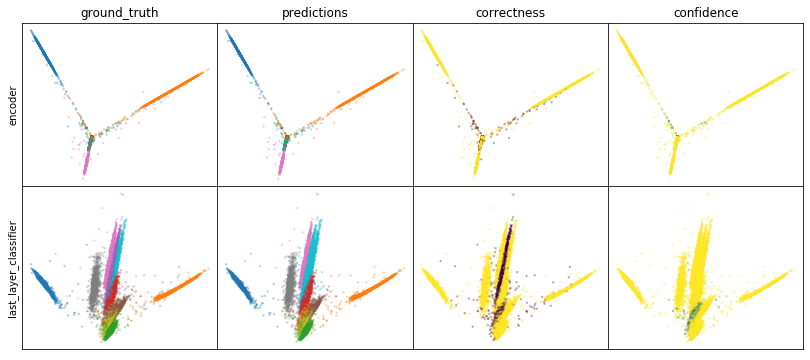

W0808 03:04:47.159525 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:04:47.570406 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:04:47.969414 140402527516416 legend.py:1282] No handles with labels found to put in legend.


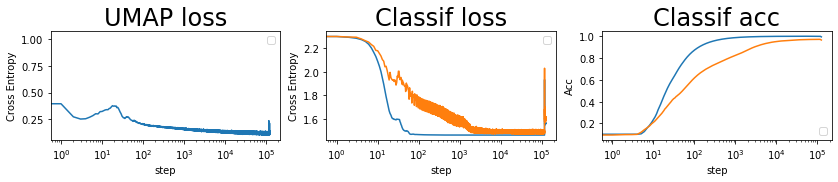

batch: 125000 | train acc: 0.994 | val acc: 0.965


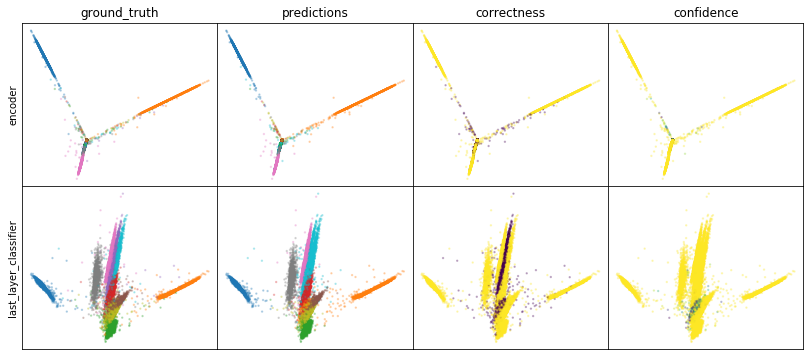

W0808 03:07:08.552134 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:07:08.955811 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:07:09.352121 140402527516416 legend.py:1282] No handles with labels found to put in legend.


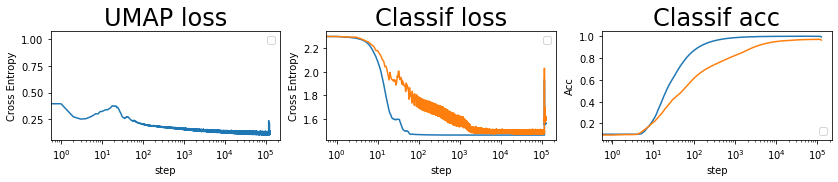

batch: 126000 | train acc: 0.9933 | val acc: 0.9642
leaving epoch because no improvement in 10000 batches


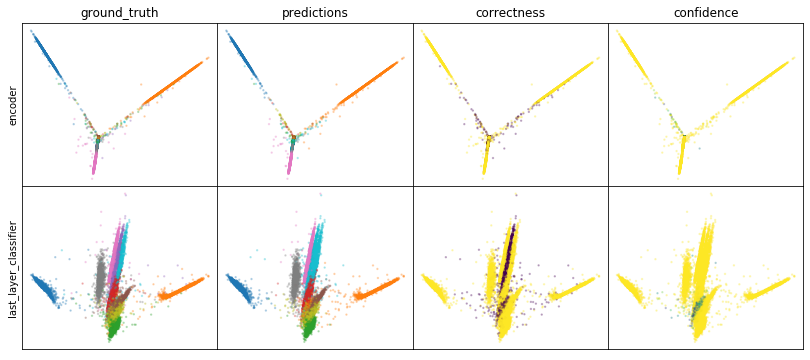

W0808 03:09:30.830179 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:09:31.247590 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:09:31.650766 140402527516416 legend.py:1282] No handles with labels found to put in legend.


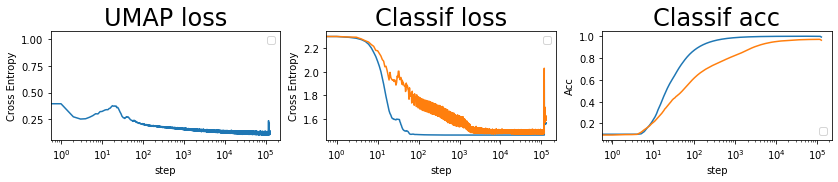

batch: 127000 | train acc: 0.9926 | val acc: 0.9633


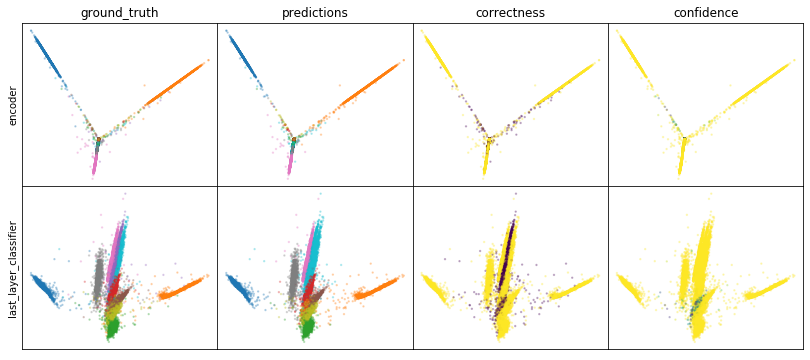

W0808 03:11:52.615324 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:11:53.067305 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:11:53.493326 140402527516416 legend.py:1282] No handles with labels found to put in legend.


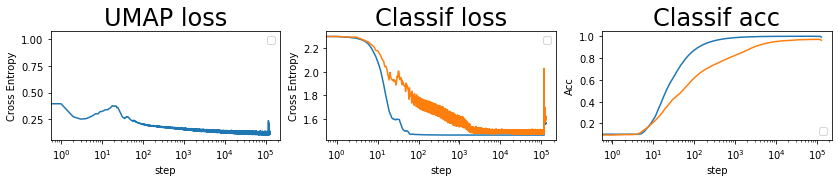

batch: 128000 | train acc: 0.9918 | val acc: 0.9625


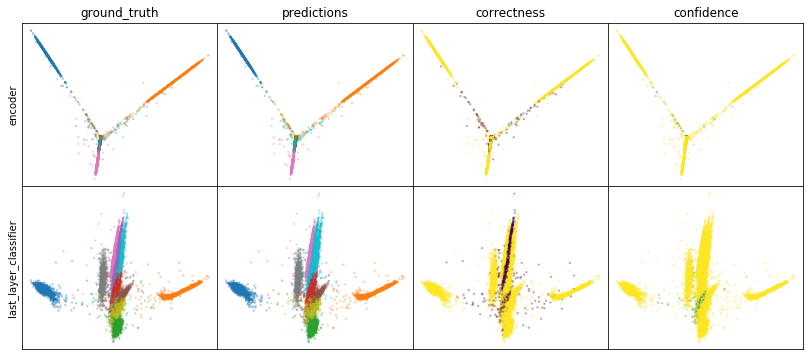

W0808 03:14:16.305566 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:14:16.743684 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:14:17.155261 140402527516416 legend.py:1282] No handles with labels found to put in legend.


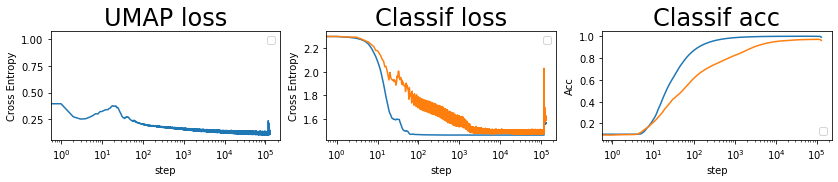

batch: 129000 | train acc: 0.9911 | val acc: 0.9617


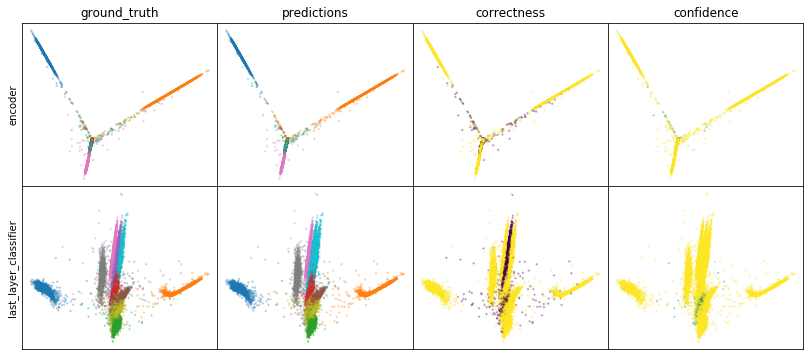

W0808 03:16:38.873384 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:16:39.310127 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:16:39.721188 140402527516416 legend.py:1282] No handles with labels found to put in legend.


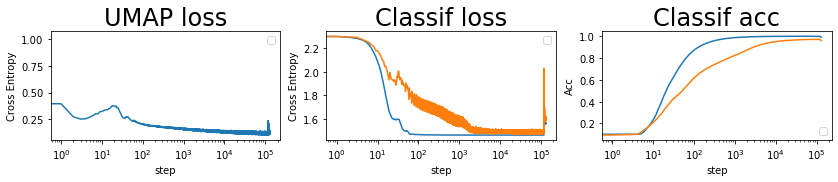

batch: 130000 | train acc: 0.9904 | val acc: 0.9609


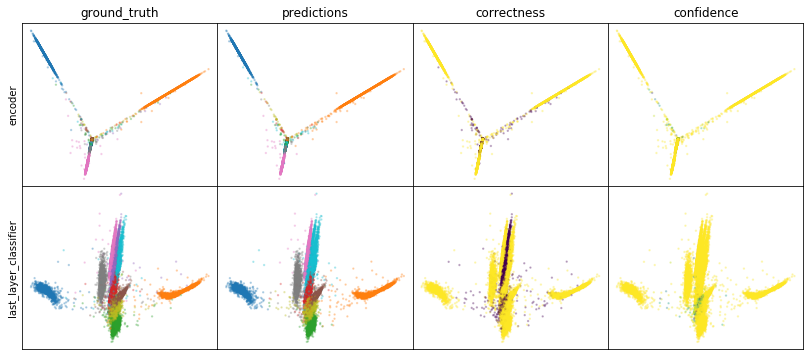

W0808 03:19:03.264624 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:19:03.695628 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:19:04.119606 140402527516416 legend.py:1282] No handles with labels found to put in legend.


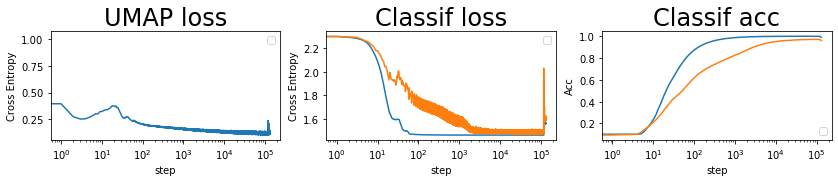

batch: 131000 | train acc: 0.9897 | val acc: 0.9602


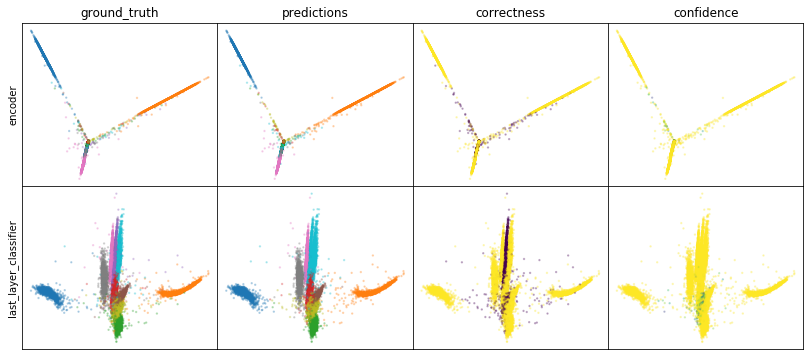

W0808 03:21:27.719518 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:21:28.168408 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:21:28.603705 140402527516416 legend.py:1282] No handles with labels found to put in legend.


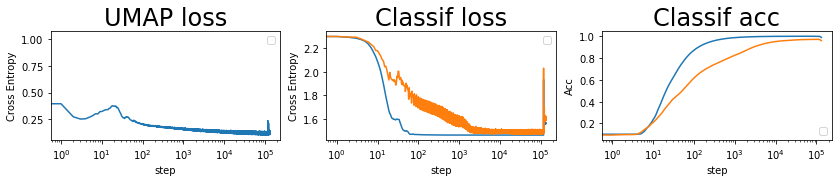

batch: 132000 | train acc: 0.9891 | val acc: 0.9594


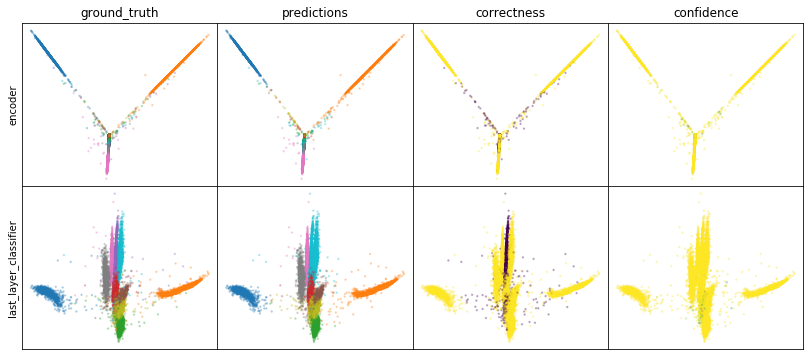

W0808 03:23:52.028540 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:23:52.498579 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:23:52.952005 140402527516416 legend.py:1282] No handles with labels found to put in legend.


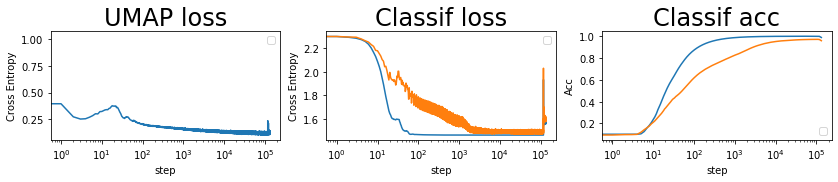

batch: 133000 | train acc: 0.9884 | val acc: 0.9587
batch 133767 | acc = 0.958 | learn rate = 0.0010000000474974513 | reloading weights from batch 41889 at acc 96 | n reloads = 0


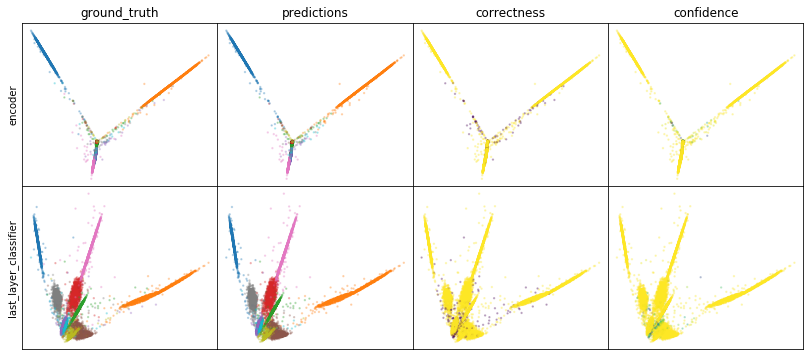

W0808 03:26:17.506449 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:26:17.972686 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:26:18.431953 140402527516416 legend.py:1282] No handles with labels found to put in legend.


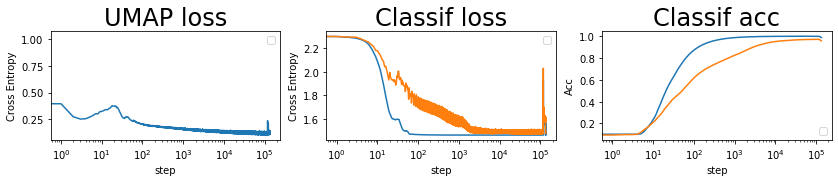

batch: 134000 | train acc: 0.9879 | val acc: 0.9582


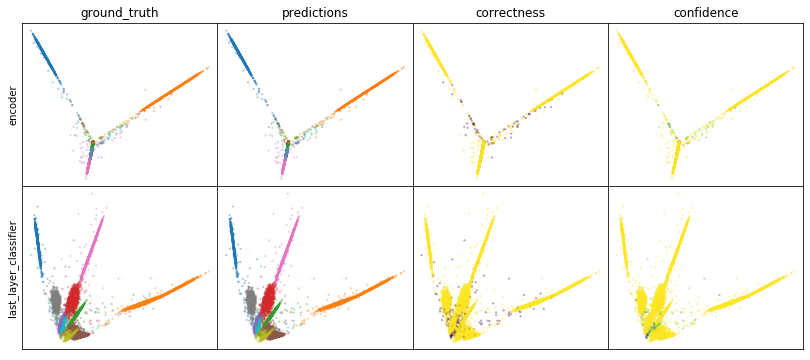

W0808 03:28:43.542496 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:28:44.005707 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:28:44.452260 140402527516416 legend.py:1282] No handles with labels found to put in legend.


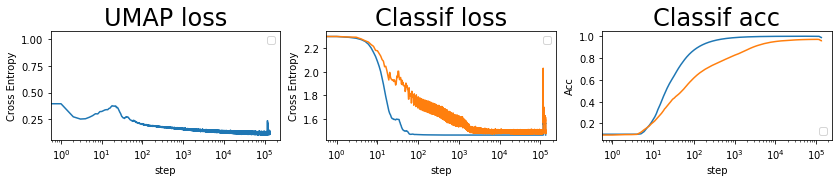

batch: 135000 | train acc: 0.988 | val acc: 0.9584


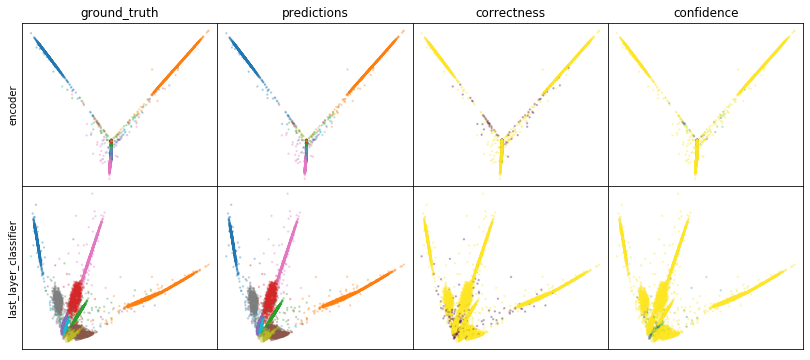

W0808 03:31:10.292866 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:31:10.763475 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:31:11.223705 140402527516416 legend.py:1282] No handles with labels found to put in legend.


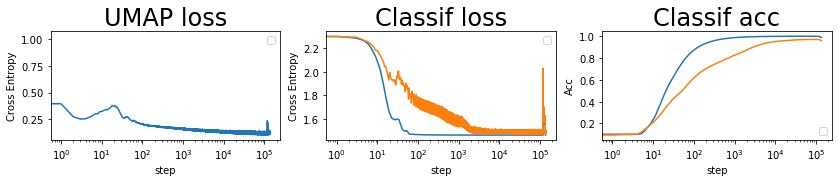

batch: 136000 | train acc: 0.9882 | val acc: 0.9585
leaving epoch because no improvement in 10000 batches


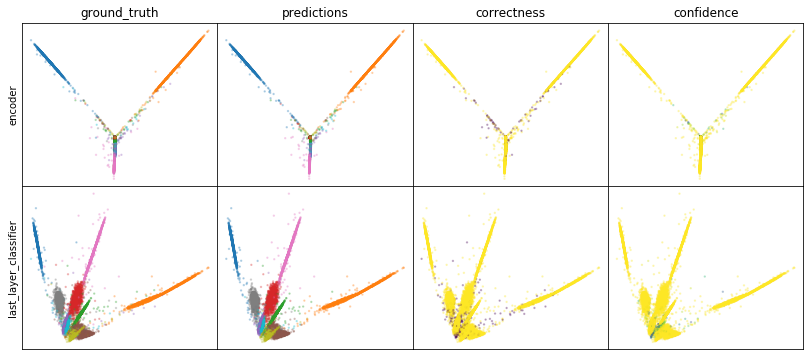

W0808 03:33:37.056961 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:33:37.533889 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:33:37.986328 140402527516416 legend.py:1282] No handles with labels found to put in legend.


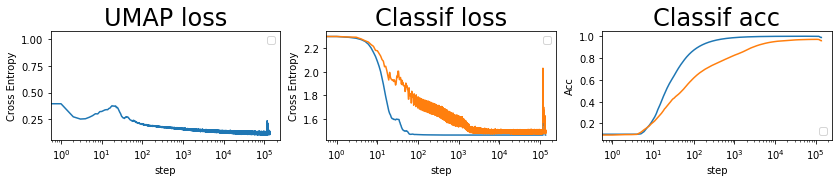

batch: 137000 | train acc: 0.9883 | val acc: 0.9587


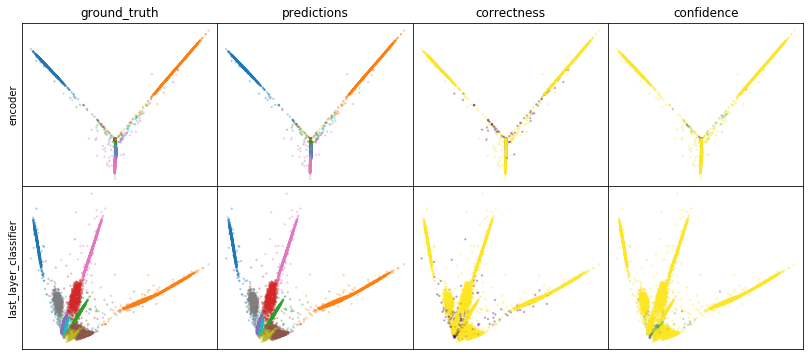

W0808 03:36:04.205619 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:36:04.683931 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:36:05.154681 140402527516416 legend.py:1282] No handles with labels found to put in legend.


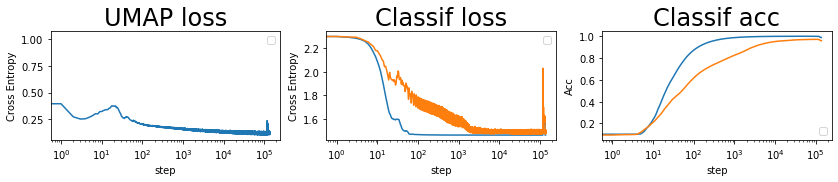

batch: 138000 | train acc: 0.9883 | val acc: 0.9589


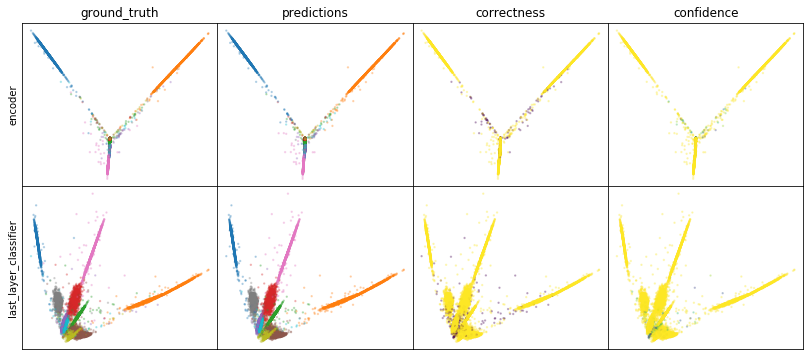

W0808 03:38:31.888958 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:38:32.363438 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:38:32.834406 140402527516416 legend.py:1282] No handles with labels found to put in legend.


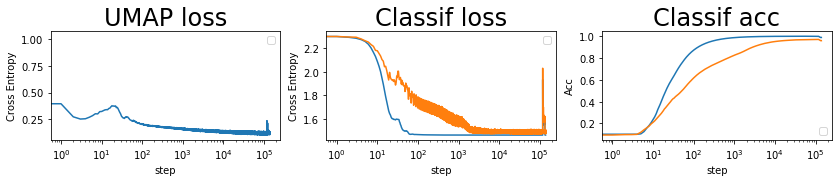

batch: 139000 | train acc: 0.9884 | val acc: 0.959


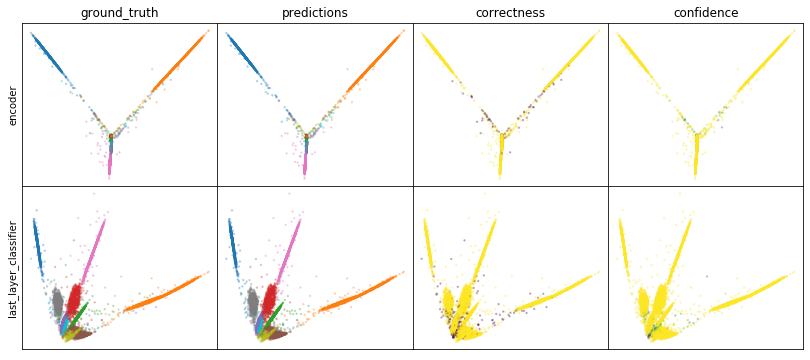

W0808 03:40:58.553268 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:40:59.019418 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:40:59.489384 140402527516416 legend.py:1282] No handles with labels found to put in legend.


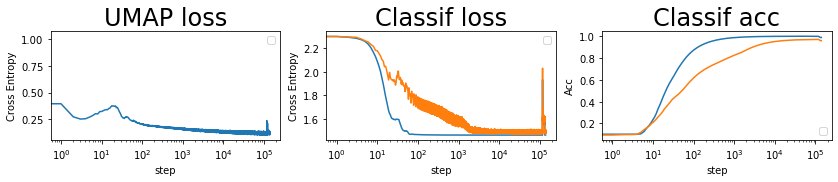

batch: 140000 | train acc: 0.9885 | val acc: 0.9592


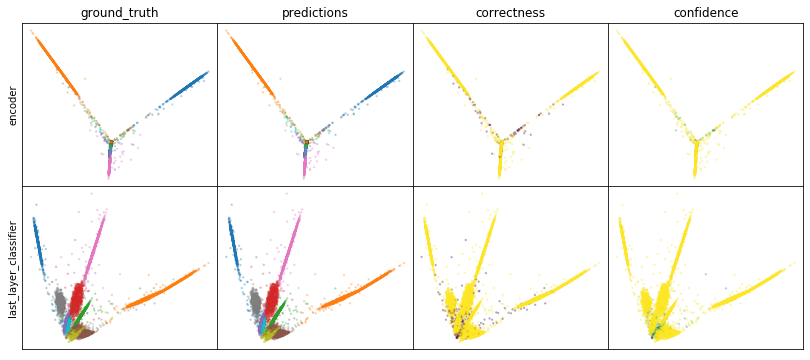

W0808 03:43:26.728326 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:43:27.215313 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:43:27.676911 140402527516416 legend.py:1282] No handles with labels found to put in legend.


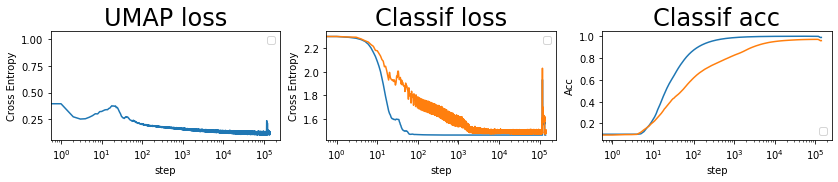

batch: 141000 | train acc: 0.9886 | val acc: 0.9594


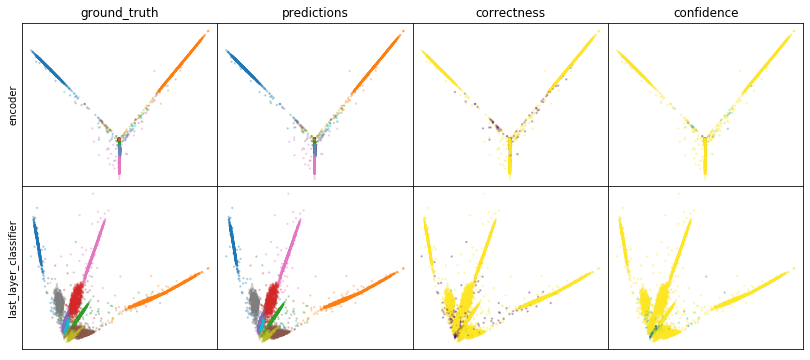

W0808 03:45:54.814919 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:45:55.288804 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:45:55.750205 140402527516416 legend.py:1282] No handles with labels found to put in legend.


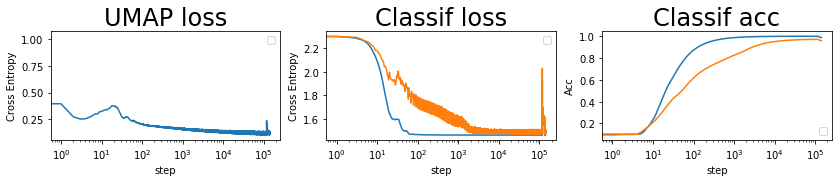

batch: 142000 | train acc: 0.9887 | val acc: 0.9595


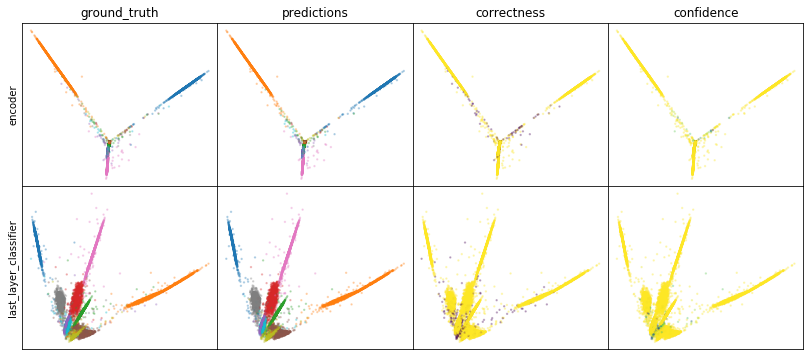

W0808 03:48:25.154239 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:48:25.631779 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:48:26.101251 140402527516416 legend.py:1282] No handles with labels found to put in legend.


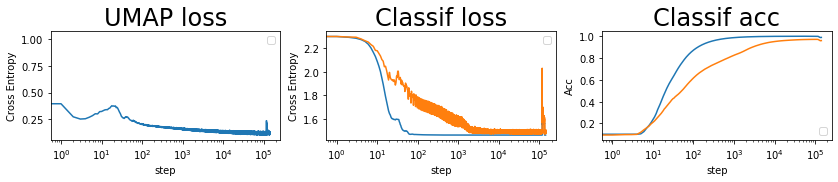

batch: 143000 | train acc: 0.9887 | val acc: 0.9597


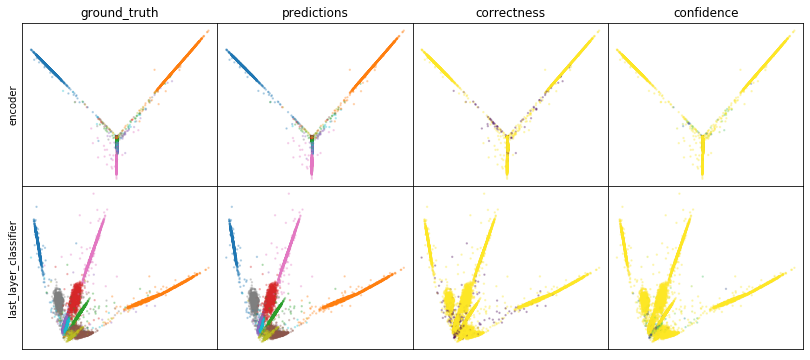

W0808 03:50:55.263099 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:50:55.744980 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:50:56.217235 140402527516416 legend.py:1282] No handles with labels found to put in legend.


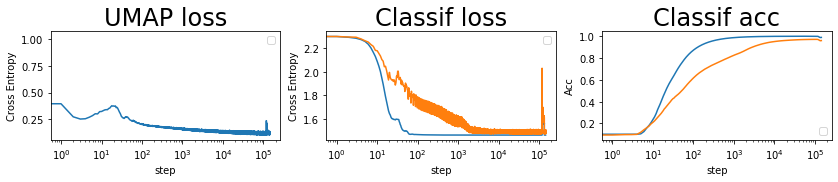

batch: 144000 | train acc: 0.9888 | val acc: 0.9598


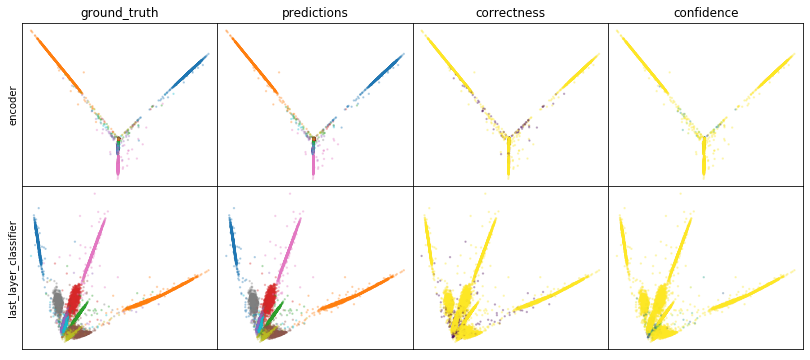

W0808 03:53:26.420382 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:53:26.932736 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:53:27.415449 140402527516416 legend.py:1282] No handles with labels found to put in legend.


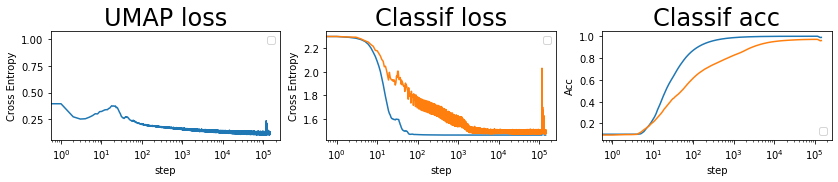

batch: 145000 | train acc: 0.9889 | val acc: 0.96


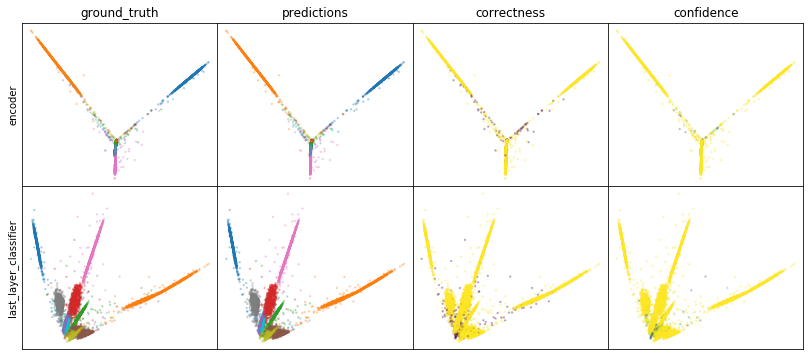

W0808 03:55:56.727138 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:55:57.224272 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:55:57.706414 140402527516416 legend.py:1282] No handles with labels found to put in legend.


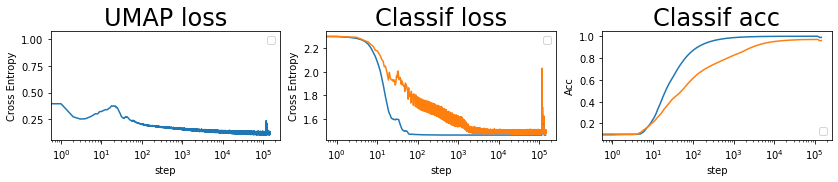

batch: 146000 | train acc: 0.989 | val acc: 0.9601
leaving epoch because no improvement in 10000 batches


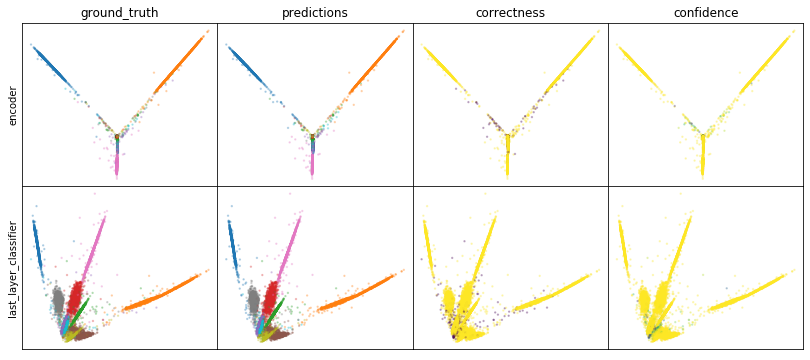

W0808 03:58:27.448494 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:58:27.972122 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 03:58:28.477848 140402527516416 legend.py:1282] No handles with labels found to put in legend.


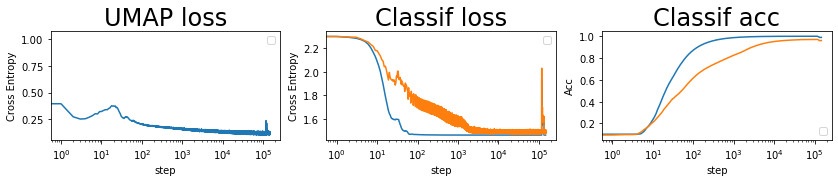

batch: 147000 | train acc: 0.989 | val acc: 0.9603


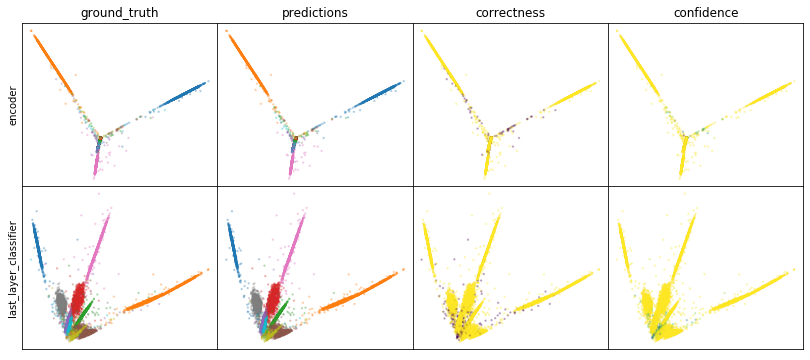

W0808 04:01:01.374075 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:01:01.921082 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:01:02.419930 140402527516416 legend.py:1282] No handles with labels found to put in legend.


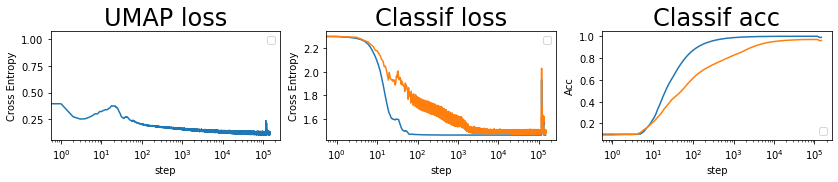

batch: 148000 | train acc: 0.9891 | val acc: 0.9604


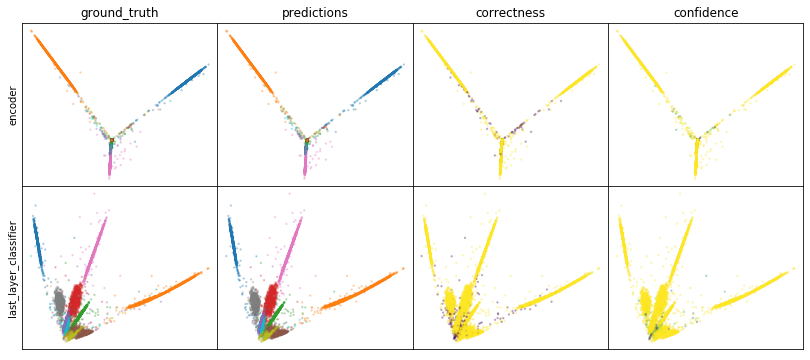

W0808 04:03:34.265636 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:03:34.804842 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:03:35.308434 140402527516416 legend.py:1282] No handles with labels found to put in legend.


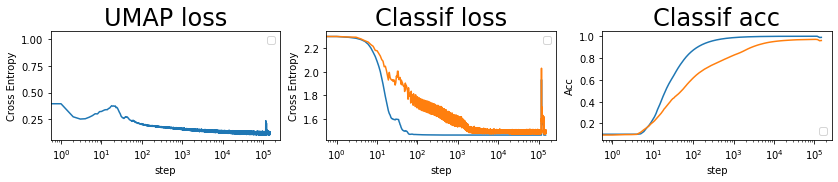

batch: 149000 | train acc: 0.9892 | val acc: 0.9605


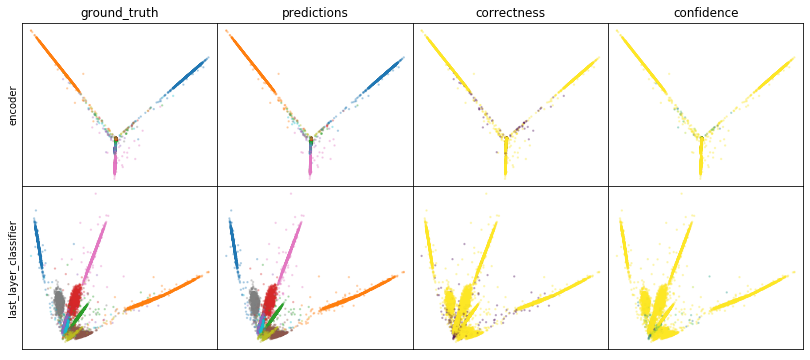

W0808 04:06:08.674659 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:06:09.224781 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:06:09.747639 140402527516416 legend.py:1282] No handles with labels found to put in legend.


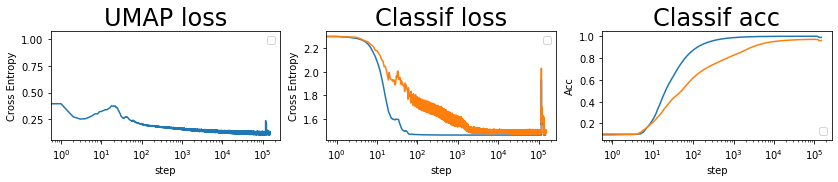

batch: 150000 | train acc: 0.9893 | val acc: 0.9607


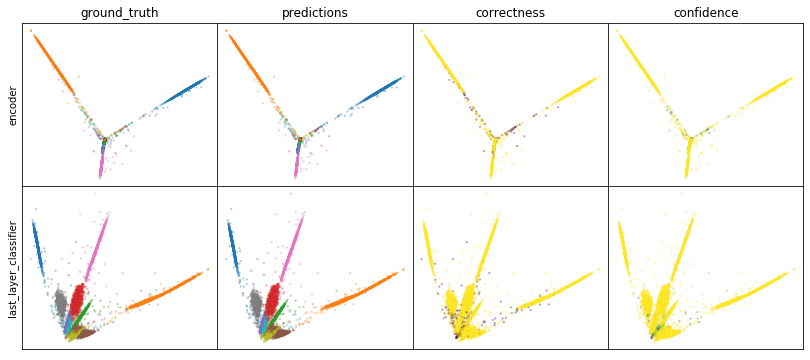

W0808 04:08:40.553753 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:08:41.060429 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:08:41.557341 140402527516416 legend.py:1282] No handles with labels found to put in legend.


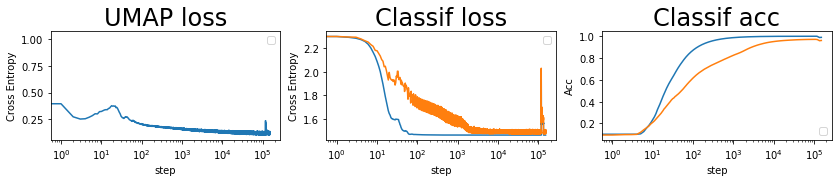

batch: 151000 | train acc: 0.9893 | val acc: 0.9608


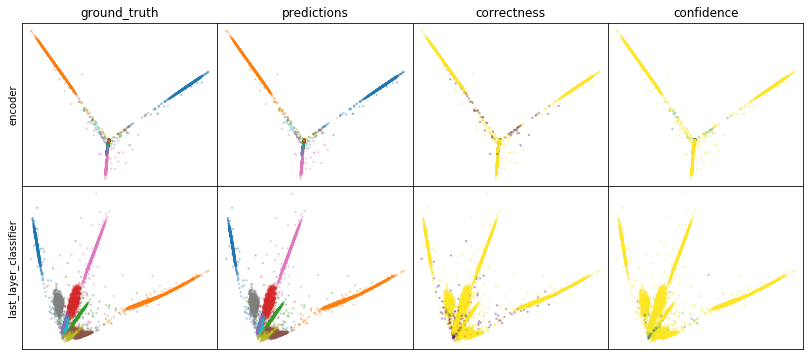

W0808 04:11:13.089962 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:11:13.618892 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:11:14.122116 140402527516416 legend.py:1282] No handles with labels found to put in legend.


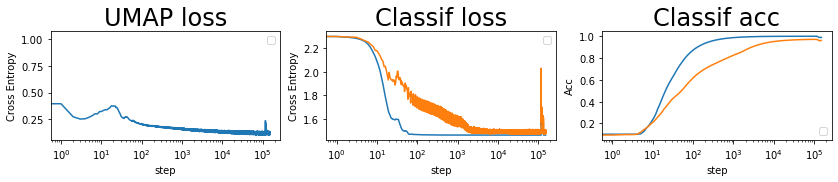

batch: 152000 | train acc: 0.9894 | val acc: 0.9609


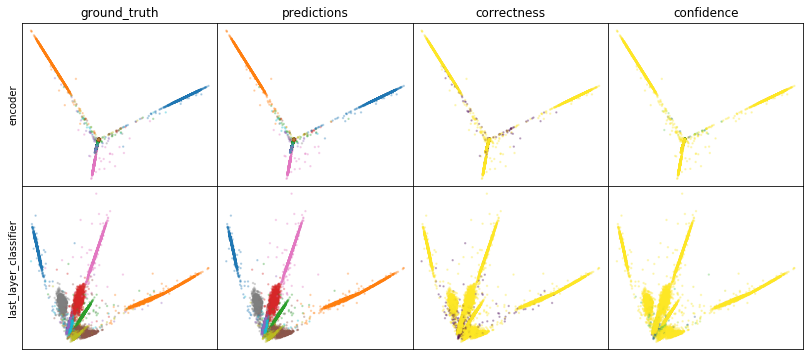

W0808 04:13:46.285343 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:13:46.818031 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:13:47.372978 140402527516416 legend.py:1282] No handles with labels found to put in legend.


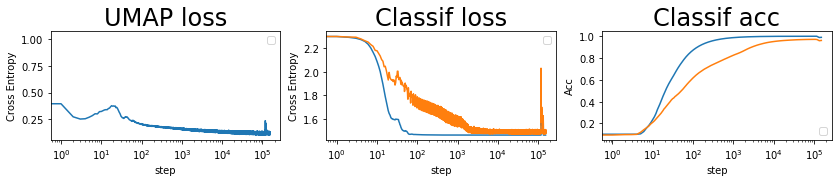

batch: 153000 | train acc: 0.9895 | val acc: 0.9611


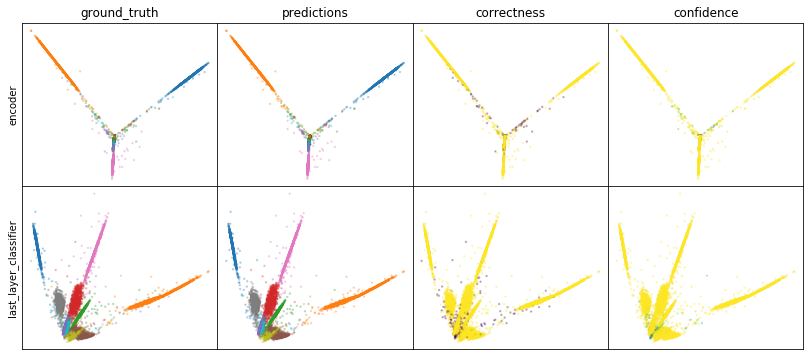

W0808 04:16:20.531113 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:16:21.046039 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:16:21.550388 140402527516416 legend.py:1282] No handles with labels found to put in legend.


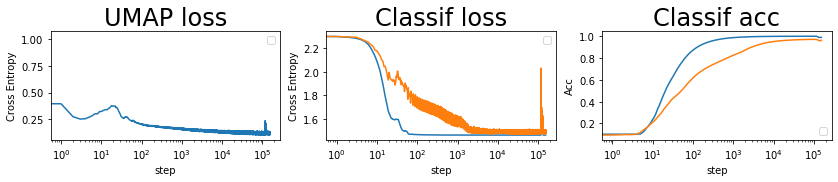

batch: 154000 | train acc: 0.9895 | val acc: 0.9612


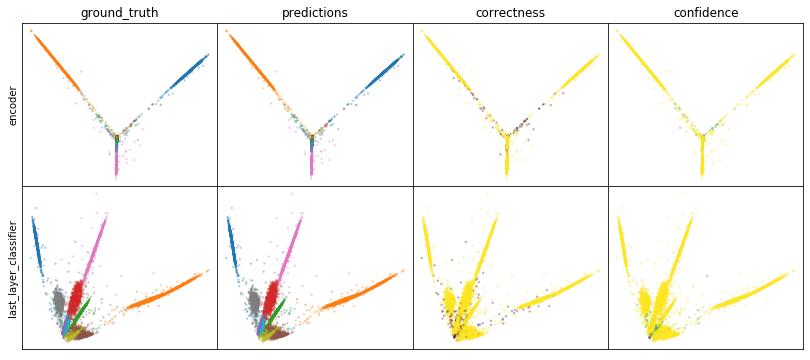

W0808 04:18:56.266510 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:18:56.803842 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:18:57.328607 140402527516416 legend.py:1282] No handles with labels found to put in legend.


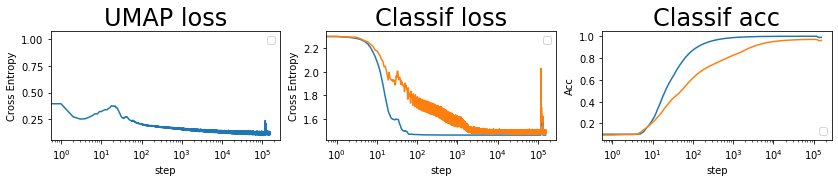

batch: 155000 | train acc: 0.9896 | val acc: 0.9613


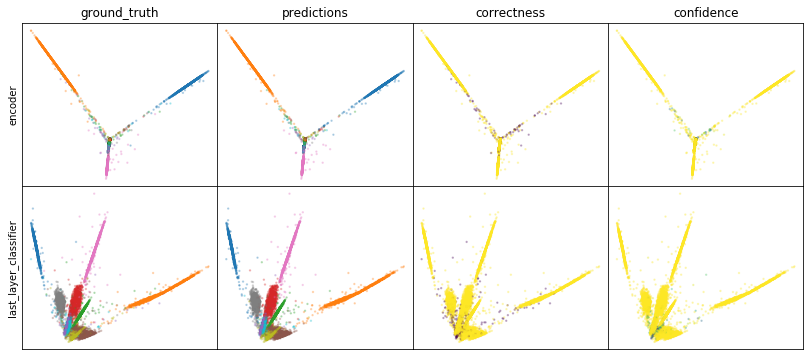

W0808 04:21:32.601849 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:21:33.159990 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:21:33.718671 140402527516416 legend.py:1282] No handles with labels found to put in legend.


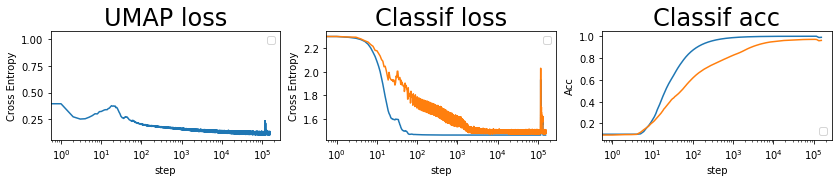

batch: 156000 | train acc: 0.9897 | val acc: 0.9615
leaving epoch because no improvement in 10000 batches


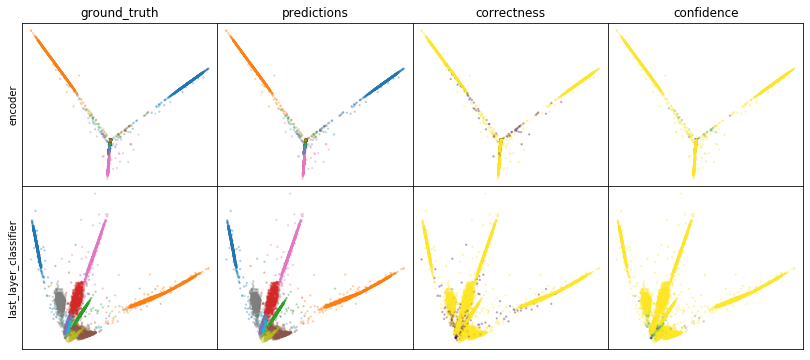

W0808 04:24:09.862305 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:24:10.389820 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:24:10.923312 140402527516416 legend.py:1282] No handles with labels found to put in legend.


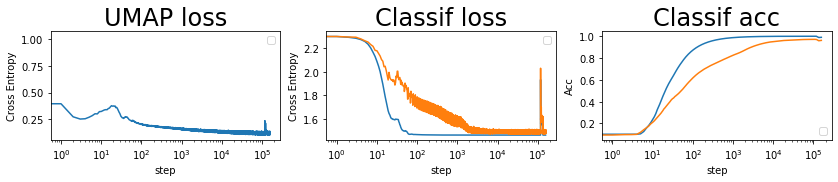

batch: 157000 | train acc: 0.9897 | val acc: 0.9616


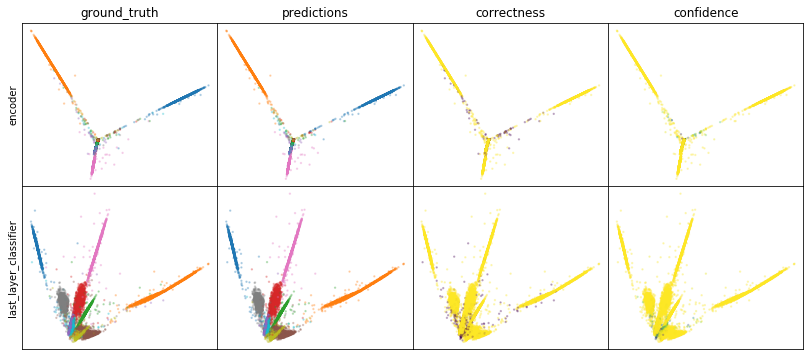

W0808 04:26:46.556140 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:26:47.087227 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:26:47.610683 140402527516416 legend.py:1282] No handles with labels found to put in legend.


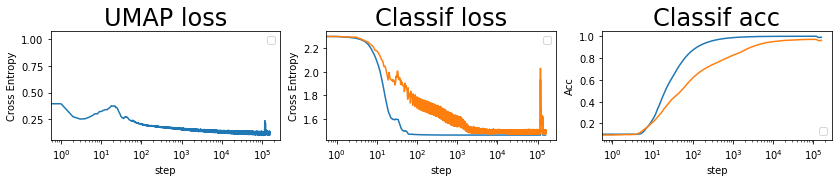

batch: 158000 | train acc: 0.9898 | val acc: 0.9617


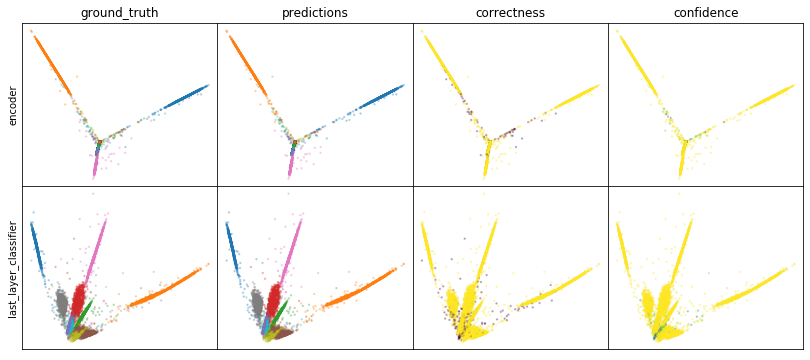

W0808 04:29:23.990238 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:29:24.551124 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:29:25.089083 140402527516416 legend.py:1282] No handles with labels found to put in legend.


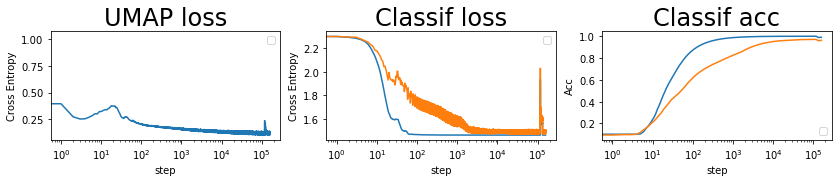

batch: 159000 | train acc: 0.9899 | val acc: 0.9618


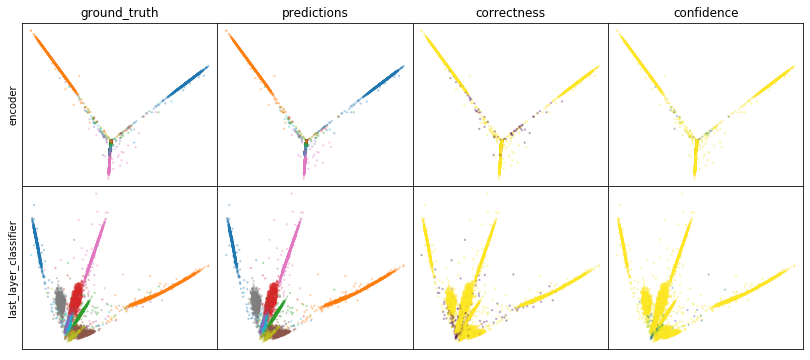

W0808 04:32:02.274687 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:32:02.820291 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:32:03.375940 140402527516416 legend.py:1282] No handles with labels found to put in legend.


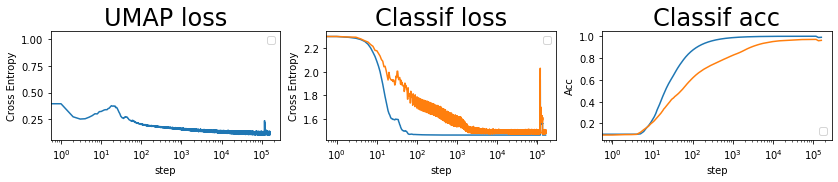

batch: 160000 | train acc: 0.9899 | val acc: 0.962


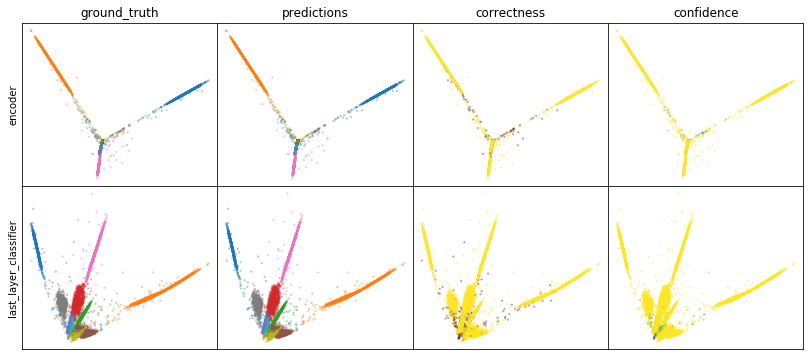

W0808 04:34:41.968480 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:34:42.546675 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:34:43.098430 140402527516416 legend.py:1282] No handles with labels found to put in legend.


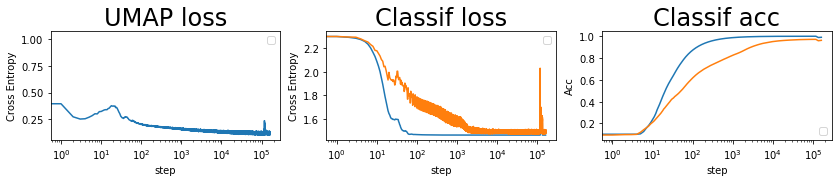

batch: 161000 | train acc: 0.99 | val acc: 0.9621


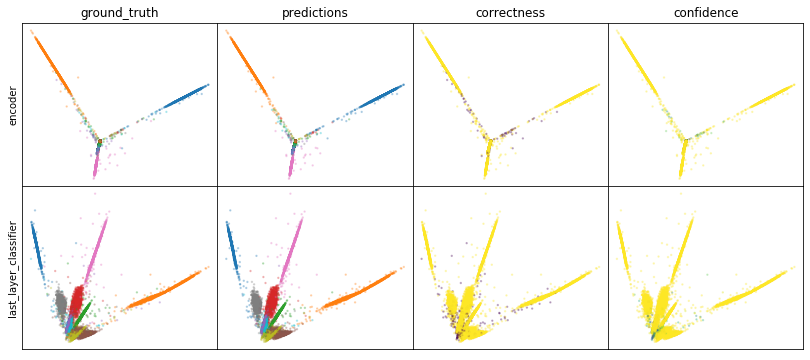

W0808 04:37:21.438602 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:37:21.986161 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:37:22.516516 140402527516416 legend.py:1282] No handles with labels found to put in legend.


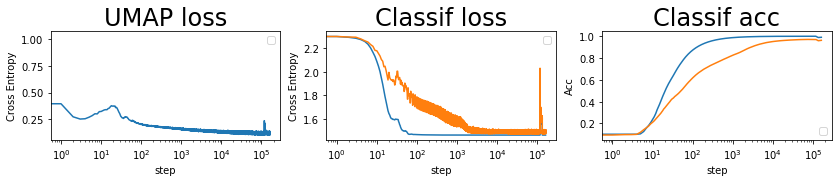

batch: 162000 | train acc: 0.9901 | val acc: 0.9622


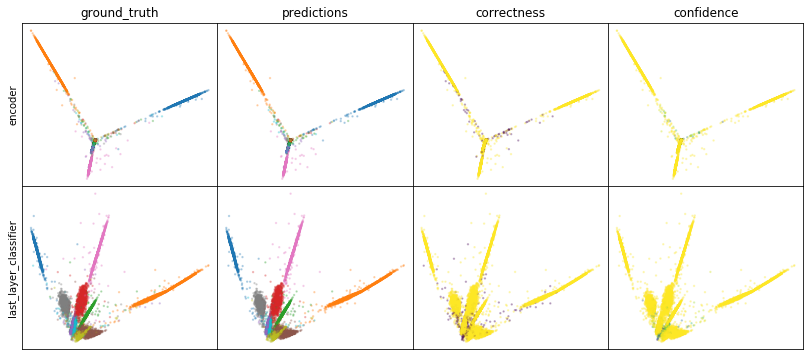

W0808 04:40:01.123088 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:40:01.726259 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:40:02.294848 140402527516416 legend.py:1282] No handles with labels found to put in legend.


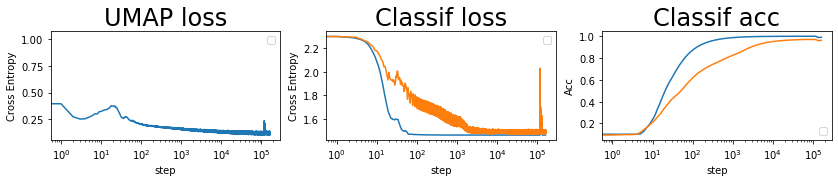

batch: 163000 | train acc: 0.9901 | val acc: 0.9623


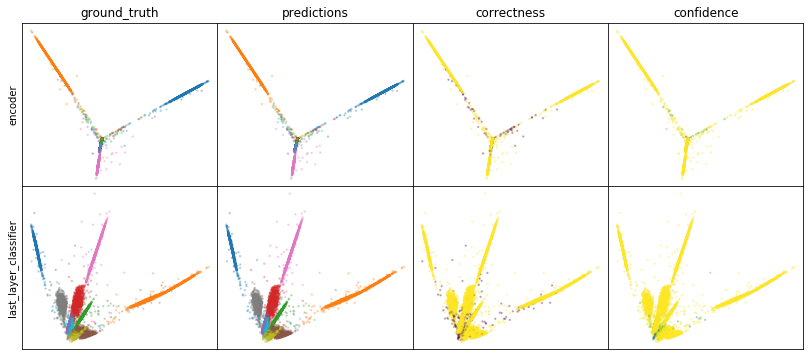

W0808 04:42:41.313111 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:42:41.864116 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:42:42.405372 140402527516416 legend.py:1282] No handles with labels found to put in legend.


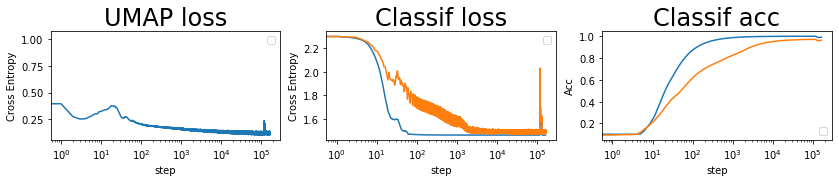

batch: 164000 | train acc: 0.9902 | val acc: 0.9624


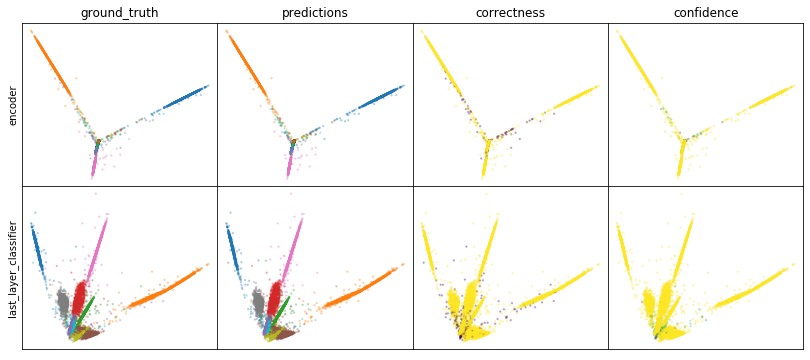

W0808 04:45:22.130051 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:45:22.690110 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:45:23.232436 140402527516416 legend.py:1282] No handles with labels found to put in legend.


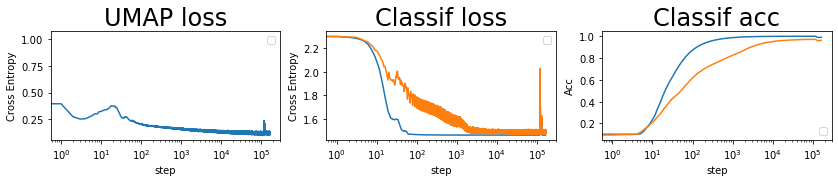

batch: 165000 | train acc: 0.9902 | val acc: 0.9625


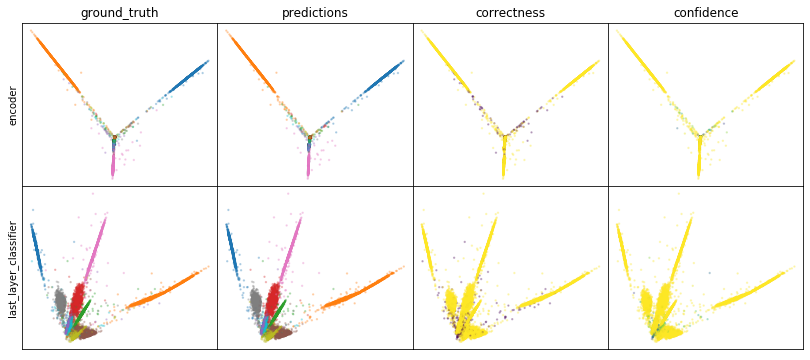

W0808 04:48:03.442286 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:48:04.000049 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:48:04.549376 140402527516416 legend.py:1282] No handles with labels found to put in legend.


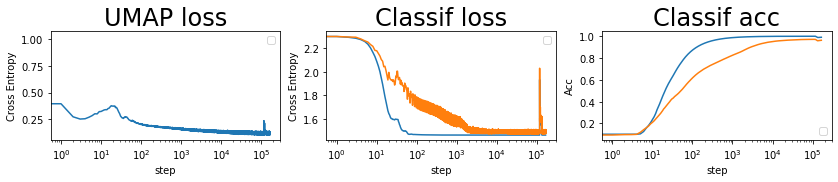

batch: 166000 | train acc: 0.9903 | val acc: 0.9626
leaving epoch because no improvement in 10000 batches


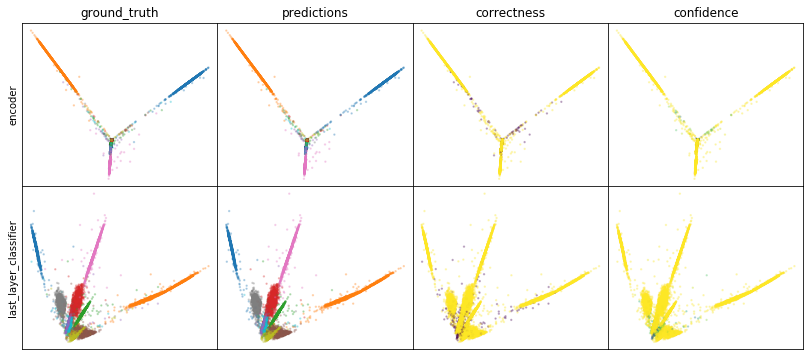

W0808 04:50:44.903115 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:50:45.458622 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:50:46.001853 140402527516416 legend.py:1282] No handles with labels found to put in legend.


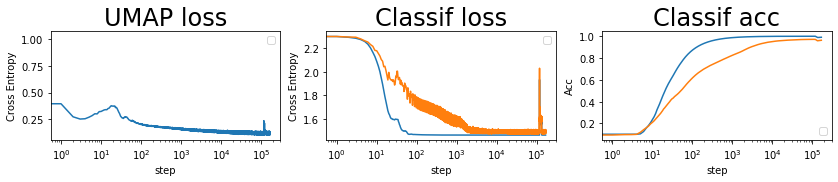

batch: 167000 | train acc: 0.9903 | val acc: 0.9628


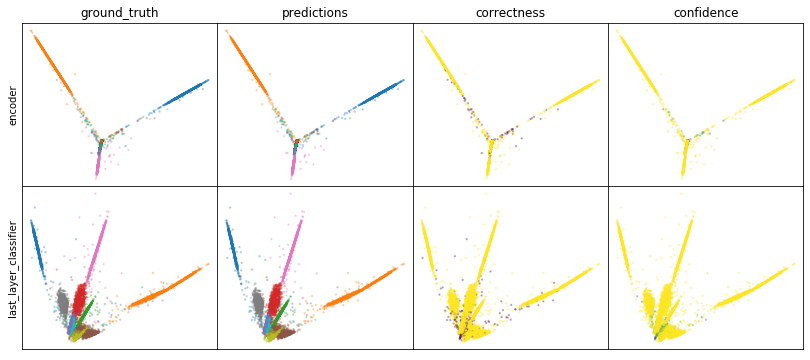

W0808 04:53:28.034478 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:53:28.637175 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:53:29.249399 140402527516416 legend.py:1282] No handles with labels found to put in legend.


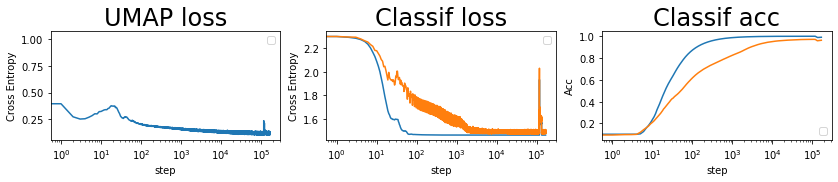

batch: 168000 | train acc: 0.9904 | val acc: 0.9629


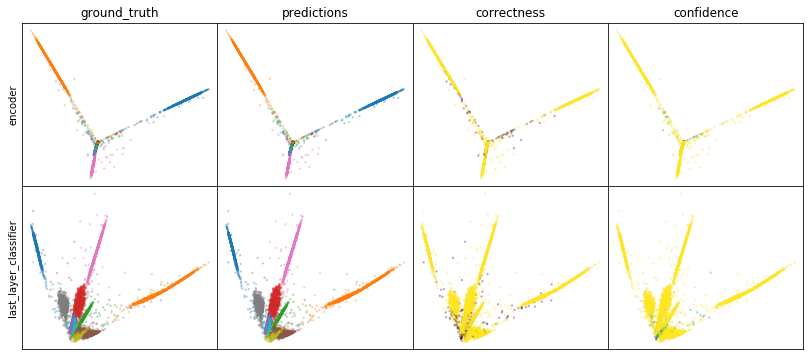

W0808 04:56:10.200377 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:56:10.766451 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:56:11.325416 140402527516416 legend.py:1282] No handles with labels found to put in legend.


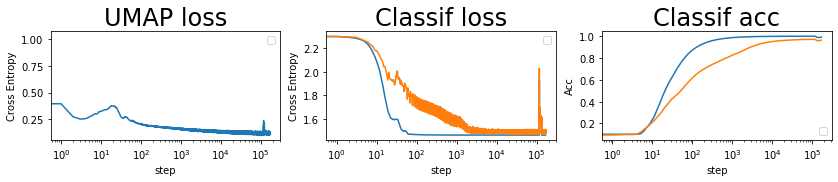

batch: 169000 | train acc: 0.9905 | val acc: 0.963


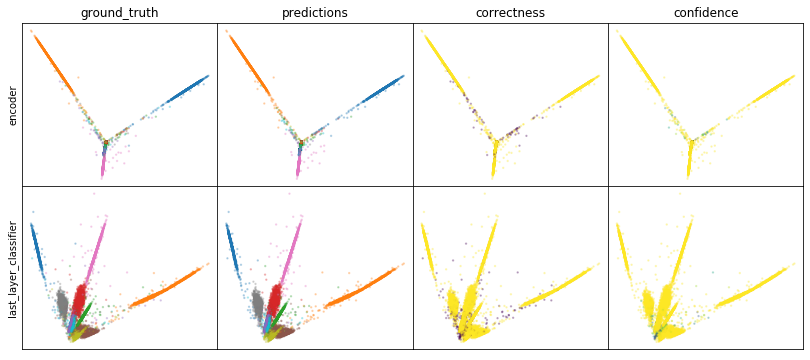

W0808 04:58:53.029413 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:58:53.594372 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 04:58:54.154722 140402527516416 legend.py:1282] No handles with labels found to put in legend.


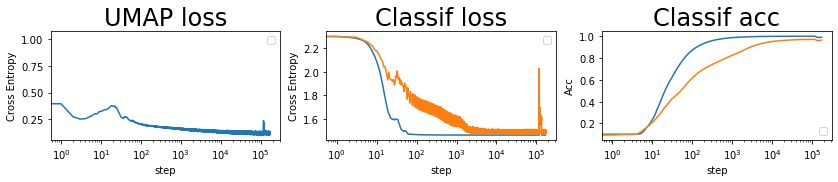

batch: 170000 | train acc: 0.9905 | val acc: 0.9631


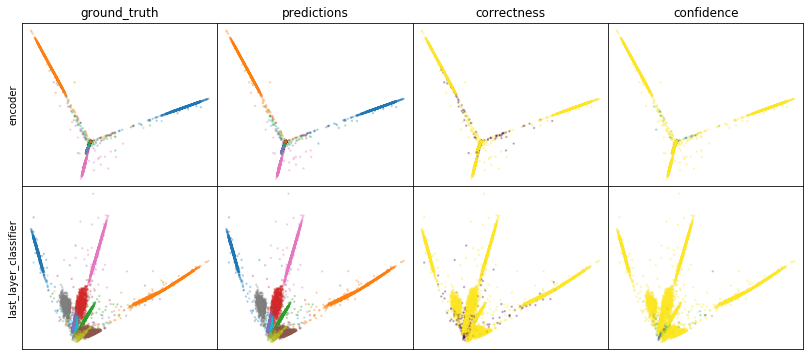

W0808 05:01:37.211362 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:01:37.786109 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:01:38.361132 140402527516416 legend.py:1282] No handles with labels found to put in legend.


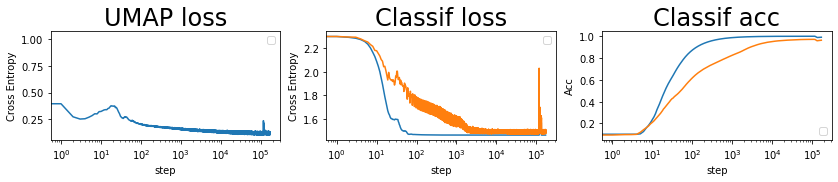

batch: 171000 | train acc: 0.9906 | val acc: 0.9632


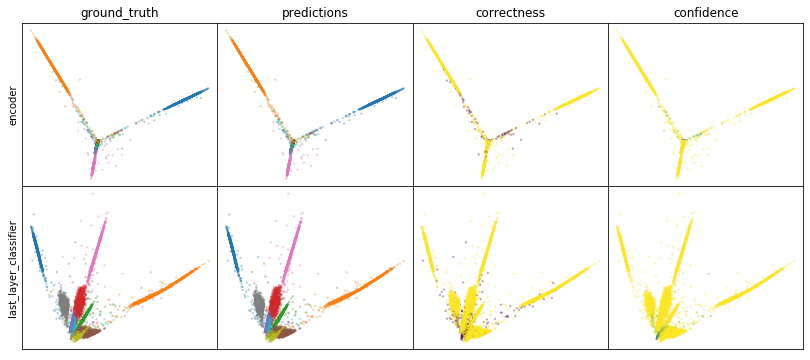

W0808 05:04:21.253431 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:04:21.827191 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:04:22.391968 140402527516416 legend.py:1282] No handles with labels found to put in legend.


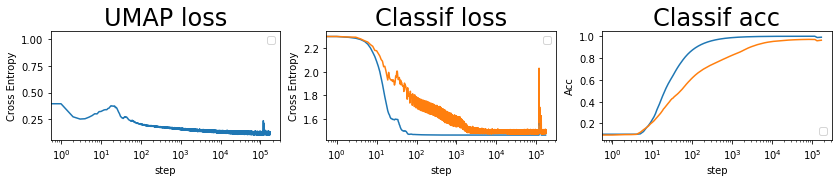

batch: 172000 | train acc: 0.9906 | val acc: 0.9633


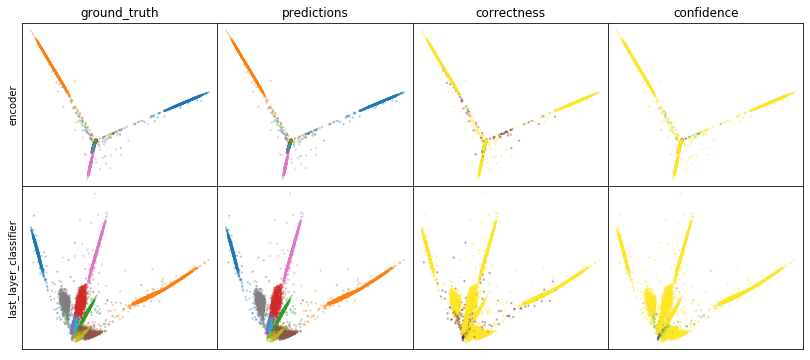

W0808 05:07:03.997390 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:07:04.570280 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:07:05.135674 140402527516416 legend.py:1282] No handles with labels found to put in legend.


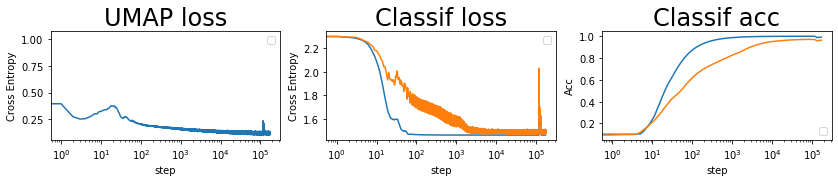

batch: 173000 | train acc: 0.9907 | val acc: 0.9634


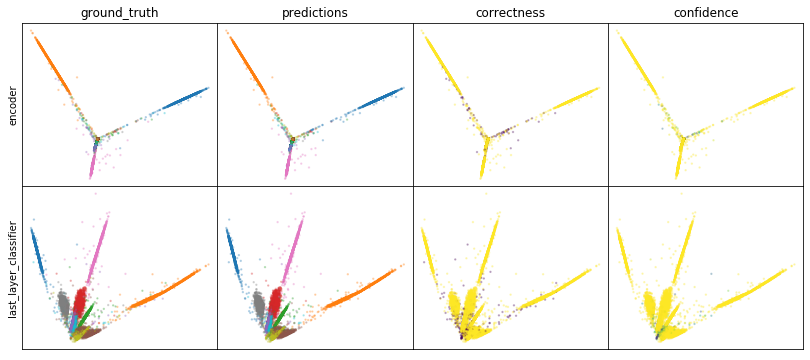

W0808 05:09:49.904850 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:09:50.500228 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:09:51.102101 140402527516416 legend.py:1282] No handles with labels found to put in legend.


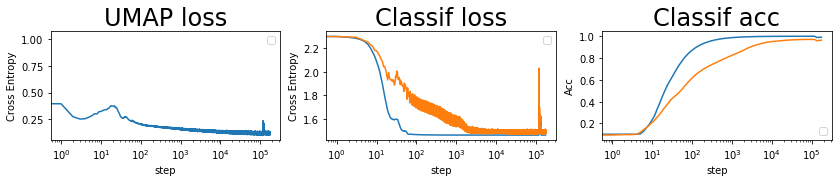

batch: 174000 | train acc: 0.9907 | val acc: 0.9635


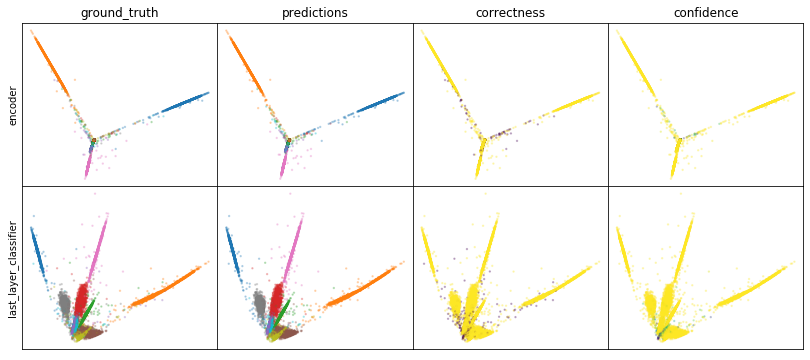

W0808 05:12:35.379444 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:12:35.956208 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:12:36.534038 140402527516416 legend.py:1282] No handles with labels found to put in legend.


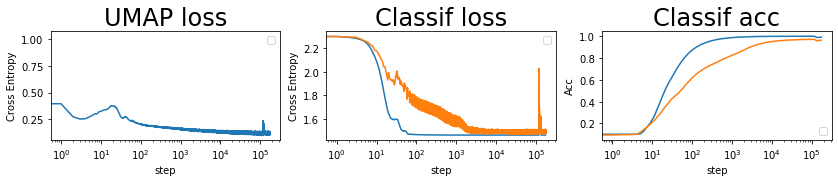

batch: 175000 | train acc: 0.9908 | val acc: 0.9636


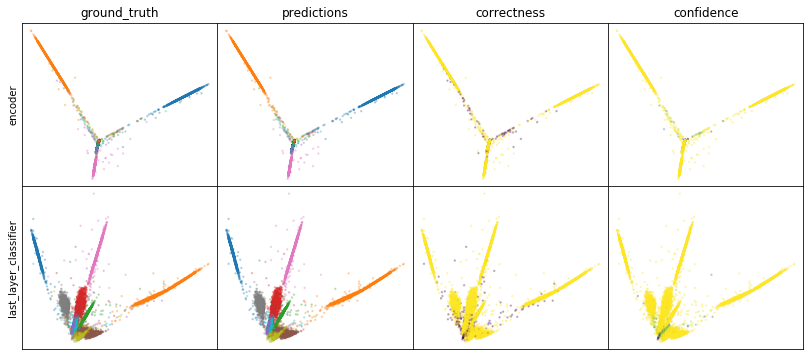

W0808 05:15:21.224940 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:15:21.819598 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:15:22.401057 140402527516416 legend.py:1282] No handles with labels found to put in legend.


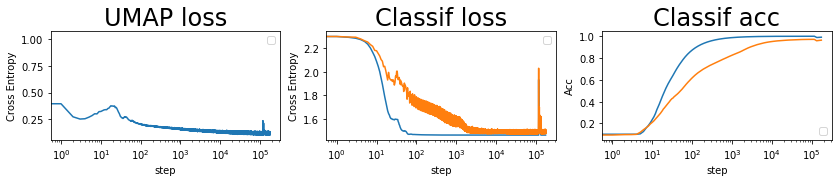

batch: 176000 | train acc: 0.9908 | val acc: 0.9637
leaving epoch because no improvement in 10000 batches


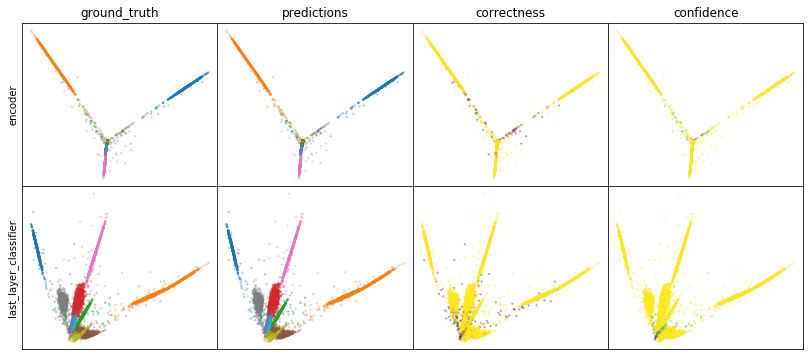

W0808 05:18:07.647397 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:18:08.265020 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:18:08.878980 140402527516416 legend.py:1282] No handles with labels found to put in legend.


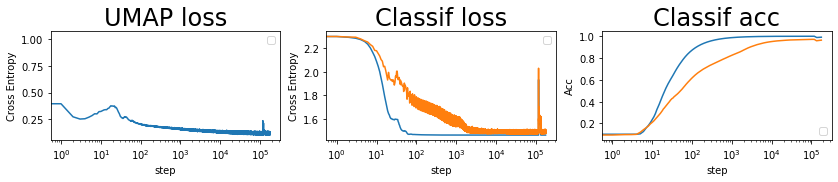

batch: 177000 | train acc: 0.9909 | val acc: 0.9638


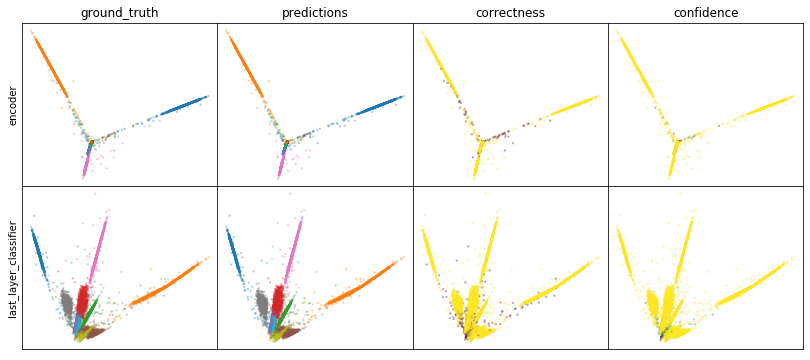

W0808 05:20:54.264544 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:20:54.854328 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:20:55.440595 140402527516416 legend.py:1282] No handles with labels found to put in legend.


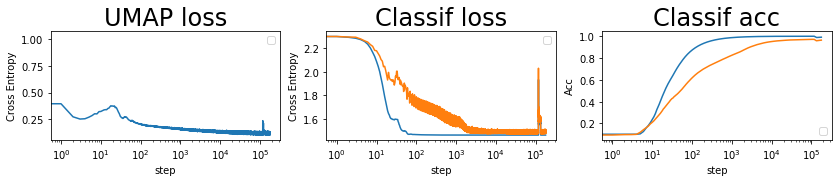

batch: 178000 | train acc: 0.9909 | val acc: 0.9639


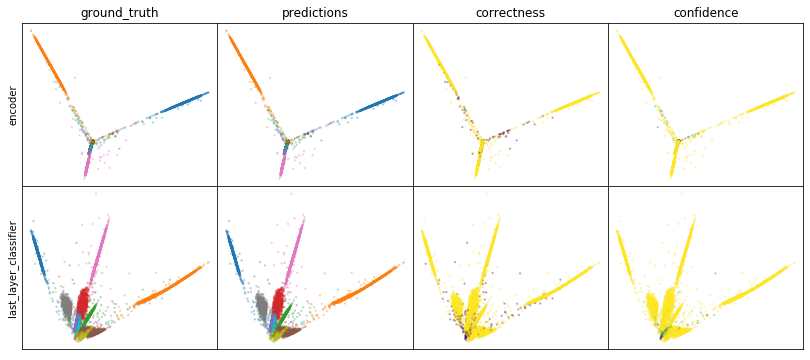

W0808 05:23:41.652841 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:23:42.243665 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:23:42.826808 140402527516416 legend.py:1282] No handles with labels found to put in legend.


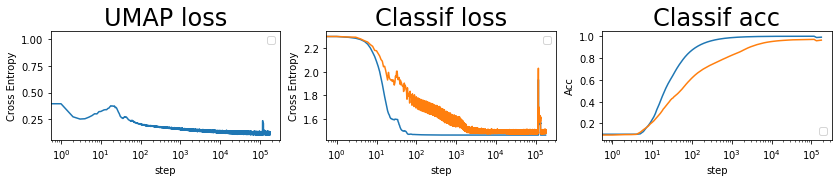

batch: 179000 | train acc: 0.991 | val acc: 0.964


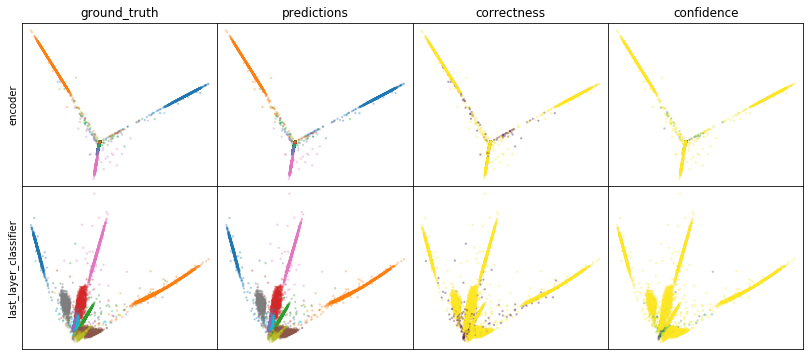

W0808 05:26:26.962663 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:26:27.572606 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:26:28.170053 140402527516416 legend.py:1282] No handles with labels found to put in legend.


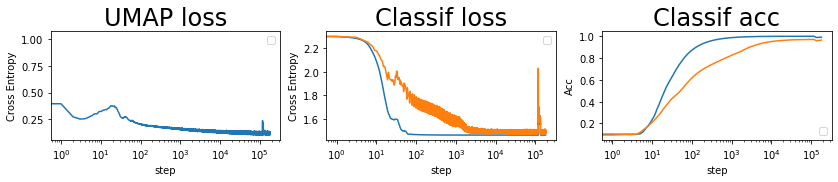

batch: 180000 | train acc: 0.991 | val acc: 0.964


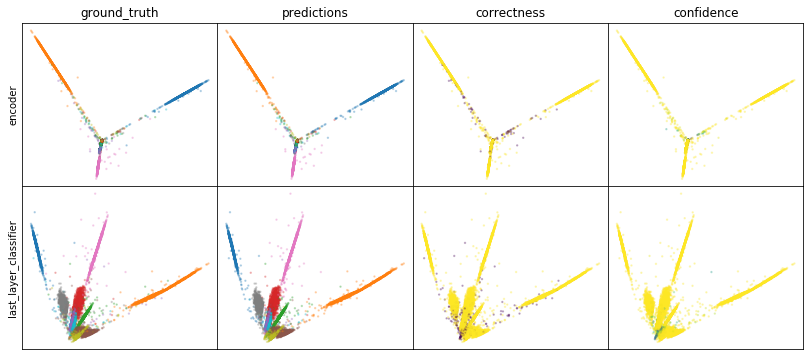

W0808 05:29:17.325073 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:29:17.928003 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:29:18.524961 140402527516416 legend.py:1282] No handles with labels found to put in legend.


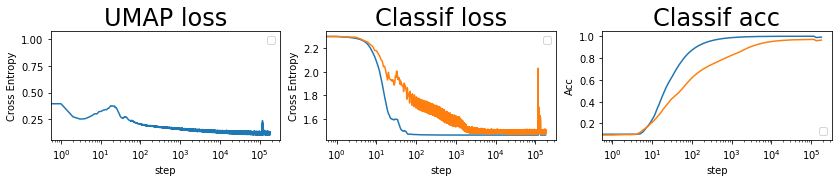

batch: 181000 | train acc: 0.9911 | val acc: 0.9641


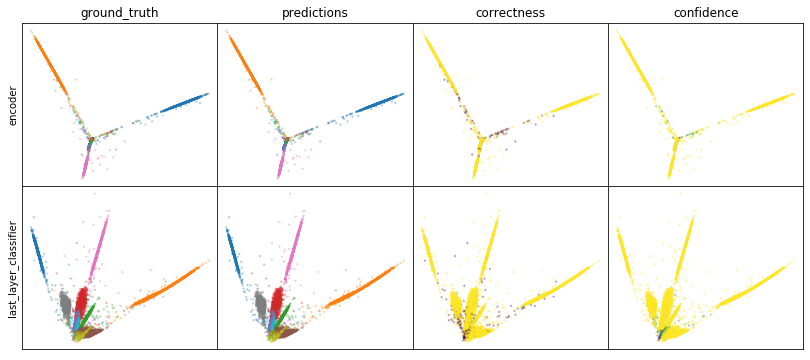

W0808 05:32:06.449042 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:32:07.045692 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:32:07.635837 140402527516416 legend.py:1282] No handles with labels found to put in legend.


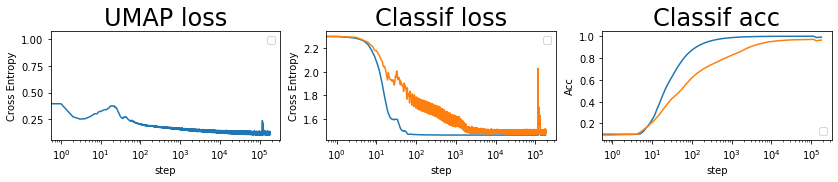

batch: 182000 | train acc: 0.9911 | val acc: 0.9642


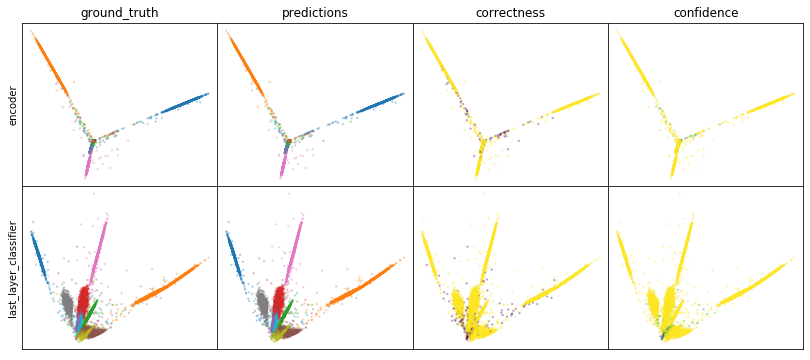

W0808 05:34:57.126388 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:34:57.768709 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:34:58.376574 140402527516416 legend.py:1282] No handles with labels found to put in legend.


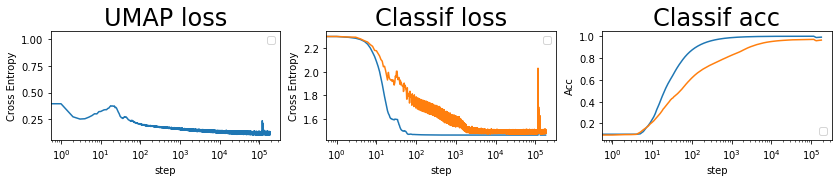

batch: 183000 | train acc: 0.9912 | val acc: 0.9643


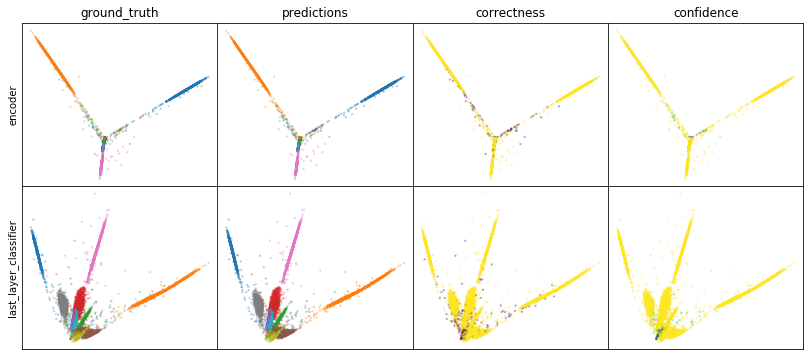

W0808 05:37:46.982789 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:37:47.594196 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:37:48.209812 140402527516416 legend.py:1282] No handles with labels found to put in legend.


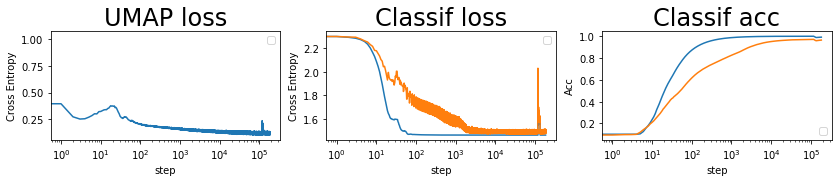

batch: 184000 | train acc: 0.9912 | val acc: 0.9644


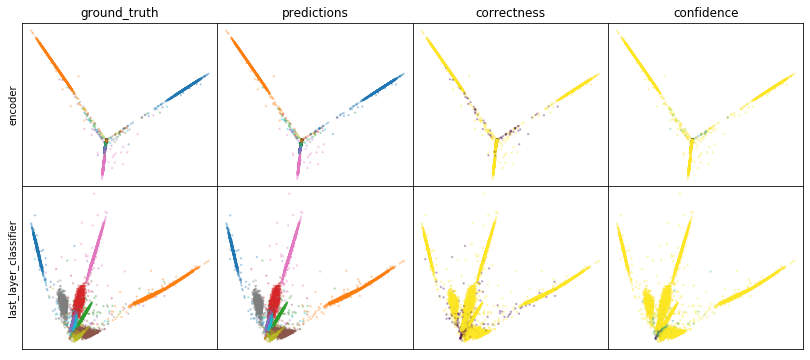

W0808 05:40:37.064594 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:40:37.667879 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:40:38.262184 140402527516416 legend.py:1282] No handles with labels found to put in legend.


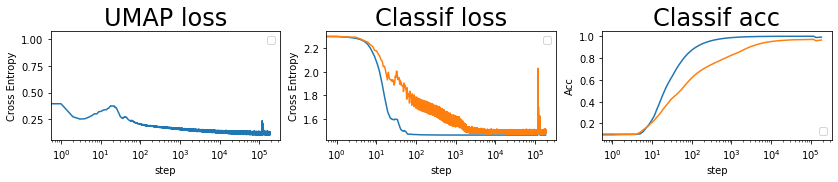

batch: 185000 | train acc: 0.9913 | val acc: 0.9645


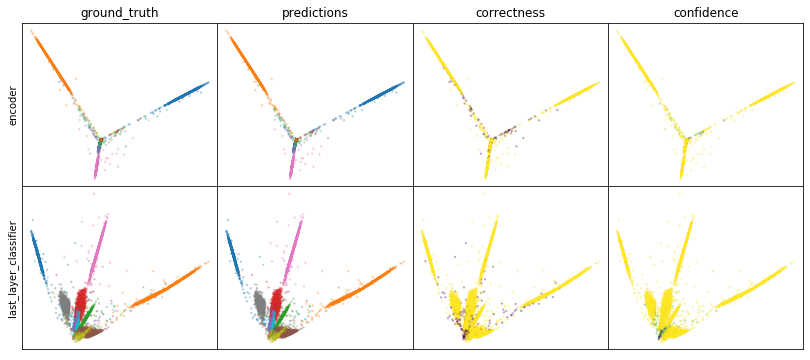

W0808 05:43:27.575568 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:43:28.203010 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:43:28.825647 140402527516416 legend.py:1282] No handles with labels found to put in legend.


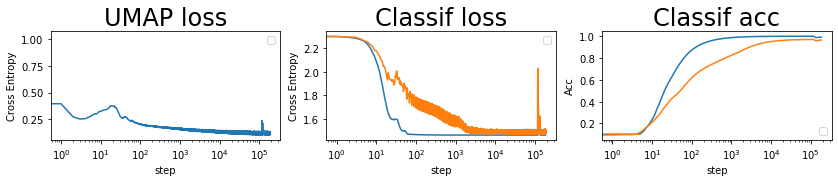

batch: 186000 | train acc: 0.9913 | val acc: 0.9646
leaving epoch because no improvement in 10000 batches


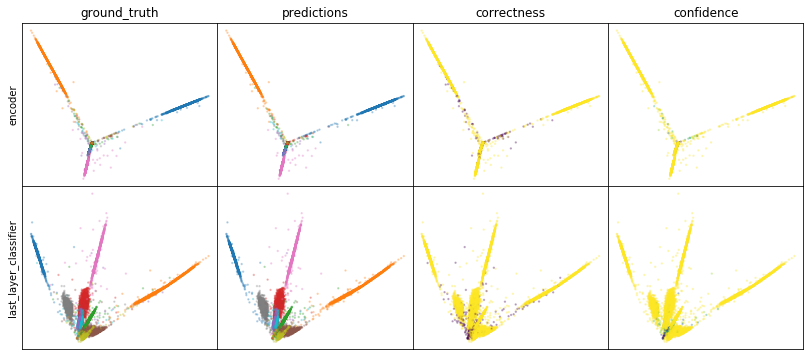

W0808 05:46:17.303331 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:46:17.908845 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:46:18.528928 140402527516416 legend.py:1282] No handles with labels found to put in legend.


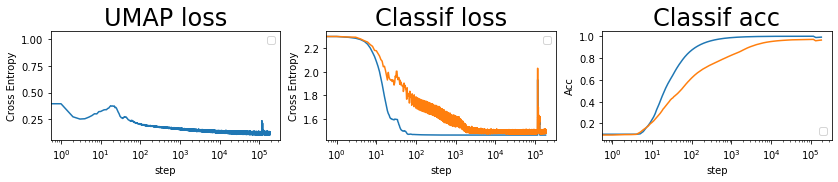

batch: 187000 | train acc: 0.9914 | val acc: 0.9647


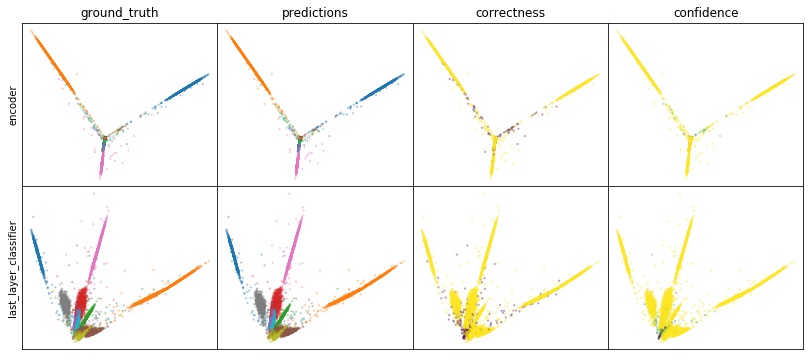

W0808 05:49:07.940774 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:49:08.573253 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:49:09.171348 140402527516416 legend.py:1282] No handles with labels found to put in legend.


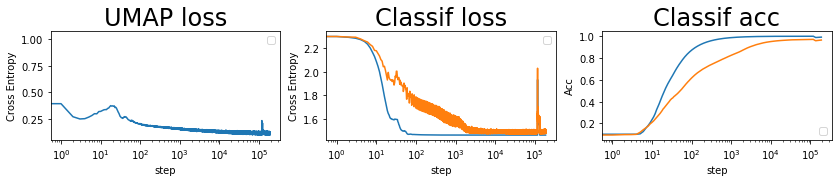

batch: 188000 | train acc: 0.9914 | val acc: 0.9647


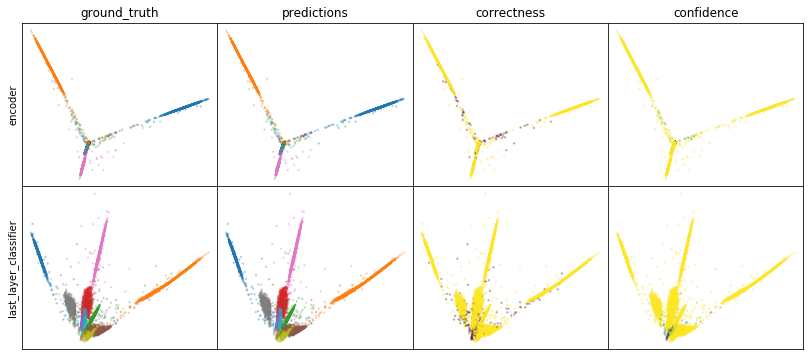

W0808 05:51:59.639223 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:52:00.271635 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:52:00.905916 140402527516416 legend.py:1282] No handles with labels found to put in legend.


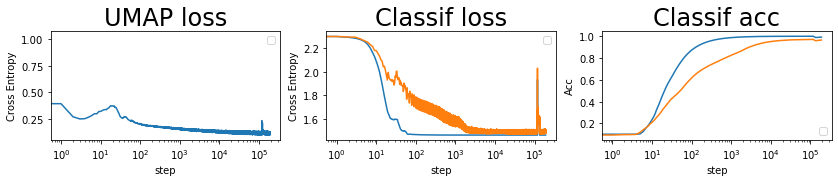

batch: 189000 | train acc: 0.9915 | val acc: 0.9648


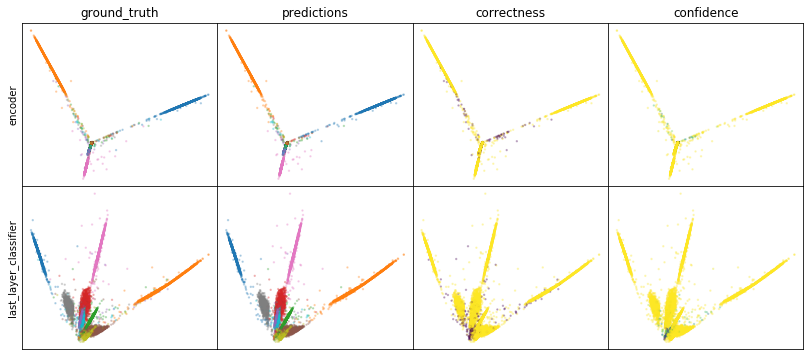

W0808 05:54:52.618319 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:54:53.231403 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:54:53.838374 140402527516416 legend.py:1282] No handles with labels found to put in legend.


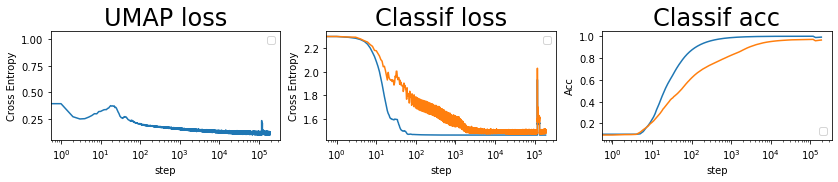

batch: 190000 | train acc: 0.9915 | val acc: 0.9649


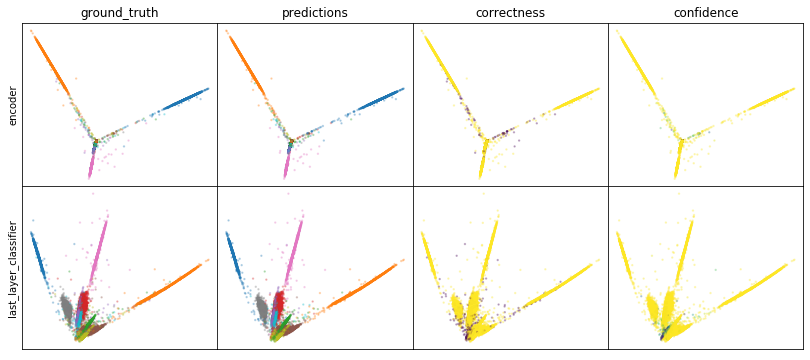

W0808 05:57:44.733093 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:57:45.373552 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 05:57:46.006188 140402527516416 legend.py:1282] No handles with labels found to put in legend.


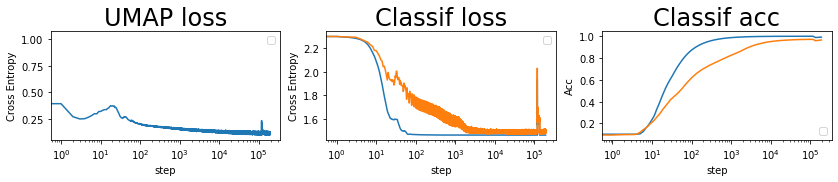

batch: 191000 | train acc: 0.9916 | val acc: 0.965


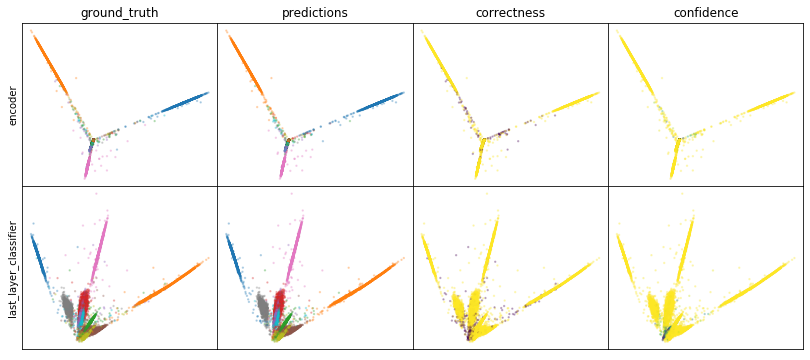

W0808 06:00:37.599416 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:00:38.226617 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:00:38.860693 140402527516416 legend.py:1282] No handles with labels found to put in legend.


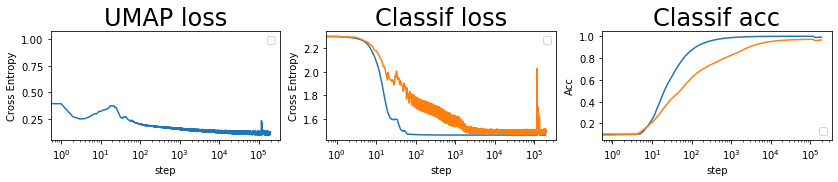

batch: 192000 | train acc: 0.9916 | val acc: 0.9651


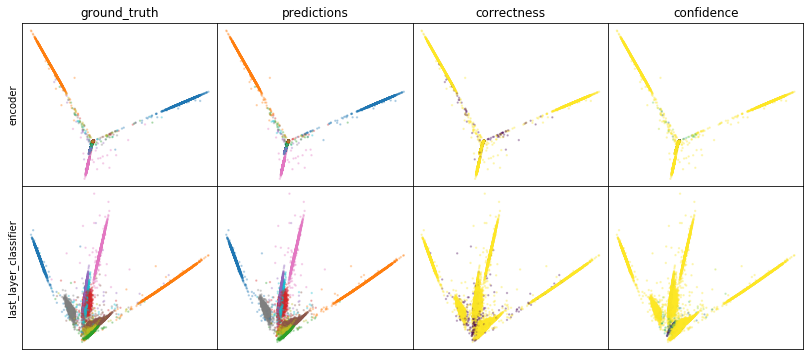

W0808 06:03:31.824488 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:03:32.472415 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:03:33.096881 140402527516416 legend.py:1282] No handles with labels found to put in legend.


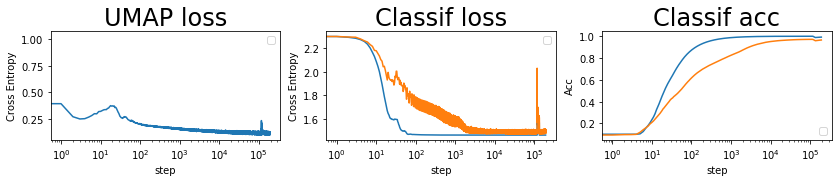

batch: 193000 | train acc: 0.9916 | val acc: 0.9652


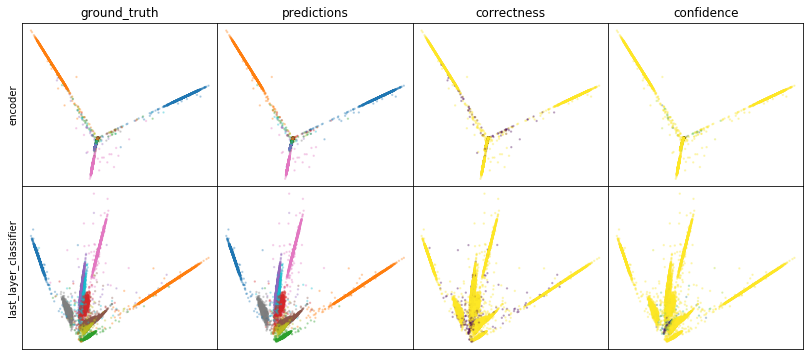

W0808 06:06:26.024458 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:06:26.655036 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:06:27.271594 140402527516416 legend.py:1282] No handles with labels found to put in legend.


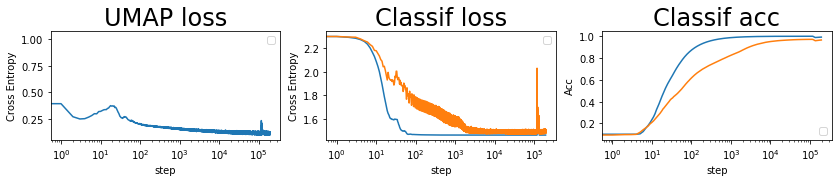

batch: 194000 | train acc: 0.9917 | val acc: 0.9652


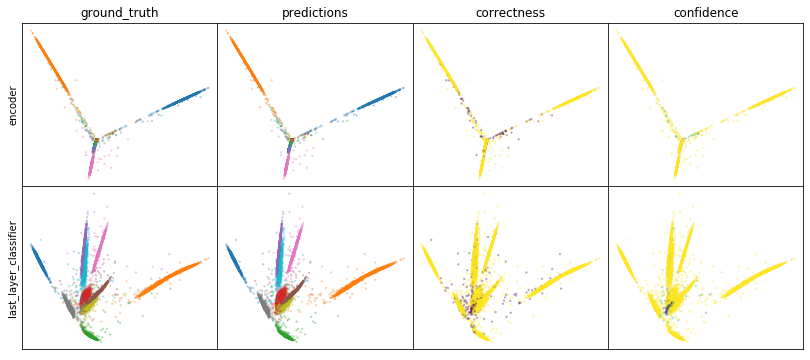

W0808 06:09:20.451507 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:09:21.135226 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:09:21.771342 140402527516416 legend.py:1282] No handles with labels found to put in legend.


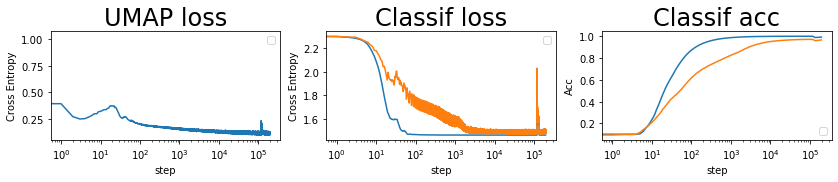

batch: 195000 | train acc: 0.9917 | val acc: 0.9653


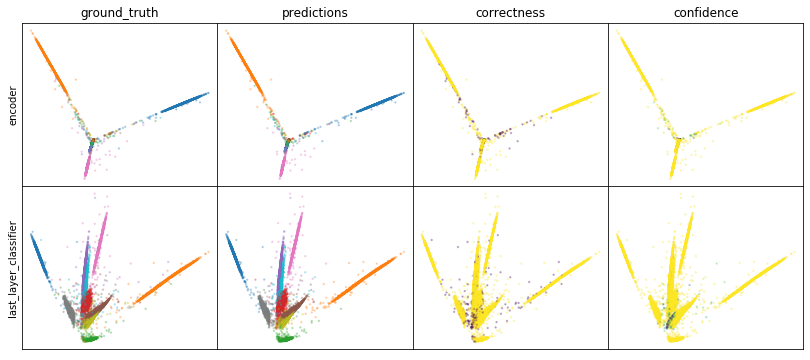

W0808 06:12:14.368431 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:12:15.033617 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:12:15.688472 140402527516416 legend.py:1282] No handles with labels found to put in legend.


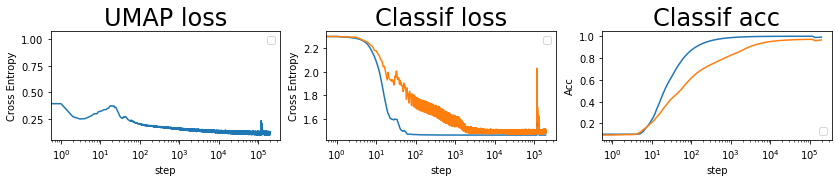

batch: 196000 | train acc: 0.9918 | val acc: 0.9654
leaving epoch because no improvement in 10000 batches


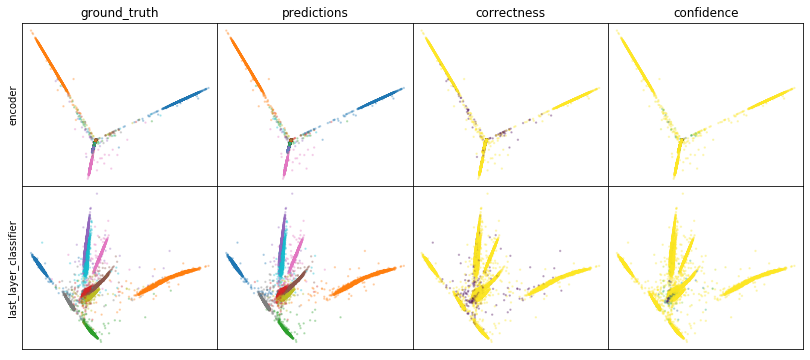

W0808 06:15:11.197312 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:15:11.828293 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:15:12.446483 140402527516416 legend.py:1282] No handles with labels found to put in legend.


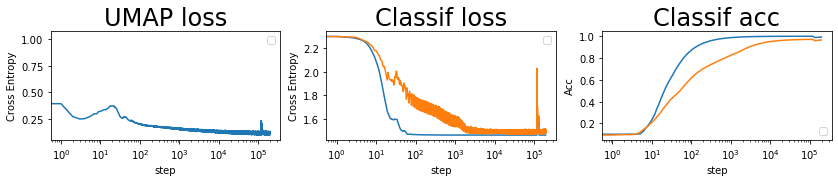

batch: 197000 | train acc: 0.9918 | val acc: 0.9655


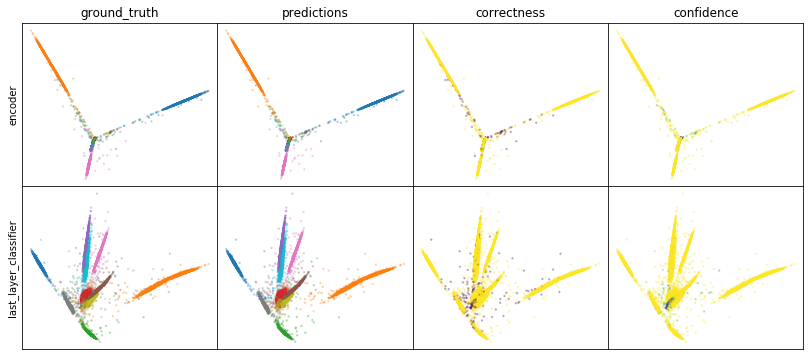

W0808 06:18:07.270858 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:18:07.967678 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:18:08.638738 140402527516416 legend.py:1282] No handles with labels found to put in legend.


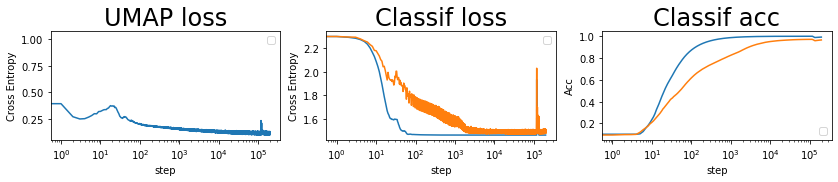

batch: 198000 | train acc: 0.9919 | val acc: 0.9655


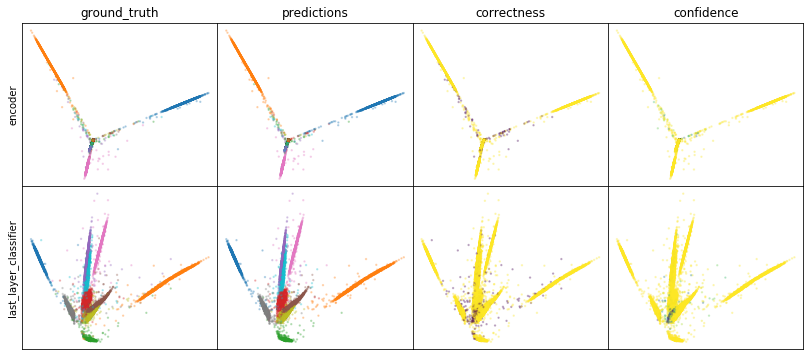

W0808 06:21:04.110718 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:21:04.775621 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:21:05.446371 140402527516416 legend.py:1282] No handles with labels found to put in legend.


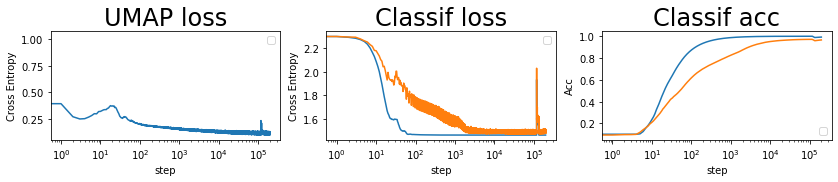

batch: 199000 | train acc: 0.9919 | val acc: 0.9656


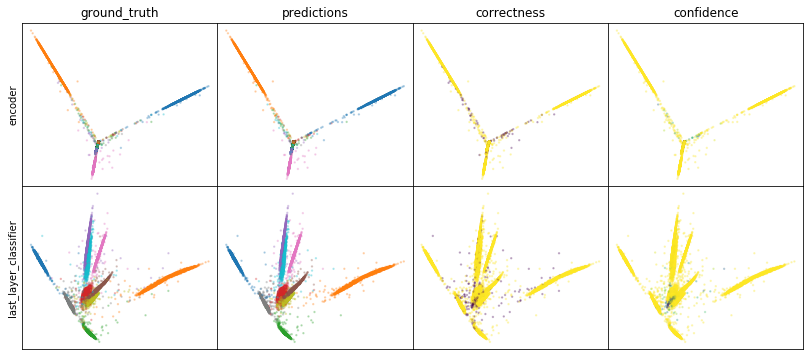

W0808 06:24:02.298174 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:24:02.982779 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:24:03.648906 140402527516416 legend.py:1282] No handles with labels found to put in legend.


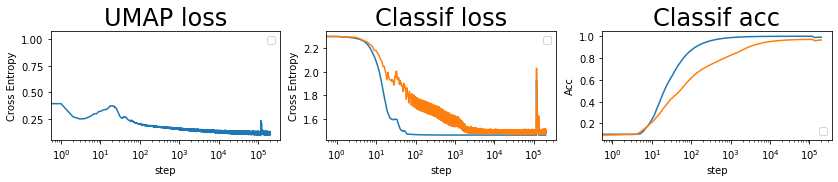

batch: 200000 | train acc: 0.9919 | val acc: 0.9657


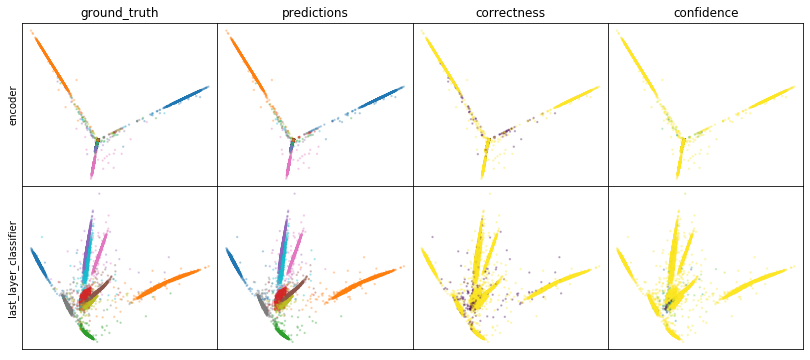

W0808 06:27:00.189711 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:27:00.871230 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:27:01.557153 140402527516416 legend.py:1282] No handles with labels found to put in legend.


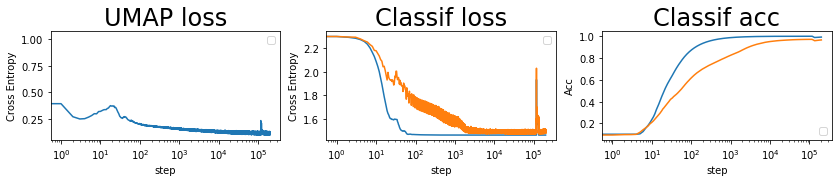

batch: 201000 | train acc: 0.992 | val acc: 0.9657


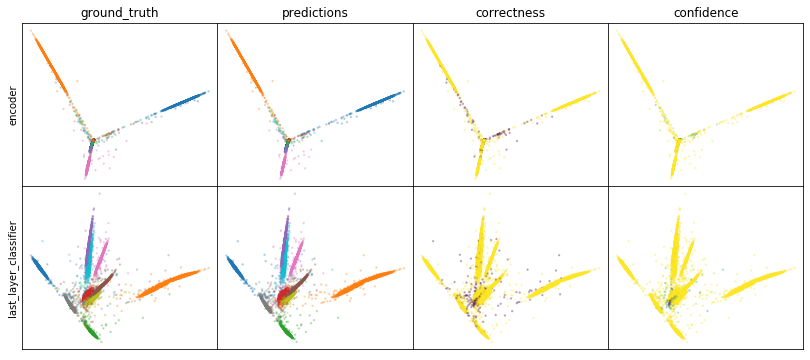

W0808 06:29:59.854564 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:30:00.540318 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:30:01.211883 140402527516416 legend.py:1282] No handles with labels found to put in legend.


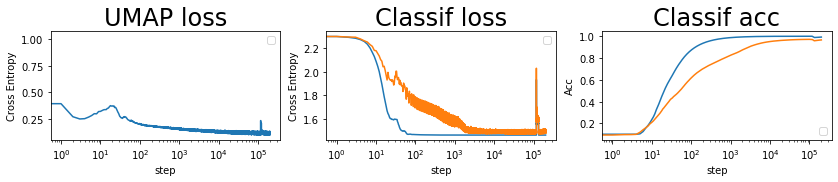

batch: 202000 | train acc: 0.992 | val acc: 0.9658


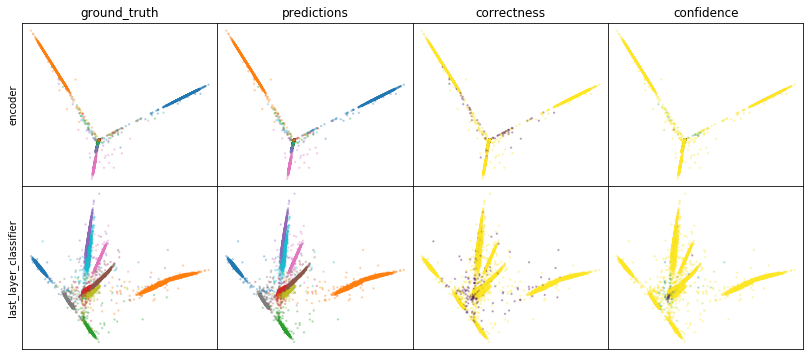

W0808 06:32:58.331458 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:32:59.025253 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:32:59.752186 140402527516416 legend.py:1282] No handles with labels found to put in legend.


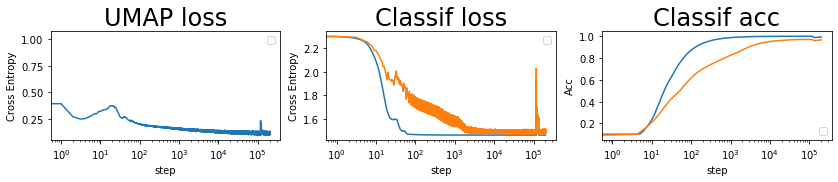

batch: 203000 | train acc: 0.9921 | val acc: 0.9659


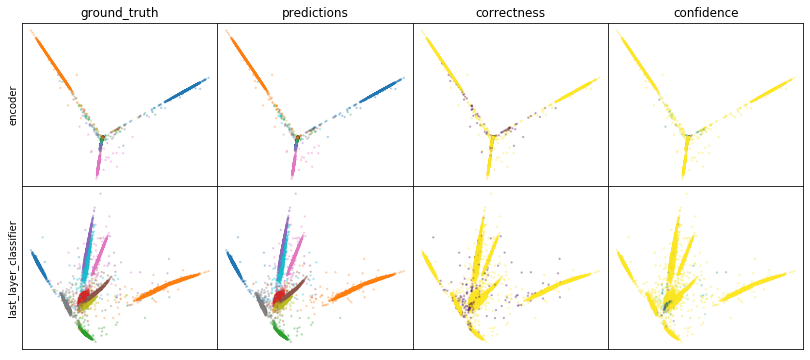

W0808 06:35:57.879981 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:35:58.568756 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:35:59.263508 140402527516416 legend.py:1282] No handles with labels found to put in legend.


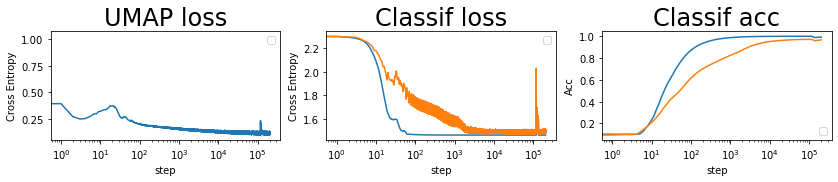

batch: 204000 | train acc: 0.9921 | val acc: 0.9659


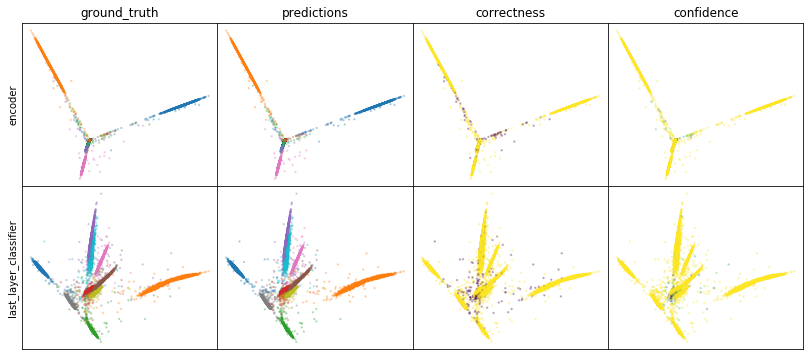

W0808 06:38:57.810219 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:38:58.536199 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:38:59.285541 140402527516416 legend.py:1282] No handles with labels found to put in legend.


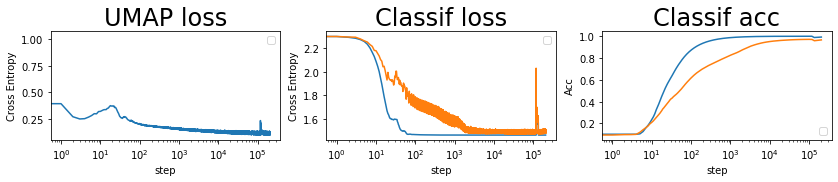

batch: 205000 | train acc: 0.9921 | val acc: 0.966


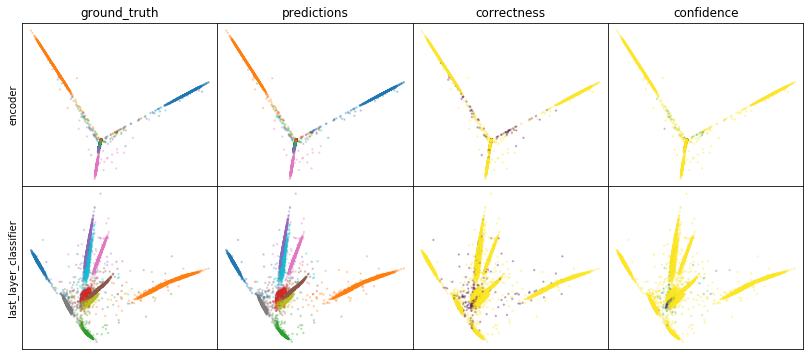

W0808 06:41:58.255399 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:41:58.951739 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:41:59.628460 140402527516416 legend.py:1282] No handles with labels found to put in legend.


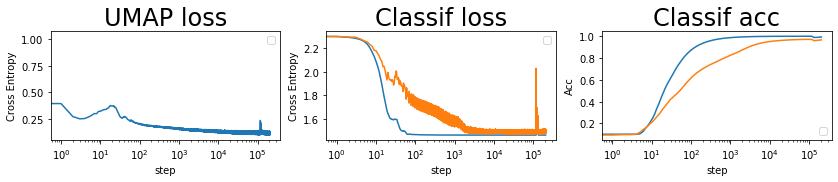

batch: 206000 | train acc: 0.9922 | val acc: 0.9661
leaving epoch because no improvement in 10000 batches


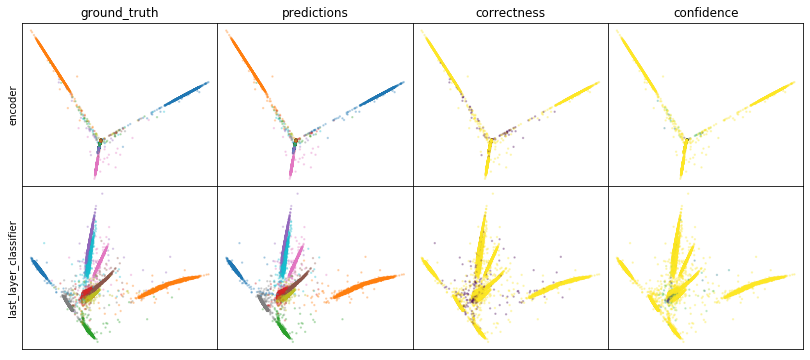

W0808 06:44:59.470560 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:45:00.173426 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:45:00.865219 140402527516416 legend.py:1282] No handles with labels found to put in legend.


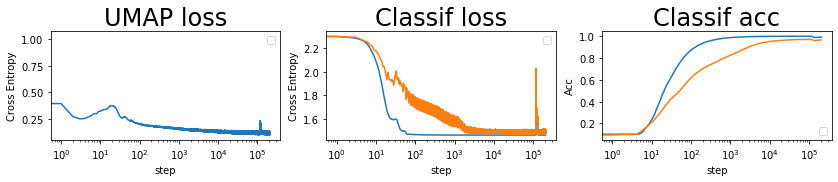

batch: 207000 | train acc: 0.9922 | val acc: 0.9661


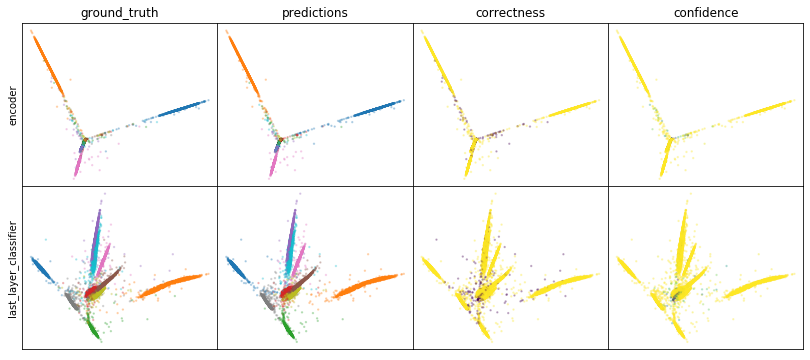

W0808 06:47:59.594108 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:48:00.303104 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:48:01.005686 140402527516416 legend.py:1282] No handles with labels found to put in legend.


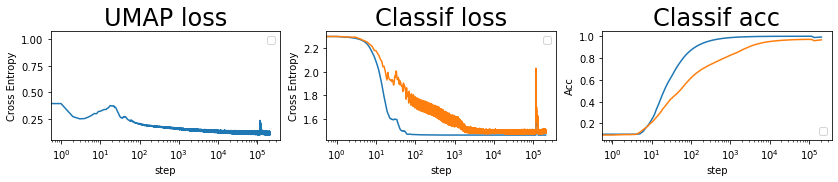

batch: 208000 | train acc: 0.9922 | val acc: 0.9662


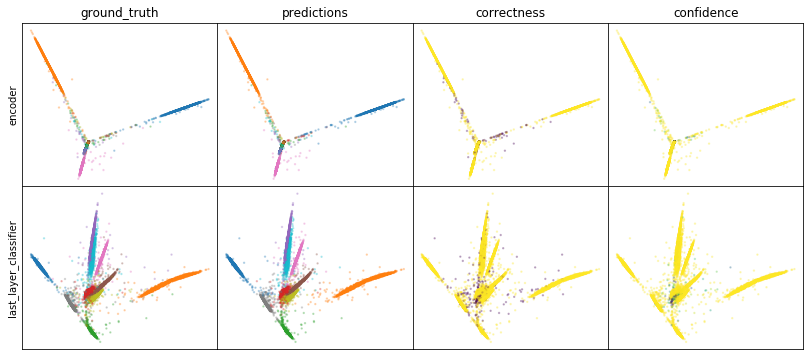

W0808 06:51:00.174834 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:51:00.892037 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:51:01.618898 140402527516416 legend.py:1282] No handles with labels found to put in legend.


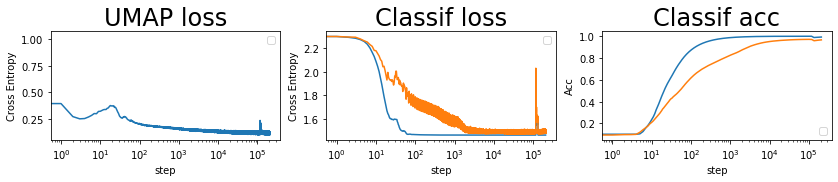

batch: 209000 | train acc: 0.9923 | val acc: 0.9663


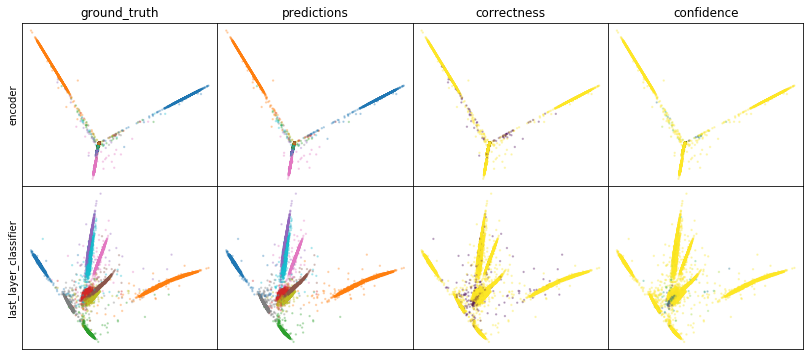

W0808 06:54:00.952346 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:54:01.735672 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:54:02.457719 140402527516416 legend.py:1282] No handles with labels found to put in legend.


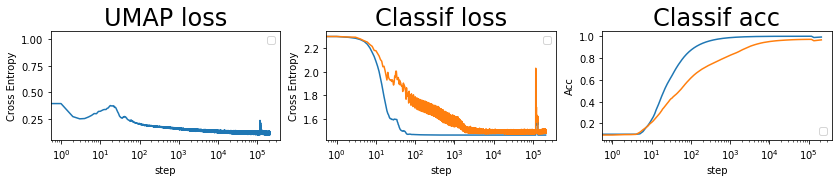

batch: 210000 | train acc: 0.9923 | val acc: 0.9663


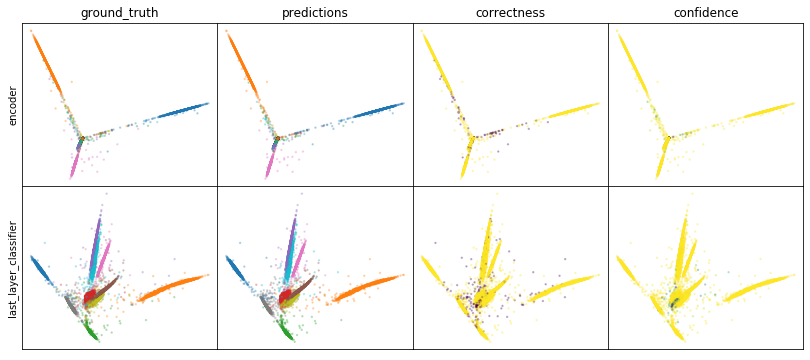

W0808 06:57:02.895979 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:57:03.594532 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 06:57:04.313102 140402527516416 legend.py:1282] No handles with labels found to put in legend.


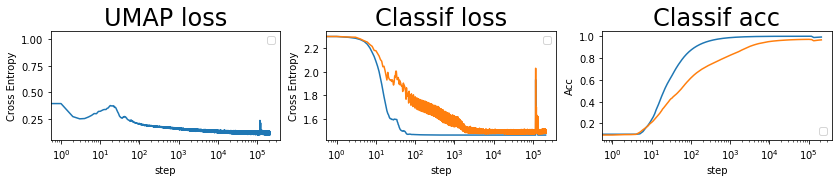

batch: 211000 | train acc: 0.9924 | val acc: 0.9664


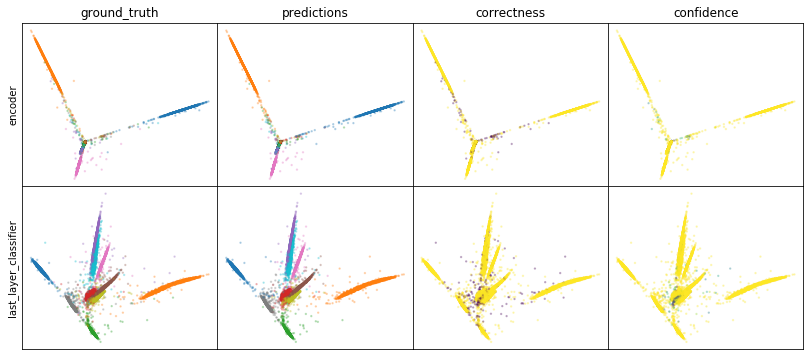

W0808 07:00:06.090741 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:00:06.827064 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:00:07.535754 140402527516416 legend.py:1282] No handles with labels found to put in legend.


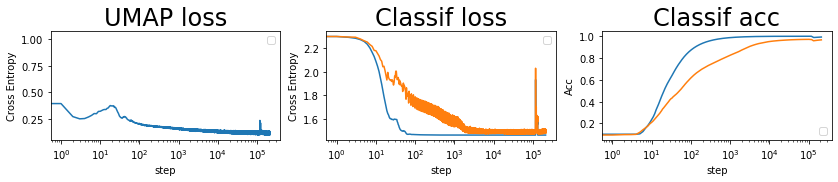

batch: 212000 | train acc: 0.9924 | val acc: 0.9665


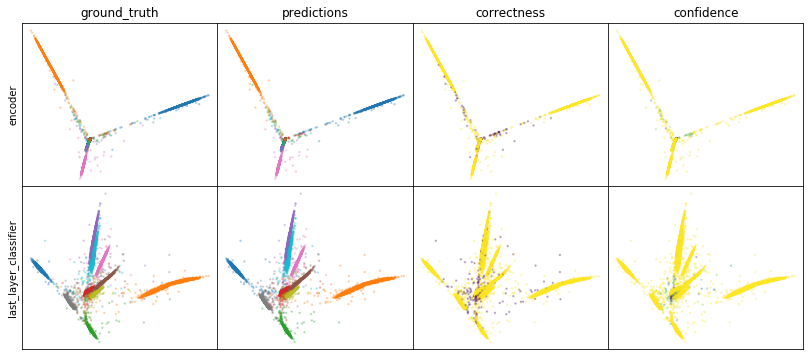

W0808 07:03:09.739685 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:03:10.467256 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:03:11.185211 140402527516416 legend.py:1282] No handles with labels found to put in legend.


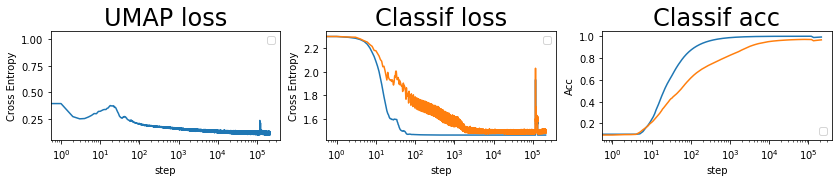

batch: 213000 | train acc: 0.9924 | val acc: 0.9665


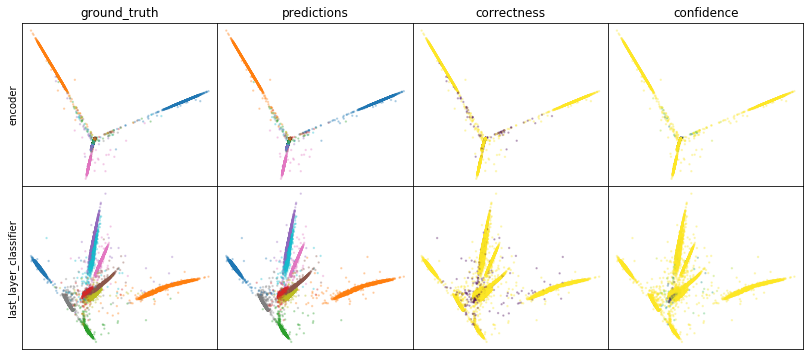

W0808 07:06:13.809981 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:06:14.514597 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:06:15.241075 140402527516416 legend.py:1282] No handles with labels found to put in legend.


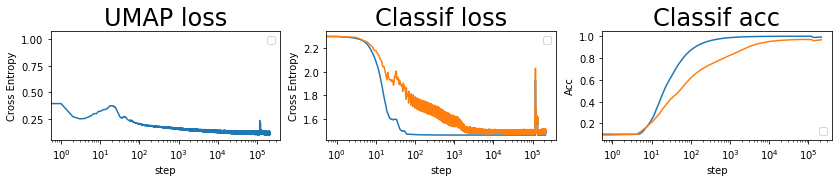

batch: 214000 | train acc: 0.9925 | val acc: 0.9666


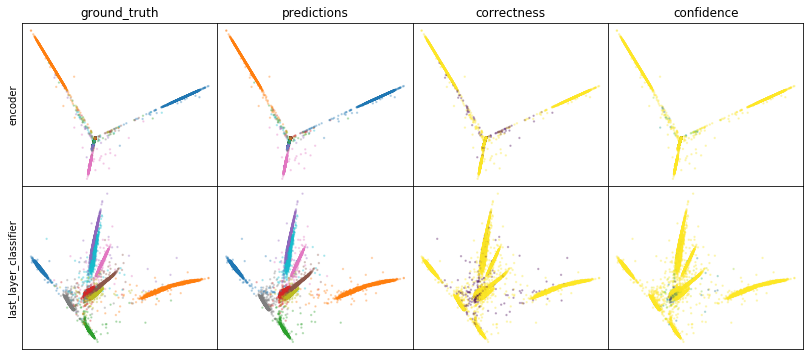

W0808 07:09:17.745393 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:09:18.467437 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:09:19.185448 140402527516416 legend.py:1282] No handles with labels found to put in legend.


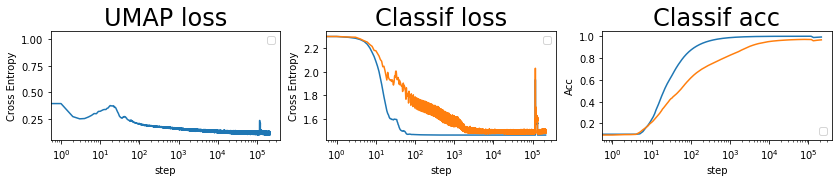

batch: 215000 | train acc: 0.9925 | val acc: 0.9666


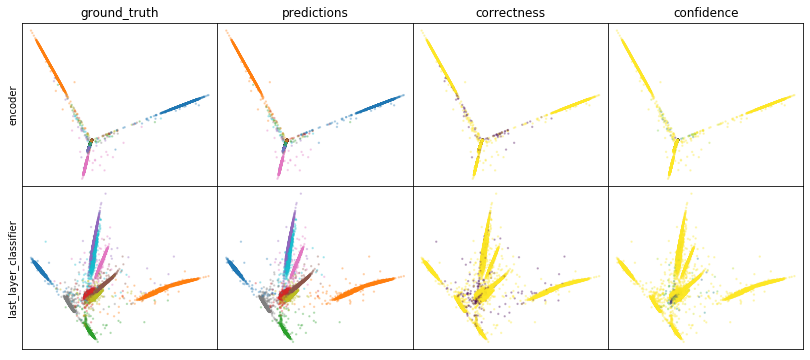

W0808 07:12:21.394943 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:12:22.097839 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:12:22.838986 140402527516416 legend.py:1282] No handles with labels found to put in legend.


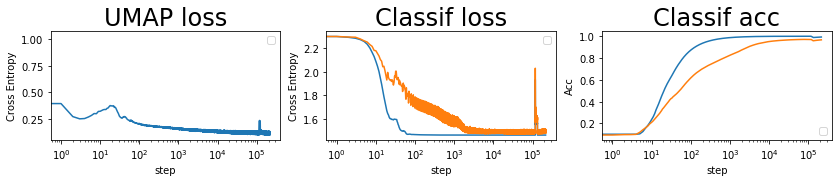

batch: 216000 | train acc: 0.9925 | val acc: 0.9667
leaving epoch because no improvement in 10000 batches


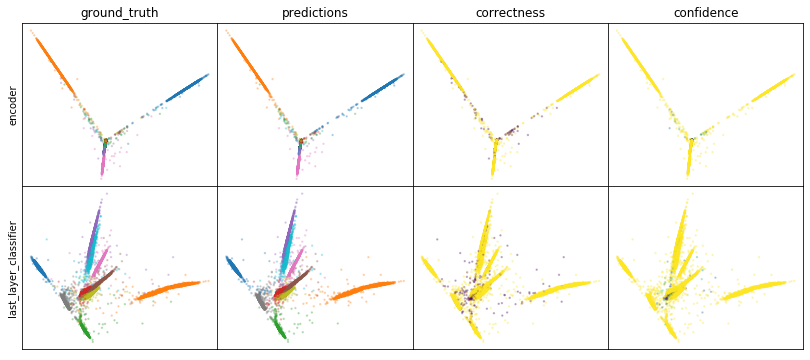

W0808 07:15:27.450916 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:15:28.249571 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:15:29.069153 140402527516416 legend.py:1282] No handles with labels found to put in legend.


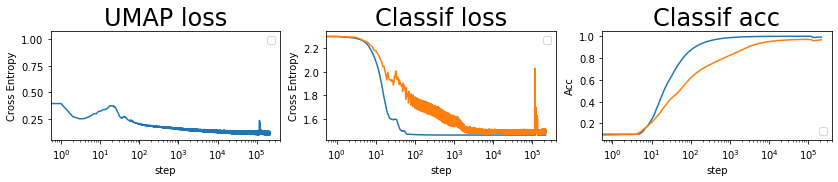

batch: 217000 | train acc: 0.9926 | val acc: 0.9667


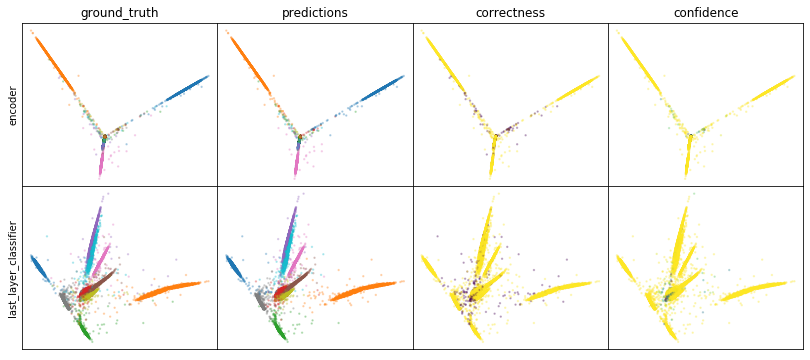

W0808 07:18:33.224286 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:18:33.942059 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:18:34.664060 140402527516416 legend.py:1282] No handles with labels found to put in legend.


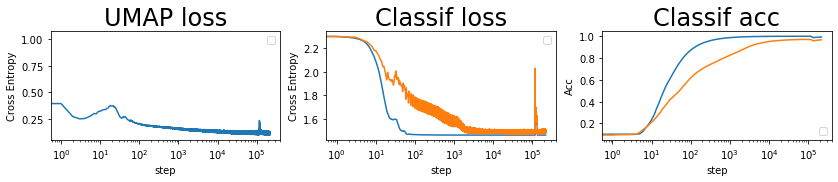

batch: 218000 | train acc: 0.9926 | val acc: 0.9668


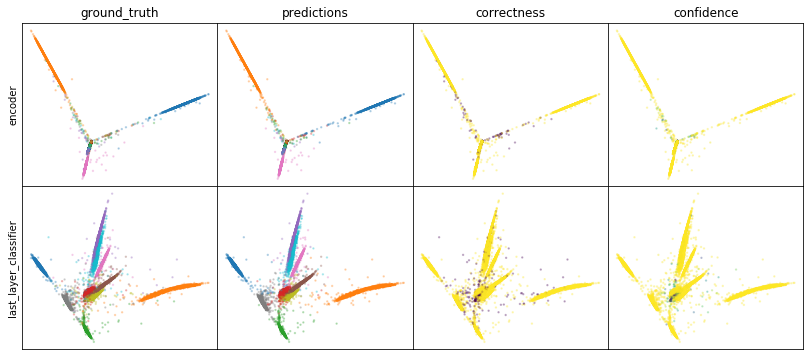

W0808 07:21:39.072929 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:21:39.814501 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:21:40.586481 140402527516416 legend.py:1282] No handles with labels found to put in legend.


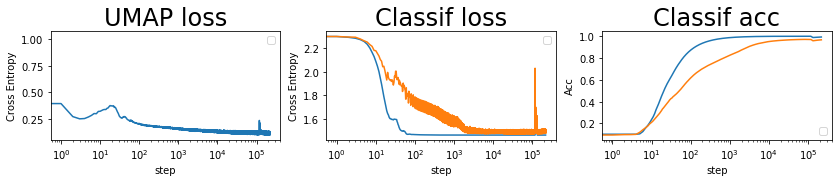

batch: 219000 | train acc: 0.9926 | val acc: 0.9668


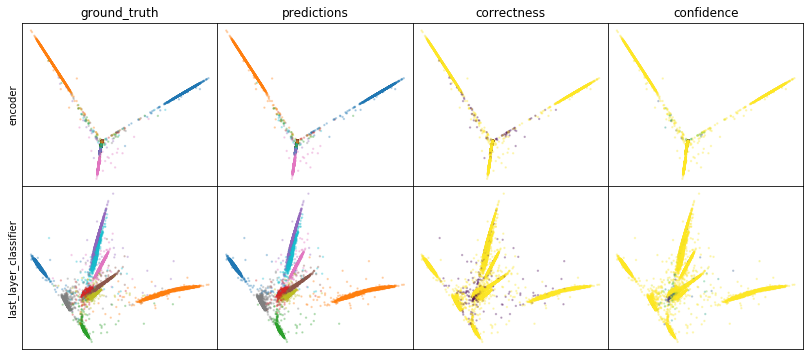

W0808 07:24:46.115968 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:24:46.844059 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:24:47.597606 140402527516416 legend.py:1282] No handles with labels found to put in legend.


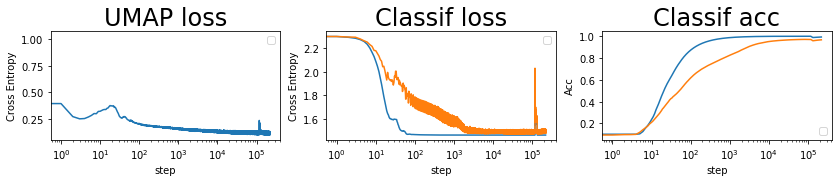

batch: 220000 | train acc: 0.9927 | val acc: 0.9669


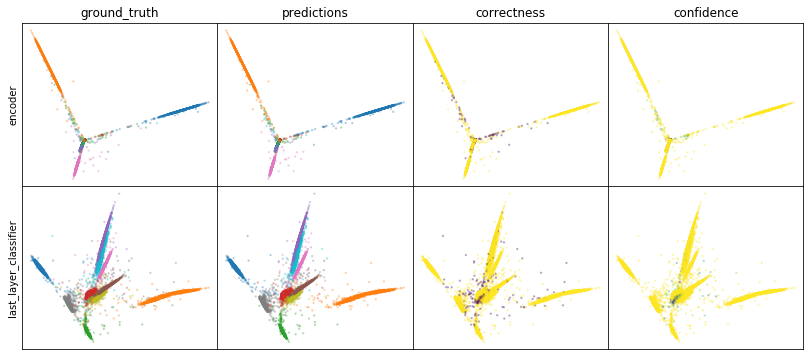

W0808 07:27:51.735646 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:27:52.455630 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:27:53.177402 140402527516416 legend.py:1282] No handles with labels found to put in legend.


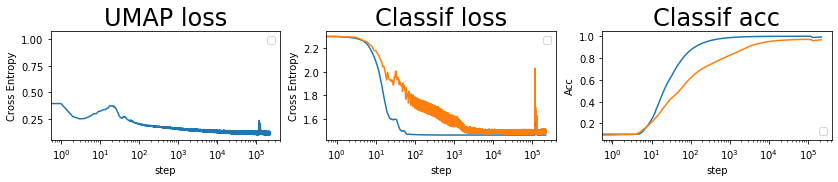

batch: 221000 | train acc: 0.9927 | val acc: 0.9669


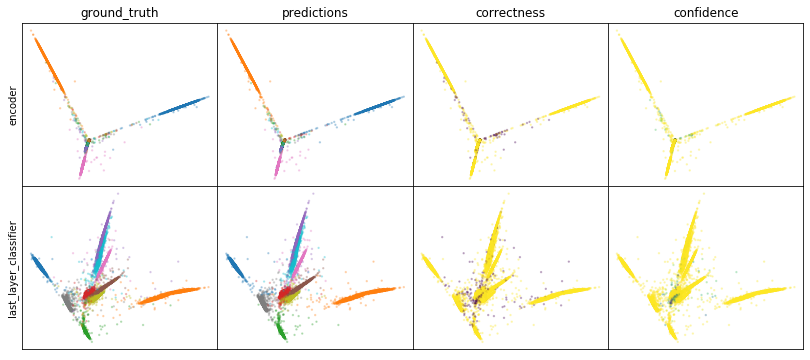

W0808 07:30:59.778542 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:31:00.577049 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:31:01.365695 140402527516416 legend.py:1282] No handles with labels found to put in legend.


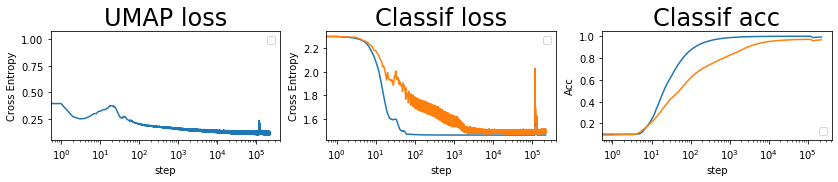

batch: 222000 | train acc: 0.9927 | val acc: 0.967


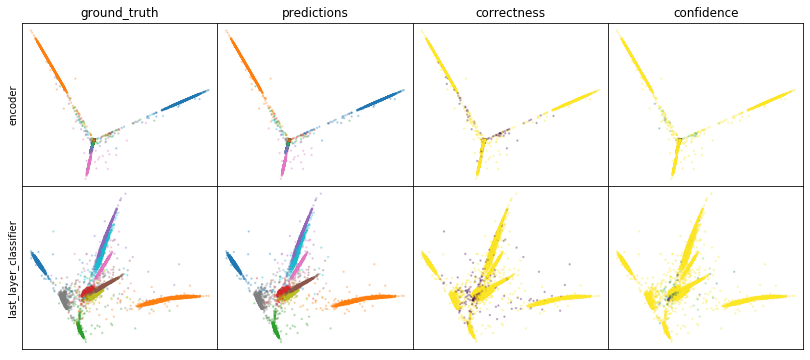

W0808 07:34:08.081764 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:34:08.796259 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:34:09.519070 140402527516416 legend.py:1282] No handles with labels found to put in legend.


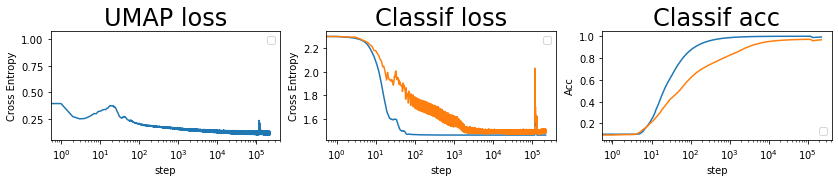

batch: 223000 | train acc: 0.9928 | val acc: 0.967


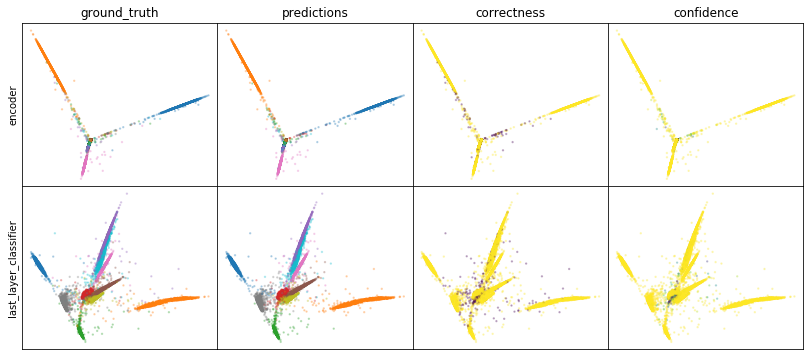

W0808 07:37:15.877027 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:37:16.612028 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:37:17.363098 140402527516416 legend.py:1282] No handles with labels found to put in legend.


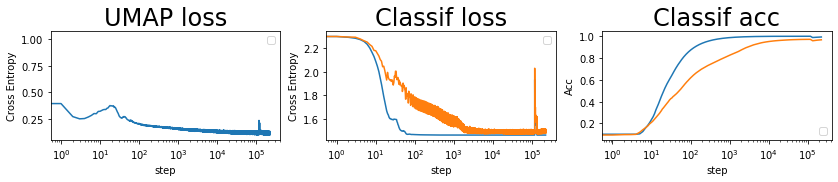

batch: 224000 | train acc: 0.9928 | val acc: 0.9671


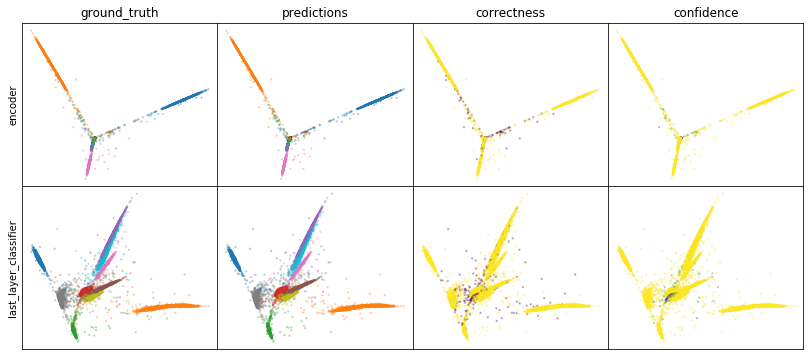

W0808 07:40:24.975933 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:40:25.719658 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:40:26.461573 140402527516416 legend.py:1282] No handles with labels found to put in legend.


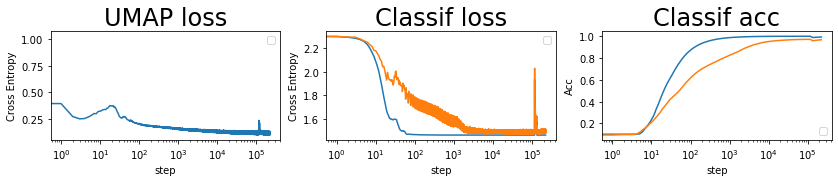

batch: 225000 | train acc: 0.9928 | val acc: 0.9671


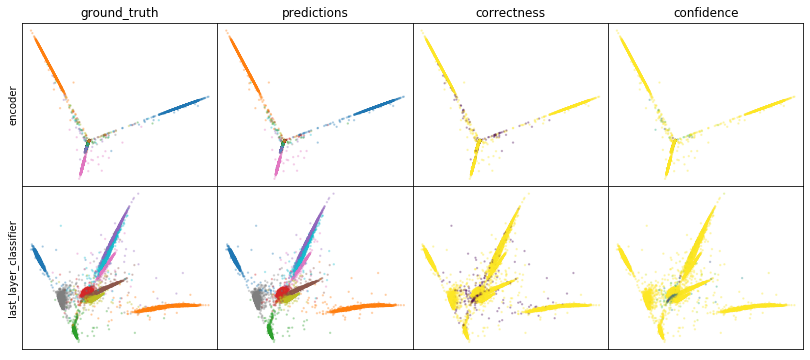

W0808 07:43:35.200902 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:43:35.988329 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:43:36.724334 140402527516416 legend.py:1282] No handles with labels found to put in legend.


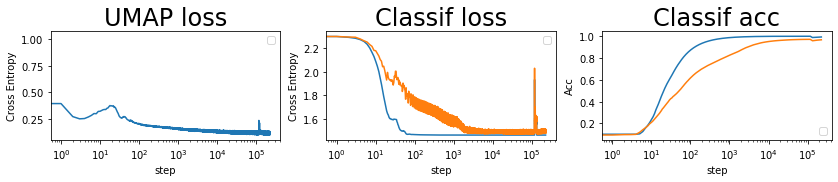

batch: 226000 | train acc: 0.9929 | val acc: 0.9671
leaving epoch because no improvement in 10000 batches


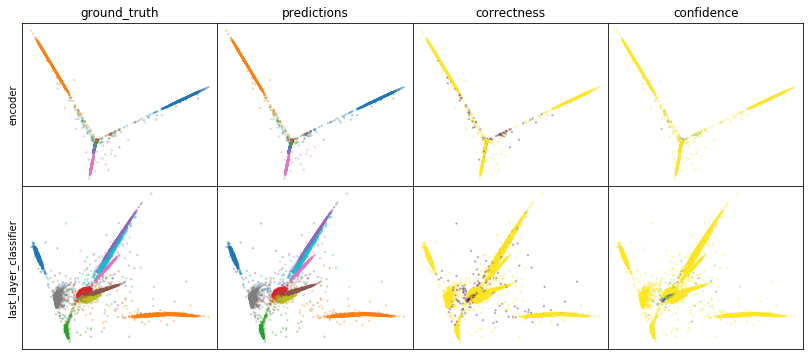

W0808 07:46:46.198958 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:46:46.933459 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:46:47.709923 140402527516416 legend.py:1282] No handles with labels found to put in legend.


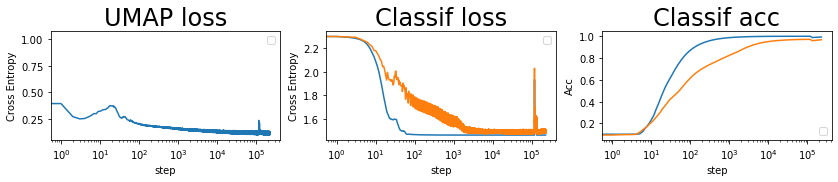

batch: 227000 | train acc: 0.9929 | val acc: 0.9672


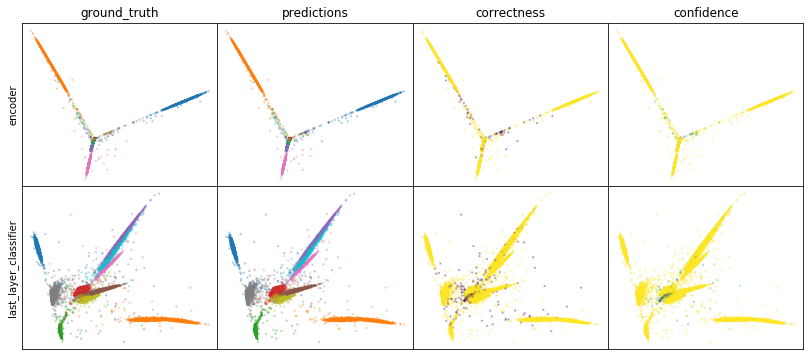

W0808 07:49:51.585543 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:49:52.325421 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:49:53.067455 140402527516416 legend.py:1282] No handles with labels found to put in legend.


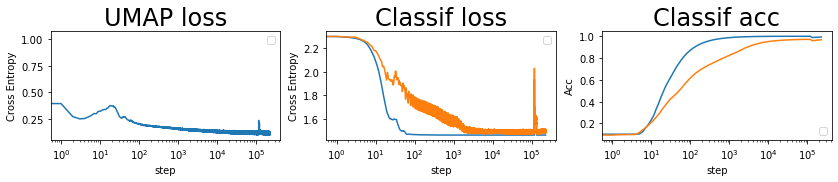

batch: 228000 | train acc: 0.9929 | val acc: 0.9672


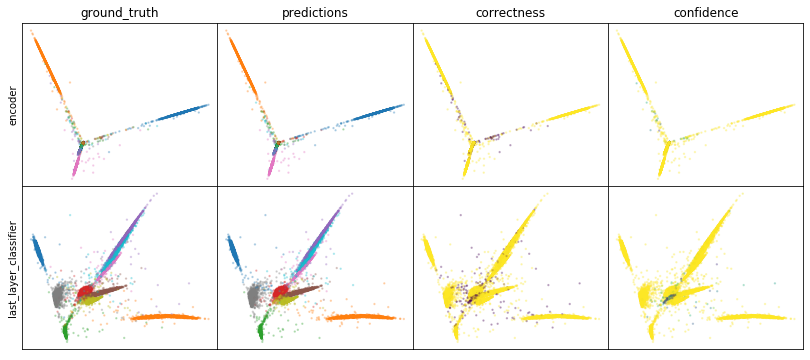

W0808 07:53:01.244781 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:53:01.991766 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:53:02.738279 140402527516416 legend.py:1282] No handles with labels found to put in legend.


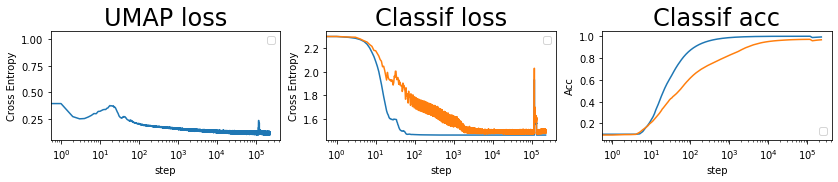

batch: 229000 | train acc: 0.9929 | val acc: 0.9673


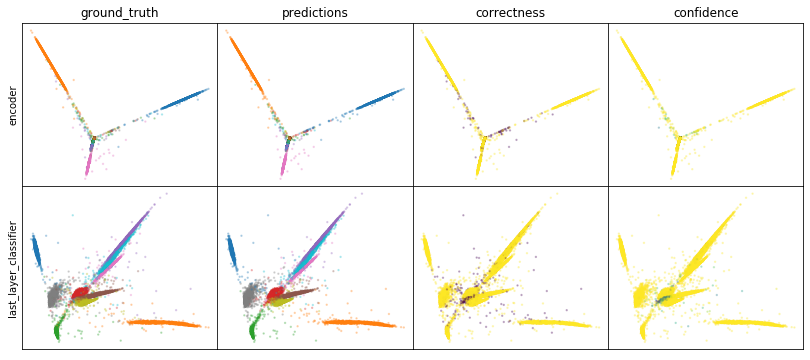

W0808 07:56:08.626350 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:56:09.379841 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:56:10.143592 140402527516416 legend.py:1282] No handles with labels found to put in legend.


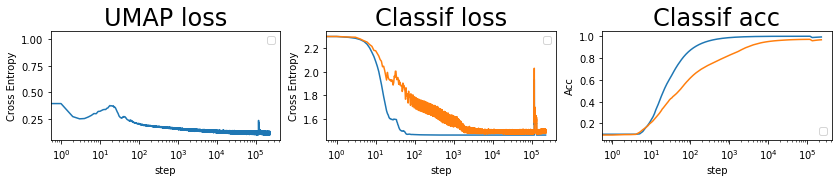

batch: 230000 | train acc: 0.993 | val acc: 0.9673


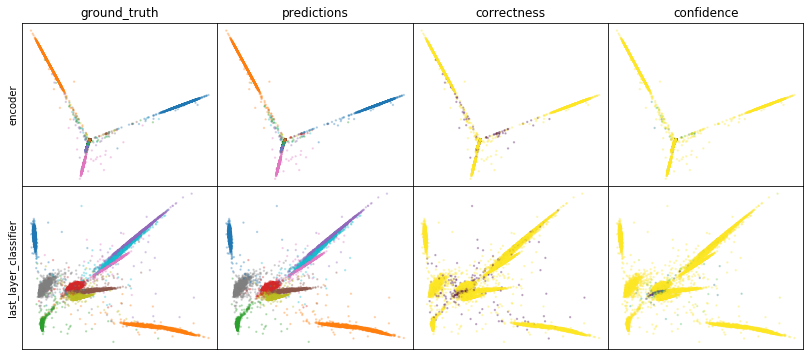

W0808 07:59:20.435416 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:59:21.193578 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 07:59:21.954674 140402527516416 legend.py:1282] No handles with labels found to put in legend.


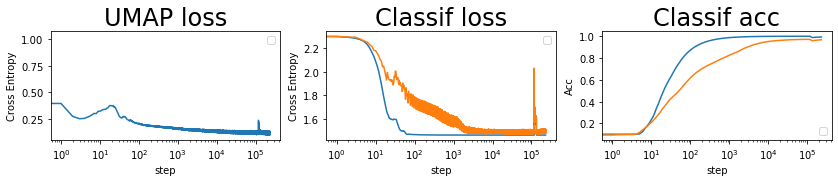

batch: 231000 | train acc: 0.993 | val acc: 0.9673


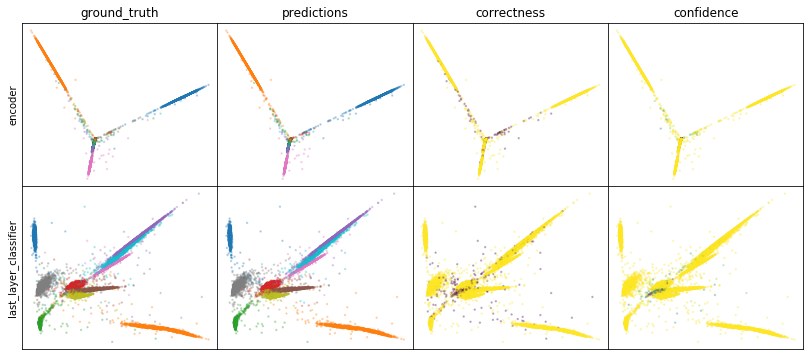

W0808 08:02:32.338917 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:02:33.115554 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:02:33.864758 140402527516416 legend.py:1282] No handles with labels found to put in legend.


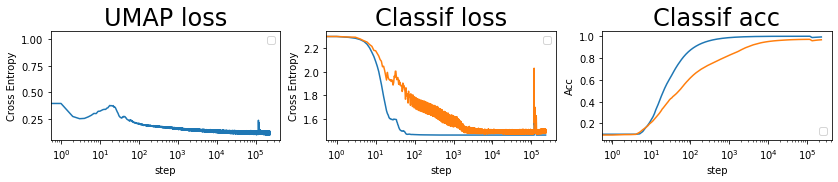

batch: 232000 | train acc: 0.993 | val acc: 0.9674


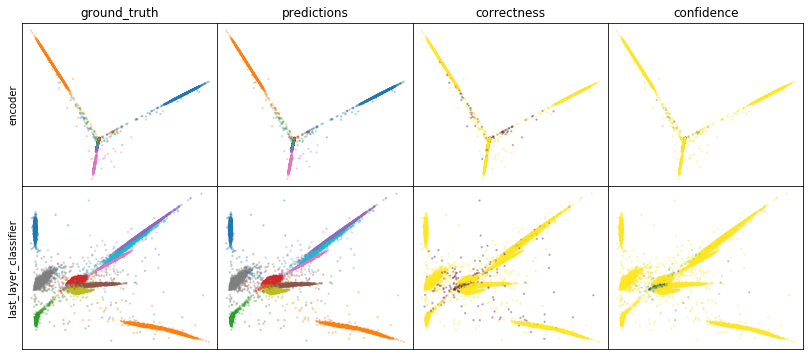

W0808 08:05:42.039662 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:05:42.821151 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:05:43.597808 140402527516416 legend.py:1282] No handles with labels found to put in legend.


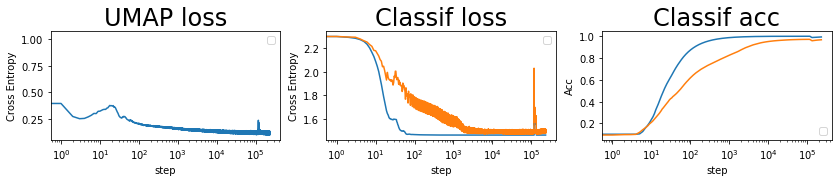

batch: 233000 | train acc: 0.9931 | val acc: 0.9674


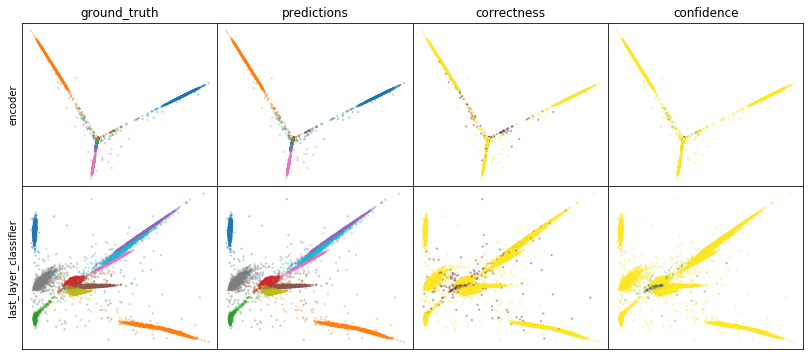

W0808 08:08:54.790417 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:08:55.559091 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:08:56.311538 140402527516416 legend.py:1282] No handles with labels found to put in legend.


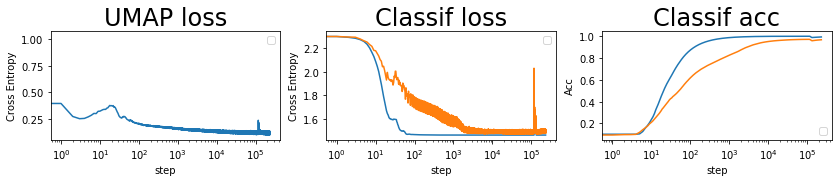

batch: 234000 | train acc: 0.9931 | val acc: 0.9675


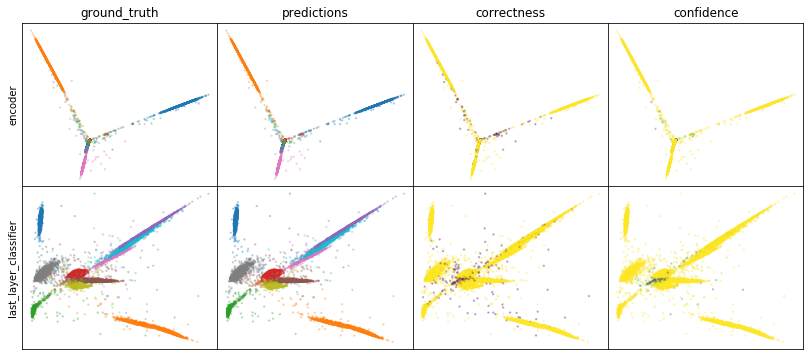

W0808 08:12:08.291541 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:12:09.072389 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:12:09.845822 140402527516416 legend.py:1282] No handles with labels found to put in legend.


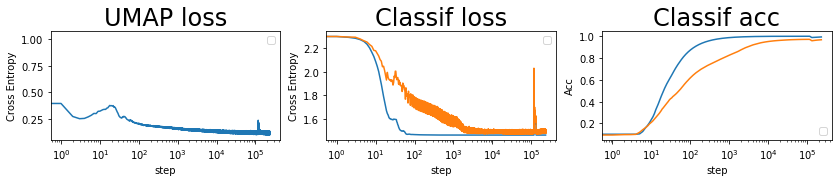

batch: 235000 | train acc: 0.9931 | val acc: 0.9675


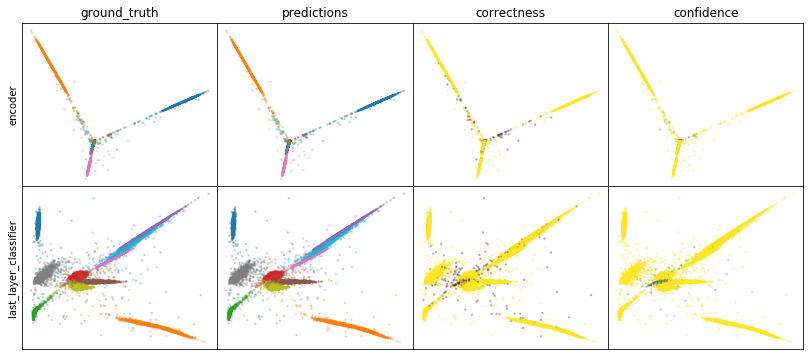

W0808 08:15:22.873548 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:15:23.634077 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:15:24.401157 140402527516416 legend.py:1282] No handles with labels found to put in legend.


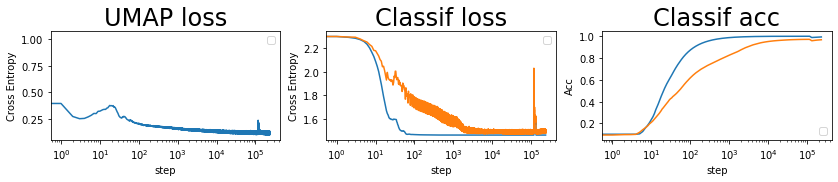

batch: 236000 | train acc: 0.9932 | val acc: 0.9675
leaving epoch because no improvement in 10000 batches


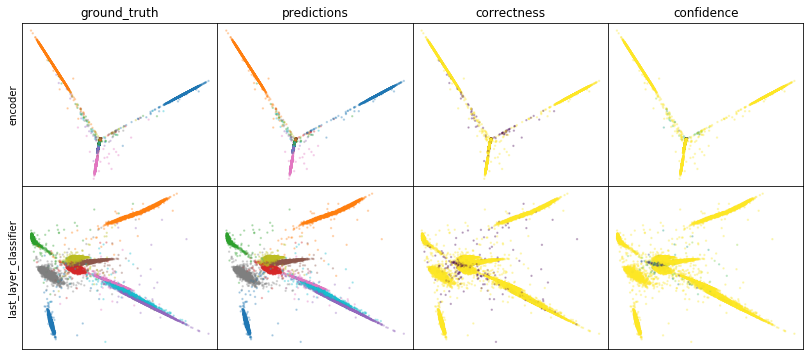

W0808 08:18:35.383346 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:18:36.183411 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:18:36.986274 140402527516416 legend.py:1282] No handles with labels found to put in legend.


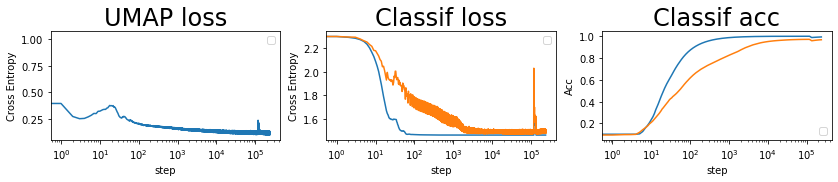

batch: 237000 | train acc: 0.9932 | val acc: 0.9676


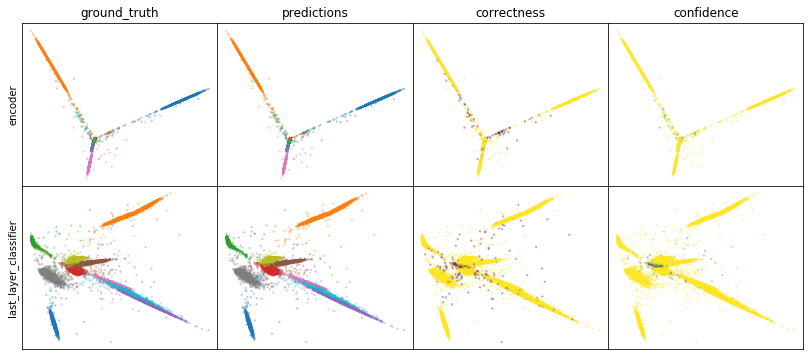

W0808 08:21:49.308490 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:21:50.074057 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:21:50.838308 140402527516416 legend.py:1282] No handles with labels found to put in legend.


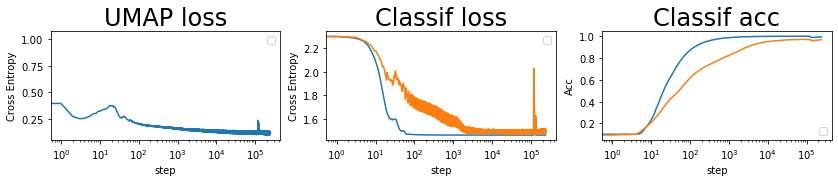

batch: 238000 | train acc: 0.9932 | val acc: 0.9676


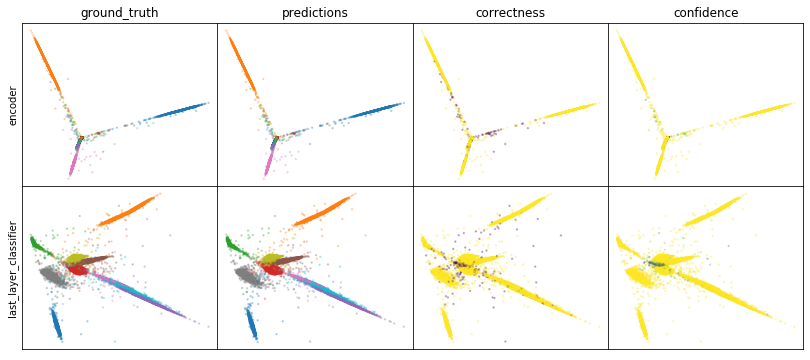

W0808 08:25:03.345039 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:25:04.106405 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:25:04.866165 140402527516416 legend.py:1282] No handles with labels found to put in legend.


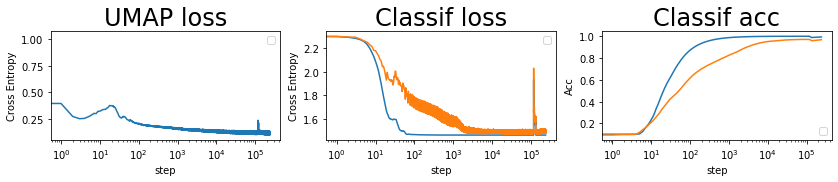

batch: 239000 | train acc: 0.9932 | val acc: 0.9677


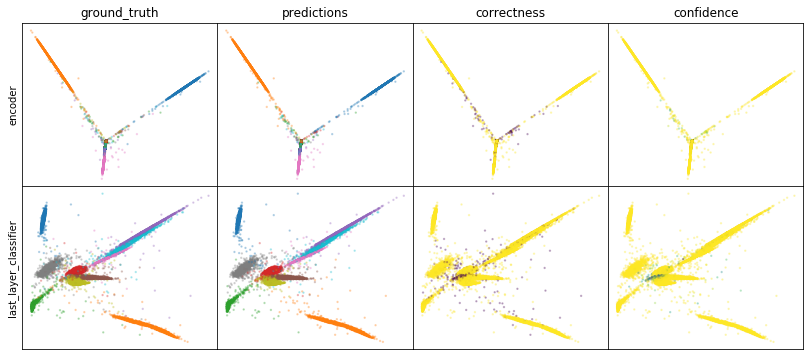

W0808 08:28:17.531217 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:28:18.341963 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:28:19.152045 140402527516416 legend.py:1282] No handles with labels found to put in legend.


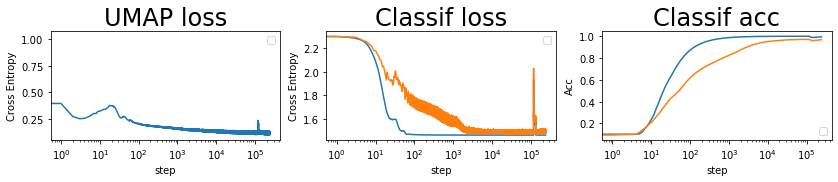

batch: 240000 | train acc: 0.9933 | val acc: 0.9677


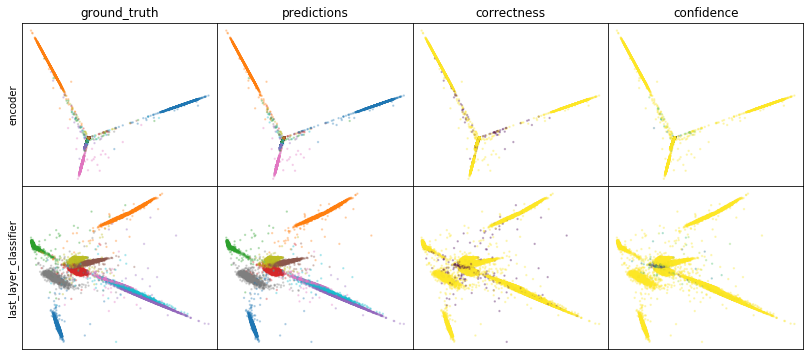

W0808 08:31:33.450323 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:31:34.250657 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:31:35.063479 140402527516416 legend.py:1282] No handles with labels found to put in legend.


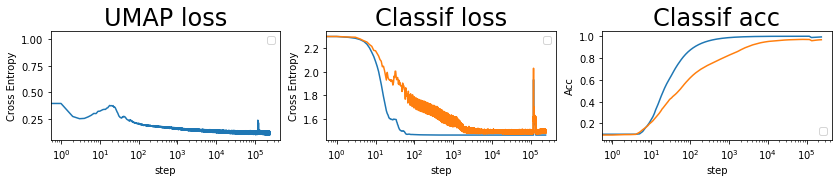

batch: 241000 | train acc: 0.9933 | val acc: 0.9677


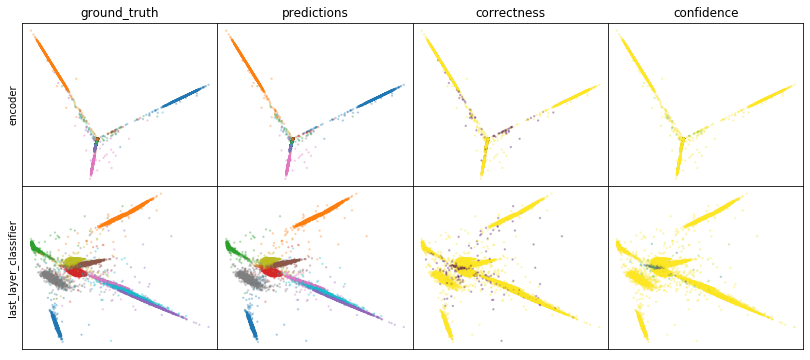

W0808 08:34:49.657659 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:34:50.447197 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:34:51.239912 140402527516416 legend.py:1282] No handles with labels found to put in legend.


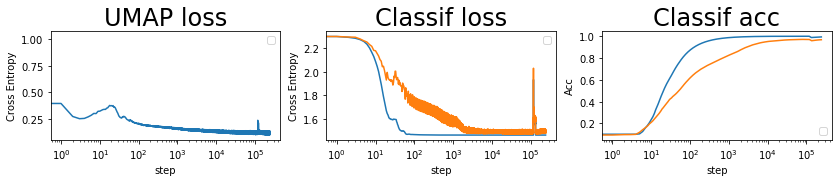

batch: 242000 | train acc: 0.9933 | val acc: 0.9678


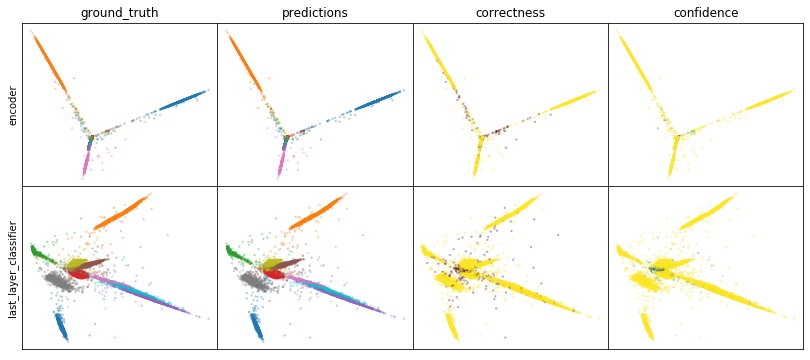

W0808 08:38:03.992101 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:38:04.763953 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:38:05.556992 140402527516416 legend.py:1282] No handles with labels found to put in legend.


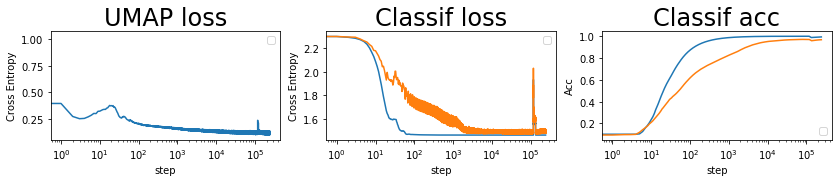

batch: 243000 | train acc: 0.9934 | val acc: 0.9678


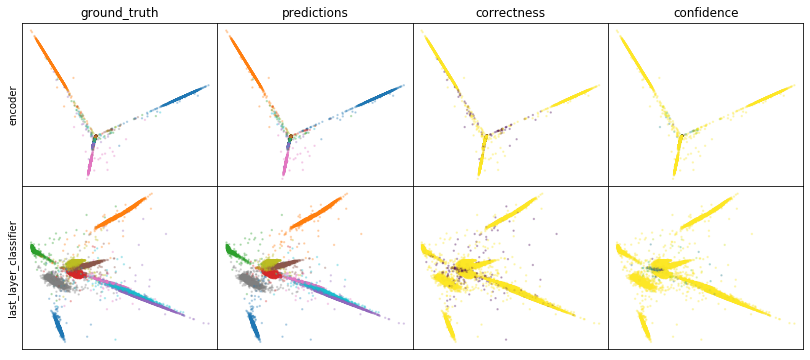

W0808 08:41:21.225704 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:41:22.028750 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:41:22.836575 140402527516416 legend.py:1282] No handles with labels found to put in legend.


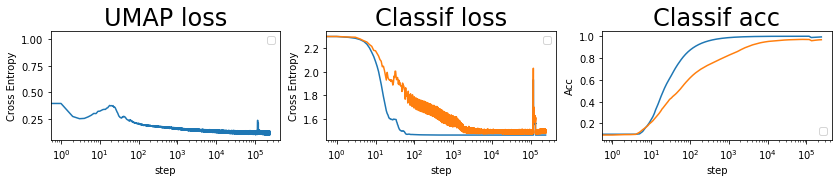

batch: 244000 | train acc: 0.9934 | val acc: 0.9679


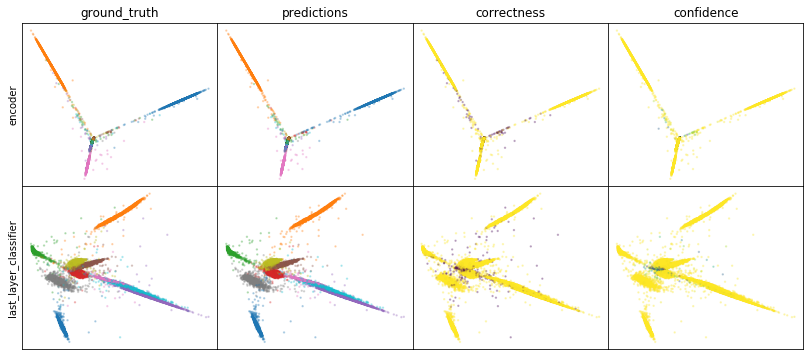

W0808 08:44:37.754369 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:44:38.541326 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:44:39.325147 140402527516416 legend.py:1282] No handles with labels found to put in legend.


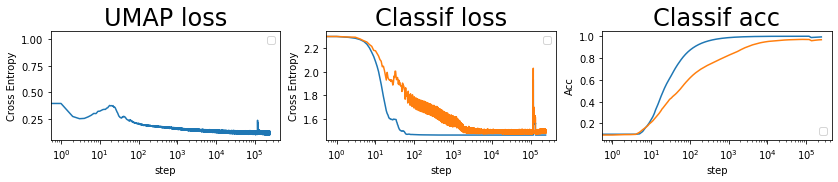

batch: 245000 | train acc: 0.9934 | val acc: 0.9679


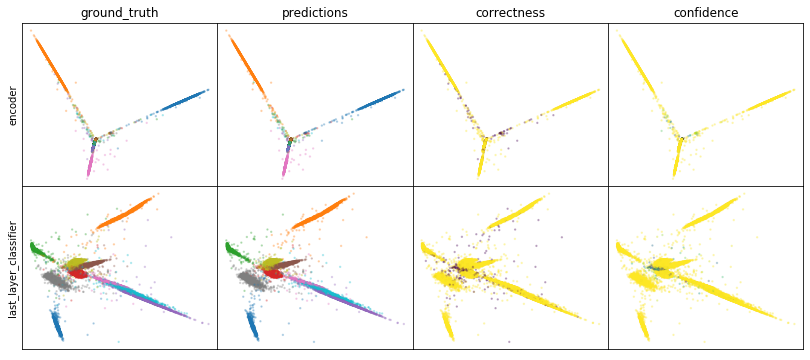

W0808 08:47:54.514350 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:47:55.329228 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:47:56.140856 140402527516416 legend.py:1282] No handles with labels found to put in legend.


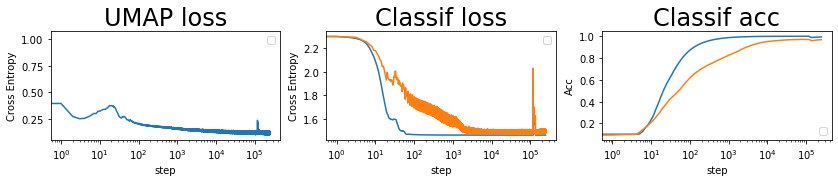

batch: 246000 | train acc: 0.9934 | val acc: 0.9679
leaving epoch because no improvement in 10000 batches


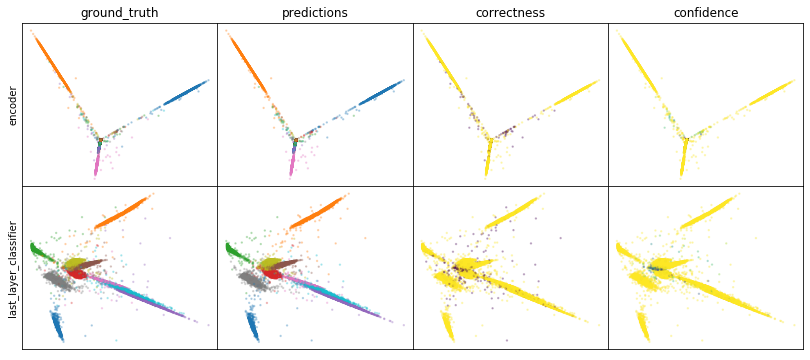

W0808 08:51:12.984267 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:51:13.803882 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:51:14.633842 140402527516416 legend.py:1282] No handles with labels found to put in legend.


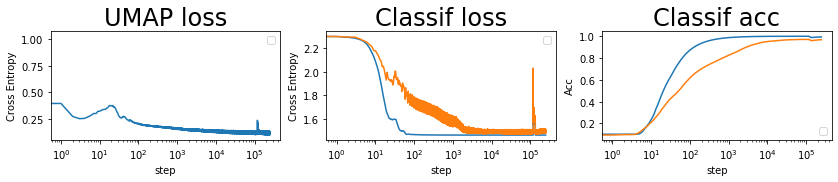

batch: 247000 | train acc: 0.9935 | val acc: 0.968


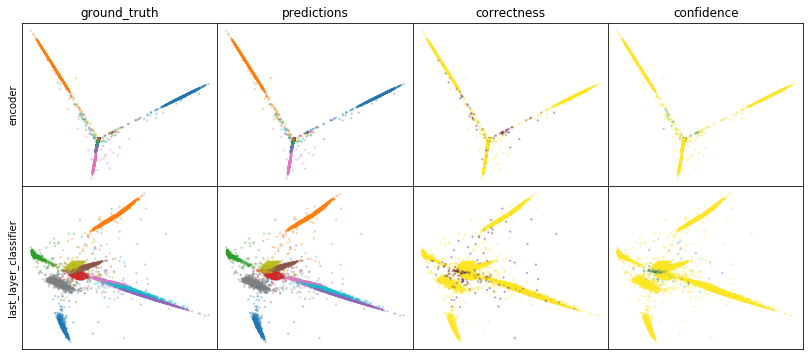

W0808 08:54:30.946211 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:54:31.864881 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:54:32.717433 140402527516416 legend.py:1282] No handles with labels found to put in legend.


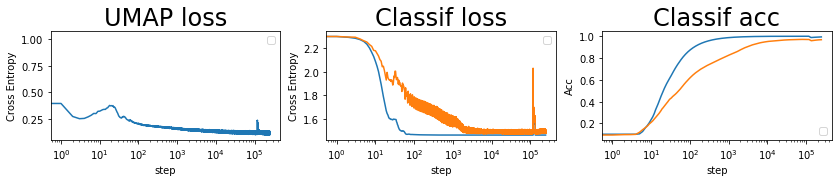

batch: 248000 | train acc: 0.9935 | val acc: 0.968


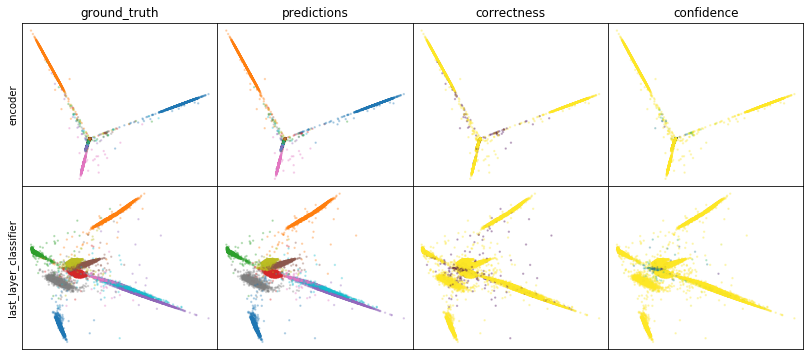

W0808 08:57:50.854362 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:57:51.659354 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 08:57:52.468958 140402527516416 legend.py:1282] No handles with labels found to put in legend.


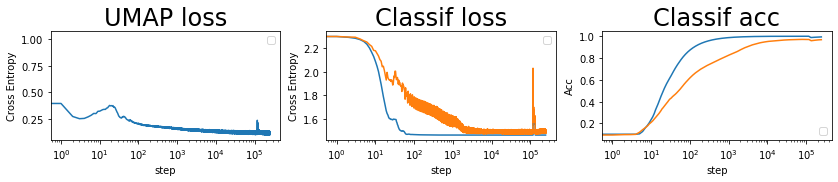

batch: 249000 | train acc: 0.9935 | val acc: 0.9681


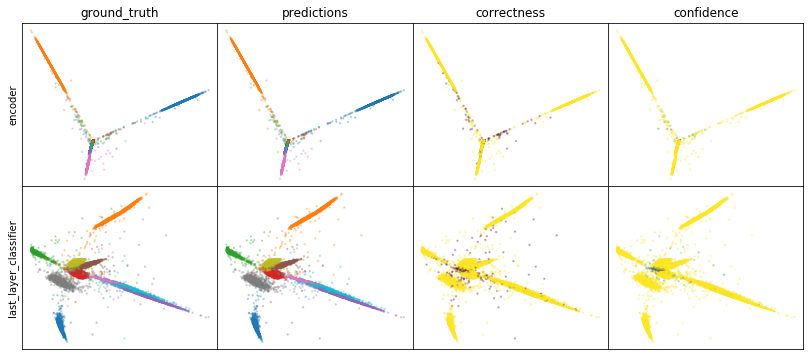

W0808 09:01:10.192385 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:01:11.040794 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:01:11.853867 140402527516416 legend.py:1282] No handles with labels found to put in legend.


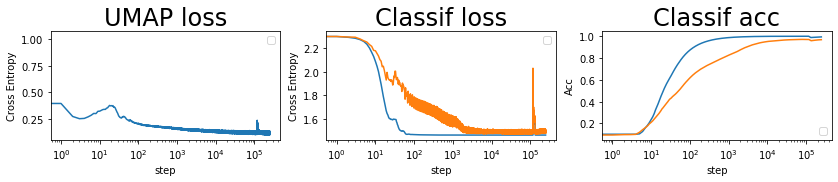

batch: 250000 | train acc: 0.9935 | val acc: 0.9681


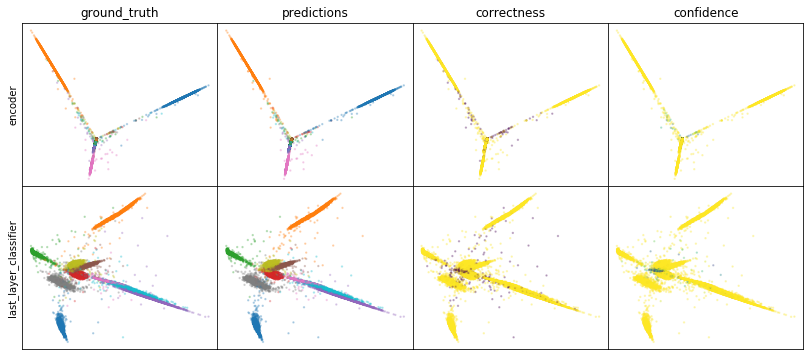

W0808 09:04:31.245009 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:04:32.057332 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:04:32.873256 140402527516416 legend.py:1282] No handles with labels found to put in legend.


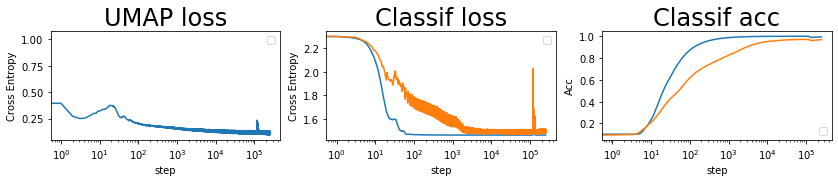

batch: 251000 | train acc: 0.9936 | val acc: 0.9681


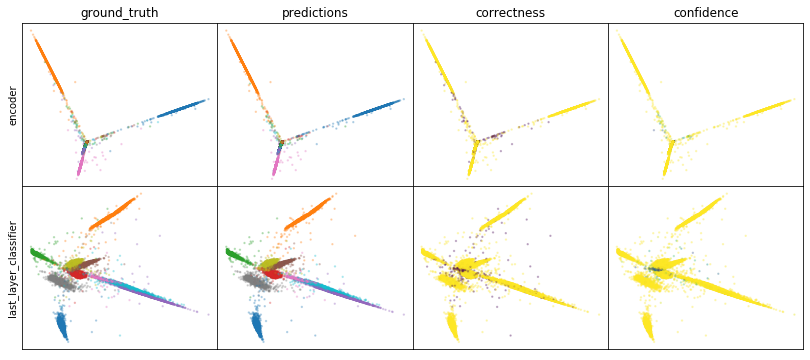

W0808 09:07:52.066362 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:07:52.875723 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:07:53.729623 140402527516416 legend.py:1282] No handles with labels found to put in legend.


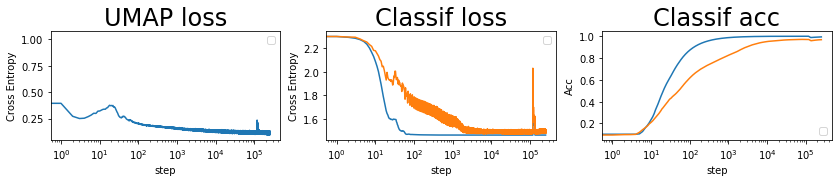

batch: 252000 | train acc: 0.9936 | val acc: 0.9682


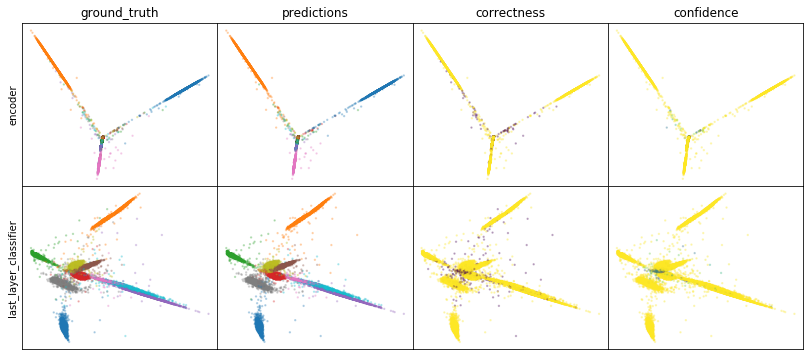

W0808 09:11:12.104814 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:11:12.918276 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:11:13.734472 140402527516416 legend.py:1282] No handles with labels found to put in legend.


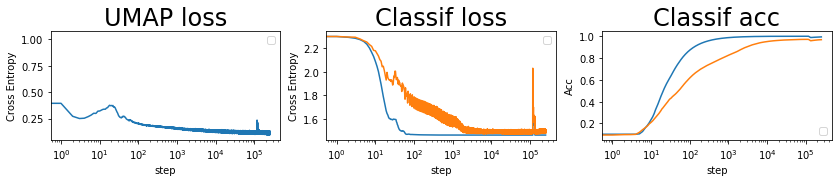

batch: 253000 | train acc: 0.9936 | val acc: 0.9682


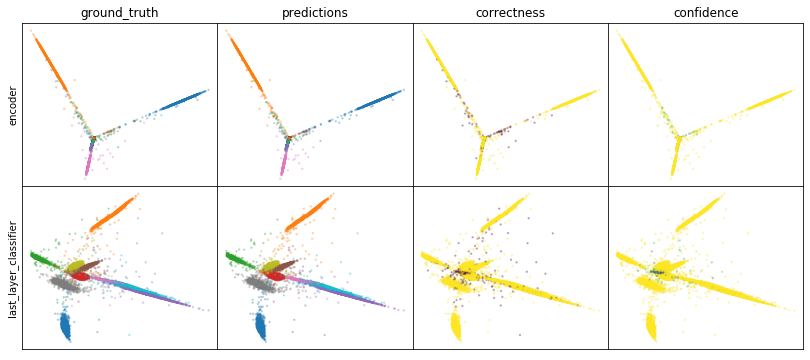

W0808 09:14:32.872328 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:14:33.720103 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:14:34.563908 140402527516416 legend.py:1282] No handles with labels found to put in legend.


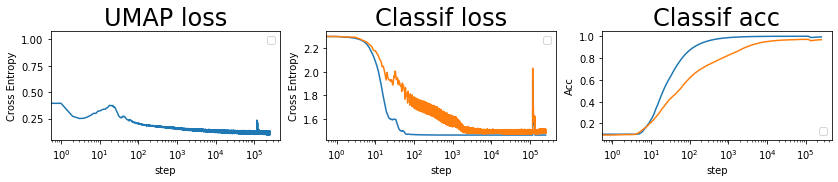

batch: 254000 | train acc: 0.9936 | val acc: 0.9682


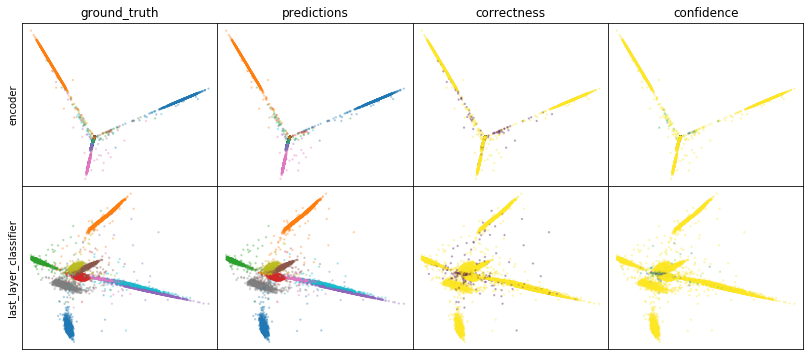

W0808 09:17:55.412013 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:17:56.256215 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:17:57.147311 140402527516416 legend.py:1282] No handles with labels found to put in legend.


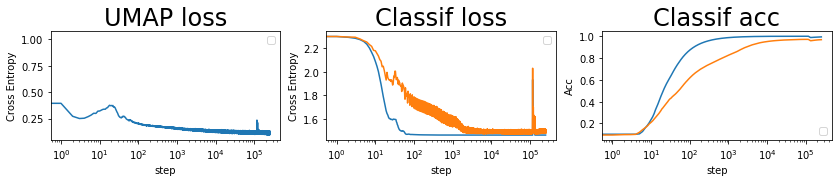

batch: 255000 | train acc: 0.9937 | val acc: 0.9683


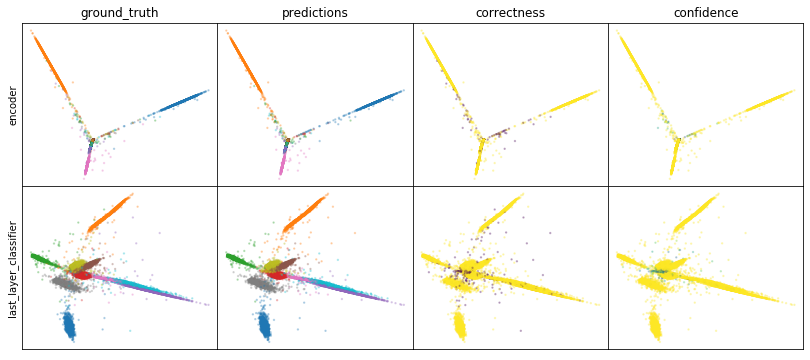

W0808 09:21:17.314429 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:21:18.159374 140402527516416 legend.py:1282] No handles with labels found to put in legend.
W0808 09:21:19.023514 140402527516416 legend.py:1282] No handles with labels found to put in legend.


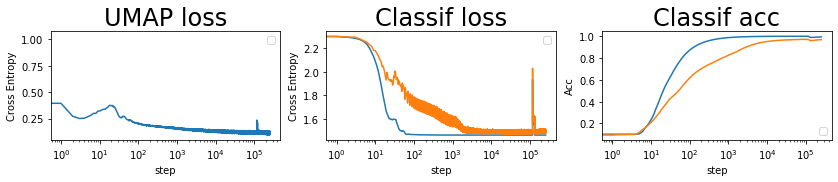

batch: 256000 | train acc: 0.9937 | val acc: 0.9683
leaving epoch because no improvement in 10000 batches


KeyboardInterrupt: 

In [35]:
improved_this_epoch = True
for edge_epoch, epoch in tqdm(
    zip(edge_iter, np.arange(N_EPOCHS)), total=N_EPOCHS, desc="epoch"
):

    pbar = tqdm(total=BATCHES_PER_EPOCH, leave=False, desc="loss")

    for (batch_to, batch_from), (X, y), (X_val, y_val) in zip(
        edge_epoch, labeled_iter, data_valid
    ):

        # train
        (
            attraction_loss,
            repellant_loss,
            umap_loss,
            classifier_loss,
            classifier_acc,
        ) = model.train(
            batch_to=X_train[np.array(batch_to)],
            batch_from=X_train[np.array(batch_from)],
            X=X,
            y=y,
            umap_prop=umap_prop,
        )

        # compute validation loss
        val_loss, val_acc = compute_classifier_loss(
            X_val,
            y_val,
            model.encoder,
            model.classifier,
            model.sparse_ce,
            model.class_acc_val,
        )

        pbar.update()
        pbar.set_description("val acc: {}".format(str(round(val_acc.numpy(), 5))))

        # save losses
        model.write_losses(
            tf.convert_to_tensor(batch, dtype=tf.int64),
            classifier_acc,
            classifier_loss,
            umap_loss,
            val_loss,
            val_acc,
        )

        # plot results
        if batch % plot_frequency == 0:
            plot_umap_classif_results(
                model,
                X_valid,
                Y_valid,
                X_train,
                X_labeled,
                Y_labeled,
                batch_size,
                cmap="tab10",
                cmap2="tab10",
            )
            print(
                "batch: {} | train acc: {} | val acc: {}".format(
                    str(batch),
                    str(round(classifier_acc.numpy(), 4)),
                    str(round(val_acc.numpy(), 4)),
                )
            )

        # make any improvement isn't a fluke of small batch size
        if batches_since_last_reload >= reload_tolerance:

            # save if validation accuracy went up
            if val_acc > best_saved_acc + max_save_delta:
                # save weights
                print(
                    "saving weights | batch = {} | acc = {}".format(
                        batch, round(val_acc.numpy() * 100, 3)
                    )
                )
                model.encoder.save_weights((cpt_path / "encoder").as_posix())
                model.classifier.save_weights((cpt_path / "classifier").as_posix())
                best_saved_acc = val_acc.numpy()
                # save batch number
                best_saved_batch = copy.deepcopy(batch)

            # reinitialize if validation accuracy went down
            if val_acc < (best_saved_acc - max_reinitialize_delta):
                # if
                if batches_since_last_reload >= reload_tolerance:
                    batches_since_last_reload = 0
                    lr = model.optimizer.lr.numpy()
                    print(
                        "batch {} | acc = {} | learn rate = {} | reloading weights from batch {} at acc {} | n reloads = {}".format(
                            batch,
                            str(round(val_acc.numpy(), 3)),
                            lr,
                            best_saved_batch,
                            int(best_saved_acc * 100),
                            n_reloads,
                        )
                    )
                    # reload weights
                    model.encoder.load_weights((cpt_path / "encoder").as_posix())
                    model.classifier.load_weights((cpt_path / "classifier").as_posix())

                    # set new learning rate
                    model.optimizer.lr.assign(lr / 2)

                    batch += 1
                    n_reloads += 1

                    # stop if reloaded too many times
                    if n_reloads >= max_reloads:
                        break

            # if there is an imporovement, set new best score
            if val_acc > best_acc + min_delta:
                improved_this_epoch = True
                last_improvement = 0
                best_acc = val_acc
            # if the model has not improved in patience batches, end epoch
            elif last_improvement >= patience:
                last_improvement = 0
                print(
                    "leaving epoch because no improvement in {} batches".format(
                        patience
                    )
                )
                break
            else:
                last_improvement += 1

        # up the ticker
        batch += 1
        batches_since_last_reload += 1
    pbar.close()

In [36]:
test_enc = model_data(X_test, batch_size, model.encoder)
y_pred = model_data(test_enc, batch_size, model.classifier)
test_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_test, y_pred
).numpy()
print(np.mean(test_acc))

0.9678


In [37]:
np.save(cpt_path / 'test_acc.npy', test_acc)

In [39]:
pred_model = tf.keras.models.Model(model.classifier.input,[model.classifier.get_layer(name="dense_1").get_output_at(0)])

In [40]:
z_enc = model_data(X_train, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)
umap_class = UMAP(verbose=True).fit_transform(last_layer_class, Y_masked)
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_train
np.save(cpt_path / 'train_last_layer_class.npy', last_layer_class)
np.save(cpt_path / 'train_z_enc.npy', z_enc)
np.save(cpt_path / 'train_last_layer_class_umap.npy', umap_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Sat Aug  8 09:25:52 2020 Finding Nearest Neighbors
Sat Aug  8 09:25:52 2020 Building RP forest with 16 trees
Sat Aug  8 09:25:52 2020 parallel NN descent for 16 iterations
	 0  /  16
	 1  /  16
Sat Aug  8 09:26:31 2020 Finished Nearest Neighbor Search
Sat Aug  8 09:26:34 2020 Construct embedding
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Sat Aug  8 09:28:16 2020 Finished embedding


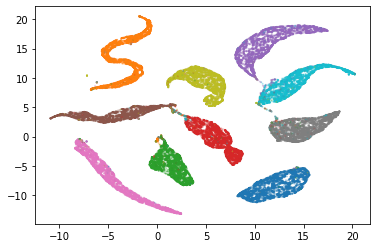

In [41]:
plt.scatter(umap_class[:,0], umap_class[:,1], c =Y_train,  cmap = plt.cm.tab10, s = 1, alpha = 0.25)

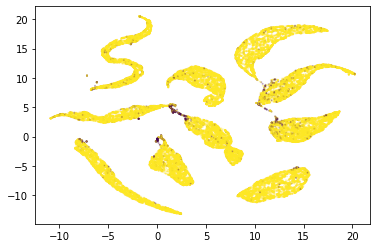

In [42]:
plt.scatter(umap_class[:,0], umap_class[:,1], c =correctness,  cmap = plt.cm.viridis, s = 1, alpha = 0.25)